<a href="https://colab.research.google.com/github/Andrea987/advtrain-linreg/blob/main/notebooks/Copy_of_fig1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from re import VERBOSE
from itertools import cycle
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from sklearn.linear_model import lasso_path
from sklearn import datasets
from sklearn import linear_model
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
import tqdm
import cvxpy as cp
print(cp.installed_solvers())
import numpy as np

import traceback


def compute_q(p):
    if p != np.inf and p > 1:
        q = p / (p - 1)
    elif p == 1:
        q = np.inf
    else:
        q = 1
    return q


class AdversarialTraining:
    def __init__(self, X, y, S, p):  # S is the matrix such that ||S^(-1) @ Dx||\leq delta. As a consequence, S appears in the unconstrained problem
        # S: (n, n) matrix, or S = np.concatenate(tS), with tS = [S1,..,S_m], so S is (n * m, n)
        m, n = X.shape
        q = compute_q(p)
        #print("who is X", X)
        #print("who is y", y)
        #print("who is S", S)
        #print("who is q in AdversarialTraining: ", q)
        # Formulate problem
        param = cp.Variable(n)
        #print("shape param ", param.shape)
        #print("dim ", n)
        print("X ", m, n)
        print("Shape ", S.shape)
        #print("S in adv training", S)
        print("nm ", n*m)

        if S.shape == (m, n, n):
          S = np.concatenate(S)
          print("S is a tensor, concatenated")

        if S.shape == (n, n):
          print("one matrix in input, S.shape = (n, n)")
          partial = S @ param  # should be (m * n,)
          param_norm = cp.pnorm(partial, p=q)
        elif S.shape == (n * m, n):  # should be a stack of matrices
          print("multiple matrices in input, S conc")
          partial = S @ param  # should be (m * n,)
          partial = cp.reshape(partial, (m, n), order='C')
          param_norm = cp.pnorm(partial, p=q, axis=1)
        else:
          print("--------> ERROR: NO MATRIX S FOUND IN ADVERSARIAL TRAINING")
        #elif S.shape == (m , n):  # stack of diagonal matrices
        #  print("multiple matrices in input, S_i diag")
          #S_cvx = cp.Constant(S)
        #  partial = cp.multiply(cp.Parameter(S), param)
        #  param_norm = cp.pnorm(partial, p=q, axis=1)
        adv_radius = cp.Parameter(name='adv_radius', nonneg=True)
        abs_error = cp.abs(X @ param - y)
        adv_loss = 1 / m * cp.sum((abs_error + adv_radius * param_norm) ** 2)
        prob = cp.Problem(cp.Minimize(adv_loss))
        self.prob = prob
        self.adv_radius = adv_radius
        self.param = param
        self.warm_start = False


    def __call__(self, adv_radius, **kwargs):
        try:
            self.adv_radius.value = adv_radius
            self.prob.solve(warm_start=self.warm_start, solver=cp.CLARABEL, max_iter=10000, **kwargs)
            v = self.param.value
        except Exception as e:
          print("------------------> Error occurred:")
          traceback.print_exc()
          v = np.zeros(self.param.shape)
        #except:
        #    print("----------------------> you are in except")
        #    v = np.zeros(self.param.shape)
        return v


def get_lasso_path(X, y, eps_lasso=1e-5):
    alphas, coefs, _ = lasso_path(X, y, eps=eps_lasso)
    coefs= np.concatenate([np.zeros([X.shape[1], 1]), coefs], axis=1)
    alphas = np.concatenate([1e2 * np.ones([1]), alphas], axis=0)
    return alphas, coefs, []


def get_path(X, y, estimator, amax, eps=1e-5, n_alphas=200):
    _, m = X.shape
    amin = eps * amax
    alphas = np.logspace(np.log10(amin), np.log10(amax), n_alphas)
    coefs_ = []
    for a in tqdm.tqdm(alphas):
        coefs = estimator(X, y, a)
        #print("alpha  ", a, "coef: ", coefs)
        coefs_.append(coefs if coefs is not None else np.zeros(m))
    return alphas, np.stack((coefs_)).T


def plot_coefs(alphas, coefs, ax):
    #print("you are printing coefs in function of 1/alphas")
    colors = cycle(["b", "r", "g", "c", "k"])
    #l1norm = np.abs(coefs).sum(axis=0)
    ax.set_xlabel("1/alphas")
    ax.set_ylabel("coef")
    for coef_l, c in zip(coefs, colors):
        ax.semilogx(1/alphas, coef_l, c=c)
        #ax.semilogx(1/alphas, l1norm, c=c)
        #ax.plot(1/alphas, coef_l, c=c)


def plot_coefs_l1norm(coefs, ax):
    #print("you are printing coeff in function of l1 norm")
    colors = cycle(["b", "r", "g", "c", "k"])
    #l1norm = np.abs(coefs).mean(axis=0)
    l1norm = np.abs(coefs).sum(axis=0)
    #print("coef ", coefs)
    #print("l1norm ", l1norm)
    ax.set_xlabel("l1norm")
    ax.set_ylabel("coef")
    for coef_l, c in zip(coefs, colors):
        ax.plot(l1norm, coef_l, c=c)


def train_and_plot(X, y, S, list_ax):
    linfadvtrain = AdversarialTraining(X, y, S, p=np.inf)
    estimator = lambda X, y, a:  linfadvtrain(adv_radius=a)
    alphas_adv, coefs_advtrain_linf  = get_path(X, y, estimator, 1e2)
    plot_coefs_l1norm(coefs_advtrain_linf, list_ax[0])
    plot_coefs(alphas_adv, coefs_advtrain_linf, list_ax[1])
    return alphas_adv, coefs_advtrain_linf


def add_rectangles_old(x, y, box_width, box_height, ax):
  r_c = (np.random.binomial(1, 1, size=x.size) == 1)  # 1 taken, 0 not taken
  #print(r_c)

  for xi, yi in zip(x[r_c], y[r_c]):
      rect = patches.Rectangle(
        (xi-box_width/2, yi-box_height/2),
        box_width, box_height,
        linewidth=1, edgecolor='r', facecolor='none'
      )
      ax.add_patch(rect)


def add_rectangles(x, y, S, ax):
  r_c = (np.random.binomial(1, 1, size=x.size) == 1)  # 1 taken, 0 not taken
  #print(r_c)
  d = S.shape[-1]
  #S = S * 100
  if S.ndim == 2 or S.shape == (1, d, d):
    S = S.squeeze()
    print("------------------------> who is S in add_rectangles\n", S)
    box_width = S[0, 0]
    box_height = S[1, 1]
    for xi, yi in zip(x[r_c], y[r_c]):
        rect = patches.Rectangle(
          (xi-box_width/2, yi-box_height/2),
          box_width, box_height,
          linewidth=1, edgecolor='r', facecolor='none'
        )
        ax.add_patch(rect)
  else:  # S is something like (n, d, d)
    #print("---------------> who is S in add_rectangles (mult imp)\n", S)
    box_width = S[:, 0, 0]
    box_height = S[:, 1, 1]
    #print("bw\n ", box_width)
    #print("bh\n ", box_height)
    #print("------------------------------> boxes printed")
    for xi, yi, bw, bh in zip(x[r_c], y[r_c], box_width[r_c], box_height[r_c]):
        #print("bw, bh ", bw, ",   ", bh)
        rect = patches.Rectangle(
          (xi-bw/2, yi-bh/2),
          bw, bh, linewidth=1, edgecolor='r', facecolor='none'
        )
        ax.add_patch(rect)
    ax.set_aspect('equal')





print("end block")


['CLARABEL', 'CVXOPT', 'GLPK', 'GLPK_MI', 'HIGHS', 'OSQP', 'SCIPY', 'SCS']
end block


In [ ]:
# imputation's block

def clear_dataset(X, y, masks):
  # remove observations full NaN
  # X is an (n, d) matrix, y is a (n,) vector,
  # masks is an (n, d) binary matrix associated to X. 1 missing, 0 seen
  M = np.sum(1 - masks, axis=1) > 0
  M_col = np.sum(1 - masks, axis=0) > 0  # True if in the column there is at least one seen component
  if np.sum(M_col) < masks.shape[1]:
    print("Careful, there is one column full of nan")
  return X[M, :][:, M_col], y[M], masks[M, :][:, M_col]


def single_imputation(X_nan, impute_estimator):
    ice = IterativeImputer(estimator=impute_estimator)
    return ice.fit_transform(X_nan)


def multiple_imputation(nbr_mi, X_nan):
    n, d = X_nan.shape
    res = np.zeros((nbr_mi, n, d))
    for i in range(nbr_mi):
       n_i = np.random.randint(0, 1000)
       ice = IterativeImputer(random_state=n_i, max_iter=50, sample_posterior=True)
       res[i, :, :] = ice.fit_transform(X_nan)
       #print("fin res shape", res.shape)
       #if nbr_mi == 1:
        #res = res[0, :, :]
        #print("fin res shape", res.shape)
    return res


def imputation_elliptic(mu, sigma, x, masks):
  # mu, mean elliptical distribution (,d)
  # sigma, cov matrix elliptical distribution (d, d)
  # x: dataset (n, d)
  # masks: mask data, 0 seen, 1 missing
  n, d = x.shape
  print(n, d)
  x_imp = x.copy()
  #print("x_imp clean", x_imp)
  for i in range(n):
    if not (masks[i, :] == 0).all():  # if we have at least one missing component
      #print("nbr : ", i)
      x_c = x[i, :]
      m_bool = (masks[i, :] == 0)  # True seen, False missing
      sigma_aa_inv = np.linalg.inv(sigma[m_bool, :][:, m_bool])
      sigma_ma = sigma[~m_bool, :][:, m_bool]
      mu_cond = mu[~m_bool] + sigma_ma @ sigma_aa_inv @ (x_c[m_bool] - mu[m_bool])
      x_imp[i, ~m_bool] = mu_cond
  return x_imp


def listwise_delection(X, masks):
  # masks: 1 missing, 0 seen
    M = np.sum(masks, axis=1) == 0  # zeros components are the one with full entries
    ret = X[M, :] if X.ndim == 2 else X[M]
    return ret


In [ ]:
#np.random.seed(42)

#p_miss_2d = [0.2, 0.4, 0.4]
#beta_2d = np.array([0.5, 2])  # ground truth

from sklearn.datasets import make_moons, make_circles
from sklearn.linear_model import BayesianRidge
from sklearn.model_selection import train_test_split

def generate_masks_2d(nbr_of_sample, p_missing):
    # nbr_of_sample is the number of masks
    # p_missing=[p00, p01, p10], where p00 is the probability of seeing both components,
    # p10 is the probability of seeing the right component, p01 is the probability of seeing the left component
    masks = np.zeros((nbr_of_sample, 2))
    v = np.random.choice(a=3, size=nbr_of_sample, p=p_missing)
    masks[v == 0, :] = np.array([0, 0])  # both seen
    masks[v == 1, :] = np.array([0, 1])  # left seen
    masks[v == 2, :] = np.array([1, 0])  # right seen
    return masks

def best_predictor(X, coeff, y):
  hat_y = (X @ coeff).T  # (n, d) @ (d, m) = (n, m)
  r = hat_y - y  # residual
  score = np.mean(r * r, axis=1)
  print("scores:  ", score)
  i_min = np.argmin(score)
  return coeff[:, i_min], score[i_min]

def best_idx_predictor(X, coeff, y):
  hat_y = (X @ coeff).T  # (n, d) @ (d, m) = (n, m)
  r = hat_y - y  # residual
  #score = np.mean(r * r, axis=1)
  score = np.mean(r * r, axis=1)
  #print("score in best idx", score)
  i_min = np.argmin(score)
  #### find the minimum value with a threshold, so we get bigger uncertainty set that are visible
  min = np.min(score)
  max = np.max(score)
  score[ score < min + 1e-2 ] = max
  ####
  #print("score after ", score)
  i_min = np.argmin(score)
  return i_min, score[i_min]



def generate_X(data, dim):
    if data == 'Gaussian':
      def generator(n):
        return np.random.randn(n, dim)
    elif data == 'Uniform':
      def generator(n):
        return np.random.rand(n, dim)
    elif data == 'moons':
      def generator(n):
        return make_moons(n, noise=0.1)[0]
    elif data == 'circles':
      def generator(n):
        return make_circles(n, noise=0.1, factor=0.4)[0]
    return generator


In [ ]:
# experiment 2d with dataset generated externally

def imputations(info, dict_obs_for_imp):  # X_nan, y):
  # info contains the method and possible extra information
  # X_nan is the dataset with nan in place of the missing components
  # y is return as it is, unless the method require to change it, like in
  # listwise deletion
    #print(info)
    X_nan = dict_obs_for_imp['X_nan']
    y = dict_obs_for_imp['y_train']
    mask_from_X_nan = np.isnan(X_nan).astype(int)
    if info['imp_method'] == 'BR_si':  # Baeysian_Ridge_single_imputation
        X = single_imputation(X_nan, BayesianRidge())
    elif info['imp_method'] in  ['mi', 'mi_pure']:
        X = multiple_imputation(info['mi_nbr'], X_nan)
    elif info['imp_method'] == 'l_d':  # listwise_deletion
        #mask_from_X_nan = np.isnan(X_nan).astype(int)
        X = listwise_delection(X_nan, mask_from_X_nan)
        y = listwise_delection(y, mask_from_X_nan)
        if len(X) == 0:  # no elements left, add an artificial element
            X = np.zeros((1, X_nan.shape[-1]))
            y = np.zeros(1)
        mask_from_X_nan = np.zeros_like(X)
    elif info['imp_method'] == 'oracle':
        X = dict_obs_for_imp['X_train_masked'][0]
        mask_from_X_nan = np.zeros_like(X)
    else:
      print("-------------------> ERROR: WRONG KEYWORD (in imputations)")
    return X, y, mask_from_X_nan


def cov_strategy(info, dict_observations):
    X_imputed = dict_observations['X_imputed']
    X_nan = dict_observations['X_nan']
    masks = dict_observations['masks_after_imputation']
    print(np.sum(masks, axis=-1))
    if info['cov_strategy'] == 'sd':
      sd = np.std(X_imputed, axis=0)
      #print("sd in cov strategy ", sd)
      #S = np.diag(sd)  # check if here it is 1 / sd or sd. The intuition is that, small covariance means small boxes where the points can move
      S = np.diag(sd)
    elif info['cov_strategy'] == 'inv_sd':
      sd = np.std(X_imputed, axis=0)
      #S = np.diag(sd)  # check if here it is 1 / sd or sd. The intuition is that, small covariance means small boxes where the points can move
      S = np.diag(1 / sd)
    elif info['cov_strategy'] == 'zero':
      #sd = np.std(X_imputed, axis=0)
      #S = np.diag(sd)  # check if here it is 1 / sd or sd. The intuition is that, small covariance means small boxes where the points can move
      S = np.zeros((X_imputed.shape[-1], X_imputed.shape[-1]))
    elif info['cov_strategy'] == 'eye':
      S = np.eye(X_imputed.shape[-1])
    elif info['cov_strategy'] == 'threshold':
      sd = np.std(X_imputed, axis=0)
      sd[sd < info['threshold']] = info['threshold']
      #S = np.diag(sd) The intuition is that, small covariance means small boxes where the points can move
      S = np.diag(sd)
    elif info['imp_method'] in ['mi_pure', 'mi']:  # Rubin's Rule
      if info['cov_strategy'] == 'RR':
        #if info['mi_nbr'] == 1:
        #  X_imputed = np.array([X_imputed])
        # X shape = (m, n, d)
        std_vectors = np.std(X_imputed, axis=-2)  # shape: (m, d)
        #print("std vectors ", std_vectors)
        s_within = np.mean(std_vectors, axis=0)  # within imputation variance  # shape : d
        print("s_within ", s_within)
        print("cov computed")
        #print(s_mean)
        s_between = np.std(std_vectors, axis=0) # between imputation variance  # shape: d. That's already scaled because we are computing the std
        print("s_between ", s_between)
        S = np.diag(s_within + s_between * (1 + 1 / info['mi_nbr']))
        print("final S in cov strategy RR ", S)
        #mu = np.mean(X_imputed, axis=0)
        #sigma = np.cov(X_imputed, rowvar=False)
      elif info['cov_strategy'] == 'RR_scaled (to check)':
        print("Rub Rule right scaled")
        #if info['mi_nbr'] == 1:
        #  X_imputed = np.array([X_imputed])
        # X shape = (m, n, d)
        std_vectors = np.std(X_imputed, axis=-2) # shape: (m, d)
        #print("std vectors ", std_vectors)
        s_within = np.mean(std_vectors, axis=0)  # within imputation variance  # shape : d
        print("s_within ", s_within)
        print("cov computed")
        #print(s_mean)
        s_between = np.std(std_vectors, axis=0) # between imputation variance  # shape: d
        #s_between = np.sqrt(s_between)
        print("s_between ", s_between)
        S = np.diag(s_within + s_between * (1 + 1 / info['mi_nbr']))
        #S = np.sqrt(S)
        print("final S in cov strategy RR ", S)
      elif info['cov_strategy'] == 'cond_var':
        # we have imputed [X1,..,X_m]
        s = np.std(X_imputed, axis=0)
        #print("s\n ", s)
        eye = np.array([np.eye(X_imputed.shape[-1])] * X_imputed.shape[-2])
        S = eye * s[:, None, :]
        #S = np.concatenate(S, axis=0)
        #print("S in cond variance ", S)
    elif info['cov_strategy'] == 'lounici':
      mu = np.nanmean(X_nan, axis=0)
      print("means ", mu)
      delta = 1 - np.mean(masks) # parameter missingness
      print("delta ", delta)
      X_0 = np.nan_to_num(X_nan - mu)  # check if this is correct
      print("nbr obs", X_0.shape[0])
      S =  X_0.T @ X_0 / X_0.shape[0]
      S = (1/delta - 1/(delta**2)) * np.diag(np.diag(S)) + 1/(delta**2) * S
    else:
      raise ValueError("-------------> ERROR: NO COVARIANCE METHOD HAS BEEN CHOSEN")
      #print("-------------> ERROR: NO COVARIANCE METHOD HAS BEEN CHOSEN")
      #S = np.diag(S)
      #mu = np.mean(X_imputed, axis=0)
      #sigma = np.cov(X_imputed, rowvar=False)
    return S


def cov_strategy_between(info, dict_observations):
    X_imputed = dict_observations['X_imputed']
    if info['imp_method'] in ['mi', 'mi_pure']:
      if info['cov_strategy_between'] == 'cond_var':
        # we have imputed [X1,..,X_m], so shape (m, n, d)
        s = np.std(X_imputed, axis=0)
        s[s<1e-14] = 0  # set to zero values that are basically zero
        #print("var ", s)
        eye = np.array([np.eye(X_imputed.shape[-1])] * X_imputed.shape[-2])
        S_bet = eye * s[:, None, :]
    else:
      S_bet = np.zeros_like(dict_observations['X_test'].shape[-1])
    return S_bet


def post_imputation(info_imp, dict_dataset):
  # X_imptued should be a matrix (n, d) or tensor (m, d, n) (in multiple imputations methods)
    X_imputed = dict_dataset['X_imputed']
    y_train = dict_dataset['y_from_X_imputed']
    #print("info imp in post_imp", info_imp)
    print("shape X_imputed in post_imputation ", X_imputed.shape)
    mask_train = dict_dataset['masks_after_imputation']
    if 'post_imp' not in info_imp.keys():
      X_train = X_imputed
    elif info_imp['post_imp'] == 'mean':
      #print("entered in pst_iputation, in mi_mean")
      X_train = np.mean(X_imputed, axis=0)
    elif info_imp['post_imp'] == 'conc':
      X_train = np.concatenate(X_imputed)
    else:
      X_train = X_imputed
    return X_train, y_train, mask_train


def generate_dataset(data, n_tot, dim, beta_gt, perc_test, p_miss, err):
    print(data)
    if data['data'] == 'Gaussian':
      X_complete = np.random.randn(n_tot, dim)
    elif data['data'] == 'Normal':
      #print("you are here")
      X_complete = np.random.multivariate_normal(mean=data['mean'], cov=data['cov'], size=n_tot)
    elif data['data'] == 'Uniform':
      X_complete = np.random.rand(n_tot, dim)
    elif data['data'] == 'moons':
      X_complete = make_moons(n_tot, noise=0.1)[0]
    elif data['data'] == 'circles':
      X_complete = make_circles(n_tot, noise=0.1, factor=0.4)[0]

    if err['type'] == 'Gaussian_on_y':
      #print("---> you have entered in GAUSSIAN ERROR ", "scaling : ", err['scaling'])
      error = np.random.randn(n_tot) * err['scaling']
    elif err['type'] == 'Uniform_on_y':
      error = (np.random.rand(n_tot)-0.5) * err['scaling']
    elif err['type'] == 'Gaussian_on_X':
      error = (np.random.randn(n_tot, dim) @ beta_gt) * err['scaling']  # error is of the form DX@beta_gt + error
    #elif err['type'] == 'Gaussian':
    #  error = np.random.randn(n_tot) * err['scaling']

    print(X_complete.shape)

    y_complete = X_complete @ beta_gt + error  #np.random.randn(n_tot) * err  # (np.random.rand(n_tot) - 0.5) * err
    X_train, X_test, y_train, y_test = train_test_split(X_complete, y_complete, test_size=perc_test)
    n_train = X_train.shape[0]
    masks_train = generate_masks_2d(n_train, p_miss)  # 1 missing, 0 observed
    #M = np.sum(masks, axis=1)  # M[i] > 0 iff i has missing component
    #dict_obs = {'X_train': X_train, 'X_test': X_test, 'y_train': y_train, 'y_test': y_test, 'masks_train': masks_train}
    dict_obs = {'X_train_masked': (X_train, masks_train), 'X_test': X_test, 'y_train': y_train, 'y_test': y_test}#, 'masks_train': masks_train}
    return dict_obs


def experiment_2d_ext_dataset(dict_obs, dict_imp, ax):
    # dict_obs contains info on the observations, i.e. train, test, masks
    # dict_imp contains info on the imputation an covariance methods used,
    # dict_imp = {'imp_method': , 'cov_strategy': , .... }
    # ax contains info for the plots

    X_test = dict_obs['X_test']
    y_test = dict_obs['y_test']
    mask = dict_obs['X_train_masked'][1]

    M = np.sum(mask, axis=1)  # M[i] > 0 iff i has missing component

    X_nan_train = dict_obs['X_train_masked'][0].copy()
    oracle_sd = np.std(X_nan_train, axis=0)
    print("-------> ORACLE SD", oracle_sd)
    X_nan_train[mask == 1] = np.nan
    #print("dict imp -----> ", dict_imp)
    dict_obs = dict_obs | {'X_nan': X_nan_train} #, 'y_from_X_imputed': y_from_X_imputed, 'masks_after_imputation': mask_from_X_imputed}
    if len(dict_obs['imp_ds'][dict_imp['imp_method']]) == 0:
      #results = imputations(dict_imp, X_nan_train, dict_obs['y_train'])
      results = imputations(dict_imp, dict_obs)
      X_imputed, y_from_X_imputed, mask_from_X_imputed = results  # imputations(dict_imp, X_nan_train, dict_obs['y_train'])
      dict_obs['imp_ds'][dict_imp['imp_method']].append(results)
      print("crush test-------------------------------------------------> ", np.sum(X_imputed))
    else:
      X_imputed, y_from_X_imputed, mask_from_X_imputed = dict_obs['imp_ds'][dict_imp['imp_method']][0]
      print("crush test-------------------------------------------------> ", np.sum(X_imputed))
    #print("X_imputed ", X_imputed)
    n_imputed, n_test = X_imputed.shape[-2], X_test.shape[-2]
    #print("X_train\n ", X_train)
    M = np.sum(mask_from_X_imputed, axis=1)  # M[i] > 0 iff i has missing component

    dict_obs = dict_obs | {'X_imputed': X_imputed, 'y_from_X_imputed': y_from_X_imputed, 'masks_after_imputation': mask_from_X_imputed}
    #print(dict_obs)
    S_within = cov_strategy(dict_imp, dict_obs)
    print("S within \n", S_within)
    #dict_obs = dict_obs | {'cov_within': S_within}
    S_between = cov_strategy_between(dict_imp, dict_obs)
    #print("S between ", S_between)
    #dict_obs = dict_obs | {'cov_between': S_between}
    S = S_within * dict_imp['multip_with'] + S_between * dict_imp['multip_betw']
    if S.ndim == 2:
      print("final S \n", S)
    #print("matrices S \n", S)
    #print("---....---....----....--> diag matrix: ", np.diag(S))

    #if dict_imp['imp_method'] == 'mi':  # prepare the training set in case of multiple imputation
    #  X_train = np.concatenate(X_train)  # X_train, if the method is mi, should be (mi_nbr, n, dim)
    #  y_train = np.tile(y_train, reps=dict_imp['mi_nbr'])
    #  mask_train = np.tile(mask_train, reps=(dict_imp['mi_nbr'], 1))
    #  M = np.sum(mask_train, axis=1)
    #print("final matrices (exp 2d ext run)\n ", S)
    X_train, y_train, mask_train = post_imputation(dict_imp, dict_obs)
    n_train = X_train.shape[-2]
    print("y_train length ", y_train.shape[0])
    print("-------> size test: ", n_test, " , size train: ", n_train, "nbr_seen (train): ", np.sum(M == 0), " nbr_miss : ", np.sum(M > 0))

#    plt.tight_layout()
    S_between = S.copy()
    if dict_imp['imp_method'] == 'mi_pure':
      best_coeff = np.zeros(X_train.shape[-1])
      best_alpha = 0
      for i in range(dict_imp['mi_nbr']):
        print("i .-------------> ", i)
        dict_obs_i = {'X_imputed': X_train[i, :, :], 'X_nan': X_nan_train, 'masks': mask_train}
        dict_imp_new = {'imp_method': dict_imp['imp_method'], 'cov_strategy': dict_imp['cov_strategy_within']}
        S_within = cov_strategy(dict_imp_new, dict_obs_i)  # within the dataset
        #print("S_within ", S_within)
        S = S_within[None, :, :] + S_between
        S = np.concatenate(S, axis=0)
        #print(S)
        alphas_used, coeff_results = train_and_plot(X_train[i, :, :], y_train, S, [ax[1], ax[2]])
        idx_best, min_score = best_idx_predictor(X_test, coeff_results, y_test)
        best_coeff_partial, best_alpha_partial = coeff_results[:, idx_best], alphas_used[idx_best]
        print("best coeff partial ", best_coeff_partial)
        best_coeff += best_coeff_partial
        best_alpha += best_alpha_partial
        ax[0].scatter(X_train[i, M == 0, 0], X_train[i, M == 0, 1])
        ax[0].scatter(X_train[i, M == 1, 0], X_train[i, M == 1, 1])
        ax[0].set_title(dict_imp['imp_method'] + ', ' + dict_imp['cov_strategy'] + ', n_s: ' + str(np.sum(M == 0)) + " n_m: " + str(np.sum(M > 0)))  # n_s = nbr seen, n_m = nbr missing
        add_rectangles(X_train[i, :, 0], X_train[i, :, 1], S[0, 0] * best_alpha_partial, S[1, 1] * best_alpha_partial, ax[0])
        best_coeff /= dict_imp['mi_nbr']
      best_alpha /= dict_imp['mi_nbr']
    else:
      alphas_used, coeff_results = train_and_plot(X_train, y_train, S, [ax[1], ax[2]])
      idx_best, min_score = best_idx_predictor(X_test, coeff_results, y_test)
      best_coeff, best_alpha = coeff_results[:, idx_best], alphas_used[idx_best]
      #print(X_br_train[M == 0, 0])
      ax[0].scatter(X_train[M == 0, 0], X_train[M == 0, 1])
      ax[0].scatter(X_train[M == 1, 0], X_train[M == 1, 1])
      #ax[0].set_title(dict_imp['imp_method'] + ', ' + dict_imp['cov_strategy'] + ', n_s: ' + str(np.sum(M == 0)) + " n_m: " + str(np.sum(M > 0)))  # n_s = nbr seen, n_m = nbr missing
      # 'multip_betw': 1, 'multip_with':1
      ax[0].set_title(dict_imp['imp_method'] + ', ' + dict_imp['cov_strategy'] + ', b:'+str(dict_imp['multip_betw']) + ', w:' + str(dict_imp['multip_with']) )  # n_s = nbr seen, n_m = nbr missing
      add_rectangles(X_train[:, 0], X_train[:, 1], S * best_alpha, ax[0])
      ax[0].set_aspect('equal')  # equal proportion of the axis
    #print("X_train ", X_train)
    #print("y_train ", y_train)
    #print("mask_train ", mask_train)
    #print("M ", M)


    print("X_test shape, ", X_test.shape, ",   y_test shape ", y_test.shape)
    #print("X_test shape, ", X_test.shape)
    print("---------------------------------> best idx ", idx_best, " best 1/best_alpha ", 1 / best_alpha, ", min score ", min_score)
    print("---------------------------------> best coeff ", best_coeff)
    #print("best 1/alpha ", 1 / best_alpha)
#    print("min score ", min_score)

    #
    #add_rectangles(X_train[:, 0], X_train[:, 1], S[0, 0] * best_alpha, S[1, 1] * best_alpha, ax[0])

    return best_coeff, min_score, -np.log10(best_alpha)



In [ ]:

def run_experiments(dictio, methods_strategy):  # ---------------------> new
  # dictio: dictionary of lists that contains the parameters of generate_dataset.
  # Each list should have the same length
  # methods_strategy = list of dictionary, each one of the form
  # {'imp_method': .., 'cov_strategy':.., extra info}

    l = len(dictio['data'])
    m = len(methods_strategy)
    nbr_iter = len(methods_strategy)
    coeff_fin = np.zeros((nbr_iter, 2, l))
    scores_fin = np.zeros((nbr_iter, l))

    #fig, ax = plt.subplots(3 * nbr_iter, l, figsize=(3 * l , 9 *l), num='advtrain_linf_')
    #fig, ax = plt.subplots(3 * nbr_iter, l, figsize=(6 * l , 9 *l), num='advtrain_linf_')
    #fig, ax = plt.subplots(3 * nbr_iter, l, figsize=(6 * l / 2, 9 *l / 2), num='advtrain_linf_')
    fig, ax = plt.subplots(3 * nbr_iter, l, figsize=(3 * l, 8 * m), num='advtrain_linf_', squeeze=False)

    res = {}
    for info_imp_cov_dict in methods_strategy:
      key_list = []
      for value in info_imp_cov_dict.values():
        print(value)
        key_list.append(value)
      key_tuple = tuple(key_list)
      res[key_tuple] = {'best_coeff':[], 'l2_dist_best_coeff_gt':[], 'best_score':[], 'best_alpha':[]}
      #res[(info_imp_cov_dict['imp_method'], info_imp_cov_dict['cov_strategy'])] = {'best_coeff':[], 'l2_dist_best_coeff_gt':[], 'best_score':[], 'best_alpha':[]}

    if dictio['generation'] == 'fixed':  # use this if you want to fix the generated data, and not change at every iteartion
      dictio_obser_fixed = dict_obser = generate_dataset(data=dictio['data'][0],
                                    n_tot=dictio['n_tot'][0],
                                    dim=dictio['dim'][0],
                                    beta_gt=dictio['beta_gt'][0],
                                    perc_test=dictio['perc_test'][0],
                                    p_miss=dictio['p_miss'][0],
                                    err=dictio['err'][0])
      mask_no_both_seen = generate_masks_2d(dictio['n_train'][0], [0, 0.5, 0.5]) # generate a mask where there are no entries both seen. The idea then will be to consider percentage of this mask seen

    for i in range(l):
      print("---------------------------------------------------------------------------------------------------------------------------> iteration ", i)
      #  dict_obs = {'X_train_masked': (X_train, masks_train), 'X_test': ....., 'y_train': ....., 'y_test': ....}
      dict_obser_partial = generate_dataset(data=dictio['data'][i],
                                    n_tot=dictio['n_tot'][i],
                                    dim=dictio['dim'][i],
                                    beta_gt=dictio['beta_gt'][i],
                                    perc_test=dictio['perc_test'][i],
                                    p_miss=dictio['p_miss'][i],
                                    err=dictio['err'][i])
      if dictio['generation'] == 'fixed':
        dict_obser = dictio_obser_fixed
        #mask_partial = dict_obser_partial['X_train_masked'][1]
        p_i = dictio['p_miss'][i][0]  # probability of seen both component at round i
        n_train = mask_no_both_seen.shape[0]
        mask_partial = mask_no_both_seen.copy()
        mask_partial[0:int(n_train * p_i), :] = 0
        #mask_partial = mask_no_both_seen[0:int(n_train * p_i), :]
        tuple_partial = (dictio_obser_fixed['X_train_masked'][0], mask_partial)
        dict_obser['X_train_masked'] = tuple_partial
      else:
        dict_obser = dict_obser_partial

      #print("dict obser ", dict_obser)
      dict_obser = dict_obser | {'imp_ds':{'BR_si':[], 'l_d':[], 'oracle':[], 'mi':[]}}  # add an entry for imputed dataset
      for idx, info_imp_cov_dict in enumerate(methods_strategy):
        print("----------------------------------------------> new method tested: ", info_imp_cov_dict)
        coeff_round, score_round, alpha_round = experiment_2d_ext_dataset(dict_obser, info_imp_cov_dict, ax[(idx * 3):((idx+1)*3), i])
        r = coeff_round - dictio['beta_gt'][i]
        l2_dist = np.linalg.norm(r)
        key_list = []
        for value in info_imp_cov_dict.values():
          print(value)
          key_list.append(value)
        key_tuple = tuple(key_list)
        res[key_tuple]['l2_dist_best_coeff_gt'].append(l2_dist)
        res[key_tuple]['best_coeff'].append(coeff_round)
        res[key_tuple]['best_score'].append(score_round)
        res[key_tuple]['best_alpha'].append(alpha_round)
        #res[(info_imp_cov_dict['imp_method'], info_imp_cov_dict['cov_strategy'])]['l2_dist_best_coeff_gt'].append(l2_dist)
        #res[(info_imp_cov_dict['imp_method'], info_imp_cov_dict['cov_strategy'])]['best_coeff'].append(coeff_round)
        #res[(info_imp_cov_dict['imp_method'], info_imp_cov_dict['cov_strategy'])]['best_score'].append(score_round)
        #res[(info_imp_cov_dict['imp_method'], info_imp_cov_dict['cov_strategy'])]['best_alpha'].append(alpha_round)
    plt.tight_layout()
    return res


def plot_res(x_axis_info, res, extra_info):
  x_axis = x_axis_info['vector']
  print("x_axis for print in plot_res----> ", x_axis)
  l = len(x_axis)
  fig_res, ax_res = plt.subplots(1, 3, figsize=(25, 5), num='advtrain_linf_res')
  positions = range(l)

  for key, values in res.items():
    print("key ", key, ": ", values)
    #print("values ", values)
  #print("res\n ", res)

  ch = ['o', 'x', '+', '*', '<', '>', 'p', 'D', 'd', 'v']
  lb = ['l2_dist_best_coeff_gt', 'best_score', 'best_alpha']
  for i in range(3):
    for idx, (key, dictio) in enumerate(res.items()):
      #print(dictio)
      ax_res[i].plot(positions, dictio[lb[i]], marker=ch[idx], label=str(key))  # the marker is linked to the key (= method), different key correspond to different marker
      #ax_res[1].plot(positions, dictio[lb[idx]], marker=ch[idx], label=str(key))
      #ax_res[2].plot(positions, -np.log(dictio['best_alpha']), marker=ch[idx], label=str(key))
      #ax_res[0].xticks(positions, n_tot)  # Set custom labels for the x-axis
    ax_res[i].set_xticks(positions)         # Set the tick positions
    ax_res[i].set_xticklabels(x_axis)        # Set the labels at those positions
    ax_res[i].set_xlabel(x_axis_info['name'])
    #ax_res[i].legend(loc='upper center', bbox_to_anchor=(1, 1))
    ax_res[i].legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
  ax_res[0].set_ylabel("||hat_Beta - Beta^*||_2")
  ax_res[1].set_ylabel("||hat_y - y||_2^2 / n_test")
  dict_err = extra_info['err'][0]
  #size_train = extra_info['n_tot'][0]
  ax_res[0].set_title("")
  n_test = extra_info['n_test'][0]
  #ax_res[1].set_title("err: " + dict_err['type'] + ", scale: " + str(dict_err['scaling'])  + ", n_test: " + str(n_test))
  ax_res[1].set_title("n_test: " + str(n_test))
  ax_res[2].set_ylabel("-log10(alpha)")
  plt.tight_layout()


def make_dictionary_data(nbr_experiments, n_train, n_test, data, beta_gt, p_miss, err_vector):
  # make a dictionary where each element is a list of nbr_experiments element made by the other element of the function
  if isinstance(n_train, int):  # in case n_train is just a number
    n_train = [n_train] * nbr_experiments
  else:  # should be a list of integer
    print("change nbr_experiments to match the size of n_train")
    nbr_experiments = len(n_train)
  if isinstance(n_test, int):  # in case n_test is just a number
    n_test = [n_test] * nbr_experiments
  n_tot = [x + y for x, y in zip(n_train, n_test)]
  perc_test = [x / (x+y) for x, y in zip(n_test, n_train)]
  dim = beta_gt.size

  list_errors = []
  for i in range(nbr_experiments):
    err_dic_app = {'type': err_vector[0], 'scaling': err_vector[1][i]}
    list_errors.append(err_dic_app)

  dictio = {'data':[data] * nbr_experiments,
        'n_tot': n_tot,
        'n_train': n_train,
        'n_test': n_test,
        'dim': [dim] * nbr_experiments,
        'beta_gt': [beta_gt] * nbr_experiments,
        'perc_test': perc_test,
        #'p_miss': [p_miss] * nbr_experiments,
        'err': list_errors
        }
  dictio['p_miss'] = p_miss

  return dictio

def make_probabilities(list_prob):
  l = []
  for x in list_prob:
    l.append([x, 0.5 - x/2, 0.5 - x/2])
  return l

def make_info_axis(vector, name):
  if name == 'train':
    dictio = {'name': 'size train set', 'vector': vector}
  elif name == 'p_seen':
    dictio = {'name': 'probability seen full entries', 'vector': vector}
  elif name == 'error':
    dictio = {'name': 'error', 'vector': vector}
  else:
    print("wrong info_axis")
  return dictio

def make_dictionary_method(list_meth):
  # make a dictionary where each element is a list of nbr_experiments element made by the other element of the function
  list_dictio=[]
  list_key = ['imp_method', 'cov_strategy', 'mi_nbr']
  for meth in list_meth:
    dictio_imp = {}
    for i in range(len(meth)):
      dictio_imp[list_key[i]] = meth[i] #= {list_key[i]: meth[i]}
      #print(dictio_imp)
    list_dictio.append(dictio_imp)
  return list_dictio



change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
n_tot :  20010
n_train :  10
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9995002498750625
err :  {'type': 'Gaussian_on_y', 'scaling': 3.5}
p_miss :  [0.5, 0.25, 0.25]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 

100%|██████████| 200/200 [00:00<00:00, 300.88it/s]


------------------------> who is S in add_rectangles
 [[0.77525975 0.        ]
 [0.         0.77525975]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  115  best 1/best_alpha  1.289890261253308 , min score  16.16886351425301
---------------------------------> best coeff  [-8.81792312e-01  5.51571579e-11]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -3.7348711303776314
[0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (5, 2)
y_train length  5
-------> size test:  20000  , size train:  5 nbr_seen (train):  5  nbr_miss :  0
X  5 2
Shape  (2, 2)
nm  10
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 332.70it/s]


------------------------> who is S in add_rectangles
 [[1.03532184 0.        ]
 [0.         1.03532184]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  120  best 1/best_alpha  0.9658832241158699 , min score  16.191802508390936
---------------------------------> best coeff  [-5.03163666e-01  9.51516563e-11]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -5.371438339966941
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 344.09it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  14.42542007048511
---------------------------------> best coeff  [-1.99723807  1.63268856]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -73.65973339505501
[0 0 0 0 0 1 1 1 1 1]
s_within  [1.21623734 0.75689438]
cov computed
s_between  [0.087211   0.03891367]
final S in cov strategy RR  [[1.31071592 0.        ]
 [0.         0.79905085]]
S within 
 [[1.31071592 0.        ]
 [0.         0.79905085]]
shape X_imputed in post_imputation  (12, 10, 2)
y_t

100%|██████████| 200/200 [00:00<00:00, 326.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  24.416242321813144
---------------------------------> best coeff  [-3.31889789 -0.40461882]
mi
mean
cond_var
RR
12
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -73.65973339505501
[0 0 0 0 0 1 1 1 1 1]
s_within  [1.21623734 0.75689438]
cov computed
s_between  [0.087211   0.03891367]
final S in cov strategy RR  [[1.31071592 0.        ]
 [0.         0.79905085]]
S within 
 [[1.31071592 0.        ]
 [0.         0.79905085]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  5  nbr_miss :  5
X  10 

100%|██████████| 200/200 [00:00<00:00, 292.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  113  best 1/best_alpha  1.448118227674533 , min score  16.167142534720345
---------------------------------> best coeff  [-5.69311828e-01  6.80845668e-08]
mi
mean
cond_var
RR
12
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -73.65973339505501
[0 0 0 0 0 1 1 1 1 1]
s_within  [1.21623734 0.75689438]
cov computed
s_between  [0.087211   0.03891367]
final S in cov strategy RR  [[1.31071592 0.        ]
 [0.         0.79905085]]
S within 
 [[1.31071592 0.        ]
 [0.         0.79905085]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  5 

100%|██████████| 200/200 [00:00<00:00, 305.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  122  best 1/best_alpha  0.8603464416684501 , min score  12.389053217635286
---------------------------------> best coeff  [-0.40809159  1.69734664]
mi
mean
cond_var
RR
12
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -73.65973339505501
[0 0 0 0 0 1 1 1 1 1]
s_within  [1.21623734 0.75689438]
cov computed
s_between  [0.087211   0.03891367]
final S in cov strategy RR  [[1.31071592 0.        ]
 [0.         0.79905085]]
S within 
 [[1.31071592 0.        ]
 [0.         0.79905085]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  5  nbr_mi

100%|██████████| 200/200 [00:00<00:00, 305.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  105  best 1/best_alpha  2.300430119772917 , min score  14.341291741162394
---------------------------------> best coeff  [-0.50344272  0.54757015]
mi
mean
cond_var
RR
12
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20010, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -6.791260172042664
[0 0 0 0 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  4 

100%|██████████| 200/200 [00:00<00:00, 348.99it/s]


------------------------> who is S in add_rectangles
 [[0.77525975 0.        ]
 [0.         0.77525975]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  115  best 1/best_alpha  1.289890261253308 , min score  16.16974895905213
---------------------------------> best coeff  [-8.84555201e-01  6.03054606e-11]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -3.413622987872188
[0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (4, 2)
y_train length  4
-------> size test:  20000  , size train:  4 nbr_seen (train):  4  nbr_miss :  0
X  4 2
Shape  (2, 2)
nm  8
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 354.26it/s]


------------------------> who is S in add_rectangles
 [[1.2315506 0.       ]
 [0.        1.2315506]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  123  best 1/best_alpha  0.811984499318401 , min score  16.237673686979086
---------------------------------> best coeff  [-4.15958710e-01  8.13380787e-10]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -5.371438339966941
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 338.92it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  14.42542007048511
---------------------------------> best coeff  [-1.99723807  1.63268856]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -89.94724524309137
[0 0 0 0 1 1 1 1 1 1]
s_within  [1.17062793 0.75969394]
cov computed
s_between  [0.10144493 0.04460971]
final S in cov strategy RR  [[1.28052661 0.        ]
 [0.         0.80802113]]
S within 
 [[1.28052661 0.        ]
 [0.         0.80802113]]
shape X_imputed in post_imputation  (12, 10, 2)
y_t

100%|██████████| 200/200 [00:01<00:00, 193.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  20.11791425897287
---------------------------------> best coeff  [-2.94430185  0.3008272 ]
mi
mean
cond_var
RR
12
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -89.94724524309137
[0 0 0 0 1 1 1 1 1 1]
s_within  [1.17062793 0.75969394]
cov computed
s_between  [0.10144493 0.04460971]
final S in cov strategy RR  [[1.28052661 0.        ]
 [0.         0.80802113]]
S within 
 [[1.28052661 0.        ]
 [0.         0.80802113]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  4  nbr_miss :  6
X  10 2

100%|██████████| 200/200 [00:00<00:00, 296.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  110  best 1/best_alpha  1.7225859653987856 , min score  16.166876499433084
---------------------------------> best coeff  [-8.75415268e-01  4.02679754e-07]
mi
mean
cond_var
RR
12
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -89.94724524309137
[0 0 0 0 1 1 1 1 1 1]
s_within  [1.17062793 0.75969394]
cov computed
s_between  [0.10144493 0.04460971]
final S in cov strategy RR  [[1.28052661 0.        ]
 [0.         0.80802113]]
S within 
 [[1.28052661 0.        ]
 [0.         0.80802113]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  4

100%|██████████| 200/200 [00:00<00:00, 292.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  114  best 1/best_alpha  1.366716356462006 , min score  12.538354618022673
---------------------------------> best coeff  [-0.67126085  1.48324616]
mi
mean
cond_var
RR
12
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -89.94724524309137
[0 0 0 0 1 1 1 1 1 1]
s_within  [1.17062793 0.75969394]
cov computed
s_between  [0.10144493 0.04460971]
final S in cov strategy RR  [[1.28052661 0.        ]
 [0.         0.80802113]]
S within 
 [[1.28052661 0.        ]
 [0.         0.80802113]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  4  nbr_mis

100%|██████████| 200/200 [00:00<00:00, 294.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  101  best 1/best_alpha  2.8994228538828755 , min score  13.960497928748774
---------------------------------> best coeff  [-0.6474497   0.67874419]
mi
mean
cond_var
RR
12
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20010, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -6.324440095777227
[0 0 0 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  3

100%|██████████| 200/200 [00:00<00:00, 352.47it/s]


------------------------> who is S in add_rectangles
 [[0.87035914 0.        ]
 [0.         0.87035914]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  117  best 1/best_alpha  1.1489510001873087 , min score  16.175167106347025
---------------------------------> best coeff  [-5.45064140e-01  1.26421405e-10]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -2.2601515866257063
[0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (3, 2)
y_train length  3
-------> size test:  20000  , size train:  3 nbr_seen (train):  3  nbr_miss :  0
X  3 2
Shape  (2, 2)
nm  6
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 358.16it/s]


------------------------> who is S in add_rectangles
 [[1.16232247 0.        ]
 [0.         1.16232247]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  122  best 1/best_alpha  0.8603464416684501 , min score  16.21032628148324
---------------------------------> best coeff  [-9.81211371e-01  8.17733827e-11]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -5.371438339966941
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 342.25it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  14.42542007048511
---------------------------------> best coeff  [-1.99723807  1.63268856]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -79.29670658419099
[0 0 0 1 1 1 1 1 1 1]
s_within  [1.16614343 0.74356619]
cov computed
s_between  [0.09091954 0.05624846]
final S in cov strategy RR  [[1.26463959 0.        ]
 [0.         0.80450202]]
S within 
 [[1.26463959 0.        ]
 [0.         0.80450202]]
shape X_imputed in post_imputation  (12, 10, 2)
y_t

100%|██████████| 200/200 [00:00<00:00, 316.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  22.412137391108338
---------------------------------> best coeff  [-3.25330905  0.03828353]
mi
mean
cond_var
RR
12
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -79.29670658419099
[0 0 0 1 1 1 1 1 1 1]
s_within  [1.16614343 0.74356619]
cov computed
s_between  [0.09091954 0.05624846]
final S in cov strategy RR  [[1.26463959 0.        ]
 [0.         0.80450202]]
S within 
 [[1.26463959 0.        ]
 [0.         0.80450202]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  3  nbr_miss :  7
X  10 

100%|██████████| 200/200 [00:00<00:00, 202.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  113  best 1/best_alpha  1.448118227674533 , min score  16.17852960286373
---------------------------------> best coeff  [-5.35835122e-01  9.21452353e-08]
mi
mean
cond_var
RR
12
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -79.29670658419099
[0 0 0 1 1 1 1 1 1 1]
s_within  [1.16614343 0.74356619]
cov computed
s_between  [0.09091954 0.05624846]
final S in cov strategy RR  [[1.26463959 0.        ]
 [0.         0.80450202]]
S within 
 [[1.26463959 0.        ]
 [0.         0.80450202]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  3  

100%|██████████| 200/200 [00:00<00:00, 200.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  108  best 1/best_alpha  1.9338917504552302 , min score  12.368171953640621
---------------------------------> best coeff  [-0.63613891  1.69632162]
mi
mean
cond_var
RR
12
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -79.29670658419099
[0 0 0 1 1 1 1 1 1 1]
s_within  [1.16614343 0.74356619]
cov computed
s_between  [0.09091954 0.05624846]
final S in cov strategy RR  [[1.26463959 0.        ]
 [0.         0.80450202]]
S within 
 [[1.26463959 0.        ]
 [0.         0.80450202]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  3  nbr_mi

100%|██████████| 200/200 [00:01<00:00, 177.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  98  best 1/best_alpha  3.4489622604057564 , min score  13.335341589411726
---------------------------------> best coeff  [-0.60835538  0.95173626]
mi
mean
cond_var
RR
12
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20010, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -10.409068451002463
[0 0 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  2

100%|██████████| 200/200 [00:00<00:00, 294.97it/s]


------------------------> who is S in add_rectangles
 [[0.41026581 0.        ]
 [0.         0.41026581]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  104  best 1/best_alpha  2.4374441501222193 , min score  16.188980434674527
---------------------------------> best coeff  [-9.35902018e-01  1.39642108e-10]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -1.2090004759687765
[0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (2, 2)
y_train length  2
-------> size test:  20000  , size train:  2 nbr_seen (train):  2  nbr_miss :  0
X  2 2
Shape  (2, 2)
nm  4
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 371.18it/s]


------------------------> who is S in add_rectangles
 [[0.48802516 0.        ]
 [0.         0.48802516]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  107  best 1/best_alpha  2.0490746898158463 , min score  12.686048545644015
---------------------------------> best coeff  [-0.90764038  1.42985192]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -5.371438339966941
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 324.97it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  14.42542007048511
---------------------------------> best coeff  [-1.99723807  1.63268856]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -100.721853480851
[0 0 1 1 1 1 1 1 1 1]
s_within  [2.23112153 0.57977289]
cov computed
s_between  [0.30364645 0.01622817]
final S in cov strategy RR  [[2.56007185 0.        ]
 [0.         0.59735341]]
S within 
 [[2.56007185 0.        ]
 [0.         0.59735341]]
shape X_imputed in post_imputation  (12, 10, 2)
y_tr

100%|██████████| 200/200 [00:00<00:00, 300.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  18.3937472062392
---------------------------------> best coeff  [-1.51676577 -0.39348535]
mi
mean
cond_var
RR
12
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -100.721853480851
[0 0 1 1 1 1 1 1 1 1]
s_within  [2.23112153 0.57977289]
cov computed
s_between  [0.30364645 0.01622817]
final S in cov strategy RR  [[2.56007185 0.        ]
 [0.         0.59735341]]
S within 
 [[2.56007185 0.        ]
 [0.         0.59735341]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  2  nbr_miss :  8
X  10 2
S

100%|██████████| 200/200 [00:00<00:00, 285.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  98  best 1/best_alpha  3.4489622604057564 , min score  16.154018381933305
---------------------------------> best coeff  [-8.24883458e-01  7.08909637e-09]
mi
mean
cond_var
RR
12
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -100.721853480851
[0 0 1 1 1 1 1 1 1 1]
s_within  [2.23112153 0.57977289]
cov computed
s_between  [0.30364645 0.01622817]
final S in cov strategy RR  [[2.56007185 0.        ]
 [0.         0.59735341]]
S within 
 [[2.56007185 0.        ]
 [0.         0.59735341]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  2  

100%|██████████| 200/200 [00:00<00:00, 285.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  127  best 1/best_alpha  0.644236350872137 , min score  13.692995168950793
---------------------------------> best coeff  [-0.09359241  0.92213645]
mi
mean
cond_var
RR
12
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 12, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.06740426 0.6952932 ]
crush test------------------------------------------------->  -100.721853480851
[0 0 1 1 1 1 1 1 1 1]
s_within  [2.23112153 0.57977289]
cov computed
s_between  [0.30364645 0.01622817]
final S in cov strategy RR  [[2.56007185 0.        ]
 [0.         0.59735341]]
S within 
 [[2.56007185 0.        ]
 [0.         0.59735341]]
shape X_imputed in post_imputation  (12, 10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  2  nbr_miss

100%|██████████| 200/200 [00:00<00:00, 293.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  106  best 1/best_alpha  2.171117945694503 , min score  15.99908959273815
---------------------------------> best coeff  [-0.13453346  0.12708424]
mi
mean
cond_var
RR
12
3
1
x_axis for print in plot_res---->  [0.5, 0.4, 0.3, 0.2]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-8.81792312e-01,  5.51571579e-11]), array([-8.84555201e-01,  6.03054606e-11]), array([-5.45064140e-01,  1.26421405e-10]), array([-9.35902018e-01,  1.39642108e-10])], 'l2_dist_best_coeff_gt': [np.float64(2.03611526414943), np.float64(2.036635142252781), np.float64(2.000507629620646), np.float64(2.046951530607229)], 'best_score': [np.float64(16.16886351425301), np.float64(16.16974895905213), np.float64(16.175167106347025), np.float64(16.188980434674527)], 'best_alpha': [np.float64(0.11055276381909526), np.float64(0.11055276381909526), np.float64(0.06030150753768826), np.float64(0.38693467336683396)]}
key  ('l_d', 

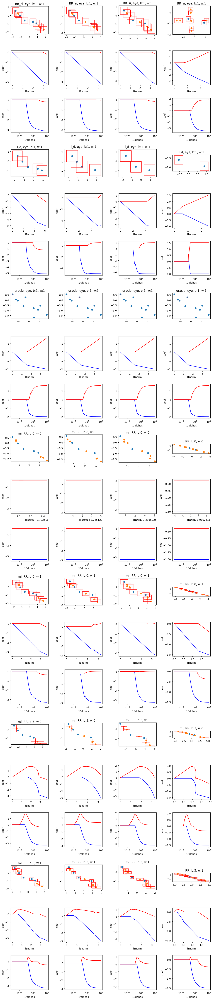

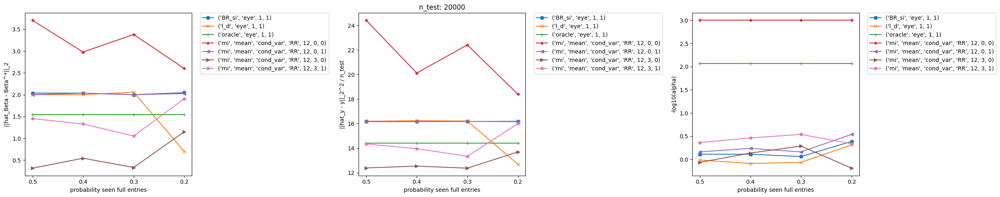

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [0.5, 0.4, 0.3, 0.2]
#p_seen_both = [0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [10] * length_vec
error_vec =  [3.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.1], [-0.1, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 12
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 0.2},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 0.4},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 0.6},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)



## you can see if you manage to take the index i that maximize alpha



change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
n_tot :  20050
n_train :  50
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9975062344139651
err :  {'type': 'Gaussian_on_y', 'scaling': 1}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 

100%|██████████| 200/200 [00:01<00:00, 168.97it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:01<00:00, 190.33it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 275.01it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322

100%|██████████| 200/200 [00:00<00:00, 209.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0729721802596057
---------------------------------> best coeff  [-0.49081702  1.74541476]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322 0.        ]
 [0.         0.98841344]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50

100%|██████████| 200/200 [00:01<00:00, 181.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0840747066440963
---------------------------------> best coeff  [-0.48176214  1.7259404 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322 0.        ]
 [0.         0.98841344]]
shape X_imputed in post_imputation  (30, 50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 221.02it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0729721802596057
---------------------------------> best coeff  [-0.49081702  1.74541476]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322 0.        ]
 [0.         0.98841344]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50

100%|██████████| 200/200 [00:01<00:00, 184.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0840747066440963
---------------------------------> best coeff  [-0.48176214  1.7259404 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.007193367560859
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 283.04it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.1013394821775995
---------------------------------> best coeff  [-0.44530374  1.70358854]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.4329110256081634
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (45, 2)
y_train length  45
-------> size test:  20000  , size train:  45 nbr_seen (train):  45  nbr_miss :  0
X  45 2
Shape  (2, 2)

100%|██████████| 200/200 [00:00<00:00, 292.66it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0902418450986273
---------------------------------> best coeff  [-0.53058805  1.71255944]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 280.65it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.     

100%|██████████| 200/200 [00:00<00:00, 222.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0891861912863199
---------------------------------> best coeff  [-0.45398158  1.72205523]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.        ]
 [0.         0.98687012]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 186.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.0999534537445466
---------------------------------> best coeff  [-0.44733401  1.70536334]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.        ]
 [0.         0.98687012]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:00<00:00, 205.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  1.0996176796841874
---------------------------------> best coeff  [-0.44585668  1.70628609]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.        ]
 [0.         0.98687012]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 182.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  1.1007099913145595
---------------------------------> best coeff  [-0.44632686  1.70436622]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  0.20930921370446076
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 274.85it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.0896928320793562
---------------------------------> best coeff  [-0.47363853  1.71728292]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  4.10308421739518
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 318.90it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0828204286134258
---------------------------------> best coeff  [-0.51376536  1.72560982]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:01<00:00, 181.47it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.      

100%|██████████| 200/200 [00:00<00:00, 214.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.070733224183045
---------------------------------> best coeff  [-0.48706737  1.75018682]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.        ]
 [0.         1.0415273 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> 

100%|██████████| 200/200 [00:01<00:00, 183.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.0816254531336094
---------------------------------> best coeff  [-0.47959965  1.73066074]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.        ]
 [0.         1.0415273 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:00<00:00, 201.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.0815301800717187
---------------------------------> best coeff  [-0.48471309  1.73013492]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.        ]
 [0.         1.0415273 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 120.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  1.0823826881244671
---------------------------------> best coeff  [-0.48111263  1.7290722 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.7466425264544853
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tr

100%|██████████| 200/200 [00:01<00:00, 190.82it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  1.1046233205782992
---------------------------------> best coeff  [-0.55125732  1.68974446]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  9.804616233939843
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (35, 2)
y_train length  35
-------> size test:  20000  , size train:  35 nbr_seen (train):  35  nbr_miss :  0
X  35 2
Shape  (2, 2)
nm  70
one matrix in input, S.s

100%|██████████| 200/200 [00:00<00:00, 323.97it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0609623138474649
---------------------------------> best coeff  [-0.48793896  1.76996506]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 276.82it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.     

100%|██████████| 200/200 [00:01<00:00, 147.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0727090626921443
---------------------------------> best coeff  [-0.55424913  1.74693896]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.        ]
 [0.         1.05170255]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 120.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.0837813162656025
---------------------------------> best coeff  [-0.5435973   1.72476799]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.        ]
 [0.         1.05170255]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 178.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0836175599228208
---------------------------------> best coeff  [-0.55598573  1.72639724]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.        ]
 [0.         1.05170255]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 185.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  1.0843078556881194
---------------------------------> best coeff  [-0.54876853  1.72429443]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -4.047789802668278
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 278.94it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.0868091655219556
---------------------------------> best coeff  [-0.58491344  1.7258529 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.9913598981218077
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)

100%|██████████| 200/200 [00:00<00:00, 352.54it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.1589043778312633
---------------------------------> best coeff  [-0.37446583  1.64250142]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 278.84it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.    

100%|██████████| 200/200 [00:00<00:00, 217.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0840879237749177
---------------------------------> best coeff  [-0.61098162  1.73876738]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.        ]
 [0.         1.06261771]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 186.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.0949805590381383
---------------------------------> best coeff  [-0.5938234   1.71326248]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.        ]
 [0.         1.06261771]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:00<00:00, 204.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  1.0951319866002969
---------------------------------> best coeff  [-0.61048622  1.71781327]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.        ]
 [0.         1.06261771]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 183.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  1.0956913084519908
---------------------------------> best coeff  [-0.60262444  1.71439859]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -7.022556395727712
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 281.08it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.1084099162667969
---------------------------------> best coeff  [-0.62465124  1.69922437]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.121041935369398
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (25, 2)
y_train length  25
-------> size test:  20000  , size train:  25 nbr_seen (train):  25  nbr_miss :  0
X  25 2
Shape  (2, 2)
nm  50
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 360.57it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.0967981637807451
---------------------------------> best coeff  [-0.34498647  1.75556754]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 280.95it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.    

100%|██████████| 200/200 [00:00<00:00, 220.02it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0832267213312703
---------------------------------> best coeff  [-0.61571609  1.74222457]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.        ]
 [0.         1.07801022]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 189.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.0945056487361207
---------------------------------> best coeff  [-0.59618349  1.71472395]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.        ]
 [0.         1.07801022]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:00<00:00, 210.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  1.094410136545183
---------------------------------> best coeff  [-0.61603925  1.7209965 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.        ]
 [0.         1.07801022]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 185.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  1.0953259235880988
---------------------------------> best coeff  [-0.60775947  1.71659721]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -12.577791789099805
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tr

100%|██████████| 200/200 [00:00<00:00, 282.41it/s]


------------------------> who is S in add_rectangles
 [[0.0270496 0.       ]
 [0.        0.0270496]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  1.0900572230926548
---------------------------------> best coeff  [-0.64248809  1.74034545]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -4.808054524578064
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 378.28it/s]


------------------------> who is S in add_rectangles
 [[0.02866068 0.        ]
 [0.         0.02866068]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  58  best 1/best_alpha  34.891012134067715 , min score  1.0545594855780929
---------------------------------> best coeff  [-0.27479378  1.97722665]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X

100%|██████████| 200/200 [00:01<00:00, 182.22it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.     

100%|██████████| 200/200 [00:00<00:00, 217.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.090349213214275
---------------------------------> best coeff  [-0.59698965  1.7224617 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.        ]
 [0.         1.06027591]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 186.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.1011315242165394
---------------------------------> best coeff  [-0.57679994  1.69893993]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.        ]
 [0.         1.06027591]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 171.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.1021041141691306
---------------------------------> best coeff  [-0.5977367   1.70186855]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.        ]
 [0.         1.06027591]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 122.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  1.102330554337527
---------------------------------> best coeff  [-0.59043555  1.69971253]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -9.294933916897701
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 226.55it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.1037141935753572
---------------------------------> best coeff  [-0.63987143  1.71331866]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  0.9683007074276675
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (15, 2)
y_train length  15
-------> size test:  20000  , size train:  15 nbr_seen (train):  15  nbr_miss :  0
X  15 2
Shape  (2, 2)
nm  30
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 406.53it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0872330066977924
---------------------------------> best coeff  [-0.22057681  1.93980554]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 274.59it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.    

100%|██████████| 200/200 [00:01<00:00, 139.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.083557665011493
---------------------------------> best coeff  [-0.56964978  1.72865684]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.        ]
 [0.         1.10393621]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 126.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.0943448083618459
---------------------------------> best coeff  [-0.55099176  1.70682534]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.        ]
 [0.         1.10393621]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 198.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  1.0949647961677904
---------------------------------> best coeff  [-0.56528432  1.70753106]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.        ]
 [0.         1.10393621]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train leng

100%|██████████| 200/200 [00:01<00:00, 141.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  1.095665192957525
---------------------------------> best coeff  [-0.55888518  1.70545235]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -11.895600038831684
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 276.48it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  1.1465755485015174
---------------------------------> best coeff  [-0.65037618  1.64808736]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -1.152543475586873
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 429.94it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.1608578676193428
---------------------------------> best coeff  [-0.10922999  1.94471692]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 270.94it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.     

100%|██████████| 200/200 [00:00<00:00, 219.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.2329452531371081
---------------------------------> best coeff  [-0.66949995  1.54381568]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.        ]
 [0.         1.16466233]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 185.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.24478904517524
---------------------------------> best coeff  [-0.65885712  1.52764487]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.        ]
 [0.         1.16466233]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:00<00:00, 201.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  1.2465403136966293
---------------------------------> best coeff  [-0.66914228  1.52855223]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.        ]
 [0.         1.16466233]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 179.87it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  21  best 1/best_alpha  296.73024081888695 , min score  1.2481879531569942
---------------------------------> best coeff  [-0.66522939  1.52565237]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -14.09304307233639
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 281.92it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  2.3451316358922547
---------------------------------> best coeff  [-1.38369756  1.17251754]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.9460451363288578
[0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (5, 2)
y_train length  5
-------> size test:  20000  , size train:  5 nbr_seen (train):  5  nbr_miss :  0
X  5 2
Shape  (2, 2)
nm  10
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 487.64it/s]


------------------------> who is S in add_rectangles
 [[0.28994229 0.        ]
 [0.         0.28994229]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  98  best 1/best_alpha  3.4489622604057564 , min score  1.0465911831529104
---------------------------------> best coeff  [-0.54361711  2.20843364]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X

100%|██████████| 200/200 [00:00<00:00, 274.93it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0839662396067562
---------------------------------> best coeff  [-0.48411811  1.72582052]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.     

100%|██████████| 200/200 [00:00<00:00, 213.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.667680208403017
---------------------------------> best coeff  [-1.3000515   2.08507821]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.        ]
 [0.         1.20623296]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 184.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  1.310130889417411
---------------------------------> best coeff  [-1.00035819  1.73102911]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.        ]
 [0.         1.20623296]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:00<00:00, 203.48it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  1.3916356679672535
---------------------------------> best coeff  [-0.96101888  1.54773602]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.        ]
 [0.         1.20623296]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 184.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  1.3508577399497346
---------------------------------> best coeff  [-0.92649188  1.56340074]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.48411811,  1.72582052]), array([-0.44530374,  1.70358854]), array([-0.47363853,  1.71728292]), array([-0.55125732,  1.68974446]), array([-0.58491344,  1.7258529 ]), array([-0.62465124,  1.69922437]), array([-0.64248809,  1.74034545]), array([-0.63987143,  1.71331866]), array([-0.65037618,  1.64808736]), array([-1.38369756,  1.17251754])], 'l2_dist_best_coeff_gt': [np.float64(0.2746390793205724), np.float64(0.3014157126600561), np.float64(0.2839434328556291), np.float64(0.31446114394732416), np.float64(0.28699638666266614), np.float64(0.32558241571344787), np.float64(0.2961812658183

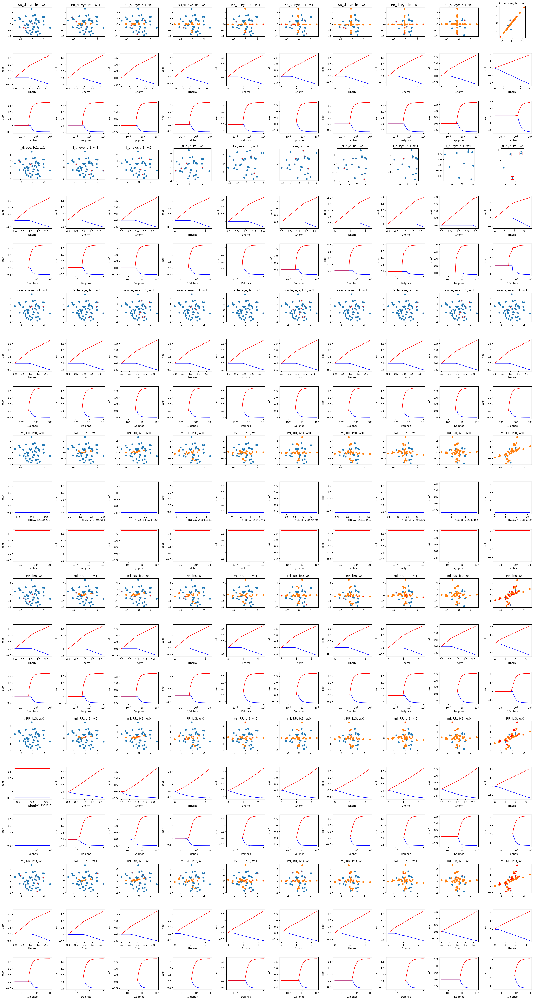

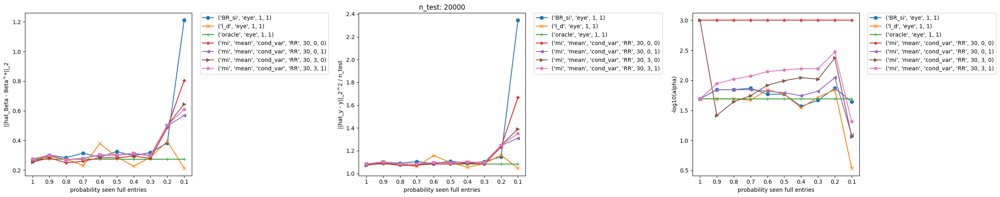

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [50] * length_vec
error_vec =  [1] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.1], [-0.1, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)



## you can see if you manage to take the index i that maximize alpha



change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
n_tot :  20050
n_train :  50
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9975062344139651
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR'

100%|██████████| 200/200 [00:00<00:00, 269.26it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 258.74it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 271.63it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322

100%|██████████| 200/200 [00:00<00:00, 209.55it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.706076129864083
---------------------------------> best coeff  [-0.47704255  1.3635369 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322 0.        ]
 [0.         0.98841344]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50


100%|██████████| 200/200 [00:01<00:00, 176.72it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.7195654606267
---------------------------------> best coeff  [-0.47061797  1.35394373]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322 0.        ]
 [0.         0.98841344]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train 

100%|██████████| 200/200 [00:00<00:00, 208.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.706076129864083
---------------------------------> best coeff  [-0.47704255  1.3635369 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.893153047531018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.22790322 0.98841344]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[1.22790322 0.        ]
 [0.         0.98841344]]
S within 
 [[1.22790322 0.        ]
 [0.         0.98841344]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50


100%|██████████| 200/200 [00:01<00:00, 179.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.7195654606267
---------------------------------> best coeff  [-0.47061797  1.35394373]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.007193367560859
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train l

100%|██████████| 200/200 [00:00<00:00, 261.81it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.780635819388722
---------------------------------> best coeff  [-0.44497359  1.31252005]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.4329110256081634
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (45, 2)
y_train length  45
-------> size test:  20000  , size train:  45 nbr_seen (train):  45  nbr_miss :  0
X  45 2
Shape  (2, 2)

100%|██████████| 200/200 [00:00<00:00, 277.21it/s]


------------------------> who is S in add_rectangles
 [[0.00505263 0.        ]
 [0.         0.00505263]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  6.76011633826279
---------------------------------> best coeff  [-0.58304021  1.32006773]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 268.41it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.     

100%|██████████| 200/200 [00:00<00:00, 210.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.750920718594971
---------------------------------> best coeff  [-0.45703842  1.33226785]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.        ]
 [0.         0.98687012]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 177.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.7642563894376
---------------------------------> best coeff  [-0.45156942  1.32331104]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.        ]
 [0.         0.98687012]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 196.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  6.761967302028305
---------------------------------> best coeff  [-0.45357778  1.32468671]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  60.236584728833776
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.24226369 0.9719711 ]
cov computed
s_between  [0.01700641 0.0144184 ]
final S in cov strategy RR  [[1.25983698 0.        ]
 [0.         0.98687012]]
S within 
 [[1.25983698 0.        ]
 [0.         0.98687012]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 156.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  21  best 1/best_alpha  296.73024081888695 , min score  6.765213563557366
---------------------------------> best coeff  [-0.45147413  1.32263239]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  0.20930921370446076
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:01<00:00, 174.57it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.736728504489061
---------------------------------> best coeff  [-0.46657122  1.34153118]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  4.10308421739518
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:01<00:00, 191.82it/s]


------------------------> who is S in add_rectangles
 [[0.00505263 0.        ]
 [0.         0.00505263]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  6.710818323329848
---------------------------------> best coeff  [-0.54092992  1.35620174]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 272.01it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.      

100%|██████████| 200/200 [00:01<00:00, 188.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.678871781936899
---------------------------------> best coeff  [-0.48135844  1.38437796]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.        ]
 [0.         1.0415273 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> 

100%|██████████| 200/200 [00:01<00:00, 112.86it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.692799381803406
---------------------------------> best coeff  [-0.47571765  1.37398176]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.        ]
 [0.         1.0415273 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 155.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  6.690947724109685
---------------------------------> best coeff  [-0.4802078   1.37495939]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  2.210969194543221
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25523164 1.00712161]
cov computed
s_between  [0.02038961 0.03329583]
final S in cov strategy RR  [[1.27630091 0.        ]
 [0.         1.0415273 ]]
S within 
 [[1.27630091 0.        ]
 [0.         1.0415273 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 176.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  19  best 1/best_alpha  333.1294787934674 , min score  6.694997295861463
---------------------------------> best coeff  [-0.47659195  1.37217067]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.7466425264544853
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 267.40it/s]


------------------------> who is S in add_rectangles
 [[0.00357079 0.        ]
 [0.         0.00357079]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  6.795009184268134
---------------------------------> best coeff  [-0.50040725  1.29619695]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  9.804616233939843
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (35, 2)
y_train length  35
-------> size test:  20000  , size train:  35 nbr_seen (train):  35  nbr_miss :  0
X  35 2
Shape  (2, 2)
nm  70
one matrix in input, S.

100%|██████████| 200/200 [00:00<00:00, 308.13it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.575184545631829
---------------------------------> best coeff  [-0.49078202  1.47208954]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 267.03it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.     

100%|██████████| 200/200 [00:00<00:00, 203.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.679025958463987
---------------------------------> best coeff  [-0.49810023  1.38280156]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.        ]
 [0.         1.05170255]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 172.65it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  6.693273560627826
---------------------------------> best coeff  [-0.49205424  1.37204323]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.        ]
 [0.         1.05170255]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 156.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  6.69156861478863
---------------------------------> best coeff  [-0.49672571  1.37300486]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -5.513794655371985
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.282209   1.00590214]
cov computed
s_between  [0.04420162 0.04432297]
final S in cov strategy RR  [[1.32788401 0.        ]
 [0.         1.05170255]]
S within 
 [[1.32788401 0.        ]
 [0.         1.05170255]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 171.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  18  best 1/best_alpha  352.97073027306504 , min score  6.695622200375045
---------------------------------> best coeff  [-0.49292255  1.3701383 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -4.047789802668278
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 235.86it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.6651463678348115
---------------------------------> best coeff  [-0.57264147  1.39294698]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.9913598981218077
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, 

100%|██████████| 200/200 [00:01<00:00, 178.60it/s]


------------------------> who is S in add_rectangles
 [[0.00337006 0.        ]
 [0.         0.00337006]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  21  best 1/best_alpha  296.73024081888695 , min score  7.189614487645401
---------------------------------> best coeff  [-0.19992407  1.12986605]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:01<00:00, 153.65it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.    

100%|██████████| 200/200 [00:01<00:00, 140.56it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.658941978198566
---------------------------------> best coeff  [-0.60145424  1.40012816]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.        ]
 [0.         1.06261771]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 175.82it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.673156092264925
---------------------------------> best coeff  [-0.59461703  1.3878403 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.        ]
 [0.         1.06261771]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 198.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.672386436969712
---------------------------------> best coeff  [-0.59968804  1.38890435]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -153.31357294711006
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25883092 1.01587785]
cov computed
s_between  [0.03875704 0.04523212]
final S in cov strategy RR  [[1.29887986 0.        ]
 [0.         1.06261771]]
S within 
 [[1.29887986 0.        ]
 [0.         1.06261771]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 176.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  17  best 1/best_alpha  373.9937302478798 , min score  6.675998558409889
---------------------------------> best coeff  [-0.59589817  1.38563902]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -7.022556395727712
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 268.53it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.667733836145744
---------------------------------> best coeff  [-0.58306105  1.39141393]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -2.121041935369398
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (25, 2)
y_train length  25
-------> size test:  20000  , size train:  25 nbr_seen (train):  25  nbr_miss :  0
X  25 2
Shape  (2, 2)
nm  50
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 347.34it/s]


------------------------> who is S in add_rectangles
 [[0.00357079 0.        ]
 [0.         0.00357079]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  6.800689821215383
---------------------------------> best coeff  [-0.12670304  1.42191759]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 271.61it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.    

100%|██████████| 200/200 [00:00<00:00, 212.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.615088688577608
---------------------------------> best coeff  [-0.52579928  1.43451226]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.        ]
 [0.         1.07801022]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 180.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  6.629706703460687
---------------------------------> best coeff  [-0.51826183  1.42218844]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.        ]
 [0.         1.07801022]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 197.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.628750201753931
---------------------------------> best coeff  [-0.52184583  1.42287521]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -210.51239131474136
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30370837 1.02997866]
cov computed
s_between  [0.05539182 0.04648216]
final S in cov strategy RR  [[1.36094658 0.        ]
 [0.         1.07801022]]
S within 
 [[1.36094658 0.        ]
 [0.         1.07801022]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 176.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  15  best 1/best_alpha  419.870708444391 , min score  6.6324499338189735
---------------------------------> best coeff  [-0.51870196  1.4198444 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -12.577791789099805
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 271.89it/s]


------------------------> who is S in add_rectangles
 [[0.00505263 0.        ]
 [0.         0.00505263]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  6.508362255352328
---------------------------------> best coeff  [-0.56466083  1.53719557]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -4.808054524578064
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 370.27it/s]


------------------------> who is S in add_rectangles
 [[0.03036771 0.        ]
 [0.         0.03036771]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  6.524883449333776
---------------------------------> best coeff  [1.44161944e-09 1.94344889e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :

100%|██████████| 200/200 [00:00<00:00, 260.82it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.     

100%|██████████| 200/200 [00:00<00:00, 202.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.542505733396525
---------------------------------> best coeff  [-0.49299666  1.50293275]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.        ]
 [0.         1.06027591]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 177.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  6.55599184441603
---------------------------------> best coeff  [-0.48539288  1.49057001]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.        ]
 [0.         1.06027591]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 189.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  6.556570244777846
---------------------------------> best coeff  [-0.48781767  1.48979655]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -423.6280121022978
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2713758  1.01579568]
cov computed
s_between  [0.05461283 0.04304538]
final S in cov strategy RR  [[1.32780906 0.        ]
 [0.         1.06027591]]
S within 
 [[1.32780906 0.        ]
 [0.         1.06027591]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 134.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  17  best 1/best_alpha  373.9937302478798 , min score  6.559916845416221
---------------------------------> best coeff  [-0.48493857  1.48688264]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -9.294933916897701
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:01<00:00, 174.18it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.571932770596366
---------------------------------> best coeff  [-0.58380138  1.4752976 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  0.9683007074276675
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (15, 2)
y_train length  15
-------> size test:  20000  , size train:  15 nbr_seen (train):  15  nbr_miss :  0
X  15 2
Shape  (2, 2)
nm  30
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 318.73it/s]


------------------------> who is S in add_rectangles
 [[0.06442364 0.        ]
 [0.         0.06442364]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.608439818690279
---------------------------------> best coeff  [7.10393744e-09 1.75222414e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :

100%|██████████| 200/200 [00:00<00:00, 255.93it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.    

100%|██████████| 200/200 [00:01<00:00, 169.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.553696944936205
---------------------------------> best coeff  [-0.46634897  1.49489539]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.        ]
 [0.         1.10393621]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 117.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.567540360489926
---------------------------------> best coeff  [-0.45795837  1.48293872]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.        ]
 [0.         1.10393621]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 173.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  6.567814311411069
---------------------------------> best coeff  [-0.45999128  1.4823922 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -251.17526891938536
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.28727998 1.04508904]
cov computed
s_between  [0.07862831 0.05694888]
final S in cov strategy RR  [[1.36852922 0.        ]
 [0.         1.10393621]]
S within 
 [[1.36852922 0.        ]
 [0.         1.10393621]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 174.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  15  best 1/best_alpha  419.870708444391 , min score  6.570868664068276
---------------------------------> best coeff  [-0.45735204  1.47992043]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -11.895600038831684
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 258.54it/s]


------------------------> who is S in add_rectangles
 [[0.00378346 0.        ]
 [0.         0.00378346]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  6.769001586176535
---------------------------------> best coeff  [-0.59732852  1.31440392]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -1.152543475586873
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 421.09it/s]


------------------------> who is S in add_rectangles
 [[0.12898903 0.        ]
 [0.         0.12898903]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  84  best 1/best_alpha  7.752597488629456 , min score  6.78947240154659
---------------------------------> best coeff  [0.06467977 1.60924459]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 

100%|██████████| 200/200 [00:00<00:00, 262.64it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.     

100%|██████████| 200/200 [00:00<00:00, 207.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.985022708787907
---------------------------------> best coeff  [-0.64043506  1.17451624]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.        ]
 [0.         1.16466233]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 176.93it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  20  best 1/best_alpha  314.40354715915 , min score  7.000581324083759
---------------------------------> best coeff  [-0.63324034  1.16445109]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.        ]
 [0.         1.16466233]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  5

100%|██████████| 200/200 [00:01<00:00, 189.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  14  best 1/best_alpha  444.8782831127586 , min score  7.002958265530964
---------------------------------> best coeff  [-0.63706098  1.16334474]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -399.4337140131123
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30334211 1.08043862]
cov computed
s_between  [0.08136108 0.08150682]
final S in cov strategy RR  [[1.38741522 0.        ]
 [0.         1.16466233]]
S within 
 [[1.38741522 0.        ]
 [0.         1.16466233]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 172.61it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  10  best 1/best_alpha  560.7169938205458 , min score  7.008057923422563
---------------------------------> best coeff  [-0.63371701  1.15999901]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -14.09304307233639
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 264.68it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  7.785534390453341
---------------------------------> best coeff  [-1.4106928   1.11641924]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.9460451363288578
[0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (5, 2)
y_train length  5
-------> size test:  20000  , size train:  5 nbr_seen (train):  5  nbr_miss :  0
X  5 2
Shape  (2, 2)
nm  10
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 471.92it/s]


------------------------> who is S in add_rectangles
 [[0.32550886 0.        ]
 [0.         0.32550886]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  100  best 1/best_alpha  3.072112998861756 , min score  6.467140180520284
---------------------------------> best coeff  [-0.05947468  2.17566719]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -0.09643843491769896
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 264.63it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.719532081827194
---------------------------------> best coeff  [-0.47196414  1.35381456]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.     

100%|██████████| 200/200 [00:00<00:00, 209.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.788926850927604
---------------------------------> best coeff  [-1.17542504  1.75075025]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.        ]
 [0.         1.20623296]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 175.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  6.740689917846566
---------------------------------> best coeff  [-1.09157109  1.64576801]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.        ]
 [0.         1.20623296]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 193.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  6.7596191170522335
---------------------------------> best coeff  [-1.12217297  1.67376871]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.22790322 0.98841344]
crush test------------------------------------------------->  -296.9705413867198
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31615443 1.11426285]
cov computed
s_between  [0.08527207 0.08900334]
final S in cov strategy RR  [[1.4042689  0.        ]
 [0.         1.20623296]]
S within 
 [[1.4042689  0.        ]
 [0.         1.20623296]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 179.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  6.751429346501765
---------------------------------> best coeff  [-1.10859015  1.66022768]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.47196414,  1.35381456]), array([-0.44497359,  1.31252005]), array([-0.46657122,  1.34153118]), array([-0.50040725,  1.29619695]), array([-0.57264147,  1.39294698]), array([-0.58306105,  1.39141393]), array([-0.56466083,  1.53719557]), array([-0.58380138,  1.4752976 ]), array([-0.59732852,  1.31440392]), array([-1.4106928 ,  1.11641924])], 'l2_dist_best_coeff_gt': [np.float64(0.64679334103366), np.float64(0.6896786116241257), np.float64(0.6593168161640556), np.float64(0.7038031639665852), np.float64(0.6113838001427904), np.float64(0.6142280851982357), np.float64(0.4672996509294577),

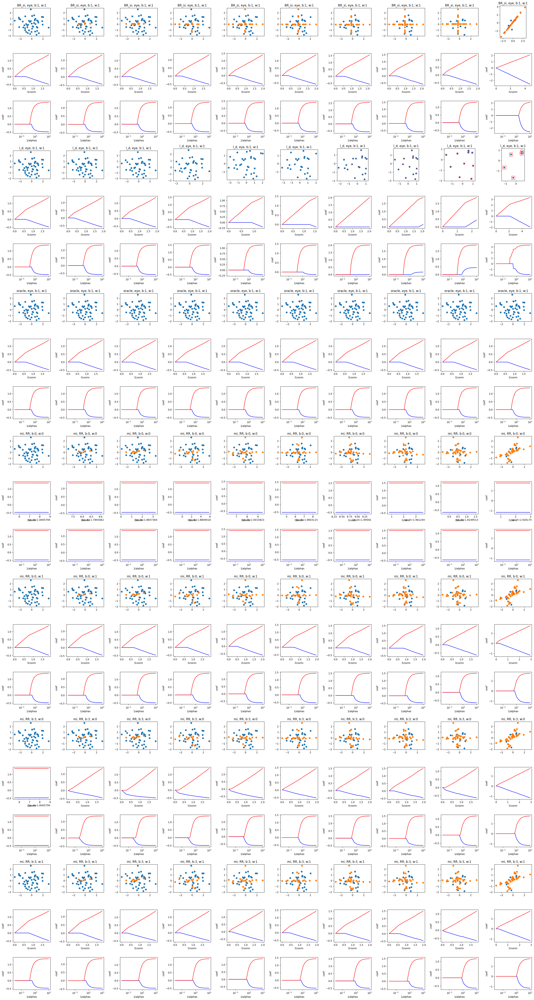

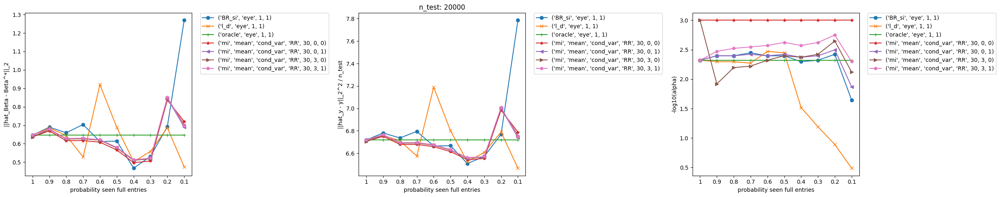

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [50] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.1], [-0.1, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
# same setting as above, higher error (=2.5), low correlation (-0.1), small training set (50)

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR

100%|██████████| 200/200 [00:01<00:00, 182.79it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 180.72it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 141.35it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  23.532348549013044
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [6.66133815e-16 4.44089210e-16]
fina

100%|██████████| 200/200 [00:02<00:00, 85.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.3327000819044175
---------------------------------> best coeff  [-0.744626    1.88028507]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  23.532348549013044
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [6.66133815e-16 4.44089210e-16]
final S in cov strategy RR  [[1.0561488 0.       ]
 [0.        0.9672674]]
S within 
 [[1.0561488 0.       ]
 

100%|██████████| 200/200 [00:02<00:00, 74.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.334055354788371
---------------------------------> best coeff  [-0.61130881  1.71671338]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  23.532348549013044
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [6.66133815e-16 4.44089210e-16]
final S in cov strategy RR  [[1.0561488 0.       ]
 [0.        0.9672674]]
S within 
 [[1.0561488 

100%|██████████| 200/200 [00:01<00:00, 112.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.3327000819044175
---------------------------------> best coeff  [-0.744626    1.88028507]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  23.532348549013044
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [6.66133815e-16 4.44089210e-16]
final S in cov strategy RR  [[1.0561488 0.       ]
 [0.        0.9672674]]
S within 
 [[1.0561488 0.       ]
 

100%|██████████| 200/200 [00:04<00:00, 45.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.334055354788371
---------------------------------> best coeff  [-0.61130881  1.71671338]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -3.7832962574137703
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:02<00:00, 78.01it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.354687329706248
---------------------------------> best coeff  [-0.64944819  1.69184609]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -1.6926100755171287
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputat

100%|██████████| 200/200 [00:01<00:00, 187.48it/s]


------------------------> who is S in add_rectangles
 [[0.06442364 0.        ]
 [0.         0.06442364]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.392867507144988
---------------------------------> best coeff  [-0.71333591  1.65876215]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 150.55it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -136.33586262717063
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06513854 0.97906114]
cov computed
s_between  [0.01828565 0.01394765]
final S i

100%|██████████| 200/200 [00:02<00:00, 75.44it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.352210537989202
---------------------------------> best coeff  [-0.77312748  1.84649255]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -136.33586262717063
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06513854 0.97906114]
cov computed
s_between  [0.01828565 0.01394765]
final S in cov strategy RR  [[1.08403371 0.        ]
 [0.         0.99347371]]
S within 
 [[1.08403371 0.        ]
 

100%|██████████| 200/200 [00:05<00:00, 36.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  6.3545765396745955
---------------------------------> best coeff  [-0.64041962  1.68751429]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -136.33586262717063
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06513854 0.97906114]
cov computed
s_between  [0.01828565 0.01394765]
final S in cov strategy RR  [[1.08403371 0.        ]
 [0.         0.99347371]]
S within 
 [[1.08403371 0

100%|██████████| 200/200 [00:02<00:00, 79.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  6.347567655285863
---------------------------------> best coeff  [-0.75983069  1.83404654]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -136.33586262717063
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06513854 0.97906114]
cov computed
s_between  [0.01828565 0.01394765]
final S in cov strategy RR  [[1.08403371 0.        ]
 [0.         0.99347371]]
S within 
 [[1.08403371 0

100%|██████████| 200/200 [00:01<00:00, 105.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.3513319857149115
---------------------------------> best coeff  [-0.77039536  1.84319328]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -6.6383486239588745
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 

100%|██████████| 200/200 [00:01<00:00, 184.56it/s]


------------------------> who is S in add_rectangles
 [[0.00954772 0.        ]
 [0.         0.00954772]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  6.367209241987095
---------------------------------> best coeff  [-0.79729401  1.83870348]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -4.304243621644068
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  80

100%|██████████| 200/200 [00:00<00:00, 218.25it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  6.400390362007368
---------------------------------> best coeff  [-0.83165864  1.78701228]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 184.47it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -256.25598859465777
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07115452 0.98015838]
cov computed
s_between  [0.02120844 0.02416966]
final S i

100%|██████████| 200/200 [00:02<00:00, 76.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.3850611489087274
---------------------------------> best coeff  [-0.82379706  1.83012745]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -256.25598859465777
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07115452 0.98015838]
cov computed
s_between  [0.02120844 0.02416966]
final S in cov strategy RR  [[1.0930699 0.       ]
 [0.        1.0051337]]
S within 
 [[1.0930699 0.       ]
 [0.  

100%|██████████| 200/200 [00:02<00:00, 75.48it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  6.38161006864313
---------------------------------> best coeff  [-0.81420499  1.8179313 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -256.25598859465777
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07115452 0.98015838]
cov computed
s_between  [0.02120844 0.02416966]
final S in cov strategy RR  [[1.0930699 0.       ]
 [0.        1.0051337]]
S within 
 [[1.0930699 0.     

100%|██████████| 200/200 [00:01<00:00, 104.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  6.390199090085585
---------------------------------> best coeff  [-0.74016254  1.68502572]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -256.25598859465777
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07115452 0.98015838]
cov computed
s_between  [0.02120844 0.02416966]
final S in cov strategy RR  [[1.0930699 0.       ]
 [0.        1.0051337]]
S within 
 [[1.0930699 0.    

100%|██████████| 200/200 [00:02<00:00, 83.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.384586864719347
---------------------------------> best coeff  [-0.70961585  1.67142848]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -6.075756406503891
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 138.41it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.3578573694601355
---------------------------------> best coeff  [-0.65804543  1.69019607]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.5378107783792716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  , 

100%|██████████| 200/200 [00:01<00:00, 150.09it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  6.490705068350847
---------------------------------> best coeff  [-0.92154613  1.7144999 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:02<00:00, 86.05it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -164.74500345841693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07989083 0.99405982]
cov computed
s_between  [0.02548851 0.02659406]
final S i

100%|██████████| 200/200 [00:02<00:00, 80.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.349471983638054
---------------------------------> best coeff  [-0.76110839  1.82800328]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -164.74500345841693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07989083 0.99405982]
cov computed
s_between  [0.02548851 0.02659406]
final S in cov strategy RR  [[1.10622896 0.        ]
 [0.         1.02154034]]
S within 
 [[1.10622896 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 94.30it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  6.353805480857659
---------------------------------> best coeff  [-0.64959697  1.69369423]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -164.74500345841693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07989083 0.99405982]
cov computed
s_between  [0.02548851 0.02659406]
final S in cov strategy RR  [[1.10622896 0.        ]
 [0.         1.02154034]]
S within 
 [[1.10622896 0

100%|██████████| 200/200 [00:01<00:00, 125.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.358917195433996
---------------------------------> best coeff  [-0.69383915  1.71187002]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -164.74500345841693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07989083 0.99405982]
cov computed
s_between  [0.02548851 0.02659406]
final S in cov strategy RR  [[1.10622896 0.        ]
 [0.         1.02154034]]
S within 
 [[1.10622896 

100%|██████████| 200/200 [00:01<00:00, 104.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.356963599750255
---------------------------------> best coeff  [-0.66156176  1.69400303]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -1.725914571634827
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 141.28it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.3238949189581
---------------------------------> best coeff  [-0.72847127  1.89139002]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.5967064044273425
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (train):

100%|██████████| 200/200 [00:01<00:00, 162.64it/s]


------------------------> who is S in add_rectangles
 [[0.06826072 0.        ]
 [0.         0.06826072]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.417102140455704
---------------------------------> best coeff  [-0.84556598  1.76202891]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 157.65it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -50.23039903506256
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08826951 0.98688271]
cov computed
s_between  [0.03133607 0.02792773]
final S in

100%|██████████| 200/200 [00:02<00:00, 87.00it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.32275138682582
---------------------------------> best coeff  [-0.72853668  1.90602556]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -50.23039903506256
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08826951 0.98688271]
cov computed
s_between  [0.03133607 0.02792773]
final S in cov strategy RR  [[1.12065013 0.        ]
 [0.         1.01574137]]
S within 
 [[1.12065013 0.        ]
 [0

100%|██████████| 200/200 [00:02<00:00, 90.65it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.318354154621237
---------------------------------> best coeff  [-0.71587525  1.89060702]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -50.23039903506256
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08826951 0.98688271]
cov computed
s_between  [0.03133607 0.02792773]
final S in cov strategy RR  [[1.12065013 0.        ]
 [0.         1.01574137]]
S within 
 [[1.12065013 0

100%|██████████| 200/200 [00:02<00:00, 98.15it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3231035238637405
---------------------------------> best coeff  [-0.62456286  1.74893879]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -50.23039903506256
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08826951 0.98688271]
cov computed
s_between  [0.03133607 0.02792773]
final S in cov strategy RR  [[1.12065013 0.        ]
 [0.         1.01574137]]
S within 
 [[1.12065013 

100%|██████████| 200/200 [00:01<00:00, 104.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  8  best 1/best_alpha  629.4988990221888 , min score  6.3202556169525375
---------------------------------> best coeff  [-0.72152437  1.89694678]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -8.78422798256831
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [

100%|██████████| 200/200 [00:01<00:00, 178.47it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.348826033971202
---------------------------------> best coeff  [-0.76599503  1.8441799 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -1.6449267746411445
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 

100%|██████████| 200/200 [00:00<00:00, 270.35it/s]


------------------------> who is S in add_rectangles
 [[0.10234114 0.        ]
 [0.         0.10234114]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  80  best 1/best_alpha  9.77124153534649 , min score  6.434508814139708
---------------------------------> best coeff  [-0.86538942  1.7507481 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
sh

100%|██████████| 200/200 [00:01<00:00, 178.53it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -202.84314311253223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.064202   1.00811598]
cov computed
s_between  [0.03766462 0.03516987]
final S i

100%|██████████| 200/200 [00:01<00:00, 133.52it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.347851823046284
---------------------------------> best coeff  [-0.77866532  1.91784699]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -202.84314311253223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.064202   1.00811598]
cov computed
s_between  [0.03766462 0.03516987]
final S in cov strategy RR  [[1.10312211 0.        ]
 [0.         1.04445818]]
S within 
 [[1.10312211 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 103.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  6.330244046671329
---------------------------------> best coeff  [-0.73657127  1.86903665]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -202.84314311253223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.064202   1.00811598]
cov computed
s_between  [0.03766462 0.03516987]
final S in cov strategy RR  [[1.10312211 0.        ]
 [0.         1.04445818]]
S within 
 [[1.10312211 0

100%|██████████| 200/200 [00:02<00:00, 90.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  6.338403273445175
---------------------------------> best coeff  [-0.75745244  1.8872882 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -202.84314311253223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.064202   1.00811598]
cov computed
s_between  [0.03766462 0.03516987]
final S in cov strategy RR  [[1.10312211 0.        ]
 [0.         1.04445818]]
S within 
 [[1.10312211 0

100%|██████████| 200/200 [00:02<00:00, 85.19it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  6.33406374740598
---------------------------------> best coeff  [-0.74662854  1.87700539]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -5.908209706502745
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 181.99it/s]


------------------------> who is S in add_rectangles
 [[0.06826072 0.        ]
 [0.         0.06826072]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.358926382724343
---------------------------------> best coeff  [-0.78120788  1.83409852]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.5860083850775002
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 313.71it/s]


------------------------> who is S in add_rectangles
 [[0.16257557 0.        ]
 [0.         0.16257557]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  88  best 1/best_alpha  6.150985788580498 , min score  6.428174884108926
---------------------------------> best coeff  [-0.85646397  1.75107856]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 176.00it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -193.27338957131815
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05687535 1.0068715 ]
cov computed
s_between  [0.0318922  0.04123104]
final S i

100%|██████████| 200/200 [00:01<00:00, 136.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.4174554927964005
---------------------------------> best coeff  [-0.85882991  2.06329596]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -193.27338957131815
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05687535 1.0068715 ]
cov computed
s_between  [0.0318922  0.04123104]
final S in cov strategy RR  [[1.08983063 0.        ]
 [0.         1.0494769 ]]
S within 
 [[1.08983063 0.        ]


100%|██████████| 200/200 [00:01<00:00, 104.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  6.318691495713309
---------------------------------> best coeff  [-0.71847304  1.89951998]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -193.27338957131815
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05687535 1.0068715 ]
cov computed
s_between  [0.0318922  0.04123104]
final S in cov strategy RR  [[1.08983063 0.        ]
 [0.         1.0494769 ]]
S within 
 [[1.08983063 0

100%|██████████| 200/200 [00:01<00:00, 126.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.334415082863524
---------------------------------> best coeff  [-0.75425891  1.92764735]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -193.27338957131815
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05687535 1.0068715 ]
cov computed
s_between  [0.0318922  0.04123104]
final S in cov strategy RR  [[1.08983063 0.        ]
 [0.         1.0494769 ]]
S within 
 [[1.08983063 0

100%|██████████| 200/200 [00:02<00:00, 75.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.324321604707663
---------------------------------> best coeff  [-0.73258221  1.91123441]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -3.463162670080039
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 134.83it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.375154214272091
---------------------------------> best coeff  [-0.80077179  1.81087106]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.9701698701282395
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 233.72it/s]


------------------------> who is S in add_rectangles
 [[0.1084366 0.       ]
 [0.        0.1084366]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  6.473470394766142
---------------------------------> best coeff  [-0.89300744  1.70243853]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape

100%|██████████| 200/200 [00:01<00:00, 146.96it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -18.137024818570225
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0881684  1.04594412]
cov computed
s_between  [0.03908649 0.03239589]
final S i

100%|██████████| 200/200 [00:02<00:00, 90.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.369197147246803
---------------------------------> best coeff  [-0.78631239  2.06680315]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -18.137024818570225
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0881684  1.04594412]
cov computed
s_between  [0.03908649 0.03239589]
final S in cov strategy RR  [[1.12855777 0.        ]
 [0.         1.07941988]]
S within 
 [[1.12855777 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 85.16it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  58  best 1/best_alpha  34.891012134067715 , min score  6.295282421809816
---------------------------------> best coeff  [-0.66277404  1.93536973]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -18.137024818570225
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0881684  1.04594412]
cov computed
s_between  [0.03908649 0.03239589]
final S in cov strategy RR  [[1.12855777 0.        ]
 [0.         1.07941988]]
S within 
 [[1.12855777 

100%|██████████| 200/200 [00:01<00:00, 124.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.303793887774997
---------------------------------> best coeff  [-0.68652534  1.93682531]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -18.137024818570225
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0881684  1.04594412]
cov computed
s_between  [0.03908649 0.03239589]
final S in cov strategy RR  [[1.12855777 0.        ]
 [0.         1.07941988]]
S within 
 [[1.12855777 0

100%|██████████| 200/200 [00:01<00:00, 105.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  6.299655737419413
---------------------------------> best coeff  [-0.67540534  1.93683668]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.6502907944359198
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [

100%|██████████| 200/200 [00:01<00:00, 187.00it/s]


------------------------> who is S in add_rectangles
 [[0.06442364 0.        ]
 [0.         0.06442364]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.4077245988736395
---------------------------------> best coeff  [-0.84125354  1.78328044]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  5.905774078394228
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 398.83it/s]


------------------------> who is S in add_rectangles
 [[0.1722586 0.       ]
 [0.        0.1722586]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  89  best 1/best_alpha  5.805225516094896 , min score  6.5987863734704515
---------------------------------> best coeff  [-0.8458575   1.46717399]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shap

100%|██████████| 200/200 [00:01<00:00, 178.77it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  176.37175093293217
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08734075 1.02731921]
cov computed
s_between  [0.04561827 0.04058408]
final S in

100%|██████████| 200/200 [00:01<00:00, 133.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.318519814027252
---------------------------------> best coeff  [-0.72029925  1.96629674]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  176.37175093293217
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08734075 1.02731921]
cov computed
s_between  [0.04561827 0.04058408]
final S in cov strategy RR  [[1.13447963 0.        ]
 [0.         1.06925609]]
S within 
 [[1.13447963 0.        ]
 [

100%|██████████| 200/200 [00:01<00:00, 102.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  6.300683735083475
---------------------------------> best coeff  [-0.6765142   1.91808214]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  176.37175093293217
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08734075 1.02731921]
cov computed
s_between  [0.04561827 0.04058408]
final S in cov strategy RR  [[1.13447963 0.        ]
 [0.         1.06925609]]
S within 
 [[1.13447963 0. 

100%|██████████| 200/200 [00:01<00:00, 121.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  6.30658755519352
---------------------------------> best coeff  [-0.69326153  1.92851596]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  176.37175093293217
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08734075 1.02731921]
cov computed
s_between  [0.04561827 0.04058408]
final S in cov strategy RR  [[1.13447963 0.        ]
 [0.         1.06925609]]
S within 
 [[1.13447963 0.

100%|██████████| 200/200 [00:02<00:00, 67.50it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.303586635433967
---------------------------------> best coeff  [-0.68489582  1.9220233 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -4.699507576927374
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 182.52it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.3843131751919096
---------------------------------> best coeff  [-0.67629599  1.65109006]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.8851131390289394
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 438.67it/s]


------------------------> who is S in add_rectangles
 [[0.00714943 0.        ]
 [0.         0.00714943]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  7.0315599411358605
---------------------------------> best coeff  [-1.02955796  1.21183659]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 177.27it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.3342040313716925
---------------------------------> best coeff  [-0.62558899  1.72295075]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -99.96177298500345
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08483265 1.05056894]
cov computed
s_between  [0.0538905  0.05986716]
final S in

100%|██████████| 200/200 [00:01<00:00, 115.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.311556408329387
---------------------------------> best coeff  [-0.67640802  2.05327278]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -99.96177298500345
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08483265 1.05056894]
cov computed
s_between  [0.0538905  0.05986716]
final S in cov strategy RR  [[1.1405195  0.        ]
 [0.         1.11243167]]
S within 
 [[1.1405195  0.        ]
 [

100%|██████████| 200/200 [00:01<00:00, 104.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  6.282628505740496
---------------------------------> best coeff  [-0.61681099  1.97999459]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -99.96177298500345
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08483265 1.05056894]
cov computed
s_between  [0.0538905  0.05986716]
final S in cov strategy RR  [[1.1405195  0.        ]
 [0.         1.11243167]]
S within 
 [[1.1405195  0.

100%|██████████| 200/200 [00:01<00:00, 121.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  6.287271221517889
---------------------------------> best coeff  [-0.63293975  1.98478243]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -99.96177298500345
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08483265 1.05056894]
cov computed
s_between  [0.0538905  0.05986716]
final S in cov strategy RR  [[1.1405195  0.        ]
 [0.         1.11243167]]
S within 
 [[1.1405195  0

100%|██████████| 200/200 [00:01<00:00, 104.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.284936171151294
---------------------------------> best coeff  [-0.6253804   1.98120201]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.62558899,  1.72295075]), array([-0.64944819,  1.69184609]), array([-0.79729401,  1.83870348]), array([-0.65804543,  1.69019607]), array([-0.72847127,  1.89139002]), array([-0.76599503,  1.8441799 ]), array([-0.78120788,  1.83409852]), array([-0.80077179,  1.81087106]), array([-0.84125354,  1.78328044]), array([-0.67629599,  1.65109006])], 'l2_dist_best_coeff_gt': [np.float64(0.3041855973620436), np.float64(0.3424815279446657), np.float64(0.33823112694407664), np.float64(0.34778848707023224), np.float64(0.2529728211102467), np.float64(0.30827465015209027), np.float64(0.3264983534651

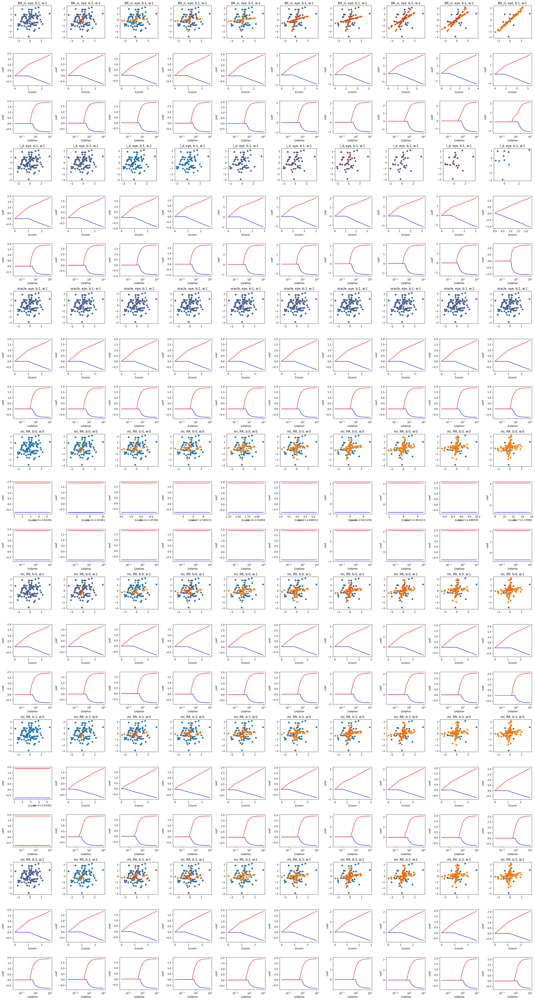

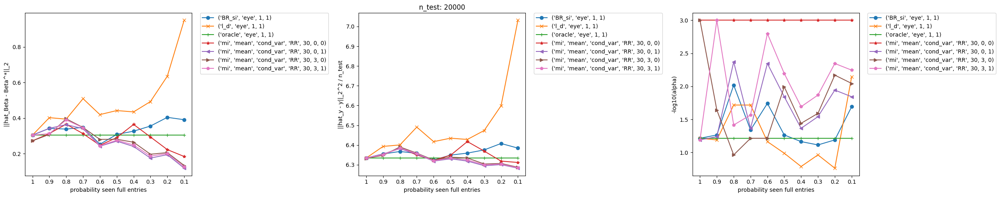

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.1], [-0.1, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
## same setting as before, higher number of training points (100), moderate error (2.5), low correlation (-0.1)
## we can see that multiple imputation start being significantly beneficial

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
n_tot :  20050
n_train :  50
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9975062344139651
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR'

100%|██████████| 200/200 [00:00<00:00, 281.05it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 273.71it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X

100%|██████████| 200/200 [00:00<00:00, 276.58it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -1.9287686983540917
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.18841562 0.99275592]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.18841562 0.        ]
 [0.         0.99275592]]
S within 
 [[1.188415

100%|██████████| 200/200 [00:00<00:00, 216.62it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.706076130810352
---------------------------------> best coeff  [-0.68674792  1.26648945]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -1.9287686983540917
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.18841562 0.99275592]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.18841562 0.        ]
 [0.         0.99275592]]
S within 
 [[1.18841562 0.        ]
 [0.         0.99275592]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50

100%|██████████| 200/200 [00:01<00:00, 142.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.718746247354316
---------------------------------> best coeff  [-0.68232618  1.25817629]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -1.9287686983540917
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.18841562 0.99275592]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.18841562 0.        ]
 [0.         0.99275592]]
S within 
 [[1.18841562 0.        ]
 [0.         0.99275592]]
shape X_imputed in post_imputation  (30, 50, 2)
y_tra

100%|██████████| 200/200 [00:02<00:00, 71.30it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.706076130810352
---------------------------------> best coeff  [-0.68674792  1.26648945]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -1.9287686983540917
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.18841562 0.99275592]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.18841562 0.        ]
 [0.         0.99275592]]
S within 
 [[1.18841562 0.        ]
 [0.         0.99275592]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50

100%|██████████| 200/200 [00:01<00:00, 183.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.718746247354316
---------------------------------> best coeff  [-0.68232618  1.25817629]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  1.825531875796629
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:01<00:00, 116.74it/s]


------------------------> who is S in add_rectangles
 [[0.00450056 0.        ]
 [0.         0.00450056]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.820511890193751
---------------------------------> best coeff  [-0.7134729   1.17033232]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  1.6219406837387749
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (45, 2)
y_train length  45
-------> size test:  20000  , size train:  45 nbr_seen (train):  45  nbr_miss :  0
X  45 2
Shape  (2, 2)

100%|██████████| 200/200 [00:01<00:00, 117.21it/s]


------------------------> who is S in add_rectangles
 [[0.00567243 0.        ]
 [0.         0.00567243]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.759595970852757
---------------------------------> best coeff  [-0.82525335  1.18060816]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:01<00:00, 134.94it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  55.08392733433884
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.19636873 0.98363063]
cov computed
s_between  [0.01029328 0.0115428 ]
final S in cov strategy RR  [[1.20700512 0.        ]
 [0.         0.99555818]]
S within 
 [[1.20700512 0.     

100%|██████████| 200/200 [00:00<00:00, 217.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.789474695391531
---------------------------------> best coeff  [-0.71657306  1.19153295]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  55.08392733433884
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.19636873 0.98363063]
cov computed
s_between  [0.01029328 0.0115428 ]
final S in cov strategy RR  [[1.20700512 0.        ]
 [0.         0.99555818]]
S within 
 [[1.20700512 0.        ]
 [0.         0.99555818]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> 

100%|██████████| 200/200 [00:01<00:00, 189.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.802383873221098
---------------------------------> best coeff  [-0.7132309   1.18339793]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  55.08392733433884
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.19636873 0.98363063]
cov computed
s_between  [0.01029328 0.0115428 ]
final S in cov strategy RR  [[1.20700512 0.        ]
 [0.         0.99555818]]
S within 
 [[1.20700512 0.        ]
 [0.         0.99555818]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:00<00:00, 206.00it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  6.8005051315342335
---------------------------------> best coeff  [-0.71735476  1.18320477]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  55.08392733433884
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.19636873 0.98363063]
cov computed
s_between  [0.01029328 0.0115428 ]
final S in cov strategy RR  [[1.20700512 0.        ]
 [0.         0.99555818]]
S within 
 [[1.20700512 0.        ]
 [0.         0.99555818]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 144.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.80358921266245
---------------------------------> best coeff  [-0.71399324  1.18223941]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  0.9367410163939305
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:01<00:00, 186.72it/s]


------------------------> who is S in add_rectangles
 [[0.00450056 0.        ]
 [0.         0.00450056]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.757492798574611
---------------------------------> best coeff  [-0.70107638  1.22114264]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  2.7353894782634542
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one mat

100%|██████████| 200/200 [00:00<00:00, 223.79it/s]


------------------------> who is S in add_rectangles
 [[0.00567243 0.        ]
 [0.         0.00567243]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.710368093630242
---------------------------------> best coeff  [-0.76413181  1.23673201]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 276.48it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  21.654970174357704
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.20576413 1.00389   ]
cov computed
s_between  [0.01316282 0.02935769]
final S in cov strategy RR  [[1.2193657  0.        ]
 [0.         1.03422629]]
S within 
 [[1.2193657  0.    

100%|██████████| 200/200 [00:00<00:00, 221.25it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.695246441206857
---------------------------------> best coeff  [-0.69472572  1.27219539]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  21.654970174357704
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.20576413 1.00389   ]
cov computed
s_between  [0.01316282 0.02935769]
final S in cov strategy RR  [[1.2193657  0.        ]
 [0.         1.03422629]]
S within 
 [[1.2193657  0.        ]
 [0.         1.03422629]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 119.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.7082655163425935
---------------------------------> best coeff  [-0.69178342  1.26282919]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  21.654970174357704
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.20576413 1.00389   ]
cov computed
s_between  [0.01316282 0.02935769]
final S in cov strategy RR  [[1.2193657  0.        ]
 [0.         1.03422629]]
S within 
 [[1.2193657  0.        ]
 [0.         1.03422629]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 154.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  6.707586984132059
---------------------------------> best coeff  [-0.69888337  1.2607176 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  21.654970174357704
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.20576413 1.00389   ]
cov computed
s_between  [0.01316282 0.02935769]
final S in cov strategy RR  [[1.2193657  0.        ]
 [0.         1.03422629]]
S within 
 [[1.2193657  0.        ]
 [0.         1.03422629]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 185.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  21  best 1/best_alpha  296.73024081888695 , min score  6.71025469546809
---------------------------------> best coeff  [-0.69460223  1.26018381]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  2.545468650929328
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train 

100%|██████████| 200/200 [00:00<00:00, 278.54it/s]


------------------------> who is S in add_rectangles
 [[0.00424757 0.        ]
 [0.         0.00424757]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  6.7760381149214055
---------------------------------> best coeff  [-0.60762605  1.24757387]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  6.5364108226265625
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (35, 2)
y_train length  35
-------> size test:  20000  , size train:  35 nbr_seen (train):  35  nbr_miss :  0
X  35 2
Shape  (2, 2)
nm  70
one matrix in input, S

100%|██████████| 200/200 [00:00<00:00, 325.60it/s]


------------------------> who is S in add_rectangles
 [[0.00601028 0.        ]
 [0.         0.00601028]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  6.574702876402023
---------------------------------> best coeff  [-0.66682455  1.38858599]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 281.03it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  64.76794069687489
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.24029484 1.0017714 ]
cov computed
s_between  [0.04095369 0.05475428]
final S in cov strategy RR  [[1.28261366 0.        ]
 [0.         1.05835082]]
S within 
 [[1.28261366 0.     

100%|██████████| 200/200 [00:01<00:00, 157.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.65209273605121
---------------------------------> best coeff  [-0.58581206  1.35395929]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  64.76794069687489
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.24029484 1.0017714 ]
cov computed
s_between  [0.04095369 0.05475428]
final S in cov strategy RR  [[1.28261366 0.        ]
 [0.         1.05835082]]
S within 
 [[1.28261366 0.        ]
 [0.         1.05835082]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> s

100%|██████████| 200/200 [00:01<00:00, 104.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.665035881650142
---------------------------------> best coeff  [-0.58258516  1.34483593]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  64.76794069687489
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.24029484 1.0017714 ]
cov computed
s_between  [0.04095369 0.05475428]
final S in cov strategy RR  [[1.28261366 0.        ]
 [0.         1.05835082]]
S within 
 [[1.28261366 0.        ]
 [0.         1.05835082]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:02<00:00, 88.90it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  6.6636317232280025
---------------------------------> best coeff  [-0.58964626  1.34257974]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  64.76794069687489
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.24029484 1.0017714 ]
cov computed
s_between  [0.04095369 0.05475428]
final S in cov strategy RR  [[1.28261366 0.        ]
 [0.         1.05835082]]
S within 
 [[1.28261366 0.        ]
 [0.         1.05835082]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 114.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  21  best 1/best_alpha  296.73024081888695 , min score  6.666621166318755
---------------------------------> best coeff  [-0.58499825  1.34236914]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -2.7536104951151072
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:01<00:00, 183.10it/s]


------------------------> who is S in add_rectangles
 [[0.00450056 0.        ]
 [0.         0.00450056]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.759877573029287
---------------------------------> best coeff  [-0.66957673  1.23185777]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.6609065987478719
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n

100%|██████████| 200/200 [00:01<00:00, 177.92it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  7.189532839184281
---------------------------------> best coeff  [-0.44257938  1.08724497]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:01<00:00, 118.82it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -121.12105954096526
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.22266346 1.02298349]
cov computed
s_between  [0.04137859 0.05763841]
final S in cov strategy RR  [[1.26542133 0.        ]
 [0.         1.08254317]]
S within 
 [[1.26542133 0.   

100%|██████████| 200/200 [00:00<00:00, 219.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.711456855584441
---------------------------------> best coeff  [-0.75434502  1.23879585]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -121.12105954096526
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.22266346 1.02298349]
cov computed
s_between  [0.04137859 0.05763841]
final S in cov strategy RR  [[1.26542133 0.        ]
 [0.         1.08254317]]
S within 
 [[1.26542133 0.        ]
 [0.         1.08254317]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 182.81it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.724312773636699
---------------------------------> best coeff  [-0.75245776  1.22900715]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -121.12105954096526
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.22266346 1.02298349]
cov computed
s_between  [0.04137859 0.05763841]
final S in cov strategy RR  [[1.26542133 0.        ]
 [0.         1.08254317]]
S within 
 [[1.26542133 0.        ]
 [0.         1.08254317]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:00<00:00, 201.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.72384967071584
---------------------------------> best coeff  [-0.75889221  1.22737854]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -121.12105954096526
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.22266346 1.02298349]
cov computed
s_between  [0.04137859 0.05763841]
final S in cov strategy RR  [[1.26542133 0.        ]
 [0.         1.08254317]]
S within 
 [[1.26542133 0.        ]
 [0.         1.08254317]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 180.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  19  best 1/best_alpha  333.1294787934674 , min score  6.726605717242678
---------------------------------> best coeff  [-0.75549332  1.22622283]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -5.305232956900406
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 277.57it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.735741496488356
---------------------------------> best coeff  [-0.41929079  1.38321436]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -1.4140279569129313
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (25, 2)
y_train length  25
-------> size test:  20000  , size train:  25 nbr_seen (train):  25  nbr_miss :  0
X  25 2
Shape  (2, 2)
nm  50
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 363.26it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.800136309175231
---------------------------------> best coeff  [-0.25959232  1.45204924]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 274.36it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -178.98483728397449
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26507807 1.02151188]
cov computed
s_between  [0.05899938 0.0571912 ]
final S in cov strategy RR  [[1.3260441  0.        ]
 [0.         1.08060946]]
S within 
 [[1.3260441  0.   

100%|██████████| 200/200 [00:00<00:00, 217.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.570257682608998
---------------------------------> best coeff  [-0.52652608  1.45611748]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -178.98483728397449
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26507807 1.02151188]
cov computed
s_between  [0.05899938 0.0571912 ]
final S in cov strategy RR  [[1.3260441  0.        ]
 [0.         1.08060946]]
S within 
 [[1.3260441  0.        ]
 [0.         1.08060946]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 184.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.5834108981126835
---------------------------------> best coeff  [-0.52317619  1.44577668]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -178.98483728397449
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26507807 1.02151188]
cov computed
s_between  [0.05899938 0.0571912 ]
final S in cov strategy RR  [[1.3260441  0.        ]
 [0.         1.08060946]]
S within 
 [[1.3260441  0.        ]
 [0.         1.08060946]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train leng

100%|██████████| 200/200 [00:00<00:00, 202.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  6.582493701753723
---------------------------------> best coeff  [-0.52841924  1.44378597]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -178.98483728397449
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26507807 1.02151188]
cov computed
s_between  [0.05899938 0.0571912 ]
final S in cov strategy RR  [[1.3260441  0.        ]
 [0.         1.08060946]]
S within 
 [[1.3260441  0.        ]
 [0.         1.08060946]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 183.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  20  best 1/best_alpha  314.40354715915 , min score  6.585523348613936
---------------------------------> best coeff  [-0.52528286  1.44270881]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -10.489877573941271
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train 

100%|██████████| 200/200 [00:00<00:00, 280.54it/s]


------------------------> who is S in add_rectangles
 [[0.00954772 0.        ]
 [0.         0.00954772]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  6.634835875112541
---------------------------------> best coeff  [-5.64377969e-09  1.85047920e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -3.205369683052042
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 372.19it/s]


------------------------> who is S in add_rectangles
 [[0.03217642 0.        ]
 [0.         0.03217642]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.487958869646107
---------------------------------> best coeff  [1.49336103e-08 2.05562359e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :

100%|██████████| 200/200 [00:00<00:00, 276.19it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -400.82759998691085
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2853885  1.00523811]
cov computed
s_between  [0.07299868 0.05502594]
final S in cov strategy RR  [[1.36082047 0.        ]
 [0.         1.06209824]]
S within 
 [[1.36082047 0.   

100%|██████████| 200/200 [00:00<00:00, 212.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.482553891960018
---------------------------------> best coeff  [-0.30276202  1.69913484]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -400.82759998691085
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2853885  1.00523811]
cov computed
s_between  [0.07299868 0.05502594]
final S in cov strategy RR  [[1.36082047 0.        ]
 [0.         1.06209824]]
S within 
 [[1.36082047 0.        ]
 [0.         1.06209824]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 181.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.495461544549735
---------------------------------> best coeff  [-0.299174    1.68738815]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -400.82759998691085
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2853885  1.00523811]
cov computed
s_between  [0.07299868 0.05502594]
final S in cov strategy RR  [[1.36082047 0.        ]
 [0.         1.06209824]]
S within 
 [[1.36082047 0.        ]
 [0.         1.06209824]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:00<00:00, 203.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  6.494506249251165
---------------------------------> best coeff  [-0.3025782   1.68556915]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -400.82759998691085
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.2853885  1.00523811]
cov computed
s_between  [0.07299868 0.05502594]
final S in cov strategy RR  [[1.36082047 0.        ]
 [0.         1.06209824]]
S within 
 [[1.36082047 0.        ]
 [0.         1.06209824]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 159.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  6.497144488096446
---------------------------------> best coeff  [-0.30022408  1.68459529]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.6228790604598304
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:01<00:00, 186.93it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  7.01039777563648
---------------------------------> best coeff  [0.13798108 1.69086393]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  0.6455338049517799
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (15, 2)
y_train length  15
-------> size test:  20000  , size train:  15 nbr_seen (train):  15  nbr_miss :  0
X  15 2
Shape  (2, 2)
nm  30
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 264.76it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.60565979173814
---------------------------------> best coeff  [1.10859353e-07 1.88348095e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  

100%|██████████| 200/200 [00:00<00:00, 259.85it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -186.95841755300322
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25988155 1.06744379]
cov computed
s_between  [0.07491625 0.07639189]
final S in cov strategy RR  [[1.33729501 0.        ]
 [0.         1.14638208]]
S within 
 [[1.33729501 0.   

100%|██████████| 200/200 [00:00<00:00, 219.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.520929203198154
---------------------------------> best coeff  [-0.15113437  1.80162359]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -186.95841755300322
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25988155 1.06744379]
cov computed
s_between  [0.07491625 0.07639189]
final S in cov strategy RR  [[1.33729501 0.        ]
 [0.         1.14638208]]
S within 
 [[1.33729501 0.        ]
 [0.         1.14638208]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 139.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.533674105770283
---------------------------------> best coeff  [-0.14792098  1.79010118]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -186.95841755300322
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25988155 1.06744379]
cov computed
s_between  [0.07491625 0.07639189]
final S in cov strategy RR  [[1.33729501 0.        ]
 [0.         1.14638208]]
S within 
 [[1.33729501 0.        ]
 [0.         1.14638208]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 130.95it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  6.532911787486019
---------------------------------> best coeff  [-0.1522392   1.78631181]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -186.95841755300322
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.25988155 1.06744379]
cov computed
s_between  [0.07491625 0.07639189]
final S in cov strategy RR  [[1.33729501 0.        ]
 [0.         1.14638208]]
S within 
 [[1.33729501 0.        ]
 [0.         1.14638208]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 184.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  6.535436890337949
---------------------------------> best coeff  [-0.14943799  1.78641698]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -6.290891359245096
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 281.77it/s]


------------------------> who is S in add_rectangles
 [[0.03036771 0.        ]
 [0.         0.03036771]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  6.994225634930673
---------------------------------> best coeff  [4.06646889e-08 1.55274303e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.7683623170579144
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 427.67it/s]


------------------------> who is S in add_rectangles
 [[0.08603464 0.        ]
 [0.         0.08603464]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  6.805464927397956
---------------------------------> best coeff  [0.04395355 1.74086116]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 278.56it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -428.97494179531975
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30923735 1.01982963]
cov computed
s_between  [0.07313589 0.07609672]
final S in cov strategy RR  [[1.38481111 0.        ]
 [0.         1.09846291]]
S within 
 [[1.38481111 0.   

100%|██████████| 200/200 [00:01<00:00, 159.17it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.804965531499635
---------------------------------> best coeff  [-0.74684694  1.1693542 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -428.97494179531975
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30923735 1.01982963]
cov computed
s_between  [0.07313589 0.07609672]
final S in cov strategy RR  [[1.38481111 0.        ]
 [0.         1.09846291]]
S within 
 [[1.38481111 0.        ]
 [0.         1.09846291]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 181.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.818312883732726
---------------------------------> best coeff  [-0.74210022  1.16136464]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -428.97494179531975
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30923735 1.01982963]
cov computed
s_between  [0.07313589 0.07609672]
final S in cov strategy RR  [[1.38481111 0.        ]
 [0.         1.09846291]]
S within 
 [[1.38481111 0.        ]
 [0.         1.09846291]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 199.17it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  19  best 1/best_alpha  333.1294787934674 , min score  6.82112313394276
---------------------------------> best coeff  [-0.74963881  1.1567094 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -428.97494179531975
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.30923735 1.01982963]
cov computed
s_between  [0.07313589 0.07609672]
final S in cov strategy RR  [[1.38481111 0.        ]
 [0.         1.09846291]]
S within 
 [[1.38481111 0.        ]
 [0.         1.09846291]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 184.95it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  14  best 1/best_alpha  444.8782831127586 , min score  6.823776370348934
---------------------------------> best coeff  [-0.74656964  1.1558797 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -14.015641537004786
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 269.10it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.606014365868463
---------------------------------> best coeff  [-1.10427184  1.37709593]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.6306967575525722
[0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (5, 2)
y_train length  5
-------> size test:  20000  , size train:  5 nbr_seen (train):  5  nbr_miss :  0
X  5 2
Shape  (2, 2)
nm  10
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 306.93it/s]


------------------------> who is S in add_rectangles
 [[0.43470132 0.        ]
 [0.         0.43470132]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  105  best 1/best_alpha  2.300430119772917 , min score  6.438361459506674
---------------------------------> best coeff  [-5.16108442e-09  2.18211608e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -0.06429228994513606
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss

100%|██████████| 200/200 [00:00<00:00, 203.72it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.7188030925386295
---------------------------------> best coeff  [-0.68455152  1.25726484]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -372.7572790727279
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29606162 1.01080543]
cov computed
s_between  [0.09851315 0.06451054]
final S in cov strategy RR  [[1.39785855 0.        ]
 [0.         1.07746632]]
S within 
 [[1.39785855 0.    

100%|██████████| 200/200 [00:00<00:00, 212.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.708593757790142
---------------------------------> best coeff  [-1.289166   1.6414806]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -372.7572790727279
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29606162 1.01080543]
cov computed
s_between  [0.09851315 0.06451054]
final S in cov strategy RR  [[1.39785855 0.        ]
 [0.         1.07746632]]
S within 
 [[1.39785855 0.        ]
 [0.         1.07746632]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> s

100%|██████████| 200/200 [00:01<00:00, 184.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.607422289570509
---------------------------------> best coeff  [-1.08047815  1.35662646]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -372.7572790727279
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29606162 1.01080543]
cov computed
s_between  [0.09851315 0.06451054]
final S in cov strategy RR  [[1.39785855 0.        ]
 [0.         1.07746632]]
S within 
 [[1.39785855 0.        ]
 [0.         1.07746632]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:00<00:00, 201.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.638846885439747
---------------------------------> best coeff  [-1.22139792  1.505184  ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.18841562 0.99275592]
crush test------------------------------------------------->  -372.7572790727279
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29606162 1.01080543]
cov computed
s_between  [0.09851315 0.06451054]
final S in cov strategy RR  [[1.39785855 0.        ]
 [0.         1.07746632]]
S within 
 [[1.39785855 0.        ]
 [0.         1.07746632]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 180.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.626737137144737
---------------------------------> best coeff  [-1.11781549  1.35186136]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.68455152,  1.25726484]), array([-0.7134729 ,  1.17033232]), array([-0.70107638,  1.22114264]), array([-0.60762605,  1.24757387]), array([-0.66957673,  1.23185777]), array([-0.41929079,  1.38321436]), array([-5.64377969e-09,  1.85047920e+00]), array([0.13798108, 1.69086393]), array([4.06646889e-08, 1.55274303e+00]), array([-1.10427184,  1.37709593])], 'l2_dist_best_coeff_gt': [np.float64(0.7653200504423964), np.float64(0.8566908089986114), np.float64(0.8043944872058583), np.float64(0.7600844959283873), np.float64(0.7866376237777788), np.float64(0.6220438078587084), np.float64(0.52187

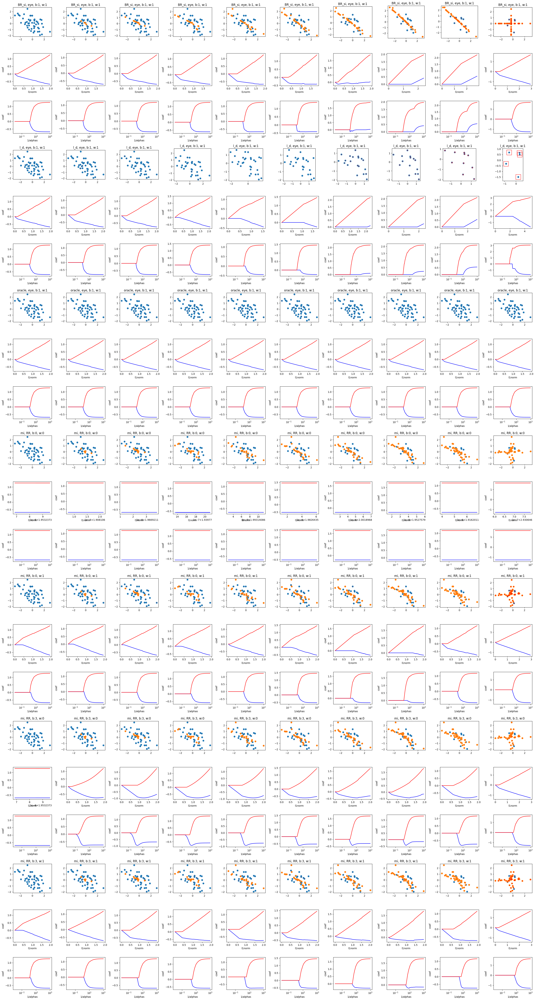

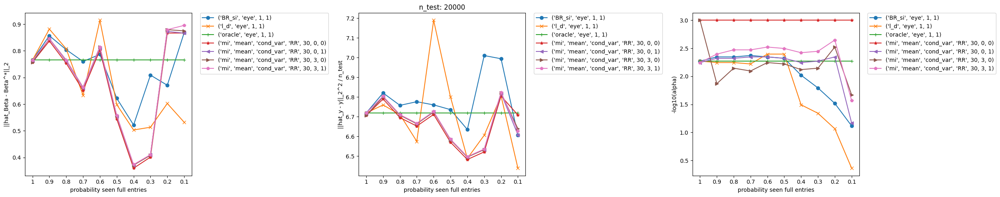

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [50] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.6], [-0.6, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
## same setting as before, n_train = 50, higher correaltion (-0.6), moderate error (2.5)

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR

100%|██████████| 200/200 [00:01<00:00, 111.27it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 160.63it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 176.63it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  15.68823236600866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.22044605e-16 5.55111512e-16]
f

100%|██████████| 200/200 [00:01<00:00, 129.44it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.332700083729539
---------------------------------> best coeff  [-0.8250411   1.77852966]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  15.68823236600866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.22044605e-16 5.55111512e-16]
final S in cov strategy RR  [[0.98517601 0.        ]
 [0.         0.90882985]]
S within 
 [[0.98517601 0.   

100%|██████████| 200/200 [00:01<00:00, 105.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  5  best 1/best_alpha  748.8103857590023 , min score  6.332048966454274
---------------------------------> best coeff  [-0.82363277  1.77614619]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  15.68823236600866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.22044605e-16 5.55111512e-16]
final S in cov strategy RR  [[0.98517601 0.        ]
 [0.         0.90882985]]
S within 
 [[0.985

100%|██████████| 200/200 [00:01<00:00, 130.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.332700083729539
---------------------------------> best coeff  [-0.8250411   1.77852966]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  15.68823236600866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.22044605e-16 5.55111512e-16]
final S in cov strategy RR  [[0.98517601 0.        ]
 [0.         0.90882985]]
S within 
 [[0.98517601 0.   

100%|██████████| 200/200 [00:01<00:00, 105.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  5  best 1/best_alpha  748.8103857590023 , min score  6.332048966454274
---------------------------------> best coeff  [-0.82363277  1.77614619]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -2.9324380223520317
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 147.10it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.371086521289037
---------------------------------> best coeff  [-0.82176477  1.56544342]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -1.128406717011421
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 128.61it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.395465879664857
---------------------------------> best coeff  [-0.85788239  1.52255498]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 177.00it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -109.33339379974423
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98710451 0.92061604]
cov computed
s_between  [0.01443561 0.0090593 ]
final S

100%|██████████| 200/200 [00:02<00:00, 97.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.368132077420476
---------------------------------> best coeff  [-0.90161029  1.70121295]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -109.33339379974423
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98710451 0.92061604]
cov computed
s_between  [0.01443561 0.0090593 ]
final S in cov strategy RR  [[1.00202131 0.        ]
 [0.         0.92997732]]
S within 
 [[1.00202131 0.        ]

100%|██████████| 200/200 [00:02<00:00, 83.18it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.3699981641453745
---------------------------------> best coeff  [-0.79733855  1.55966233]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -109.33339379974423
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98710451 0.92061604]
cov computed
s_between  [0.01443561 0.0090593 ]
final S in cov strategy RR  [[1.00202131 0.        ]
 [0.         0.92997732]]
S within 
 [[1.002021

100%|██████████| 200/200 [00:01<00:00, 128.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  6.3660088348255295
---------------------------------> best coeff  [-0.89675066  1.6962948 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -109.33339379974423
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98710451 0.92061604]
cov computed
s_between  [0.01443561 0.0090593 ]
final S in cov strategy RR  [[1.00202131 0.        ]
 [0.         0.92997732]]
S within 
 [[1.0020213

100%|██████████| 200/200 [00:01<00:00, 105.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  12  best 1/best_alpha  499.450511585514 , min score  6.366853907140769
---------------------------------> best coeff  [-0.89860265  1.69699965]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -5.55226609775918
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 185.65it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.383551248589696
---------------------------------> best coeff  [-0.84827693  1.54649654]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -2.869495747762713
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  

100%|██████████| 200/200 [00:00<00:00, 222.35it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.401843065963644
---------------------------------> best coeff  [-0.96076594  1.64296793]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 188.02it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -221.55008288126214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99485056 0.92817606]
cov computed
s_between  [0.01803821 0.02182631]
final S

100%|██████████| 200/200 [00:01<00:00, 133.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.408263269598052
---------------------------------> best coeff  [-0.97085177  1.6316514 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -221.55008288126214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99485056 0.92817606]
cov computed
s_between  [0.01803821 0.02182631]
final S in cov strategy RR  [[1.01349004 0.        ]
 [0.         0.95072991]]
S within 
 [[1.01349004 0.        ]

100%|██████████| 200/200 [00:01<00:00, 105.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.410639606188267
---------------------------------> best coeff  [-0.88620014  1.50145768]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -221.55008288126214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99485056 0.92817606]
cov computed
s_between  [0.01803821 0.02182631]
final S in cov strategy RR  [[1.01349004 0.        ]
 [0.         0.95072991]]
S within 
 [[1.0134900

100%|██████████| 200/200 [00:01<00:00, 131.08it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.418739143904449
---------------------------------> best coeff  [-0.96493297  1.55325851]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -221.55008288126214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99485056 0.92817606]
cov computed
s_between  [0.01803821 0.02182631]
final S in cov strategy RR  [[1.01349004 0.        ]
 [0.         0.95072991]]
S within 
 [[1.0134900

100%|██████████| 200/200 [00:02<00:00, 71.21it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  6.416311336333282
---------------------------------> best coeff  [-0.91128546  1.50279135]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -3.7114058291873437
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 181.28it/s]


------------------------> who is S in add_rectangles
 [[0.03409285 0.        ]
 [0.         0.03409285]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  6.393988958695747
---------------------------------> best coeff  [-0.86706863  1.53050078]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.0252071855861802
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  ,

100%|██████████| 200/200 [00:00<00:00, 225.31it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.492332918366728
---------------------------------> best coeff  [-1.08961702  1.52794873]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 183.53it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -120.05950134957648
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99593171 0.94683373]
cov computed
s_between  [0.02252678 0.03312127]
final S

100%|██████████| 200/200 [00:01<00:00, 134.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.387883867377995
---------------------------------> best coeff  [-0.92832196  1.62510061]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -120.05950134957648
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99593171 0.94683373]
cov computed
s_between  [0.02252678 0.03312127]
final S in cov strategy RR  [[1.01920938 0.        ]
 [0.         0.98105904]]
S within 
 [[1.01920938 0.        ]

100%|██████████| 200/200 [00:01<00:00, 105.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.396724606660107
---------------------------------> best coeff  [-0.85333745  1.51783116]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -120.05950134957648
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99593171 0.94683373]
cov computed
s_between  [0.02252678 0.03312127]
final S in cov strategy RR  [[1.01920938 0.        ]
 [0.         0.98105904]]
S within 
 [[1.0192093

100%|██████████| 200/200 [00:01<00:00, 132.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.398187091100354
---------------------------------> best coeff  [-0.92880577  1.57510413]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -120.05950134957648
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99593171 0.94683373]
cov computed
s_between  [0.02252678 0.03312127]
final S in cov strategy RR  [[1.01920938 0.        ]
 [0.         0.98105904]]
S within 
 [[1.0192093

100%|██████████| 200/200 [00:01<00:00, 106.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.399119880427106
---------------------------------> best coeff  [-0.891454    1.53262824]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -0.5098830940302888
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 183.36it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.328376819727459
---------------------------------> best coeff  [-0.72085508  1.6476699 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.0644709362848923
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 257.99it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.418816108724828
---------------------------------> best coeff  [-0.98542702  1.60694673]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 130.28it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -33.17359298497506
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0010381  0.93180384]
cov computed
s_between  [0.02642861 0.02717663]
final S 

100%|██████████| 200/200 [00:01<00:00, 130.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.334897335109999
---------------------------------> best coeff  [-0.82871617  1.79257916]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -33.17359298497506
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0010381  0.93180384]
cov computed
s_between  [0.02642861 0.02717663]
final S in cov strategy RR  [[1.02834767 0.        ]
 [0.         0.95988636]]
S within 
 [[1.02834767 0.        ]


100%|██████████| 200/200 [00:02<00:00, 82.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.327686441359953
---------------------------------> best coeff  [-0.81303756  1.77071763]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -33.17359298497506
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0010381  0.93180384]
cov computed
s_between  [0.02642861 0.02717663]
final S in cov strategy RR  [[1.02834767 0.        ]
 [0.         0.95988636]]
S within 
 [[1.02834767 

100%|██████████| 200/200 [00:02<00:00, 87.80it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.341455520827484
---------------------------------> best coeff  [-0.80027715  1.64192355]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -33.17359298497506
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0010381  0.93180384]
cov computed
s_between  [0.02642861 0.02717663]
final S in cov strategy RR  [[1.02834767 0.        ]
 [0.         0.95988636]]
S within 
 [[1.02834767

100%|██████████| 200/200 [00:02<00:00, 71.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  4  best 1/best_alpha  793.4096665797491 , min score  6.333661055920554
---------------------------------> best coeff  [-0.8264948   1.78780453]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -5.953230673580738
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 102.16it/s]


------------------------> who is S in add_rectangles
 [[0.03827494 0.        ]
 [0.         0.03827494]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.331454377479388
---------------------------------> best coeff  [-0.72649059  1.6401152 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -1.0966178497607664
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:01<00:00, 149.61it/s]


------------------------> who is S in add_rectangles
 [[0.12173827 0.        ]
 [0.         0.12173827]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  6.4371828605034125
---------------------------------> best coeff  [-1.0131194   1.58416931]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 109.81it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -183.6774753728199
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97895665 0.95280988]
cov computed
s_between  [0.03466901 0.0301941 ]
final S 

100%|██████████| 200/200 [00:01<00:00, 128.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.367764730543073
---------------------------------> best coeff  [-0.8964367   1.77394862]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -183.6774753728199
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97895665 0.95280988]
cov computed
s_between  [0.03466901 0.0301941 ]
final S in cov strategy RR  [[1.01478128 0.        ]
 [0.         0.98401045]]
S within 
 [[1.01478128 0.        ]


100%|██████████| 200/200 [00:02<00:00, 91.07it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.346846584818817
---------------------------------> best coeff  [-0.85670382  1.72085003]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -183.6774753728199
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97895665 0.95280988]
cov computed
s_between  [0.03466901 0.0301941 ]
final S in cov strategy RR  [[1.01478128 0.        ]
 [0.         0.98401045]]
S within 
 [[1.01478128 

100%|██████████| 200/200 [00:02<00:00, 88.74it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3704884429879485
---------------------------------> best coeff  [-0.85991905  1.59176874]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -183.6774753728199
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97895665 0.95280988]
cov computed
s_between  [0.03466901 0.0301941 ]
final S in cov strategy RR  [[1.01478128 0.        ]
 [0.         0.98401045]]
S within 
 [[1.0147812

100%|██████████| 200/200 [00:01<00:00, 108.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  6.357691086891538
---------------------------------> best coeff  [-0.88110122  1.74031743]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -2.114803033511767
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 184.27it/s]


------------------------> who is S in add_rectangles
 [[0.03612343 0.        ]
 [0.         0.03612343]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.326603868443593
---------------------------------> best coeff  [-0.70818149  1.65065143]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.057338923384998
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 305.75it/s]


------------------------> who is S in add_rectangles
 [[0.19338918 0.        ]
 [0.         0.19338918]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  91  best 1/best_alpha  5.170920242896755 , min score  6.431121695481751
---------------------------------> best coeff  [-1.00371727  1.58968161]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 183.90it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -180.05812388143679
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96649759 0.94691993]
cov computed
s_between  [0.02712594 0.03719216]
final S

100%|██████████| 200/200 [00:01<00:00, 134.08it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.457502715717303
---------------------------------> best coeff  [-0.94429232  1.95513704]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -180.05812388143679
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96649759 0.94691993]
cov computed
s_between  [0.02712594 0.03719216]
final S in cov strategy RR  [[0.99452772 0.        ]
 [0.         0.98535184]]
S within 
 [[0.99452772 0.        ]

100%|██████████| 200/200 [00:01<00:00, 105.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.323065943277806
---------------------------------> best coeff  [-0.80105357  1.77342113]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -180.05812388143679
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96649759 0.94691993]
cov computed
s_between  [0.02712594 0.03719216]
final S in cov strategy RR  [[0.99452772 0.        ]
 [0.         0.98535184]]
S within 
 [[0.9945277

100%|██████████| 200/200 [00:01<00:00, 125.33it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.360410843091975
---------------------------------> best coeff  [-0.88317849  1.77324231]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -180.05812388143679
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96649759 0.94691993]
cov computed
s_between  [0.02712594 0.03719216]
final S in cov strategy RR  [[0.99452772 0.        ]
 [0.         0.98535184]]
S within 
 [[0.9945277

100%|██████████| 200/200 [00:01<00:00, 106.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.336583861921735
---------------------------------> best coeff  [-0.83473653  1.75853902]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.3680222044237267
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 154.30it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.303043333454614
---------------------------------> best coeff  [-0.60140195  1.72285634]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.3134465800854933
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 229.02it/s]


------------------------> who is S in add_rectangles
 [[0.19338918 0.        ]
 [0.         0.19338918]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  91  best 1/best_alpha  5.170920242896755 , min score  6.473151679610243
---------------------------------> best coeff  [-0.92143855  1.39601112]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 133.74it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -31.479879403510303
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98329391 0.9847033 ]
cov computed
s_between  [0.03716481 0.02952375]
final S

100%|██████████| 200/200 [00:01<00:00, 128.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.543169900934129
---------------------------------> best coeff  [-0.96322003  2.06287199]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -31.479879403510303
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98329391 0.9847033 ]
cov computed
s_between  [0.03716481 0.02952375]
final S in cov strategy RR  [[1.02169755 0.        ]
 [0.         1.01521118]]
S within 
 [[1.02169755 0.        ]

100%|██████████| 200/200 [00:02<00:00, 74.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  6.303936292778561
---------------------------------> best coeff  [-0.62785771  1.71548999]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -31.479879403510303
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98329391 0.9847033 ]
cov computed
s_between  [0.03716481 0.02952375]
final S in cov strategy RR  [[1.02169755 0.        ]
 [0.         1.01521118]]
S within 
 [[1.02169755

100%|██████████| 200/200 [00:01<00:00, 128.59it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  6.335689688370833
---------------------------------> best coeff  [-0.75559734  1.63592463]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -31.479879403510303
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98329391 0.9847033 ]
cov computed
s_between  [0.03716481 0.02952375]
final S in cov strategy RR  [[1.02169755 0.        ]
 [0.         1.01521118]]
S within 
 [[1.02169755

100%|██████████| 200/200 [00:01<00:00, 107.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.321332914454411
---------------------------------> best coeff  [-0.79305324  1.82122965]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  12.344914890570292
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 184.92it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  6.403802289234422
---------------------------------> best coeff  [-0.59038826  1.5380031 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  3.9371827189294866
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 383.20it/s]


------------------------> who is S in add_rectangles
 [[0.12898903 0.        ]
 [0.         0.12898903]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  84  best 1/best_alpha  7.752597488629456 , min score  6.606346605461888
---------------------------------> best coeff  [-1.21166875  1.39434476]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 181.20it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  152.5856135162718
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98700631 0.9800008 ]
cov computed
s_between  [0.04020751 0.0411407 ]
final S i

100%|██████████| 200/200 [00:01<00:00, 126.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.586978862487213
---------------------------------> best coeff  [-1.06975192  1.96202339]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  152.5856135162718
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98700631 0.9800008 ]
cov computed
s_between  [0.04020751 0.0411407 ]
final S in cov strategy RR  [[1.02855407 0.        ]
 [0.         1.02251286]]
S within 
 [[1.02855407 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 103.62it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.346069731009828
---------------------------------> best coeff  [-0.85639125  1.74454895]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  152.5856135162718
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98700631 0.9800008 ]
cov computed
s_between  [0.04020751 0.0411407 ]
final S in cov strategy RR  [[1.02855407 0.        ]
 [0.         1.02251286]]
S within 
 [[1.02855407 

100%|██████████| 200/200 [00:01<00:00, 122.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.387335228673096
---------------------------------> best coeff  [-0.93824504  1.69737468]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  152.5856135162718
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98700631 0.9800008 ]
cov computed
s_between  [0.04020751 0.0411407 ]
final S in cov strategy RR  [[1.02855407 0.        ]
 [0.         1.02251286]]
S within 
 [[1.02855407 

100%|██████████| 200/200 [00:02<00:00, 83.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.366229527544722
---------------------------------> best coeff  [-0.81346046  1.57430204]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.8298658965084655
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 129.55it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.689687830660197
---------------------------------> best coeff  [-0.88818071  1.14800776]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5900754260192936
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 438.28it/s]


------------------------> who is S in add_rectangles
 [[0.00757525 0.        ]
 [0.         0.00757525]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  7.031522363172122
---------------------------------> best coeff  [-1.38221909  0.90509315]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 179.64it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -152.32311567703178
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98305883 1.00545459]
cov computed
s_between  [0.04646234 0.05948753]
final S

100%|██████████| 200/200 [00:02<00:00, 88.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.8086831935395935
---------------------------------> best coeff  [-1.10540463  2.16051961]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -152.32311567703178
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98305883 1.00545459]
cov computed
s_between  [0.04646234 0.05948753]
final S in cov strategy RR  [[1.03106992 0.        ]
 [0.         1.06692503]]
S within 
 [[1.03106992 0.        

100%|██████████| 200/200 [00:01<00:00, 107.33it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  6.321414370948323
---------------------------------> best coeff  [-0.79674107  1.78678478]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -152.32311567703178
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98305883 1.00545459]
cov computed
s_between  [0.04646234 0.05948753]
final S in cov strategy RR  [[1.03106992 0.        ]
 [0.         1.06692503]]
S within 
 [[1.0310699

100%|██████████| 200/200 [00:01<00:00, 121.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  6.374859408252779
---------------------------------> best coeff  [-0.81888653  1.55503216]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -152.32311567703178
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98305883 1.00545459]
cov computed
s_between  [0.04646234 0.05948753]
final S in cov strategy RR  [[1.03106992 0.        ]
 [0.         1.06692503]]
S within 
 [[1.0310699

100%|██████████| 200/200 [00:01<00:00, 106.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  6.345494236847538
---------------------------------> best coeff  [-0.85509009  1.74342067]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.74313797,  1.63433293]), array([-0.82176477,  1.56544342]), array([-0.84827693,  1.54649654]), array([-0.86706863,  1.53050078]), array([-0.72085508,  1.6476699 ]), array([-0.72649059,  1.6401152 ]), array([-0.70818149,  1.65065143]), array([-0.60140195,  1.72285634]), array([-0.59038826,  1.5380031 ]), array([-0.88818071,  1.14800776])], 'l2_dist_best_coeff_gt': [np.float64(0.4391223971096508), np.float64(0.5407143314915784), np.float64(0.5718060946111351), np.float64(0.5959604795573413), np.float64(0.41582864783824613), np.float64(0.4252235312182266), np.float64(0.406674262882490

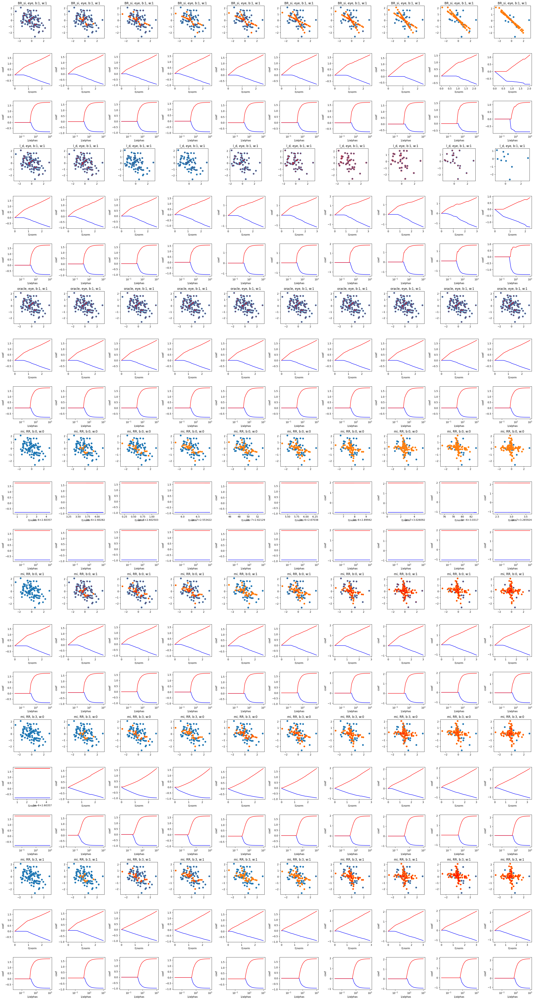

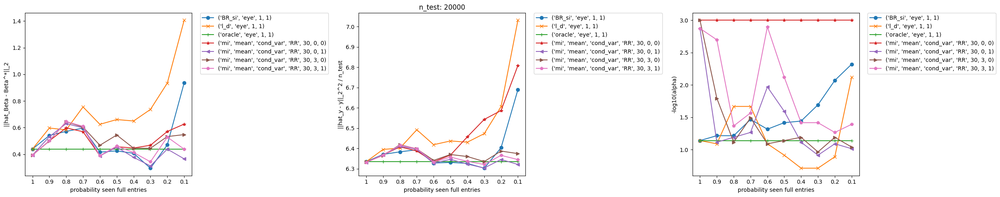

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.6], [-0.6, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': '

100%|██████████| 200/200 [00:01<00:00, 127.00it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 120.68it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 129.95it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  62.752929464034665
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.99760217e-15 1.33226763e-15]

100%|██████████| 200/200 [00:01<00:00, 131.69it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.332700083729537
---------------------------------> best coeff  [-0.8250411   1.77852966]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  62.752929464034665
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.99760217e-15 1.33226763e-15]
final S in cov strategy RR  [[0.98517601 0.        ]
 [0.         0.90882985]]
S within 
 [[0.98517601 0.

100%|██████████| 200/200 [00:01<00:00, 105.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  5  best 1/best_alpha  748.8103857590023 , min score  6.332048966454264
---------------------------------> best coeff  [-0.82363277  1.77614619]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  62.752929464034665
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.99760217e-15 1.33226763e-15]
final S in cov strategy RR  [[0.98517601 0.        ]
 [0.         0.90882985]]
S within 
 [[0.

100%|██████████| 200/200 [00:01<00:00, 130.08it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.332700083729537
---------------------------------> best coeff  [-0.8250411   1.77852966]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  62.752929464034665
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.98517601 0.90882985]
cov computed
s_between  [2.99760217e-15 1.33226763e-15]
final S in cov strategy RR  [[0.98517601 0.        ]
 [0.         0.90882985]]
S within 
 [[0.98517601 0.

100%|██████████| 200/200 [00:01<00:00, 107.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  5  best 1/best_alpha  748.8103857590023 , min score  6.332048966454264
---------------------------------> best coeff  [-0.82363277  1.77614619]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -2.9324380223520317
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 189.02it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.371086521289037
---------------------------------> best coeff  [-0.82176477  1.56544342]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -1.128406717011421
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 134.09it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.395465879664857
---------------------------------> best coeff  [-0.85788239  1.52255498]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 125.06it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -336.4544482130347
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99121423 0.92220861]
cov computed
s_between  [0.01423592 0.01174506]
final S

100%|██████████| 200/200 [00:01<00:00, 104.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.364594255080628
---------------------------------> best coeff  [-0.89369309  1.69589867]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -336.4544482130347
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99121423 0.92220861]
cov computed
s_between  [0.01423592 0.01174506]
final S in cov strategy RR  [[1.00556878 0.        ]
 [0.         0.93405155]]
S within 
 [[1.00556878 0.        

100%|██████████| 200/200 [00:02<00:00, 80.29it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.368522052130289
---------------------------------> best coeff  [-0.79797105  1.56325823]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -336.4544482130347
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99121423 0.92220861]
cov computed
s_between  [0.01423592 0.01174506]
final S in cov strategy RR  [[1.00556878 0.        ]
 [0.         0.93405155]]
S within 
 [[1.005568

100%|██████████| 200/200 [00:01<00:00, 128.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  6.363615468661445
---------------------------------> best coeff  [-0.89129291  1.69367059]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -336.4544482130347
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99121423 0.92220861]
cov computed
s_between  [0.01423592 0.01174506]
final S in cov strategy RR  [[1.00556878 0.        ]
 [0.         0.93405155]]
S within 
 [[1.0055687

100%|██████████| 200/200 [00:01<00:00, 105.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.36707732772829
---------------------------------> best coeff  [-0.79374275  1.56547211]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -5.55226609775918
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 188.60it/s]


------------------------> who is S in add_rectangles
 [[0.06080224 0.        ]
 [0.         0.06080224]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.383551248589696
---------------------------------> best coeff  [-0.84827693  1.54649654]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -2.869495747762713
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  

100%|██████████| 200/200 [00:00<00:00, 223.44it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.401843065963644
---------------------------------> best coeff  [-0.96076594  1.64296793]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 189.05it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -667.1914995393018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99195112 0.92231753]
cov computed
s_between  [0.01687008 0.02322726]
final S

100%|██████████| 200/200 [00:01<00:00, 128.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.384132111792555
---------------------------------> best coeff  [-0.93242184  1.70500752]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -667.1914995393018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99195112 0.92231753]
cov computed
s_between  [0.01687008 0.02322726]
final S in cov strategy RR  [[1.00896178 0.        ]
 [0.         0.94573835]]
S within 
 [[1.00896178 0.        

100%|██████████| 200/200 [00:01<00:00, 104.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.37749506836462
---------------------------------> best coeff  [-0.9191643  1.6853135]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -667.1914995393018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99195112 0.92231753]
cov computed
s_between  [0.01687008 0.02322726]
final S in cov strategy RR  [[1.00896178 0.        ]
 [0.         0.94573835]]
S within 
 [[1.00896178 0

100%|██████████| 200/200 [00:02<00:00, 98.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  87  best 1/best_alpha  6.5173396048824195 , min score  6.390092541325931
---------------------------------> best coeff  [-0.90307394  1.57023007]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -667.1914995393018
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99195112 0.92231753]
cov computed
s_between  [0.01687008 0.02322726]
final S in cov strategy RR  [[1.00896178 0.        ]
 [0.         0.94573835]]
S within 
 [[1.008961

100%|██████████| 200/200 [00:02<00:00, 81.86it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.38066534641699
---------------------------------> best coeff  [-0.92586385  1.69371357]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -3.7114058291873437
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 186.41it/s]


------------------------> who is S in add_rectangles
 [[0.03409285 0.        ]
 [0.         0.03409285]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  6.393988958695747
---------------------------------> best coeff  [-0.86706863  1.53050078]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.0252071855861802
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  ,

100%|██████████| 200/200 [00:00<00:00, 238.95it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.492332918366728
---------------------------------> best coeff  [-1.08961702  1.52794873]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 186.07it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -463.24515174385226
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99266633 0.94831725]
cov computed
s_between  [0.01834207 0.02912785]
final 

100%|██████████| 200/200 [00:01<00:00, 133.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.389431380928632
---------------------------------> best coeff  [-0.92820868  1.61529726]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -463.24515174385226
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99266633 0.94831725]
cov computed
s_between  [0.01834207 0.02912785]
final S in cov strategy RR  [[1.01116125 0.        ]
 [0.         0.97768783]]
S within 
 [[1.01116125 0.       

100%|██████████| 200/200 [00:01<00:00, 106.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.398458868609773
---------------------------------> best coeff  [-0.8635048   1.51821876]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -463.24515174385226
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99266633 0.94831725]
cov computed
s_between  [0.01834207 0.02912785]
final S in cov strategy RR  [[1.01116125 0.        ]
 [0.         0.97768783]]
S within 
 [[1.011161

100%|██████████| 200/200 [00:01<00:00, 129.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.399906214925023
---------------------------------> best coeff  [-0.93117335  1.57199407]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -463.24515174385226
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99266633 0.94831725]
cov computed
s_between  [0.01834207 0.02912785]
final S in cov strategy RR  [[1.01116125 0.        ]
 [0.         0.97768783]]
S within 
 [[1.011161

100%|██████████| 200/200 [00:01<00:00, 105.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.40049941627885
---------------------------------> best coeff  [-0.90228066  1.5372415 ]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -0.5098830940302888
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 182.14it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.328376819727459
---------------------------------> best coeff  [-0.72085508  1.6476699 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.0644709362848923
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:01<00:00, 186.94it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.418816108724828
---------------------------------> best coeff  [-0.98542702  1.60694673]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 120.35it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -185.0122353361612
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99998709 0.93733412]
cov computed
s_between  [0.02639724 0.03121882]
final S

100%|██████████| 200/200 [00:01<00:00, 137.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.33829666607638
---------------------------------> best coeff  [-0.8282979   1.83064906]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -185.0122353361612
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99998709 0.93733412]
cov computed
s_between  [0.02639724 0.03121882]
final S in cov strategy RR  [[1.02660431 0.        ]
 [0.         0.96881309]]
S within 
 [[1.02660431 0.        ]

100%|██████████| 200/200 [00:02<00:00, 68.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.323674160902294
---------------------------------> best coeff  [-0.80231188  1.79213265]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -185.0122353361612
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99998709 0.93733412]
cov computed
s_between  [0.02639724 0.03121882]
final S in cov strategy RR  [[1.02660431 0.        ]
 [0.         0.96881309]]
S within 
 [[1.0266043

100%|██████████| 200/200 [00:01<00:00, 126.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  6.340933844666109
---------------------------------> best coeff  [-0.79962906  1.64333455]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -185.0122353361612
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99998709 0.93733412]
cov computed
s_between  [0.02639724 0.03121882]
final S in cov strategy RR  [[1.02660431 0.        ]
 [0.         0.96881309]]
S within 
 [[1.026604

100%|██████████| 200/200 [00:01<00:00, 107.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  6.329361191767468
---------------------------------> best coeff  [-0.81497075  1.80194371]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -5.953230673580738
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 183.53it/s]


------------------------> who is S in add_rectangles
 [[0.03827494 0.        ]
 [0.         0.03827494]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.331454377479388
---------------------------------> best coeff  [-0.72649059  1.6401152 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -1.0966178497607664
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 285.49it/s]


------------------------> who is S in add_rectangles
 [[0.12173827 0.        ]
 [0.         0.12173827]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  6.4371828605034125
---------------------------------> best coeff  [-1.0131194   1.58416931]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 183.01it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -791.3063999422943
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97891323 0.94790258]
cov computed
s_between  [0.03004784 0.03768981]
final S

100%|██████████| 200/200 [00:02<00:00, 82.53it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.367218023273284
---------------------------------> best coeff  [-0.8744904   1.84997006]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -791.3063999422943
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97891323 0.94790258]
cov computed
s_between  [0.03004784 0.03768981]
final S in cov strategy RR  [[1.00921147 0.        ]
 [0.         0.98590647]]
S within 
 [[1.00921147 0.        

100%|██████████| 200/200 [00:01<00:00, 107.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.328252678513137
---------------------------------> best coeff  [-0.81443484  1.76788124]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -791.3063999422943
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97891323 0.94790258]
cov computed
s_between  [0.03004784 0.03768981]
final S in cov strategy RR  [[1.00921147 0.        ]
 [0.         0.98590647]]
S within 
 [[1.0092114

100%|██████████| 200/200 [00:01<00:00, 122.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.349507977152762
---------------------------------> best coeff  [-0.85789069  1.79885421]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -791.3063999422943
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.97891323 0.94790258]
cov computed
s_between  [0.03004784 0.03768981]
final S in cov strategy RR  [[1.00921147 0.        ]
 [0.         0.98590647]]
S within 
 [[1.00921147

100%|██████████| 200/200 [00:01<00:00, 105.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  6.338884717889891
---------------------------------> best coeff  [-0.83850724  1.78396436]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -2.114803033511767
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 180.64it/s]


------------------------> who is S in add_rectangles
 [[0.03612343 0.        ]
 [0.         0.03612343]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.326603868443593
---------------------------------> best coeff  [-0.70818149  1.65065143]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.057338923384998
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 303.59it/s]


------------------------> who is S in add_rectangles
 [[0.19338918 0.        ]
 [0.         0.19338918]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  91  best 1/best_alpha  5.170920242896755 , min score  6.431121695481751
---------------------------------> best coeff  [-1.00371727  1.58968161]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 183.91it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -608.2817885061476
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98297507 0.94811698]
cov computed
s_between  [0.03575853 0.03564725]
final S

100%|██████████| 200/200 [00:01<00:00, 137.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.421327804651502
---------------------------------> best coeff  [-0.96122314  1.82976528]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -608.2817885061476
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98297507 0.94811698]
cov computed
s_between  [0.03575853 0.03564725]
final S in cov strategy RR  [[1.01903159 0.        ]
 [0.         0.98406129]]
S within 
 [[1.01903159 0.        

100%|██████████| 200/200 [00:01<00:00, 106.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  6.349194132435734
---------------------------------> best coeff  [-0.85855804  1.69846822]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -608.2817885061476
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98297507 0.94811698]
cov computed
s_between  [0.03575853 0.03564725]
final S in cov strategy RR  [[1.01903159 0.        ]
 [0.         0.98406129]]
S within 
 [[1.01903159

100%|██████████| 200/200 [00:02<00:00, 79.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  6.3861094046028155
---------------------------------> best coeff  [-0.93445699  1.72966547]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -608.2817885061476
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98297507 0.94811698]
cov computed
s_between  [0.03575853 0.03564725]
final S in cov strategy RR  [[1.01903159 0.        ]
 [0.         0.98406129]]
S within 
 [[1.019031

100%|██████████| 200/200 [00:01<00:00, 105.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  6.367349709004751
---------------------------------> best coeff  [-0.90010539  1.70254497]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.3680222044237267
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 185.65it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.303043333454614
---------------------------------> best coeff  [-0.60140195  1.72285634]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  1.3134465800854933
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 341.68it/s]


------------------------> who is S in add_rectangles
 [[0.19338918 0.        ]
 [0.         0.19338918]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  91  best 1/best_alpha  5.170920242896755 , min score  6.473151679610243
---------------------------------> best coeff  [-0.92143855  1.39601112]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 182.37it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -290.3228703136797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98105384 0.98356395]
cov computed
s_between  [0.03047829 0.03966031]
final S

100%|██████████| 200/200 [00:01<00:00, 136.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.577891390364575
---------------------------------> best coeff  [-0.94436273  2.13117138]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -290.3228703136797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98105384 0.98356395]
cov computed
s_between  [0.03047829 0.03966031]
final S in cov strategy RR  [[1.01178612 0.        ]
 [0.         1.02355477]]
S within 
 [[1.01178612 0.        

100%|██████████| 200/200 [00:01<00:00, 106.17it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  6.29782246359349
---------------------------------> best coeff  [-0.71973462  1.86820477]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -290.3228703136797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98105384 0.98356395]
cov computed
s_between  [0.03047829 0.03966031]
final S in cov strategy RR  [[1.01178612 0.        ]
 [0.         1.02355477]]
S within 
 [[1.0117861

100%|██████████| 200/200 [00:01<00:00, 126.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.324724718849623
---------------------------------> best coeff  [-0.80114923  1.82095514]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -290.3228703136797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98105384 0.98356395]
cov computed
s_between  [0.03047829 0.03966031]
final S in cov strategy RR  [[1.01178612 0.        ]
 [0.         1.02355477]]
S within 
 [[1.011786

100%|██████████| 200/200 [00:01<00:00, 106.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  6.308956455784929
---------------------------------> best coeff  [-0.75642593  1.84767864]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  12.344914890570292
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 116.34it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  6.403802289234422
---------------------------------> best coeff  [-0.59038826  1.5380031 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  3.9371827189294866
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 253.02it/s]


------------------------> who is S in add_rectangles
 [[0.12898903 0.        ]
 [0.         0.12898903]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  84  best 1/best_alpha  7.752597488629456 , min score  6.606346605461888
---------------------------------> best coeff  [-1.21166875  1.39434476]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 171.33it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  483.6902525364287
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98812091 0.98711108]
cov computed
s_between  [0.0401547  0.04616121]
final S 

100%|██████████| 200/200 [00:02<00:00, 89.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.612085981644857
---------------------------------> best coeff  [-1.01710906  2.0753906 ]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  483.6902525364287
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98812091 0.98711108]
cov computed
s_between  [0.0401547  0.04616121]
final S in cov strategy RR  [[1.02861023 0.        ]
 [0.         1.03365697]]
S within 
 [[1.02861023 0.        ]

100%|██████████| 200/200 [00:01<00:00, 106.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  85  best 1/best_alpha  7.316807143427192 , min score  6.320259718967823
---------------------------------> best coeff  [-0.68121351  1.66612162]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  483.6902525364287
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98812091 0.98711108]
cov computed
s_between  [0.0401547  0.04616121]
final S in cov strategy RR  [[1.02861023 0.        ]
 [0.         1.03365697]]
S within 
 [[1.02861023

100%|██████████| 200/200 [00:01<00:00, 123.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.3779841846661425
---------------------------------> best coeff  [-0.91740233  1.75490843]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  483.6902525364287
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98812091 0.98711108]
cov computed
s_between  [0.0401547  0.04616121]
final S in cov strategy RR  [[1.02861023 0.        ]
 [0.         1.03365697]]
S within 
 [[1.028610

100%|██████████| 200/200 [00:01<00:00, 106.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.354544405358645
---------------------------------> best coeff  [-0.86817316  1.79553067]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.6],
       [-0.6,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.8298658965084655
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 183.71it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.689687830660197
---------------------------------> best coeff  [-0.88818071  1.14800776]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5900754260192936
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 422.61it/s]


------------------------> who is S in add_rectangles
 [[0.00757525 0.        ]
 [0.         0.00757525]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  7.031522363172122
---------------------------------> best coeff  [-1.38221909  0.90509315]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  0.5229410788669562
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 180.58it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.3348843517183955
---------------------------------> best coeff  [-0.74313797  1.63433293]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -640.8074792934631
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98217942 1.0075268 ]
cov computed
s_between  [0.04209128 0.05137738]
final S

100%|██████████| 200/200 [00:01<00:00, 129.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.71617353168096
---------------------------------> best coeff  [-0.99939791  2.20751432]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -640.8074792934631
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98217942 1.0075268 ]
cov computed
s_between  [0.04209128 0.05137738]
final S in cov strategy RR  [[1.02462146 0.        ]
 [0.         1.05933232]]
S within 
 [[1.02462146 0.        ]

100%|██████████| 200/200 [00:01<00:00, 104.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  6.302293233831266
---------------------------------> best coeff  [-0.73157715  1.87341448]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -640.8074792934631
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98217942 1.0075268 ]
cov computed
s_between  [0.04209128 0.05137738]
final S in cov strategy RR  [[1.02462146 0.        ]
 [0.         1.05933232]]
S within 
 [[1.024621

100%|██████████| 200/200 [00:02<00:00, 76.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.33664254755166
---------------------------------> best coeff  [-0.83081073  1.80381166]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.98517601 0.90882985]
crush test------------------------------------------------->  -640.8074792934631
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98217942 1.0075268 ]
cov computed
s_between  [0.04209128 0.05137738]
final S in cov strategy RR  [[1.02462146 0.        ]
 [0.         1.05933232]]
S within 
 [[1.0246214

100%|██████████| 200/200 [00:01<00:00, 103.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.318606588825377
---------------------------------> best coeff  [-0.78393176  1.83430089]
mi
mean
cond_var
RR
120
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.74313797,  1.63433293]), array([-0.82176477,  1.56544342]), array([-0.84827693,  1.54649654]), array([-0.86706863,  1.53050078]), array([-0.72085508,  1.6476699 ]), array([-0.72649059,  1.6401152 ]), array([-0.70818149,  1.65065143]), array([-0.60140195,  1.72285634]), array([-0.59038826,  1.5380031 ]), array([-0.88818071,  1.14800776])], 'l2_dist_best_coeff_gt': [np.float64(0.4391223971096508), np.float64(0.5407143314915784), np.float64(0.5718060946111351), np.float64(0.5959604795573413), np.float64(0.41582864783824613), np.float64(0.4252235312182266), np.float64(0.40667426288249

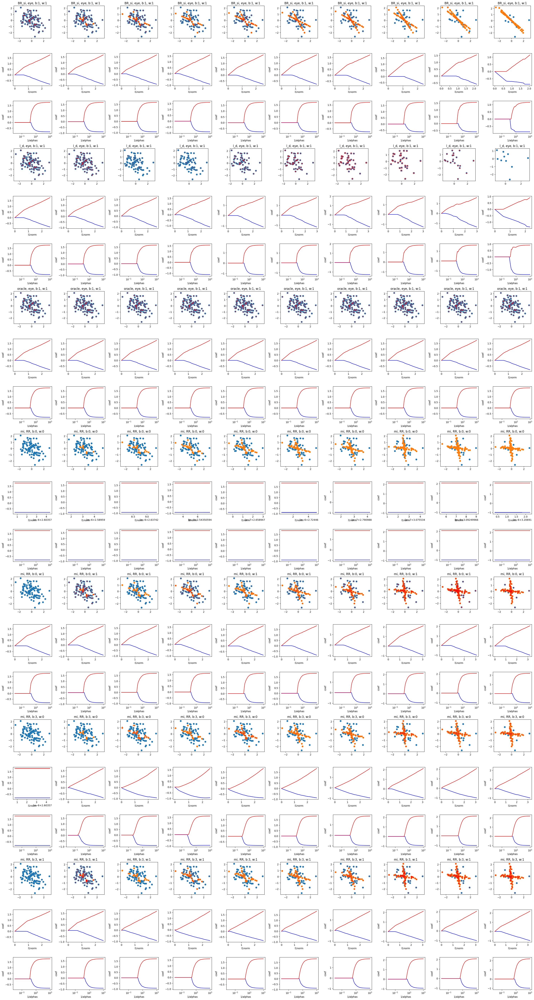

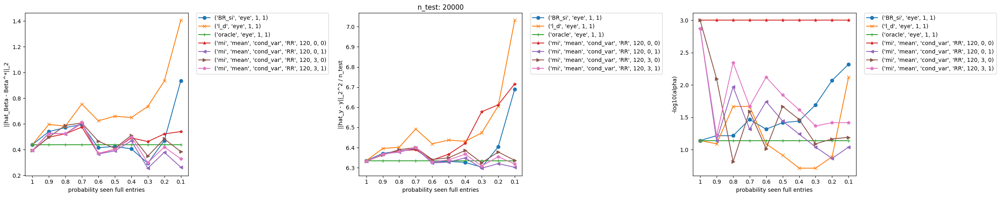

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.6], [-0.6, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 120
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
## everything as in the experiment above, but mi sample = 120
# Results are slightly better than in the previous image, the mi curves lie more closely to the BR_si curve

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy':

100%|██████████| 200/200 [00:01<00:00, 124.39it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 161.49it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 136.18it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  5.546627745417542
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91510206 0.88372653]
cov computed
s_between  [4.4408921e-16 4.4408921e-16]
fina

100%|██████████| 200/200 [00:04<00:00, 44.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.332700085554157
---------------------------------> best coeff  [-1.31979223  1.27402438]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  5.546627745417542
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91510206 0.88372653]
cov computed
s_between  [4.4408921e-16 4.4408921e-16]
final S in cov strategy RR  [[0.91510206 0.        ]
 [0.         0.88372653]]
S within 
 [[0.91510206 0.     

100%|██████████| 200/200 [00:03<00:00, 59.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  16  best 1/best_alpha  396.26886387014787 , min score  6.331644850117505
---------------------------------> best coeff  [-1.31915905  1.26909441]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  5.546627745417542
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91510206 0.88372653]
cov computed
s_between  [4.4408921e-16 4.4408921e-16]
final S in cov strategy RR  [[0.91510206 0.        ]
 [0.         0.88372653]]
S within 
 [[0.915

100%|██████████| 200/200 [00:02<00:00, 78.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.332700085554157
---------------------------------> best coeff  [-1.31979223  1.27402438]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  5.546627745417542
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91510206 0.88372653]
cov computed
s_between  [4.4408921e-16 4.4408921e-16]
final S in cov strategy RR  [[0.91510206 0.        ]
 [0.         0.88372653]]
S within 
 [[0.91510206 0.     

100%|██████████| 200/200 [00:03<00:00, 54.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  16  best 1/best_alpha  396.26886387014787 , min score  6.331644850117505
---------------------------------> best coeff  [-1.31915905  1.26909441]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -0.6952558435422693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S w

100%|██████████| 200/200 [00:01<00:00, 164.60it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.393917368864656
---------------------------------> best coeff  [-1.62799163  0.7709314 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -0.3989520207676085
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imput

100%|██████████| 200/200 [00:01<00:00, 198.79it/s]


------------------------> who is S in add_rectangles
 [[0.08603464 0.        ]
 [0.         0.08603464]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  6.393674753172965
---------------------------------> best coeff  [-1.6281277   0.77197595]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 182.64it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -29.716247617947207
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91235771 0.88729498]
cov computed
s_between  [0.00655798 0.00417176]
final S 

100%|██████████| 200/200 [00:02<00:00, 66.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.384927492344774
---------------------------------> best coeff  [-1.62609195  0.96372905]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -29.716247617947207
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91235771 0.88729498]
cov computed
s_between  [0.00655798 0.00417176]
final S in cov strategy RR  [[0.91913429 0.        ]
 [0.         0.8916058 ]]
S within 
 [[0.91913429 0.        ]

100%|██████████| 200/200 [00:03<00:00, 59.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  6.388205774177551
---------------------------------> best coeff  [-1.57854838  0.80014053]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -29.716247617947207
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91235771 0.88729498]
cov computed
s_between  [0.00655798 0.00417176]
final S in cov strategy RR  [[0.91913429 0.        ]
 [0.         0.8916058 ]]
S within 
 [[0.9191342

100%|██████████| 200/200 [00:03<00:00, 59.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  123  best 1/best_alpha  0.811984499318401 , min score  6.351207375869523
---------------------------------> best coeff  [-1.28284955  1.03695993]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -29.716247617947207
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91235771 0.88729498]
cov computed
s_between  [0.00655798 0.00417176]
final S in cov strategy RR  [[0.91913429 0.        ]
 [0.         0.8916058 ]]
S within 
 [[0.9191342

100%|██████████| 200/200 [00:02<00:00, 67.21it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  6.3852674521370965
---------------------------------> best coeff  [-1.56459024  0.81400253]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -1.670625195496
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S with

100%|██████████| 200/200 [00:02<00:00, 86.12it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.40659448491365
---------------------------------> best coeff  [-1.68090368  0.71523184]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -1.014519950914486
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  8

100%|██████████| 200/200 [00:01<00:00, 123.35it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  6.402652194664894
---------------------------------> best coeff  [-1.70547537  0.89111867]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 108.23it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -75.09521287160028
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91574055 0.90175056]
cov computed
s_between  [0.00779042 0.01219129]
final S i

100%|██████████| 200/200 [00:01<00:00, 133.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.426433121799694
---------------------------------> best coeff  [-1.81900266  0.75806348]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -75.09521287160028
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91574055 0.90175056]
cov computed
s_between  [0.00779042 0.01219129]
final S in cov strategy RR  [[0.92379065 0.        ]
 [0.         0.91434823]]
S within 
 [[0.92379065 0.        ]


100%|██████████| 200/200 [00:02<00:00, 80.53it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.433892710706142
---------------------------------> best coeff  [-1.7986064   0.60335935]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -75.09521287160028
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91574055 0.90175056]
cov computed
s_between  [0.00779042 0.01219129]
final S in cov strategy RR  [[0.92379065 0.        ]
 [0.         0.91434823]]
S within 
 [[0.92379065

100%|██████████| 200/200 [00:01<00:00, 100.93it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  113  best 1/best_alpha  1.448118227674533 , min score  6.438365021630861
---------------------------------> best coeff  [-1.76009302  0.59253962]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -75.09521287160028
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91574055 0.90175056]
cov computed
s_between  [0.00779042 0.01219129]
final S in cov strategy RR  [[0.92379065 0.        ]
 [0.         0.91434823]]
S within 
 [[0.92379065

100%|██████████| 200/200 [00:01<00:00, 103.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.4353080517334496
---------------------------------> best coeff  [-1.82314258  0.60084152]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -0.17604051723127512
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S

100%|██████████| 200/200 [00:01<00:00, 180.72it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.476822392912348
---------------------------------> best coeff  [-1.96993356  0.44744103]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.36246547652458294
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000 

100%|██████████| 200/200 [00:00<00:00, 237.16it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.49383182874232
---------------------------------> best coeff  [-2.05721431  0.5547802 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 182.45it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -5.99704333013208
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91718694 0.91240016]
cov computed
s_between  [0.00895926 0.01940921]
final S in

100%|██████████| 200/200 [00:01<00:00, 130.44it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.481907911505316
---------------------------------> best coeff  [-2.0345147   0.51082901]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -5.99704333013208
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91718694 0.91240016]
cov computed
s_between  [0.00895926 0.01940921]
final S in cov strategy RR  [[0.92644484 0.        ]
 [0.         0.93245634]]
S within 
 [[0.92644484 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 105.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.492719735027314
---------------------------------> best coeff  [-2.02999992  0.39517896]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -5.99704333013208
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91718694 0.91240016]
cov computed
s_between  [0.00895926 0.01940921]
final S in cov strategy RR  [[0.92644484 0.        ]
 [0.         0.93245634]]
S within 
 [[0.92644484 

100%|██████████| 200/200 [00:01<00:00, 127.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.492927055266546
---------------------------------> best coeff  [-2.07231489  0.46612852]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -5.99704333013208
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.91718694 0.91240016]
cov computed
s_between  [0.00895926 0.01940921]
final S in cov strategy RR  [[0.92644484 0.        ]
 [0.         0.93245634]]
S within 
 [[0.92644484 0

100%|██████████| 200/200 [00:01<00:00, 101.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.493153805282553
---------------------------------> best coeff  [-2.06836333  0.43238529]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.35547058142879706
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 118.66it/s]


------------------------> who is S in add_rectangles
 [[0.06826072 0.        ]
 [0.         0.06826072]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.390509235644548
---------------------------------> best coeff  [-1.58656059  0.78996379]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.37634730871152233
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (t

100%|██████████| 200/200 [00:01<00:00, 185.22it/s]


------------------------> who is S in add_rectangles
 [[0.16257557 0.        ]
 [0.         0.16257557]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  88  best 1/best_alpha  6.150985788580498 , min score  6.417724167985774
---------------------------------> best coeff  [-1.68552661  0.67450857]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 180.93it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  7.001843443622983
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9130894  0.90809102]
cov computed
s_between  [0.01073052 0.01680703]
final S in

100%|██████████| 200/200 [00:02<00:00, 90.89it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.361949095052604
---------------------------------> best coeff  [-1.52692914  1.03144846]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  7.001843443622983
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9130894  0.90809102]
cov computed
s_between  [0.01073052 0.01680703]
final S in cov strategy RR  [[0.92417761 0.        ]
 [0.         0.92545828]]
S within 
 [[0.92417761 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 104.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.366229979454921
---------------------------------> best coeff  [-1.45568158  0.91254861]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  7.001843443622983
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9130894  0.90809102]
cov computed
s_between  [0.01073052 0.01680703]
final S in cov strategy RR  [[0.92417761 0.        ]
 [0.         0.92545828]]
S within 
 [[0.92417761 

100%|██████████| 200/200 [00:01<00:00, 125.62it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.372809562008471
---------------------------------> best coeff  [-1.59056774  0.94479893]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  7.001843443622983
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9130894  0.90809102]
cov computed
s_between  [0.01073052 0.01680703]
final S in cov strategy RR  [[0.92417761 0.        ]
 [0.         0.92545828]]
S within 
 [[0.92417761 0

100%|██████████| 200/200 [00:01<00:00, 103.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.371884664155911
---------------------------------> best coeff  [-1.55390738  0.87673083]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -1.5223533570991634
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 184.70it/s]


------------------------> who is S in add_rectangles
 [[0.07232634 0.        ]
 [0.         0.07232634]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.417950139618807
---------------------------------> best coeff  [-1.69127265  0.67242402]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -0.3877129589680192
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 278.98it/s]


------------------------> who is S in add_rectangles
 [[0.13667164 0.        ]
 [0.         0.13667164]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  85  best 1/best_alpha  7.316807143427192 , min score  6.436673665788103
---------------------------------> best coeff  [-1.85988513  0.71864925]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 181.60it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -49.37209636006075
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90594428 0.91175306]
cov computed
s_between  [0.01551819 0.01941753]
final S i

100%|██████████| 200/200 [00:01<00:00, 134.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.406058819979108
---------------------------------> best coeff  [-1.7323779   0.84397517]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -49.37209636006075
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90594428 0.91175306]
cov computed
s_between  [0.01551819 0.01941753]
final S in cov strategy RR  [[0.92197974 0.        ]
 [0.         0.93181784]]
S within 
 [[0.92197974 0.        ]


100%|██████████| 200/200 [00:01<00:00, 104.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.411701696023982
---------------------------------> best coeff  [-1.69276449  0.69413223]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -49.37209636006075
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90594428 0.91175306]
cov computed
s_between  [0.01551819 0.01941753]
final S in cov strategy RR  [[0.92197974 0.        ]
 [0.         0.93181784]]
S within 
 [[0.92197974

100%|██████████| 200/200 [00:02<00:00, 95.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  6.416952020125401
---------------------------------> best coeff  [-1.78420064  0.78010454]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -49.37209636006075
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90594428 0.91175306]
cov computed
s_between  [0.01551819 0.01941753]
final S in cov strategy RR  [[0.92197974 0.        ]
 [0.         0.93181784]]
S within 
 [[0.92197974 0

100%|██████████| 200/200 [00:02<00:00, 84.77it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.417201419254842
---------------------------------> best coeff  [-1.7909013   0.72171268]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.1144337902464283
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S with

100%|██████████| 200/200 [00:01<00:00, 183.48it/s]


------------------------> who is S in add_rectangles
 [[0.00636825 0.        ]
 [0.         0.00636825]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  6.405438455339254
---------------------------------> best coeff  [-1.73810585  0.81501494]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.3738257613690108
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one mat

100%|██████████| 200/200 [00:00<00:00, 309.63it/s]


------------------------> who is S in add_rectangles
 [[0.21711179 0.        ]
 [0.         0.21711179]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  93  best 1/best_alpha  4.605922041145103 , min score  6.42892193999988
---------------------------------> best coeff  [-1.83174323  0.7384957 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 176.42it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -33.82155499048505
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89274408 0.90932922]
cov computed
s_between  [0.02347718 0.0219035 ]
final S i

100%|██████████| 200/200 [00:01<00:00, 136.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.350508288834688
---------------------------------> best coeff  [-1.39092166  1.23782026]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -33.82155499048505
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89274408 0.90932922]
cov computed
s_between  [0.02347718 0.0219035 ]
final S in cov strategy RR  [[0.91700383 0.        ]
 [0.         0.93196284]]
S within 
 [[0.91700383 0.        ]


100%|██████████| 200/200 [00:01<00:00, 105.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.33676362323288
---------------------------------> best coeff  [-1.37203519  1.19770252]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -33.82155499048505
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89274408 0.90932922]
cov computed
s_between  [0.02347718 0.0219035 ]
final S in cov strategy RR  [[0.91700383 0.        ]
 [0.         0.93196284]]
S within 
 [[0.91700383 0

100%|██████████| 200/200 [00:01<00:00, 126.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.361051063848151
---------------------------------> best coeff  [-1.50485674  1.08032198]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -33.82155499048505
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89274408 0.90932922]
cov computed
s_between  [0.02347718 0.0219035 ]
final S in cov strategy RR  [[0.91700383 0.        ]
 [0.         0.93196284]]
S within 
 [[0.91700383

100%|██████████| 200/200 [00:01<00:00, 105.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.355357987552981
---------------------------------> best coeff  [-1.46377243  0.9603725 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  1.1444499925891343
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 186.25it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.411173974930161
---------------------------------> best coeff  [-1.76585474  0.74644804]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.4643734917523661
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 340.49it/s]


------------------------> who is S in add_rectangles
 [[0.13667164 0.        ]
 [0.         0.13667164]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  85  best 1/best_alpha  7.316807143427192 , min score  6.4778566514592395
---------------------------------> best coeff  [-2.01418518  0.56538759]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 116.44it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  37.80080725216897
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88979354 0.93237755]
cov computed
s_between  [0.02265373 0.02622205]
final S in

100%|██████████| 200/200 [00:01<00:00, 134.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.3239591216165305
---------------------------------> best coeff  [-1.22812501  1.38249846]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  37.80080725216897
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88979354 0.93237755]
cov computed
s_between  [0.02265373 0.02622205]
final S in cov strategy RR  [[0.91320239 0.        ]
 [0.         0.95947367]]
S within 
 [[0.91320239 0.        ]


100%|██████████| 200/200 [00:02<00:00, 72.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  6.313529937232812
---------------------------------> best coeff  [-1.20938336  1.35504487]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  37.80080725216897
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88979354 0.93237755]
cov computed
s_between  [0.02265373 0.02622205]
final S in cov strategy RR  [[0.91320239 0.        ]
 [0.         0.95947367]]
S within 
 [[0.91320239 0

100%|██████████| 200/200 [00:01<00:00, 110.93it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.334116141028106
---------------------------------> best coeff  [-1.36786057  1.1835281 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  37.80080725216897
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88979354 0.93237755]
cov computed
s_between  [0.02265373 0.02622205]
final S in cov strategy RR  [[0.91320239 0.        ]
 [0.         0.95947367]]
S within 
 [[0.91320239 

100%|██████████| 200/200 [00:01<00:00, 105.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.327126160290195
---------------------------------> best coeff  [-1.27102955  1.12970207]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  6.571373555366507
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wit

100%|██████████| 200/200 [00:01<00:00, 182.48it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.3945722431871665
---------------------------------> best coeff  [-1.69427223  0.83124815]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  1.3920042996627626
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 381.26it/s]


------------------------> who is S in add_rectangles
 [[0.14481182 0.        ]
 [0.         0.14481182]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  86  best 1/best_alpha  6.905513520162324 , min score  6.606882027262868
---------------------------------> best coeff  [-2.41457848  0.17059961]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 182.58it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  194.55436489153533
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89891557 0.92742821]
cov computed
s_between  [0.02707054 0.02673599]
final S i

100%|██████████| 200/200 [00:01<00:00, 127.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.388231671033927
---------------------------------> best coeff  [-1.60015292  1.03472651]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  194.55436489153533
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89891557 0.92742821]
cov computed
s_between  [0.02707054 0.02673599]
final S in cov strategy RR  [[0.92688847 0.        ]
 [0.         0.9550554 ]]
S within 
 [[0.92688847 0.        ]


100%|██████████| 200/200 [00:01<00:00, 104.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.368716475625213
---------------------------------> best coeff  [-1.56077789  1.00135928]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  194.55436489153533
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89891557 0.92742821]
cov computed
s_between  [0.02707054 0.02673599]
final S in cov strategy RR  [[0.92688847 0.        ]
 [0.         0.9550554 ]]
S within 
 [[0.92688847

100%|██████████| 200/200 [00:01<00:00, 119.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  6.398910339442751
---------------------------------> best coeff  [-1.67018965  0.94860646]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  194.55436489153533
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89891557 0.92742821]
cov computed
s_between  [0.02707054 0.02673599]
final S in cov strategy RR  [[0.92688847 0.        ]
 [0.         0.9550554 ]]
S within 
 [[0.92688847 

100%|██████████| 200/200 [00:01<00:00, 100.44it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  6.399084444966854
---------------------------------> best coeff  [-1.71178758  0.78500029]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.95],
       [-0.95,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.9663084076645578
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 116.61it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  6.632827315532879
---------------------------------> best coeff  [-2.46419235e+00  3.63439267e-10]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.20862316757489074
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 347.16it/s]


------------------------> who is S in add_rectangles
 [[0.1084366 0.       ]
 [0.        0.1084366]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  6.63338831777552
---------------------------------> best coeff  [-2.25939504e+00 -1.75584586e-10]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  0.18488759151391887
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 

100%|██████████| 200/200 [00:01<00:00, 180.00it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.336489344313626
---------------------------------> best coeff  [-1.30989125  1.07510557]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -7.431012599678478
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89756276 0.94112087]
cov computed
s_between  [0.03342938 0.04173713]
final S i

100%|██████████| 200/200 [00:02<00:00, 98.48it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.387759250477029
---------------------------------> best coeff  [-1.57956245  1.0693093 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -7.431012599678478
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89756276 0.94112087]
cov computed
s_between  [0.03342938 0.04173713]
final S in cov strategy RR  [[0.93210645 0.        ]
 [0.         0.98424923]]
S within 
 [[0.93210645 0.        ]


100%|██████████| 200/200 [00:02<00:00, 86.03it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.382597915351148
---------------------------------> best coeff  [-1.58508555  1.03750456]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -7.431012599678478
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89756276 0.94112087]
cov computed
s_between  [0.03342938 0.04173713]
final S in cov strategy RR  [[0.93210645 0.        ]
 [0.         0.98424923]]
S within 
 [[0.93210645 

100%|██████████| 200/200 [00:01<00:00, 122.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  6.399623532105081
---------------------------------> best coeff  [-1.65162171  0.98819426]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91510206 0.88372653]
crush test------------------------------------------------->  -7.431012599678478
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89756276 0.94112087]
cov computed
s_between  [0.03342938 0.04173713]
final S in cov strategy RR  [[0.93210645 0.        ]
 [0.         0.98424923]]
S within 
 [[0.93210645

100%|██████████| 200/200 [00:01<00:00, 106.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  6.399012471452082
---------------------------------> best coeff  [-1.67404003  0.94106051]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-1.30989125,  1.07510557]), array([-1.62799163,  0.7709314 ]), array([-1.68090368,  0.71523184]), array([-1.96993356,  0.44744103]), array([-1.58656059,  0.78996379]), array([-1.69127265,  0.67242402]), array([-1.73810585,  0.81501494]), array([-1.76585474,  0.74644804]), array([-1.69427223,  0.83124815]), array([-2.46419235e+00,  3.63439267e-10])], 'l2_dist_best_coeff_gt': [np.float64(1.2293712016292826), np.float64(1.6682250279242221), np.float64(1.7450394627016965), np.float64(2.138023387665728), np.float64(1.6262845792867953), np.float64(1.7837007938396834), np.float64(1.713795696

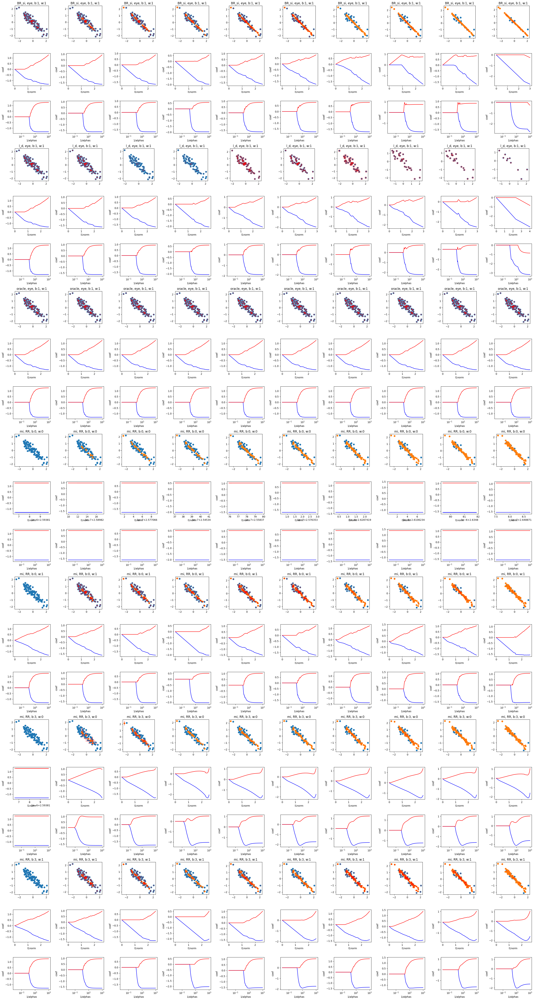

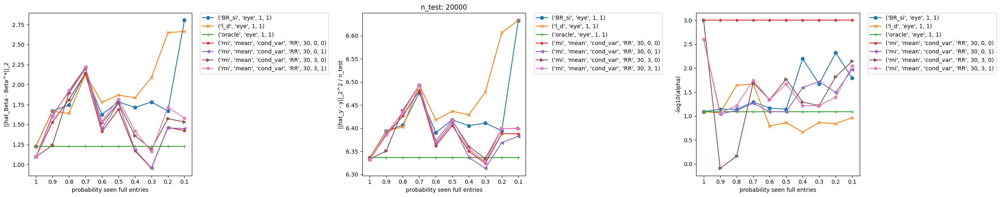

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.95], [-0.95, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
## very high correlation (-0.95), moderate error (2.5), moderate training set (100)
## when the probability of missing increases, mi beats both BR_si and l_d

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20300
n_train :  300
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9852216748768473
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR

100%|██████████| 200/200 [00:03<00:00, 53.91it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:03<00:00, 51.38it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:04<00:00, 40.47it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -145.15828923485157
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:07<00:00, 27.65it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.290511339606438
---------------------------------> best coeff  [-0.73454315  1.92825717]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -145.15828923485157
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:06<00:00, 28.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  6.27615091815017
---------------------------------> best coeff  [-0.69995595  1.89599714]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -145.15828923485157
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 

100%|██████████| 200/200 [00:07<00:00, 25.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.290511339606438
---------------------------------> best coeff  [-0.73454315  1.92825717]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -145.15828923485157
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:08<00:00, 24.72it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  6.27615091815017
---------------------------------> best coeff  [-0.69995595  1.89599714]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -3.488004215809711
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:02<00:00, 83.70it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.264437418858475
---------------------------------> best coeff  [-0.65449236  1.94268101]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -6.5696757893382784
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 72.87it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  6.263407446813641
---------------------------------> best coeff  [-0.64903637  1.94976025]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:02<00:00, 85.93it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -82.81450642366572
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:03<00:00, 51.65it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.279596797295571
---------------------------------> best coeff  [-0.7011645   1.94752278]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -82.81450642366572
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:05<00:00, 38.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  6.269595903066685
---------------------------------> best coeff  [-0.67618553  1.92316743]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -82.81450642366572
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:04<00:00, 49.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  96  best 1/best_alpha  3.8720387818125532 , min score  6.287929922146421
---------------------------------> best coeff  [-0.71012714  1.7931463 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -82.81450642366572
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 

100%|██████████| 200/200 [00:04<00:00, 47.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.2716949639398765
---------------------------------> best coeff  [-0.57687506  1.8029992 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -3.7349290303209957
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 62.06it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.264949726721555
---------------------------------> best coeff  [-0.6573213   1.93791711]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -2.679731070318832
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:02<00:00, 83.97it/s]


------------------------> who is S in add_rectangles
 [[0.01203378 0.        ]
 [0.         0.01203378]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  6.263235735665546
---------------------------------> best coeff  [-0.64887209  1.94765816]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 87.80it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -109.16803935334735
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 54.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.272810527499454
---------------------------------> best coeff  [-0.66752252  1.98573029]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -109.16803935334735
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:05<00:00, 35.77it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  6.2627146045283135
---------------------------------> best coeff  [-0.64343142  1.96073311]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -109.16803935334735
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0

100%|██████████| 200/200 [00:04<00:00, 46.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  92  best 1/best_alpha  4.880251583654428 , min score  6.276319011913889
---------------------------------> best coeff  [-0.65202184  1.79950705]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -109.16803935334735
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 

100%|██████████| 200/200 [00:04<00:00, 47.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  6.264190592487663
---------------------------------> best coeff  [-0.64864963  1.96162962]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -7.2490589389709434
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:02<00:00, 79.52it/s]


------------------------> who is S in add_rectangles
 [[0.03409285 0.        ]
 [0.         0.03409285]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  6.265011145903026
---------------------------------> best coeff  [-0.65670675  1.94226938]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -7.725466662415133
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:02<00:00, 72.30it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.2649038434121245
---------------------------------> best coeff  [-0.5225637   1.83823151]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

100%|██████████| 200/200 [00:02<00:00, 87.54it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -142.90355052457454
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 53.52it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.294757745962838
---------------------------------> best coeff  [-0.72695461  1.97828915]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -142.90355052457454
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:04<00:00, 48.59it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.269010977252306
---------------------------------> best coeff  [-0.67389155  1.92525565]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -142.90355052457454
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0

100%|██████████| 200/200 [00:05<00:00, 39.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.288927480339588
---------------------------------> best coeff  [-0.72167347  1.95769829]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -142.90355052457454
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 

100%|██████████| 200/200 [00:04<00:00, 48.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  6.274177378074953
---------------------------------> best coeff  [-0.69043285  1.927211  ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -2.5164456560304242
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:02<00:00, 88.78it/s]


------------------------> who is S in add_rectangles
 [[0.01275051 0.        ]
 [0.         0.01275051]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  44  best 1/best_alpha  78.42822061337678 , min score  6.264255773210329
---------------------------------> best coeff  [-0.65419089  1.94076015]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -5.753160903953696
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:01<00:00, 102.11it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.269381896941443
---------------------------------> best coeff  [-0.54183435  1.81687528]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:03<00:00, 65.31it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  21.14743832837223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:04<00:00, 41.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.311225640053611
---------------------------------> best coeff  [-0.77549026  1.94178401]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  21.14743832837223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 48.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  6.282625101839843
---------------------------------> best coeff  [-0.59860269  1.76733571]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  21.14743832837223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1
 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 45.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  6.307024650172129
---------------------------------> best coeff  [-0.77192623  1.92602516]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  21.14743832837223
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1
 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 40.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  6.290364739555142
---------------------------------> best coeff  [-0.74103754  1.88867495]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -8.485797951133158
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:02<00:00, 89.23it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.268382734460644
---------------------------------> best coeff  [-0.54296551  1.81993762]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -7.229334688400185
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:01<00:00, 131.93it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.285874189001168
---------------------------------> best coeff  [-0.54529455  1.76834575]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 88.55it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -158.52685148815348
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:04<00:00, 49.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.300782219007519
---------------------------------> best coeff  [-0.76789618  1.87307098]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -158.52685148815348
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 40.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  6.29252650796266
---------------------------------> best coeff  [-0.74703543  1.85384861]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -158.52685148815348
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 46.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.309822278046716
---------------------------------> best coeff  [-0.76002151  1.74903888]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -158.52685148815348
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 40.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.30202833549651
---------------------------------> best coeff  [-0.69200991  1.72575625]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -13.7857885857908
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:02<00:00, 83.79it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.270018349858507
---------------------------------> best coeff  [-0.55315253  1.81207894]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -7.231702604853352
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:01<00:00, 160.20it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  6.291349614960961
---------------------------------> best coeff  [-0.56592495  1.74908703]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:02<00:00, 88.55it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -363.4137750470869
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 54.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.318190441456724
---------------------------------> best coeff  [-0.78069834  1.96352382]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -363.4137750470869
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 40.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  6.281440989351606
---------------------------------> best coeff  [-0.59453206  1.77101767]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -363.4137750470869
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 46.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  6.309876015864365
---------------------------------> best coeff  [-0.7762222   1.93114769]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -363.4137750470869
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 48.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  6.295958152352477
---------------------------------> best coeff  [-0.75279246  1.90376357]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -5.541713090912605
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:02<00:00, 67.83it/s]


------------------------> who is S in add_rectangles
 [[0.01135733 0.        ]
 [0.         0.01135733]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  6.292951119914669
---------------------------------> best coeff  [-0.41413202  1.82377509]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -1.214557186720632
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputati

100%|██████████| 200/200 [00:01<00:00, 157.63it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.270234918518227
---------------------------------> best coeff  [-0.5394195   1.81473577]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 88.70it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -252.66689645213214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 51.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.2766529643015385
---------------------------------> best coeff  [-0.7015656   1.89563461]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -252.66689645213214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 48.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.275965548752839
---------------------------------> best coeff  [-0.69939896  1.89376903]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -252.66689645213214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:05<00:00, 36.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  6.283060443245829
---------------------------------> best coeff  [-0.65610346  1.77441428]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -252.66689645213214
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 48.08it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.28139753658229
---------------------------------> best coeff  [-0.61043809  1.77095689]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  17.687473676349942
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:02<00:00, 87.58it/s]


------------------------> who is S in add_rectangles
 [[0.00802643 0.        ]
 [0.         0.00802643]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  6.350986289482074
---------------------------------> best coeff  [-0.4027004   1.72054218]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  5.064043825978512
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (trai

100%|██████████| 200/200 [00:00<00:00, 260.59it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.348637232769653
---------------------------------> best coeff  [-0.64400825  1.62087222]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:03<00:00, 61.51it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  103.3611363663614
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 41.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.2946216244007545
---------------------------------> best coeff  [-0.74900227  1.82755092]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  103.3611363663614
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 48.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.297477685127643
---------------------------------> best coeff  [-0.64268094  1.72721512]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  103.3611363663614
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 43.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  6.305232988344237
---------------------------------> best coeff  [-0.7130751   1.72569061]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  103.3611363663614
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:05<00:00, 39.48it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  6.301563510723808
---------------------------------> best coeff  [-0.68480085  1.72451884]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20300, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -37.29172540494521
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:02<00:00, 87.20it/s]


------------------------> who is S in add_rectangles
 [[0.00378346 0.        ]
 [0.         0.00378346]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  8.033760306577808
---------------------------------> best coeff  [-1.56834636  0.48632787]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.704882143769345
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)

100%|██████████| 200/200 [00:00<00:00, 356.88it/s]


------------------------> who is S in add_rectangles
 [[0.00378346 0.        ]
 [0.         0.00378346]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  7.920565362509113
---------------------------------> best coeff  [-1.26575415  0.48777594]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -4.838609641161716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

100%|██████████| 200/200 [00:02<00:00, 87.21it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.274677808706637
---------------------------------> best coeff  [-0.69517179  1.89545066]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -58.15443831712414
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 53.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.414874227651546
---------------------------------> best coeff  [-0.97066877  1.76885039]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -58.15443831712414
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:05<00:00, 38.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.376873124096993
---------------------------------> best coeff  [-0.89794277  1.69078685]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -58.15443831712414
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 47.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.415677596411788
---------------------------------> best coeff  [-0.92476671  1.59803754]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.9658078  1.00490973]
crush test------------------------------------------------->  -58.15443831712414
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 47.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.401743550105654
---------------------------------> best coeff  [-0.95023407  1.73003342]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.69517179,  1.89545066]), array([-0.65449236,  1.94268101]), array([-0.6573213 ,  1.93791711]), array([-0.65670675,  1.94226938]), array([-0.65419089,  1.94076015]), array([-0.54296551,  1.81993762]), array([-0.55315253,  1.81207894]), array([-0.41413202,  1.82377509]), array([-0.4027004 ,  1.72054218]), array([-1.56834636,  0.48632787])], 'l2_dist_best_coeff_gt': [np.float64(0.22141046074543275), np.float64(0.1647827536996835), np.float64(0.16912799355169394), np.float64(0.1670024892396117), np.float64(0.1651792680363302), np.float64(0.18511751758404785), np.float64(0.1952934064006

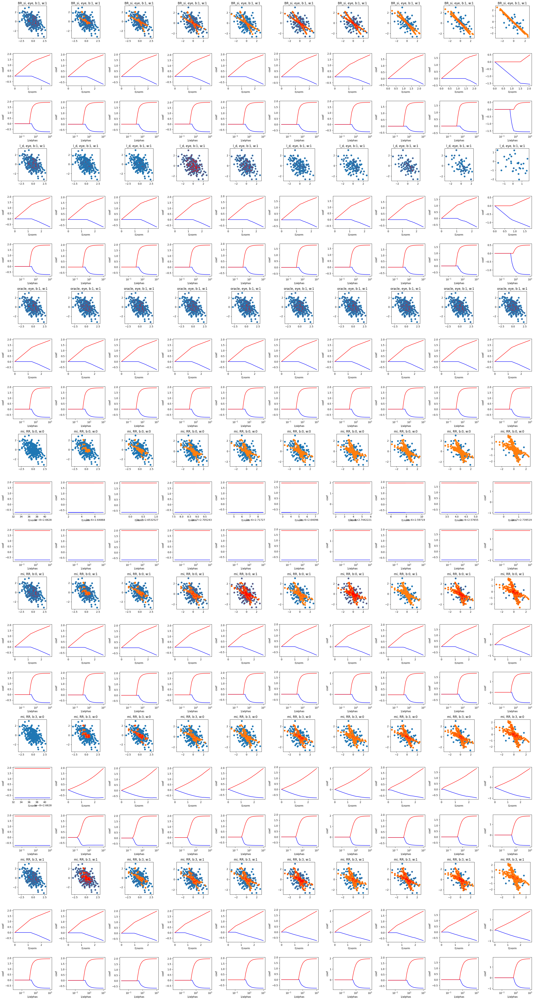

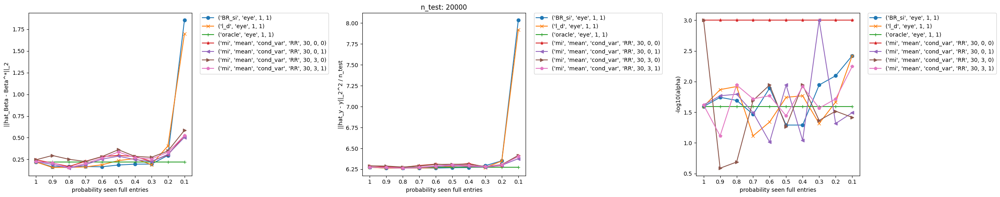

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [300] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
## moderate error (2.5), higher number of training points (300), moderate covariance (-0.5)
##

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR',

100%|██████████| 200/200 [00:01<00:00, 119.13it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 176.15it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 177.68it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  17.539977008603913
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00099457 0.91948679]
cov computed
s_between  [0.00000000e+00 6.66133815e-16]


100%|██████████| 200/200 [00:01<00:00, 130.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.330800340448455
---------------------------------> best coeff  [-1.09578211  1.6181527 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  17.539977008603913
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00099457 0.91948679]
cov computed
s_between  [0.00000000e+00 6.66133815e-16]
final S in cov strategy RR  [[1.00099457 0.        ]
 [0.         0.91948679]]
S within 
 [[1.00099457 0. 

100%|██████████| 200/200 [00:03<00:00, 66.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.29009785544239
---------------------------------> best coeff  [-1.0299264   1.53319464]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  17.539977008603913
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00099457 0.91948679]
cov computed
s_between  [0.00000000e+00 6.66133815e-16]
final S in cov strategy RR  [[1.00099457 0.        ]
 [0.         0.91948679]]
S within 
 [[1.

100%|██████████| 200/200 [00:01<00:00, 130.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.330800340448455
---------------------------------> best coeff  [-1.09578211  1.6181527 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  17.539977008603913
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00099457 0.91948679]
cov computed
s_between  [0.00000000e+00 6.66133815e-16]
final S in cov strategy RR  [[1.00099457 0.        ]
 [0.         0.91948679]]
S within 
 [[1.00099457 0. 

100%|██████████| 200/200 [00:02<00:00, 99.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.29009785544239
---------------------------------> best coeff  [-1.0299264   1.53319464]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -3.3274565690840947
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 175.34it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  25.452927627529697
---------------------------------> best coeff  [-1.19684219  1.41542346]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -1.261597062752453
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputat

100%|██████████| 200/200 [00:01<00:00, 192.23it/s]


------------------------> who is S in add_rectangles
 [[0.02409404 0.        ]
 [0.         0.02409404]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.53158914819163
---------------------------------> best coeff  [-1.25745981  1.34854018]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 178.47it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -122.1539145815393
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00499296 0.93199284]
cov computed
s_between  [0.0158711  0.01035161]
final S 

100%|██████████| 200/200 [00:01<00:00, 127.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.47801416525962
---------------------------------> best coeff  [-1.23917916  1.48909047]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -122.1539145815393
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00499296 0.93199284]
cov computed
s_between  [0.0158711  0.01035161]
final S in cov strategy RR  [[1.02139309 0.        ]
 [0.         0.9426895 ]]
S within 
 [[1.02139309 0.        ]


100%|██████████| 200/200 [00:01<00:00, 102.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.434552138315976
---------------------------------> best coeff  [-1.16941916  1.40032656]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -122.1539145815393
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00499296 0.93199284]
cov computed
s_between  [0.0158711  0.01035161]
final S in cov strategy RR  [[1.02139309 0.        ]
 [0.         0.9426895 ]]
S within 
 [[1.0213930

100%|██████████| 200/200 [00:01<00:00, 121.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  99  best 1/best_alpha  3.2550885998350565 , min score  25.420116008661992
---------------------------------> best coeff  [-1.04086275  1.2779336 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -122.1539145815393
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00499296 0.93199284]
cov computed
s_between  [0.0158711  0.01035161]
final S in cov strategy RR  [[1.02139309 0.        ]
 [0.         0.9426895 ]]
S within 
 [[1.0213930

100%|██████████| 200/200 [00:02<00:00, 67.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  25.431312194400288
---------------------------------> best coeff  [-1.05609499  1.27214321]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -6.126084430761072
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 178.31it/s]


------------------------> who is S in add_rectangles
 [[0.02409404 0.        ]
 [0.         0.02409404]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.534390919576172
---------------------------------> best coeff  [-1.26622724  1.36414249]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -3.20819377657201
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  

100%|██████████| 200/200 [00:00<00:00, 212.90it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  25.560870875479882
---------------------------------> best coeff  [-1.15520911  1.17164161]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 177.92it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -240.11766201052535
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01245245 0.93653933]
cov computed
s_between  [0.01932823 0.02206058]
final S

100%|██████████| 200/200 [00:01<00:00, 131.17it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.67397335974309
---------------------------------> best coeff  [-1.39821888  1.40315784]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -240.11766201052535
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01245245 0.93653933]
cov computed
s_between  [0.01932823 0.02206058]
final S in cov strategy RR  [[1.03242496 0.        ]
 [0.         0.95933527]]
S within 
 [[1.03242496 0.        ]

100%|██████████| 200/200 [00:01<00:00, 101.60it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  58  best 1/best_alpha  34.891012134067715 , min score  25.612849553004175
---------------------------------> best coeff  [-1.31650557  1.29059325]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -240.11766201052535
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01245245 0.93653933]
cov computed
s_between  [0.01932823 0.02206058]
final S in cov strategy RR  [[1.03242496 0.        ]
 [0.         0.95933527]]
S within 
 [[1.032424

100%|██████████| 200/200 [00:01<00:00, 123.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  80  best 1/best_alpha  9.77124153534649 , min score  25.655078197871784
---------------------------------> best coeff  [-1.34137224  1.25355068]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -240.11766201052535
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01245245 0.93653933]
cov computed
s_between  [0.01932823 0.02206058]
final S in cov strategy RR  [[1.03242496 0.        ]
 [0.         0.95933527]]
S within 
 [[1.03242496

100%|██████████| 200/200 [00:01<00:00, 101.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  25.627332646814338
---------------------------------> best coeff  [-1.2398102   1.15690251]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -4.740218205661843
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 181.66it/s]


------------------------> who is S in add_rectangles
 [[0.00636825 0.        ]
 [0.         0.00636825]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  25.587013066059786
---------------------------------> best coeff  [-1.30350705  1.32147958]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  1.146216478995969
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  

100%|██████████| 200/200 [00:00<00:00, 226.05it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  25.91381280007813
---------------------------------> best coeff  [-1.49338718  1.09045501]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 110.54it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -146.25706427833933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01480501 0.95430479]
cov computed
s_between  [0.02392471 0.03045609]
final S

100%|██████████| 200/200 [00:01<00:00, 132.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.61985627316895
---------------------------------> best coeff  [-1.34603581  1.36005092]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -146.25706427833933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01480501 0.95430479]
cov computed
s_between  [0.02392471 0.03045609]
final S in cov strategy RR  [[1.03952721 0.        ]
 [0.         0.98577608]]
S within 
 [[1.03952721 0.        ]

100%|██████████| 200/200 [00:02<00:00, 67.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  25.592767001431838
---------------------------------> best coeff  [-1.301612    1.30271762]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -146.25706427833933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01480501 0.95430479]
cov computed
s_between  [0.02392471 0.03045609]
final S in cov strategy RR  [[1.03952721 0.        ]
 [0.         0.98577608]]
S within 
 [[1.0395272

100%|██████████| 200/200 [00:01<00:00, 124.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  25.630906527447248
---------------------------------> best coeff  [-1.32220197  1.26368382]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -146.25706427833933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01480501 0.95430479]
cov computed
s_between  [0.02392471 0.03045609]
final S in cov strategy RR  [[1.03952721 0.        ]
 [0.         0.98577608]]
S within 
 [[1.039527

100%|██████████| 200/200 [00:01<00:00, 103.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  25.611841658289432
---------------------------------> best coeff  [-1.33215761  1.33571978]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -0.9984773805131182
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S with

100%|██████████| 200/200 [00:01<00:00, 114.47it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.32252703924941
---------------------------------> best coeff  [-0.97453871  1.38249803]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  1.190114686802934
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 251.66it/s]


------------------------> who is S in add_rectangles
 [[0.13667164 0.        ]
 [0.         0.13667164]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  85  best 1/best_alpha  7.316807143427192 , min score  25.61721607907956
---------------------------------> best coeff  [-1.1663389   1.11439755]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 179.63it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -45.602005588555265
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02207076 0.94063385]
cov computed
s_between  [0.02861489 0.02710543]
final S

100%|██████████| 200/200 [00:01<00:00, 131.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.375463798359757
---------------------------------> best coeff  [-1.13882467  1.67274992]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -45.602005588555265
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02207076 0.94063385]
cov computed
s_between  [0.02861489 0.02710543]
final S in cov strategy RR  [[1.05163947 0.        ]
 [0.         0.96864279]]
S within 
 [[1.05163947 0.        

100%|██████████| 200/200 [00:01<00:00, 103.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  25.28441405366827
---------------------------------> best coeff  [-1.0178924   1.52448554]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -45.602005588555265
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02207076 0.94063385]
cov computed
s_between  [0.02861489 0.02710543]
final S in cov strategy RR  [[1.05163947 0.        ]
 [0.         0.96864279]]
S within 
 [[1.05163947

100%|██████████| 200/200 [00:01<00:00, 122.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  25.326514716889733
---------------------------------> best coeff  [-1.0857328  1.5596725]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -45.602005588555265
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02207076 0.94063385]
cov computed
s_between  [0.02861489 0.02710543]
final S in cov strategy RR  [[1.05163947 0.        ]
 [0.         0.96864279]]
S within 
 [[1.05163947 

100%|██████████| 200/200 [00:02<00:00, 67.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.301850462700816
---------------------------------> best coeff  [-1.04860666  1.53858219]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -7.177472789505557
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 175.75it/s]


------------------------> who is S in add_rectangles
 [[0.02866068 0.        ]
 [0.         0.02866068]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  58  best 1/best_alpha  34.891012134067715 , min score  25.348930302668226
---------------------------------> best coeff  [-1.09289144  1.47935782]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -1.2260560287023639
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 275.62it/s]


------------------------> who is S in add_rectangles
 [[0.14481182 0.        ]
 [0.         0.14481182]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  86  best 1/best_alpha  6.905513520162324 , min score  25.670358176422962
---------------------------------> best coeff  [-1.33333858  1.20980198]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 175.65it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -205.80241668415528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99668439 0.96282494]
cov computed
s_between  [0.03638181 0.03123083]
final S

100%|██████████| 200/200 [00:01<00:00, 129.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.552802426942936
---------------------------------> best coeff  [-1.28637366  1.68734287]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -205.80241668415528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99668439 0.96282494]
cov computed
s_between  [0.03638181 0.03123083]
final S in cov strategy RR  [[1.03427893 0.        ]
 [0.         0.99509679]]
S within 
 [[1.03427893 0.        

100%|██████████| 200/200 [00:01<00:00, 102.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.35704427960248
---------------------------------> best coeff  [-1.09986905  1.46941548]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -205.80241668415528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99668439 0.96282494]
cov computed
s_between  [0.03638181 0.03123083]
final S in cov strategy RR  [[1.03427893 0.        ]
 [0.         0.99509679]]
S within 
 [[1.03427893

100%|██████████| 200/200 [00:01<00:00, 121.02it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.437520654443343
---------------------------------> best coeff  [-1.19937325  1.49177975]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -205.80241668415528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99668439 0.96282494]
cov computed
s_between  [0.03638181 0.03123083]
final S in cov strategy RR  [[1.03427893 0.        ]
 [0.         0.99509679]]
S within 
 [[1.0342789

100%|██████████| 200/200 [00:01<00:00, 102.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.392387170275796
---------------------------------> best coeff  [-1.14459098  1.47015606]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -3.2347226025056988
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S with

100%|██████████| 200/200 [00:01<00:00, 177.52it/s]


------------------------> who is S in add_rectangles
 [[0.03036771 0.        ]
 [0.         0.03036771]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  25.34603537592348
---------------------------------> best coeff  [-1.08718825  1.47485804]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  1.1821408539726477
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one mat

100%|██████████| 200/200 [00:00<00:00, 297.79it/s]


------------------------> who is S in add_rectangles
 [[0.21711179 0.        ]
 [0.         0.21711179]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  93  best 1/best_alpha  4.605922041145103 , min score  25.642295984806903
---------------------------------> best coeff  [-1.30381706  1.21074084]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 114.70it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -202.20147040187732
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98872618 0.95888142]
cov computed
s_between  [0.02834859 0.0384271 ]
final S

100%|██████████| 200/200 [00:01<00:00, 125.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.887955878315445
---------------------------------> best coeff  [-1.36597923  2.00553484]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -202.20147040187732
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98872618 0.95888142]
cov computed
s_between  [0.02834859 0.0384271 ]
final S in cov strategy RR  [[1.01801973 0.        ]
 [0.         0.99858943]]
S within 
 [[1.01801973 0.        

100%|██████████| 200/200 [00:02<00:00, 66.81it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  25.267989237977066
---------------------------------> best coeff  [-1.01283077  1.58609037]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -202.20147040187732
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98872618 0.95888142]
cov computed
s_between  [0.02834859 0.0384271 ]
final S in cov strategy RR  [[1.01801973 0.        ]
 [0.         0.99858943]]
S within 
 [[1.018019

100%|██████████| 200/200 [00:01<00:00, 119.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  25.338522710187505
---------------------------------> best coeff  [-1.09835084  1.54753624]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -202.20147040187732
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98872618 0.95888142]
cov computed
s_between  [0.02834859 0.0384271 ]
final S in cov strategy RR  [[1.01801973 0.        ]
 [0.         0.99858943]]
S within 
 [[1.018019

100%|██████████| 200/200 [00:01<00:00, 102.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  25.29700607217044
---------------------------------> best coeff  [-0.93459779  1.39962316]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -2.8541647396219965
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 176.17it/s]


------------------------> who is S in add_rectangles
 [[0.08603464 0.        ]
 [0.         0.08603464]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  25.169941568706314
---------------------------------> best coeff  [-0.87286139  1.70632742]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  1.468477918942892
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)

100%|██████████| 200/200 [00:00<00:00, 334.00it/s]


------------------------> who is S in add_rectangles
 [[0.19338918 0.        ]
 [0.         0.19338918]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  91  best 1/best_alpha  5.170920242896755 , min score  25.832656138899903
---------------------------------> best coeff  [-1.27019553  0.96158862]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 173.21it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -37.350700382458356
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00713975 0.99780364]
cov computed
s_between  [0.03781885 0.03033934]
final S

100%|██████████| 200/200 [00:01<00:00, 136.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.749527565350622
---------------------------------> best coeff  [-1.20557581  2.13316206]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -37.350700382458356
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00713975 0.99780364]
cov computed
s_between  [0.03781885 0.03033934]
final S in cov strategy RR  [[1.04621922 0.        ]
 [0.         1.0291543 ]]
S within 
 [[1.04621922 0.        

100%|██████████| 200/200 [00:01<00:00, 101.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  25.144214743146847
---------------------------------> best coeff  [-0.82104793  1.71591956]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -37.350700382458356
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00713975 0.99780364]
cov computed
s_between  [0.03781885 0.03033934]
final S in cov strategy RR  [[1.04621922 0.        ]
 [0.         1.0291543 ]]
S within 
 [[1.046219

100%|██████████| 200/200 [00:01<00:00, 120.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  25.18534406008106
---------------------------------> best coeff  [-0.89829901  1.6826138 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -37.350700382458356
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00713975 0.99780364]
cov computed
s_between  [0.03781885 0.03033934]
final S in cov strategy RR  [[1.04621922 0.        ]
 [0.         1.0291543 ]]
S within 
 [[1.0462192

100%|██████████| 200/200 [00:02<00:00, 73.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.162778772637825
---------------------------------> best coeff  [-0.75167185  1.56855106]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  12.144484575063531
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 149.78it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  25.373136159355862
---------------------------------> best coeff  [-0.97475925  1.30643128]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  4.4019040996818894
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 371.36it/s]


------------------------> who is S in add_rectangles
 [[0.20490747 0.        ]
 [0.         0.20490747]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  92  best 1/best_alpha  4.880251583654428 , min score  26.31900143314876
---------------------------------> best coeff  [-1.52309052  0.7174021 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 169.26it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  146.65689192124046
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00907032 0.99003877]
cov computed
s_between  [0.0423734  0.04033537]
final S 

100%|██████████| 200/200 [00:01<00:00, 117.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.00084279630174
---------------------------------> best coeff  [-1.40425926  2.04459192]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  146.65689192124046
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00907032 0.99003877]
cov computed
s_between  [0.0423734  0.04033537]
final S in cov strategy RR  [[1.05285617 0.        ]
 [0.         1.03171865]]
S within 
 [[1.05285617 0.        ]


100%|██████████| 200/200 [00:01<00:00, 102.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  25.25921973573869
---------------------------------> best coeff  [-0.85901314  1.42563032]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  146.65689192124046
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00907032 0.99003877]
cov computed
s_between  [0.0423734  0.04033537]
final S in cov strategy RR  [[1.05285617 0.        ]
 [0.         1.03171865]]
S within 
 [[1.05285617

100%|██████████| 200/200 [00:01<00:00, 120.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  25.34300429051746
---------------------------------> best coeff  [-0.97765841  1.35144199]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  146.65689192124046
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00907032 0.99003877]
cov computed
s_between  [0.0423734  0.04033537]
final S in cov strategy RR  [[1.05285617 0.        ]
 [0.         1.03171865]]
S within 
 [[1.05285617

100%|██████████| 200/200 [00:01<00:00, 103.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.294875778591738
---------------------------------> best coeff  [-0.93852416  1.40565739]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -4.2020512102216
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 174.45it/s]


------------------------> who is S in add_rectangles
 [[0.1084366 0.       ]
 [0.        0.1084366]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  25.11343938599778
---------------------------------> best coeff  [-0.61672241  1.66547267]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.6597243822156441
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 446.58it/s]


------------------------> who is S in add_rectangles
 [[0.32550886 0.        ]
 [0.         0.32550886]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  100  best 1/best_alpha  3.072112998861756 , min score  27.80297214143913
---------------------------------> best coeff  [-1.32715410e+00 -3.00561367e-11]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  0.5846659002867955
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]


100%|██████████| 200/200 [00:01<00:00, 152.28it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  25.299654259868554
---------------------------------> best coeff  [-0.94941363  1.40449702]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -135.96106393108332
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0073286  1.01667597]
cov computed
s_between  [0.04780927 0.0597574 ]
final S

100%|██████████| 200/200 [00:01<00:00, 134.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.010554834878903
---------------------------------> best coeff  [-1.29358317  2.22079329]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -135.96106393108332
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0073286  1.01667597]
cov computed
s_between  [0.04780927 0.0597574 ]
final S in cov strategy RR  [[1.05673151 0.        ]
 [0.         1.07842528]]
S within 
 [[1.05673151 0.        

100%|██████████| 200/200 [00:02<00:00, 81.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  25.161434026100142
---------------------------------> best coeff  [-0.74108433  1.56814604]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -135.96106393108332
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0073286  1.01667597]
cov computed
s_between  [0.04780927 0.0597574 ]
final S in cov strategy RR  [[1.05673151 0.        ]
 [0.         1.07842528]]
S within 
 [[1.056731

100%|██████████| 200/200 [00:02<00:00, 90.63it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.227924841176435
---------------------------------> best coeff  [-0.96386555  1.64639017]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00099457 0.91948679]
crush test------------------------------------------------->  -135.96106393108332
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0073286  1.01667597]
cov computed
s_between  [0.04780927 0.0597574 ]
final S in cov strategy RR  [[1.05673151 0.        ]
 [0.         1.07842528]]
S within 
 [[1.0567315

100%|██████████| 200/200 [00:01<00:00, 101.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  25.197475869770987
---------------------------------> best coeff  [-0.80951338  1.51725997]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.94941363,  1.40449702]), array([-1.19684219,  1.41542346]), array([-1.26622724,  1.36414249]), array([-1.30350705,  1.32147958]), array([-0.97453871,  1.38249803]), array([-1.09289144,  1.47935782]), array([-1.08718825,  1.47485804]), array([-0.87286139,  1.70632742]), array([-0.97475925,  1.30643128]), array([-0.61672241,  1.66547267])], 'l2_dist_best_coeff_gt': [np.float64(0.7460538950011955), np.float64(0.9095706520274068), np.float64(0.9957002391929991), np.float64(1.0516717791080747), np.float64(0.7787783152934826), np.float64(0.7890428013267466), np.float64(0.7877589260877426

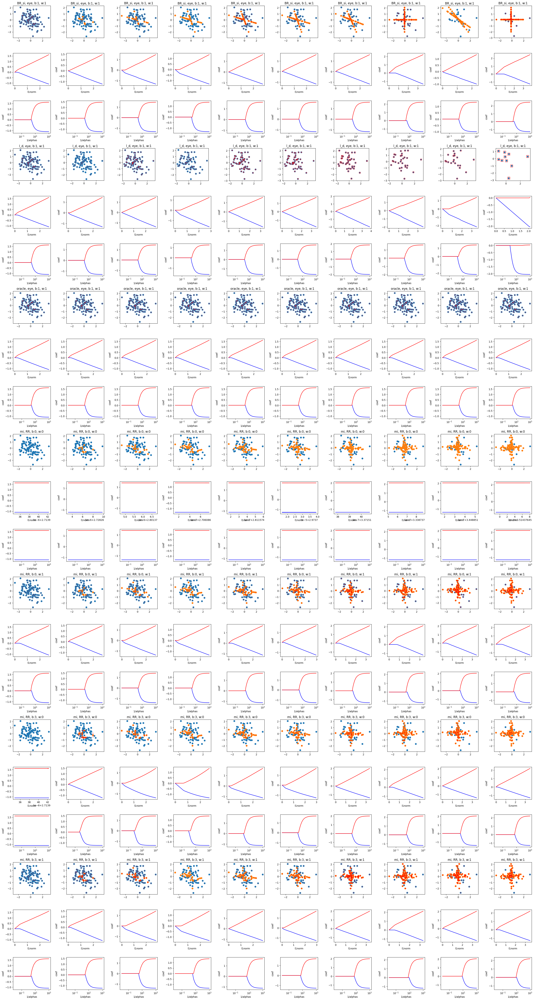

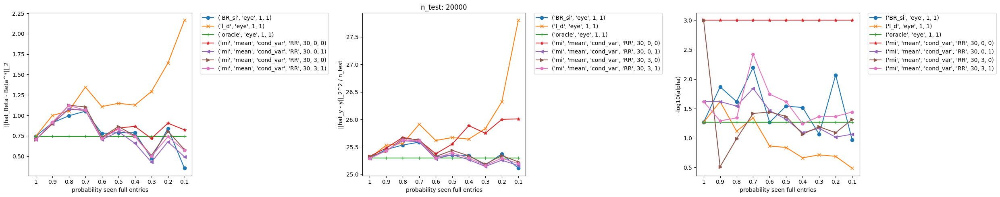

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




In [ ]:
###

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': '

100%|██████████| 200/200 [00:01<00:00, 110.40it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 110.79it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:02<00:00, 67.75it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -53.631246996252045
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00583342 0.92007504]
cov computed
s_between  [0.00000000e+00 3.33066907e-16]


100%|██████████| 200/200 [00:01<00:00, 136.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.331450842549447
---------------------------------> best coeff  [-1.37049412  1.11689179]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -53.631246996252045
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00583342 0.92007504]
cov computed
s_between  [0.00000000e+00 3.33066907e-16]
final S in cov strategy RR  [[1.00583342 0.        ]
 [0.         0.92007504]]
S within 
 [[1.00583342 0.

100%|██████████| 200/200 [00:01<00:00, 104.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.34206637444592
---------------------------------> best coeff  [-1.3257901   1.06722961]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -53.631246996252045
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00583342 0.92007504]
cov computed
s_between  [0.00000000e+00 3.33066907e-16]
final S in cov strategy RR  [[1.00583342 0.        ]
 [0.         0.92007504]]
S within 
 [[1.

100%|██████████| 200/200 [00:01<00:00, 138.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.331450842549447
---------------------------------> best coeff  [-1.37049412  1.11689179]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -53.631246996252045
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.00583342 0.92007504]
cov computed
s_between  [0.00000000e+00 3.33066907e-16]
final S in cov strategy RR  [[1.00583342 0.        ]
 [0.         0.92007504]]
S within 
 [[1.00583342 0.

100%|██████████| 200/200 [00:02<00:00, 82.62it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.34206637444592
---------------------------------> best coeff  [-1.3257901   1.06722961]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  1.1856594363649968
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S wit

100%|██████████| 200/200 [00:01<00:00, 133.38it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  25.279571371911707
---------------------------------> best coeff  [-1.36675201  1.29943206]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  0.6434476324660603
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:00<00:00, 203.28it/s]


------------------------> who is S in add_rectangles
 [[0.00802643 0.        ]
 [0.         0.00802643]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  25.225007482808792
---------------------------------> best coeff  [-1.29527101  1.36058718]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 183.50it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  33.616589999081796
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99875024 0.92190234]
cov computed
s_between  [0.00991772 0.01030479]
final S i

100%|██████████| 200/200 [00:01<00:00, 105.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.25667082926135
---------------------------------> best coeff  [-1.33979     1.36476907]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  33.616589999081796
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99875024 0.92190234]
cov computed
s_between  [0.00991772 0.01030479]
final S in cov strategy RR  [[1.00899856 0.        ]
 [0.         0.93255063]]
S within 
 [[1.00899856 0.        ]


100%|██████████| 200/200 [00:01<00:00, 106.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  25.229999189981417
---------------------------------> best coeff  [-1.29283808  1.31015316]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  33.616589999081796
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99875024 0.92190234]
cov computed
s_between  [0.00991772 0.01030479]
final S in cov strategy RR  [[1.00899856 0.        ]
 [0.         0.93255063]]
S within 
 [[1.00899856

100%|██████████| 200/200 [00:01<00:00, 130.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  25.267249773283
---------------------------------> best coeff  [-1.34996764  1.30438506]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  33.616589999081796
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99875024 0.92190234]
cov computed
s_between  [0.00991772 0.01030479]
final S in cov strategy RR  [[1.00899856 0.        ]
 [0.         0.93255063]]
S within 
 [[1.00899856 0

100%|██████████| 200/200 [00:01<00:00, 106.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  25.240657810465567
---------------------------------> best coeff  [-1.31360108  1.32407629]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  2.893646589154125
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S with

100%|██████████| 200/200 [00:01<00:00, 187.14it/s]


------------------------> who is S in add_rectangles
 [[0.00674754 0.        ]
 [0.         0.00674754]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  25.28588456644692
---------------------------------> best coeff  [-1.37503605  1.29585726]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  1.6673127002215353
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  

100%|██████████| 200/200 [00:00<00:00, 214.37it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  25.23303044579844
---------------------------------> best coeff  [-1.30674733  1.35663925]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 185.15it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  109.97280766977667
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00226852 0.94038145]
cov computed
s_between  [0.01502385 0.01532055]
final S i

100%|██████████| 200/200 [00:01<00:00, 134.53it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.23320843757141
---------------------------------> best coeff  [-1.30808906  1.405105  ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  109.97280766977667
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00226852 0.94038145]
cov computed
s_between  [0.01502385 0.01532055]
final S in cov strategy RR  [[1.01779316 0.        ]
 [0.         0.95621268]]
S within 
 [[1.01779316 0.        ]


100%|██████████| 200/200 [00:01<00:00, 105.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  25.20757527453953
---------------------------------> best coeff  [-1.19322163  1.24642749]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  109.97280766977667
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00226852 0.94038145]
cov computed
s_between  [0.01502385 0.01532055]
final S in cov strategy RR  [[1.01779316 0.        ]
 [0.         0.95621268]]
S within 
 [[1.01779316

100%|██████████| 200/200 [00:02<00:00, 83.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  25.24350732994303
---------------------------------> best coeff  [-1.32141705  1.35188319]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  109.97280766977667
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00226852 0.94038145]
cov computed
s_between  [0.01502385 0.01532055]
final S in cov strategy RR  [[1.01779316 0.        ]
 [0.         0.95621268]]
S within 
 [[1.01779316 

100%|██████████| 200/200 [00:01<00:00, 100.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  25.226080578342433
---------------------------------> best coeff  [-1.29849535  1.38294949]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  2.395949221442888
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 179.01it/s]


------------------------> who is S in add_rectangles
 [[0.00357079 0.        ]
 [0.         0.00357079]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  25.175225827032044
---------------------------------> best coeff  [-1.22545421  1.45197337]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -0.4016462362014348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000

100%|██████████| 200/200 [00:00<00:00, 233.38it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  25.152405290980067
---------------------------------> best coeff  [-1.19003763  1.48532912]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 184.05it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  107.6733287530428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02147047 0.94733496]
cov computed
s_between  [0.01737941 0.02432449]
final S in

100%|██████████| 200/200 [00:01<00:00, 124.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.166402840366338
---------------------------------> best coeff  [-1.2051985   1.53234022]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  107.6733287530428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02147047 0.94733496]
cov computed
s_between  [0.01737941 0.02432449]
final S in cov strategy RR  [[1.0394292  0.        ]
 [0.         0.97247027]]
S within 
 [[1.0394292  0.        ]


100%|██████████| 200/200 [00:01<00:00, 102.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  25.137258739963595
---------------------------------> best coeff  [-1.16450476  1.47091433]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  107.6733287530428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02147047 0.94733496]
cov computed
s_between  [0.01737941 0.02432449]
final S in cov strategy RR  [[1.0394292  0.        ]
 [0.         0.97247027]]
S within 
 [[1.0394292  

100%|██████████| 200/200 [00:01<00:00, 123.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.157221302069598
---------------------------------> best coeff  [-1.19623246  1.50389617]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  107.6733287530428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02147047 0.94733496]
cov computed
s_between  [0.01737941 0.02432449]
final S in cov strategy RR  [[1.0394292  0.        ]
 [0.         0.97247027]]
S within 
 [[1.0394292 

100%|██████████| 200/200 [00:01<00:00, 104.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  44  best 1/best_alpha  78.42822061337678 , min score  25.142108298739167
---------------------------------> best coeff  [-1.17326062  1.47649111]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  3.4472304484550147
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 142.12it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  25.163034176810545
---------------------------------> best coeff  [-1.20195107  1.52436494]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  0.32434356070452175
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:01<00:00, 162.22it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  25.194856542502297
---------------------------------> best coeff  [-1.25418767  1.44517936]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1

100%|██████████| 200/200 [00:01<00:00, 159.03it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  105.99355819547387
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01828582 0.93995659]
cov computed
s_between  [0.02057449 0.02949529]
final S i

100%|██████████| 200/200 [00:02<00:00, 92.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.136239142883646
---------------------------------> best coeff  [-1.10643588  1.72310607]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  105.99355819547387
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01828582 0.93995659]
cov computed
s_between  [0.02057449 0.02949529]
final S in cov strategy RR  [[1.03954613 0.        ]
 [0.         0.97043506]]
S within 
 [[1.03954613 0.        ]

100%|██████████| 200/200 [00:02<00:00, 87.63it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  25.067544371632703
---------------------------------> best coeff  [-1.0394876   1.59415819]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  105.99355819547387
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01828582 0.93995659]
cov computed
s_between  [0.02057449 0.02949529]
final S in cov strategy RR  [[1.03954613 0.        ]
 [0.         0.97043506]]
S within 
 [[1.03954613

100%|██████████| 200/200 [00:01<00:00, 126.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  25.089688172944893
---------------------------------> best coeff  [-1.07575153  1.6239441 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  105.99355819547387
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.01828582 0.93995659]
cov computed
s_between  [0.02057449 0.02949529]
final S in cov strategy RR  [[1.03954613 0.        ]
 [0.         0.97043506]]
S within 
 [[1.0395461

100%|██████████| 200/200 [00:01<00:00, 106.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.07222751965964
---------------------------------> best coeff  [-1.04842591  1.59993897]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  5.898895806531313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wit

100%|██████████| 200/200 [00:01<00:00, 182.04it/s]


------------------------> who is S in add_rectangles
 [[0.02409404 0.        ]
 [0.         0.02409404]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.464441687212865
---------------------------------> best coeff  [-1.56152943  1.0675835 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  1.3631353136628448
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 272.07it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  25.607982435100876
---------------------------------> best coeff  [-1.71593972  1.11724544]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 181.30it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  276.6663445943933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02010317 0.9170441 ]
cov computed
s_between  [0.03205354 0.02060077]
final S in

100%|██████████| 200/200 [00:01<00:00, 133.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.345647377474236
---------------------------------> best coeff  [-1.42444435  1.44475263]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  276.6663445943933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02010317 0.9170441 ]
cov computed
s_between  [0.03205354 0.02060077]
final S in cov strategy RR  [[1.05322516 0.        ]
 [0.         0.93833156]]
S within 
 [[1.05322516 0.        ]


100%|██████████| 200/200 [00:01<00:00, 104.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  25.252382303176752
---------------------------------> best coeff  [-1.32930887  1.31220868]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  276.6663445943933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02010317 0.9170441 ]
cov computed
s_between  [0.03205354 0.02060077]
final S in cov strategy RR  [[1.05322516 0.        ]
 [0.         0.93833156]]
S within 
 [[1.05322516

100%|██████████| 200/200 [00:01<00:00, 113.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  25.2812588682632
---------------------------------> best coeff  [-1.37010051  1.30915092]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  276.6663445943933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02010317 0.9170441 ]
cov computed
s_between  [0.03205354 0.02060077]
final S in cov strategy RR  [[1.05322516 0.        ]
 [0.         0.93833156]]
S within 
 [[1.05322516 0

100%|██████████| 200/200 [00:02<00:00, 73.25it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  25.262734762155077
---------------------------------> best coeff  [-1.34457241  1.31201817]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  14.31315230833745
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wit

100%|██████████| 200/200 [00:01<00:00, 179.46it/s]


------------------------> who is S in add_rectangles
 [[0.12173827 0.        ]
 [0.         0.12173827]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  26.721121080533962
---------------------------------> best coeff  [-2.09643377e+00  1.82541153e-09]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  4.902802654155879
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80


100%|██████████| 200/200 [00:00<00:00, 300.22it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  26.546768798365445
---------------------------------> best coeff  [-2.38931237  0.5490829 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 182.61it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  545.9163196851177
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99258571 0.91787704]
cov computed
s_between  [0.04388037 0.02238997]
final S in

100%|██████████| 200/200 [00:01<00:00, 137.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.353104741121353
---------------------------------> best coeff  [-2.27129827  0.68013657]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  545.9163196851177
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99258571 0.91787704]
cov computed
s_between  [0.04388037 0.02238997]
final S in cov strategy RR  [[1.03792876 0.        ]
 [0.         0.94101335]]
S within 
 [[1.03792876 0.        ]


100%|██████████| 200/200 [00:01<00:00, 105.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  26.131277399935378
---------------------------------> best coeff  [-2.07335137  0.53392049]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  545.9163196851177
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99258571 0.91787704]
cov computed
s_between  [0.04388037 0.02238997]
final S in cov strategy RR  [[1.03792876 0.        ]
 [0.         0.94101335]]
S within 
 [[1.03792876 0

100%|██████████| 200/200 [00:01<00:00, 125.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  95  best 1/best_alpha  4.1026581058271905 , min score  25.641458911651856
---------------------------------> best coeff  [-1.32423259  0.75065476]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  545.9163196851177
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99258571 0.91787704]
cov computed
s_between  [0.04388037 0.02238997]
final S in cov strategy RR  [[1.03792876 0.        ]
 [0.         0.94101335]]
S within 
 [[1.03792876

100%|██████████| 200/200 [00:01<00:00, 106.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  25.975097358627846
---------------------------------> best coeff  [-1.67788017  0.47204349]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  8.592705236612204
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 181.30it/s]


------------------------> who is S in add_rectangles
 [[0.1722586 0.       ]
 [0.        0.1722586]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  89  best 1/best_alpha  5.805225516094896 , min score  26.723584346922557
---------------------------------> best coeff  [-1.87227549e+00  3.53682563e-09]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  2.044407765196972
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n,

100%|██████████| 200/200 [00:00<00:00, 328.62it/s]


------------------------> who is S in add_rectangles
 [[0.41026581 0.        ]
 [0.         0.41026581]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  104  best 1/best_alpha  2.4374441501222193 , min score  26.726567923626245
---------------------------------> best coeff  [-1.86049935e+00  1.44953514e-09]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0

100%|██████████| 200/200 [00:01<00:00, 124.33it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  459.479124403451
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.990577   0.93894833]
cov computed
s_between  [0.04364759 0.03144608]
final S in 

100%|██████████| 200/200 [00:01<00:00, 136.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.35406100877284
---------------------------------> best coeff  [-2.24936966  0.86301601]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  459.479124403451
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.990577   0.93894833]
cov computed
s_between  [0.04364759 0.03144608]
final S in cov strategy RR  [[1.03567951 0.        ]
 [0.         0.97144261]]
S within 
 [[1.03567951 0.        ]
 [

100%|██████████| 200/200 [00:02<00:00, 83.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  25.96668449696696
---------------------------------> best coeff  [-1.91784949  0.58081206]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  459.479124403451
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.990577   0.93894833]
cov computed
s_between  [0.04364759 0.03144608]
final S in cov strategy RR  [[1.03567951 0.        ]
 [0.         0.97144261]]
S within 
 [[1.03567951 0

100%|██████████| 200/200 [00:02<00:00, 96.18it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  87  best 1/best_alpha  6.5173396048824195 , min score  25.330144699114314
---------------------------------> best coeff  [-1.27667274  1.06834375]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  459.479124403451
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.990577   0.93894833]
cov computed
s_between  [0.04364759 0.03144608]
final S in cov strategy RR  [[1.03567951 0.        ]
 [0.         0.97144261]]
S within 
 [[1.03567951 

100%|██████████| 200/200 [00:01<00:00, 106.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  25.674317584236764
---------------------------------> best coeff  [-1.63990671  0.75366998]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  5.172403411957661
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S wi

100%|██████████| 200/200 [00:01<00:00, 183.78it/s]


------------------------> who is S in add_rectangles
 [[0.1148951 0.       ]
 [0.        0.1148951]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  82  best 1/best_alpha  8.703591361485158 , min score  26.7228112254143
---------------------------------> best coeff  [-2.10388155e+00  2.61488807e-09]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  1.2454755619231852
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 353.27it/s]


------------------------> who is S in add_rectangles
 [[0.65173396 0.        ]
 [0.         0.65173396]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  112  best 1/best_alpha  1.5343684089300116 , min score  26.726532737486828
---------------------------------> best coeff  [-2.11877456e+00  7.45569692e-10]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0

100%|██████████| 200/200 [00:01<00:00, 182.23it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  174.38051682639693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93814467 0.95454192]
cov computed
s_between  [0.03107191 0.03465913]
final S i

100%|██████████| 200/200 [00:01<00:00, 127.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.30905239127083
---------------------------------> best coeff  [-2.04397077  1.36954588]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  174.38051682639693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93814467 0.95454192]
cov computed
s_between  [0.03107191 0.03465913]
final S in cov strategy RR  [[0.97025232 0.        ]
 [0.         0.99035635]]
S within 
 [[0.97025232 0.        ]


100%|██████████| 200/200 [00:01<00:00, 103.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  85  best 1/best_alpha  7.316807143427192 , min score  25.619352994481908
---------------------------------> best coeff  [-1.61018104  0.80956193]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  174.38051682639693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93814467 0.95454192]
cov computed
s_between  [0.03107191 0.03465913]
final S in cov strategy RR  [[0.97025232 0.        ]
 [0.         0.99035635]]
S within 
 [[0.97025232

100%|██████████| 200/200 [00:01<00:00, 119.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  84  best 1/best_alpha  7.752597488629456 , min score  25.445022236654125
---------------------------------> best coeff  [-1.50923197  1.02203735]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  174.38051682639693
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93814467 0.95454192]
cov computed
s_between  [0.03107191 0.03465913]
final S in cov strategy RR  [[0.97025232 0.        ]
 [0.         0.99035635]]
S within 
 [[0.97025232

100%|██████████| 200/200 [00:01<00:00, 105.57it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  25.539081454195113
---------------------------------> best coeff  [-1.47939593  0.85223568]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1.  , -0.75],
       [-0.75,  1.  ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  30.794092960007852
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S w

100%|██████████| 200/200 [00:01<00:00, 114.15it/s]


------------------------> who is S in add_rectangles
 [[0.15343684 0.        ]
 [0.         0.15343684]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  87  best 1/best_alpha  6.5173396048824195 , min score  26.720929848860127
---------------------------------> best coeff  [-1.88384842e+00  3.20638054e-09]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  4.319168187624849
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 281.56it/s]


------------------------> who is S in add_rectangles
 [[0.51709202 0.        ]
 [0.         0.51709202]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  108  best 1/best_alpha  1.9338917504552302 , min score  26.733348128856747
---------------------------------> best coeff  [-2.14232655e+00  2.60023366e-11]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  -1.7877082332084027
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0

100%|██████████| 200/200 [00:03<00:00, 58.04it/s] 


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  25.342979143750274
---------------------------------> best coeff  [-1.35014876  1.07845116]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  190.01118202420784
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89176151 1.00238969]
cov computed
s_between  [0.0447626 0.0555092]
final S in 

100%|██████████| 200/200 [00:01<00:00, 130.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  28.07175979644871
---------------------------------> best coeff  [-2.06054412  2.23432782]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  190.01118202420784
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89176151 1.00238969]
cov computed
s_between  [0.0447626 0.0555092]
final S in cov strategy RR  [[0.9380162 0.       ]
 [0.        1.0597492]]
S within 
 [[0.9380162 0.       ]
 [0.    

100%|██████████| 200/200 [00:01<00:00, 101.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  84  best 1/best_alpha  7.752597488629456 , min score  25.180492044757667
---------------------------------> best coeff  [-1.22614381  1.3816917 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  190.01118202420784
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89176151 1.00238969]
cov computed
s_between  [0.0447626 0.0555092]
final S in cov strategy RR  [[0.9380162 0.       ]
 [0.        1.0597492]]
S within 
 [[0.9380162 0.    

100%|██████████| 200/200 [00:01<00:00, 115.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  82  best 1/best_alpha  8.703591361485158 , min score  25.177639320622315
---------------------------------> best coeff  [-1.0534858   1.26270276]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.00583342 0.92007504]
crush test------------------------------------------------->  190.01118202420784
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.89176151 1.00238969]
cov computed
s_between  [0.0447626 0.0555092]
final S in cov strategy RR  [[0.9380162 0.       ]
 [0.        1.0597492]]
S within 
 [[0.9380162 0.    

100%|██████████| 200/200 [00:01<00:00, 101.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  25.178353713626066
---------------------------------> best coeff  [-1.06670398  1.2622395 ]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-1.35014876,  1.07845116]), array([-1.36675201,  1.29943206]), array([-1.37503605,  1.29585726]), array([-1.22545421,  1.45197337]), array([-1.20195107,  1.52436494]), array([-1.56152943,  1.0675835 ]), array([-2.09643377e+00,  1.82541153e-09]), array([-1.87227549e+00,  3.53682563e-09]), array([-2.10388155e+00,  2.61488807e-09]), array([-1.88384842e+00,  3.20638054e-09])], 'l2_dist_best_coeff_gt': [np.float64(1.2537963088645356), np.float64(1.1144749812332835), np.float64(1.1231674370974238), np.float64(0.9091848023998238), np.float64(0.8479174563648038), np.float64(1.412885438218745

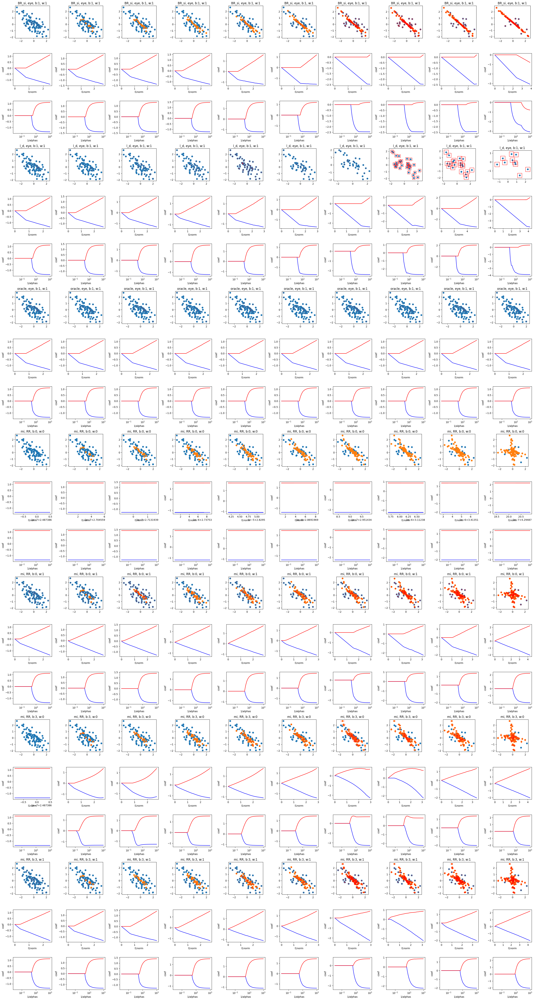

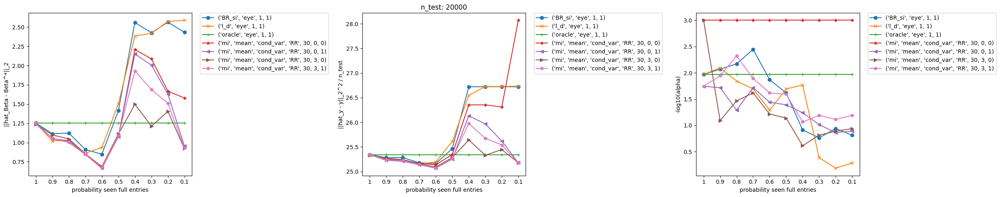

In [ ]:
np.random.seed(456)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.75], [-0.75, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
n_tot :  20050
n_train :  50
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9975062344139651
err :  {'type': 'Gaussian_on_y', 'scaling': 4}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 

100%|██████████| 200/200 [00:00<00:00, 268.34it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 267.18it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 277.49it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -27.525666983872775
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.05598689 1.15428136]
cov computed
s_between  [6.66133815e-16 2.22044605e-16]
final S in cov strategy RR  [[1.05598689 0.        ]
 [0.         1.15428136]]
S within 
 [[1.0559868

100%|██████████| 200/200 [00:00<00:00, 203.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  15.932793221156718
---------------------------------> best coeff  [-0.23719126  2.07637312]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -27.525666983872775
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.05598689 1.15428136]
cov computed
s_between  [6.66133815e-16 2.22044605e-16]
final S in cov strategy RR  [[1.05598689 0.        ]
 [0.         1.15428136]]
S within 
 [[1.05598689 0.        ]
 [0.         1.15428136]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  5

100%|██████████| 200/200 [00:01<00:00, 140.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944154816366197
---------------------------------> best coeff  [-0.22193126  2.061105  ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -27.525666983872775
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.05598689 1.15428136]
cov computed
s_between  [6.66133815e-16 2.22044605e-16]
final S in cov strategy RR  [[1.05598689 0.        ]
 [0.         1.15428136]]
S within 
 [[1.05598689 0.        ]
 [0.         1.15428136]]
shape X_imputed in post_imputation  (30, 50, 2)
y_tra

100%|██████████| 200/200 [00:01<00:00, 127.60it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  15.932793221156718
---------------------------------> best coeff  [-0.23719126  2.07637312]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -27.525666983872775
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.05598689 1.15428136]
cov computed
s_between  [6.66133815e-16 2.22044605e-16]
final S in cov strategy RR  [[1.05598689 0.        ]
 [0.         1.15428136]]
S within 
 [[1.05598689 0.        ]
 [0.         1.15428136]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  5

100%|██████████| 200/200 [00:01<00:00, 175.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944154816366197
---------------------------------> best coeff  [-0.22193126  2.061105  ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.7610217413632002
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 259.03it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  16.010265507403485
---------------------------------> best coeff  [-0.58199457  1.5863846 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.5164139722305643
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (45, 2)
y_train length  45
-------> size test:  20000  , size train:  45 nbr_seen (train):  45  nbr_miss :  0
X  45 2
Shape  (2, 2

100%|██████████| 200/200 [00:00<00:00, 281.65it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  15.952735080997584
---------------------------------> best coeff  [-0.6018394   1.66588696]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 262.68it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -22.962208487726876
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.07181753 1.1381208 ]
cov computed
s_between  [0.0191646  0.00742438]
final S in cov strategy RR  [[1.09162096 0.        ]
 [0.         1.14579265]]
S within 
 [[1.09162096 0.    

100%|██████████| 200/200 [00:01<00:00, 195.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  15.999302605889207
---------------------------------> best coeff  [-0.5891315   1.59749298]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -22.962208487726876
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.07181753 1.1381208 ]
cov computed
s_between  [0.0191646  0.00742438]
final S in cov strategy RR  [[1.09162096 0.        ]
 [0.         1.14579265]]
S within 
 [[1.09162096 0.        ]
 [0.         1.14579265]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 176.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  16.011476738859663
---------------------------------> best coeff  [-0.57776891  1.58736939]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -22.962208487726876
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.07181753 1.1381208 ]
cov computed
s_between  [0.0191646  0.00742438]
final S in cov strategy RR  [[1.09162096 0.        ]
 [0.         1.14579265]]
S within 
 [[1.09162096 0.        ]
 [0.         1.14579265]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train leng

100%|██████████| 200/200 [00:00<00:00, 200.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  16.00998350781989
---------------------------------> best coeff  [-0.60634247  1.57196851]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -22.962208487726876
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.07181753 1.1381208 ]
cov computed
s_between  [0.0191646  0.00742438]
final S in cov strategy RR  [[1.09162096 0.        ]
 [0.         1.14579265]]
S within 
 [[1.09162096 0.        ]
 [0.         1.14579265]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 177.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  16.01197224562379
---------------------------------> best coeff  [-0.5836215   1.58301183]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -1.6936383552350944
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 276.47it/s]


------------------------> who is S in add_rectangles
 [[0.00901102 0.        ]
 [0.         0.00901102]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  16.083810155425063
---------------------------------> best coeff  [-0.7230707   1.41696123]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -1.7733540797570013
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one m

100%|██████████| 200/200 [00:00<00:00, 299.89it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  16.021509707611965
---------------------------------> best coeff  [-0.86202402  1.45725753]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 263.03it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -18.69825793993456
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08573087 1.15611313]
cov computed
s_between  [0.02210217 0.03002019]
final S in cov strategy RR  [[1.10856978 0.        ]
 [0.         1.18713399]]
S within 
 [[1.10856978 0.     

100%|██████████| 200/200 [00:01<00:00, 190.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  16.11856457069877
---------------------------------> best coeff  [-0.80745269  1.341256  ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -18.69825793993456
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08573087 1.15611313]
cov computed
s_between  [0.02210217 0.03002019]
final S in cov strategy RR  [[1.10856978 0.        ]
 [0.         1.18713399]]
S within 
 [[1.10856978 0.        ]
 [0.         1.18713399]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 170.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  16.13080405779947
---------------------------------> best coeff  [-0.7980847  1.3314819]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -18.69825793993456
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08573087 1.15611313]
cov computed
s_between  [0.02210217 0.03002019]
final S in cov strategy RR  [[1.10856978 0.        ]
 [0.         1.18713399]]
S within 
 [[1.10856978 0.        ]
 [0.         1.18713399]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 193.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  16.129528197563072
---------------------------------> best coeff  [-0.81562845  1.325966  ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -18.69825793993456
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08573087 1.15611313]
cov computed
s_between  [0.02210217 0.03002019]
final S in cov strategy RR  [[1.10856978 0.        ]
 [0.         1.18713399]]
S within 
 [[1.10856978 0.        ]
 [0.         1.18713399]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 173.00it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  16.13189411662677
---------------------------------> best coeff  [-0.80547431  1.32733699]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.4764816898192056
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 257.02it/s]


------------------------> who is S in add_rectangles
 [[0.00802643 0.        ]
 [0.         0.00802643]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  16.18640840869653
---------------------------------> best coeff  [-0.89915509  1.23655943]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.3133528970116517
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (35, 2)
y_train length  35
-------> size test:  20000  , size train:  35 nbr_seen (train):  35  nbr_miss :  0
X  35 2
Shape  (2, 2)
nm  70
one matrix in input, S

100%|██████████| 200/200 [00:00<00:00, 318.87it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  16.15345165571638
---------------------------------> best coeff  [-1.05384999  1.24966033]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 237.15it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -10.88392198000192
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.09011642 1.14703421]
cov computed
s_between  [0.01904029 0.02304007]
final S in cov strategy RR  [[1.10979139 0.        ]
 [0.         1.17084228]]
S within 
 [[1.10979139 0.     

100%|██████████| 200/200 [00:01<00:00, 199.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  16.197619794373065
---------------------------------> best coeff  [-0.96804093  1.20619808]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -10.88392198000192
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.09011642 1.14703421]
cov computed
s_between  [0.01904029 0.02304007]
final S in cov strategy RR  [[1.10979139 0.        ]
 [0.         1.17084228]]
S within 
 [[1.10979139 0.        ]
 [0.         1.17084228]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 174.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  16.209542124594307
---------------------------------> best coeff  [-0.96085934  1.19535251]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -10.88392198000192
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.09011642 1.14703421]
cov computed
s_between  [0.01904029 0.02304007]
final S in cov strategy RR  [[1.10979139 0.        ]
 [0.         1.17084228]]
S within 
 [[1.10979139 0.        ]
 [0.         1.17084228]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 192.77it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  16.2093000973975
---------------------------------> best coeff  [-0.97588527  1.19205979]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -10.88392198000192
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.09011642 1.14703421]
cov computed
s_between  [0.01904029 0.02304007]
final S in cov strategy RR  [[1.10979139 0.        ]
 [0.         1.17084228]]
S within 
 [[1.10979139 0.        ]
 [0.         1.17084228]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 121.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  16.21104078471832
---------------------------------> best coeff  [-0.96694209  1.19231843]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -3.3435789451789133
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:01<00:00, 172.45it/s]


------------------------> who is S in add_rectangles
 [[0.00674754 0.        ]
 [0.         0.00674754]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  16.230060946673998
---------------------------------> best coeff  [-0.92233825  1.18581259]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -2.491577116292884
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n

100%|██████████| 200/200 [00:00<00:00, 327.61it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  16.208980189410763
---------------------------------> best coeff  [-1.10043942  1.17848568]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 271.92it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -78.4201371925286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.12753287 1.15904663]
cov computed
s_between  [0.03699218 0.03166902]
final S in cov strategy RR  [[1.16575813 0.        ]
 [0.         1.19177129]]
S within 
 [[1.16575813 0.      

100%|██████████| 200/200 [00:01<00:00, 182.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  16.27591187893637
---------------------------------> best coeff  [-1.02597691  1.11408164]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -78.4201371925286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.12753287 1.15904663]
cov computed
s_between  [0.03699218 0.03166902]
final S in cov strategy RR  [[1.16575813 0.        ]
 [0.         1.19177129]]
S within 
 [[1.16575813 0.        ]
 [0.         1.19177129]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> 

100%|██████████| 200/200 [00:01<00:00, 112.33it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  16.288564638913336
---------------------------------> best coeff  [-1.01753395  1.10396368]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -78.4201371925286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.12753287 1.15904663]
cov computed
s_between  [0.03699218 0.03166902]
final S in cov strategy RR  [[1.16575813 0.        ]
 [0.         1.19177129]]
S within 
 [[1.16575813 0.        ]
 [0.         1.19177129]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 162.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  16.28776359959467
---------------------------------> best coeff  [-1.03201355  1.10143622]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -78.4201371925286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.12753287 1.15904663]
cov computed
s_between  [0.03699218 0.03166902]
final S in cov strategy RR  [[1.16575813 0.        ]
 [0.         1.19177129]]
S within 
 [[1.16575813 0.        ]
 [0.         1.19177129]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  

100%|██████████| 200/200 [00:01<00:00, 177.86it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  16.289765285844023
---------------------------------> best coeff  [-1.02368138  1.10140343]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -6.394385347689131
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 271.02it/s]


------------------------> who is S in add_rectangles
 [[0.00674754 0.        ]
 [0.         0.00674754]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  16.142517353947046
---------------------------------> best coeff  [-0.74113156  1.34448833]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -1.61913141352021
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (25, 2)
y_train length  25
-------> size test:  20000  , size train:  25 nbr_seen (train):  25  nbr_miss :  0
X  25 2
Shape  (2, 2)
nm  50
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 351.28it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  15.97408482822332
---------------------------------> best coeff  [-0.96165074  1.70163139]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 275.22it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -169.40549427762485
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05458423 1.1999892 ]
cov computed
s_between  [0.04481529 0.04018397]
final S in cov strategy RR  [[1.10089336 0.        ]
 [0.         1.24151263]]
S within 
 [[1.10089336 0.    

100%|██████████| 200/200 [00:01<00:00, 196.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  16.1960182569574
---------------------------------> best coeff  [-0.92255121  1.2196015 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -169.40549427762485
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05458423 1.1999892 ]
cov computed
s_between  [0.04481529 0.04018397]
final S in cov strategy RR  [[1.10089336 0.        ]
 [0.         1.24151263]]
S within 
 [[1.10089336 0.        ]
 [0.         1.24151263]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------->

100%|██████████| 200/200 [00:01<00:00, 173.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  16.20858632244123
---------------------------------> best coeff  [-0.91642679  1.2087029 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -169.40549427762485
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05458423 1.1999892 ]
cov computed
s_between  [0.04481529 0.04018397]
final S in cov strategy RR  [[1.10089336 0.        ]
 [0.         1.24151263]]
S within 
 [[1.10089336 0.        ]
 [0.         1.24151263]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 193.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  16.208107734788392
---------------------------------> best coeff  [-0.92030393  1.20799506]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -169.40549427762485
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05458423 1.1999892 ]
cov computed
s_between  [0.04481529 0.04018397]
final S in cov strategy RR  [[1.10089336 0.        ]
 [0.         1.24151263]]
S within 
 [[1.10089336 0.        ]
 [0.         1.24151263]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 175.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  16.210620692959044
---------------------------------> best coeff  [-0.91714192  1.20645535]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -9.567881374541619
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 275.87it/s]


------------------------> who is S in add_rectangles
 [[0.00450056 0.        ]
 [0.         0.00450056]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  16.105348148605817
---------------------------------> best coeff  [-0.39329359  1.61333173]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -2.6959753255386336
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 367.76it/s]


------------------------> who is S in add_rectangles
 [[0.00757525 0.        ]
 [0.         0.00757525]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  15.929844597594812
---------------------------------> best coeff  [-0.55363317  1.7407929 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 269.00it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -278.34648051843453
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87862424 1.21272979]
cov computed
s_between  [0.06554783 0.05525534]
final S in cov strategy RR  [[0.946357   0.        ]
 [0.         1.26982697]]
S within 
 [[0.946357   0.    

100%|██████████| 200/200 [00:00<00:00, 205.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  15.983637471639872
---------------------------------> best coeff  [-0.36098335  1.80057124]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -278.34648051843453
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87862424 1.21272979]
cov computed
s_between  [0.06554783 0.05525534]
final S in cov strategy RR  [[0.946357   0.        ]
 [0.         1.26982697]]
S within 
 [[0.946357   0.        ]
 [0.         1.26982697]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 173.52it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  15.996249033403515
---------------------------------> best coeff  [-0.34942736  1.79171535]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -278.34648051843453
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87862424 1.21272979]
cov computed
s_between  [0.06554783 0.05525534]
final S in cov strategy RR  [[0.946357   0.        ]
 [0.         1.26982697]]
S within 
 [[0.946357   0.        ]
 [0.         1.26982697]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train leng

100%|██████████| 200/200 [00:01<00:00, 197.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  15.995825872743517
---------------------------------> best coeff  [-0.34815855  1.7936279 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -278.34648051843453
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87862424 1.21272979]
cov computed
s_between  [0.06554783 0.05525534]
final S in cov strategy RR  [[0.946357   0.        ]
 [0.         1.26982697]]
S within 
 [[0.946357   0.        ]
 [0.         1.26982697]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train leng

100%|██████████| 200/200 [00:01<00:00, 174.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  15.998385502949965
---------------------------------> best coeff  [-0.34666609  1.7911161 ]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -13.00632878867703
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 274.49it/s]


------------------------> who is S in add_rectangles
 [[0.00802643 0.        ]
 [0.         0.00802643]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  16.306079983246736
---------------------------------> best coeff  [-0.92954429  1.114565  ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -4.168303876537944
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (15, 2)
y_train length  15
-------> size test:  20000  , size train:  15 nbr_seen (train):  15  nbr_miss :  0
X  15 2
Shape  (2, 2)
nm  30
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 382.04it/s]


------------------------> who is S in add_rectangles
 [[0.21711179 0.        ]
 [0.         0.21711179]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  93  best 1/best_alpha  4.605922041145103 , min score  16.046335959865687
---------------------------------> best coeff  [-0.96891066  1.41354183]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:01<00:00, 179.20it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -225.47546589699238
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84951608 1.24922044]
cov computed
s_between  [0.05496942 0.0535524 ]
final S in cov strategy RR  [[0.90631782 0.        ]
 [0.         1.30455792]]
S within 
 [[0.90631782 0.    

100%|██████████| 200/200 [00:00<00:00, 204.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  15.994239266134915
---------------------------------> best coeff  [-0.86817328  1.50819311]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -225.47546589699238
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84951608 1.24922044]
cov computed
s_between  [0.05496942 0.0535524 ]
final S in cov strategy RR  [[0.90631782 0.        ]
 [0.         1.30455792]]
S within 
 [[0.90631782 0.        ]
 [0.         1.30455792]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 171.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  16.005506893219042
---------------------------------> best coeff  [-0.83859972  1.48821655]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -225.47546589699238
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84951608 1.24922044]
cov computed
s_between  [0.05496942 0.0535524 ]
final S in cov strategy RR  [[0.90631782 0.        ]
 [0.         1.30455792]]
S within 
 [[0.90631782 0.        ]
 [0.         1.30455792]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 127.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  44  best 1/best_alpha  78.42822061337678 , min score  16.005475349335835
---------------------------------> best coeff  [-0.82864528  1.48975426]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -225.47546589699238
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84951608 1.24922044]
cov computed
s_between  [0.05496942 0.0535524 ]
final S in cov strategy RR  [[0.90631782 0.        ]
 [0.         1.30455792]]
S within 
 [[0.90631782 0.        ]
 [0.         1.30455792]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 127.15it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  16.006313108275315
---------------------------------> best coeff  [-0.8317932   1.48777712]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -2.2378337905668673
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tr

100%|██████████| 200/200 [00:00<00:00, 267.56it/s]


------------------------> who is S in add_rectangles
 [[0.08603464 0.        ]
 [0.         0.08603464]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  16.094618285467934
---------------------------------> best coeff  [-0.97769633  1.33317871]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -2.4355309812497117
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 404.11it/s]


------------------------> who is S in add_rectangles
 [[0.24374442 0.        ]
 [0.         0.24374442]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  95  best 1/best_alpha  4.1026581058271905 , min score  19.40470105530918
---------------------------------> best coeff  [1.41721917e-07 5.11566940e-01]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss : 

100%|██████████| 200/200 [00:00<00:00, 264.86it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -63.14114186522562
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.85894572 1.28594126]
cov computed
s_between  [0.05155963 0.06853543]
final S in cov strategy RR  [[0.91222401 0.        ]
 [0.         1.3567612 ]]
S within 
 [[0.91222401 0.     

100%|██████████| 200/200 [00:01<00:00, 128.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  16.362046613986923
---------------------------------> best coeff  [-1.46047691  1.53291226]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -63.14114186522562
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.85894572 1.28594126]
cov computed
s_between  [0.05155963 0.06853543]
final S in cov strategy RR  [[0.91222401 0.        ]
 [0.         1.3567612 ]]
S within 
 [[0.91222401 0.        ]
 [0.         1.3567612 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 172.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  16.12526388288083
---------------------------------> best coeff  [-1.19995731  1.3848762 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -63.14114186522562
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.85894572 1.28594126]
cov computed
s_between  [0.05155963 0.06853543]
final S in cov strategy RR  [[0.91222401 0.        ]
 [0.         1.3567612 ]]
S within 
 [[0.91222401 0.        ]
 [0.         1.3567612 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 195.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  16.184847798910596
---------------------------------> best coeff  [-1.28955747  1.34749226]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -63.14114186522562
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.85894572 1.28594126]
cov computed
s_between  [0.05155963 0.06853543]
final S in cov strategy RR  [[0.91222401 0.        ]
 [0.         1.3567612 ]]
S within 
 [[0.91222401 0.        ]
 [0.         1.3567612 ]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 177.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  16.152263539769688
---------------------------------> best coeff  [-1.23981898  1.36136437]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.7],
       [-0.7,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -3.4607236126004106
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 269.89it/s]


------------------------> who is S in add_rectangles
 [[0.1084366 0.       ]
 [0.        0.1084366]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  16.02389668476857
---------------------------------> best coeff  [-0.88899582  1.45080761]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -3.0567588382386552
[0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (5, 2)
y_train length  5
-------> size test:  20000  , size train:  5 nbr_seen (train):  5  nbr_miss :  0
X  5 2
Shape  (2, 2)
nm  10
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 446.42it/s]


------------------------> who is S in add_rectangles
 [[0.34489623 0.        ]
 [0.         0.34489623]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  101  best 1/best_alpha  2.8994228538828755 , min score  16.324708769888744
---------------------------------> best coeff  [0.20751519 2.08811974]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -0.9175222327957578
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 260.91it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  15.944083607489295
---------------------------------> best coeff  [-0.21901125  2.06661849]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -578.8714634015492
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90026181 1.35210965]
cov computed
s_between  [0.07009849 0.1015739 ]
final S in cov strategy RR  [[0.97269692 0.        ]
 [0.         1.45706935]]
S within 
 [[0.97269692 0.     

100%|██████████| 200/200 [00:01<00:00, 192.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  16.44394213417301
---------------------------------> best coeff  [0.00856122 1.71489196]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -578.8714634015492
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90026181 1.35210965]
cov computed
s_between  [0.07009849 0.1015739 ]
final S in cov strategy RR  [[0.97269692 0.        ]
 [0.         1.45706935]]
S within 
 [[0.97269692 0.        ]
 [0.         1.45706935]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train length  50
-------> s

100%|██████████| 200/200 [00:01<00:00, 169.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  16.452339178131307
---------------------------------> best coeff  [-5.2427097e-08  1.6988557e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -578.8714634015492
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90026181 1.35210965]
cov computed
s_between  [0.07009849 0.1015739 ]
final S in cov strategy RR  [[0.97269692 0.        ]
 [0.         1.45706935]]
S within 
 [[0.97269692 0.        ]
 [0.         1.45706935]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train

100%|██████████| 200/200 [00:01<00:00, 182.15it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  23  best 1/best_alpha  264.30814869741056 , min score  16.452627719697695
---------------------------------> best coeff  [-0.00237064  1.69600104]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.05598689 1.15428136]
crush test------------------------------------------------->  -578.8714634015492
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.90026181 1.35210965]
cov computed
s_between  [0.07009849 0.1015739 ]
final S in cov strategy RR  [[0.97269692 0.        ]
 [0.         1.45706935]]
S within 
 [[0.97269692 0.        ]
 [0.         1.45706935]]
shape X_imputed in post_imputation  (30, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 170.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  14  best 1/best_alpha  444.8782831127586 , min score  16.456557349305687
---------------------------------> best coeff  [-7.35215071e-06  1.69564134e+00]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.21901125,  2.06661849]), array([-0.58199457,  1.5863846 ]), array([-0.7230707 ,  1.41696123]), array([-0.89915509,  1.23655943]), array([-0.92233825,  1.18581259]), array([-0.74113156,  1.34448833]), array([-0.39329359,  1.61333173]), array([-0.92954429,  1.114565  ]), array([-0.97769633,  1.33317871]), array([-0.88899582,  1.45080761])], 'l2_dist_best_coeff_gt': [np.float64(0.2887779389314243), np.float64(0.4216643291219861), np.float64(0.6242553492670325), np.float64(0.8614907352949024), np.float64(0.9172081168287267), np.float64(0.6984554233735021), np.float64(0.40112169

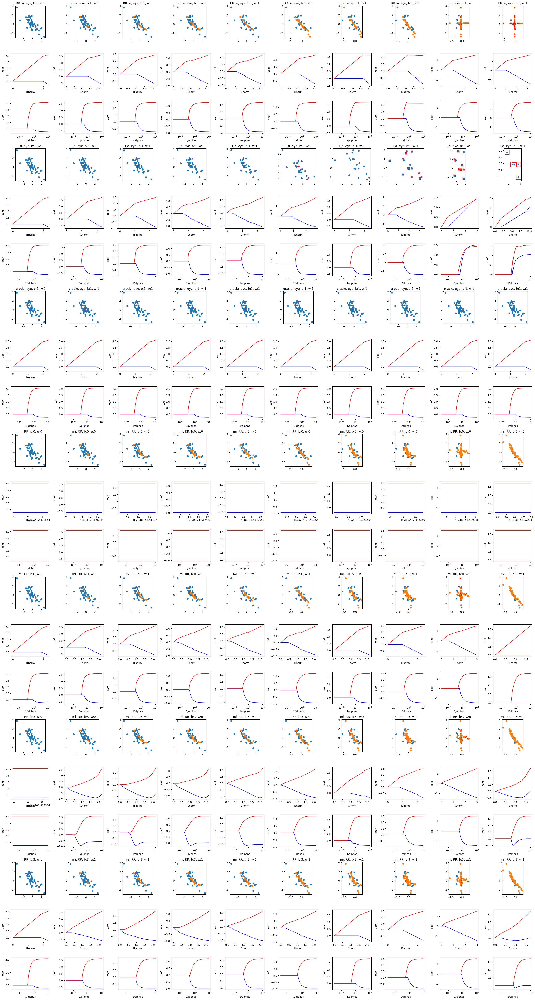

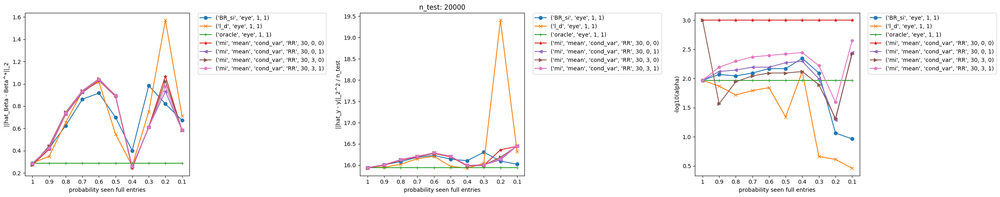

In [ ]:
np.random.seed(9876)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [50] * length_vec
error_vec =  [4] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.7], [-0.7, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR

100%|██████████| 200/200 [00:01<00:00, 108.59it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 108.05it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 108.47it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  551.973779940866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [3.33066907e-16 4.44089210e-16]
fin

100%|██████████| 200/200 [00:02<00:00, 73.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.2080065776007505
---------------------------------> best coeff  [-0.6082245   1.92159445]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  551.973779940866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [3.33066907e-16 4.44089210e-16]
final S in cov strategy RR  [[0.91523987 0.        ]
 [0.         1.06519777]]
S within 
 [[0.91523987 0.   

100%|██████████| 200/200 [00:03<00:00, 62.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.2164988146536
---------------------------------> best coeff  [-0.5213133   1.82444391]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  551.973779940866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [3.33066907e-16 4.44089210e-16]
final S in cov strategy RR  [[0.91523987 0.        ]
 [0.         1.06519777]]
S within 
 [[0.9152

100%|██████████| 200/200 [00:03<00:00, 53.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.2080065776007505
---------------------------------> best coeff  [-0.6082245   1.92159445]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  551.973779940866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [3.33066907e-16 4.44089210e-16]
final S in cov strategy RR  [[0.91523987 0.        ]
 [0.         1.06519777]]
S within 
 [[0.91523987 0.   

100%|██████████| 200/200 [00:03<00:00, 60.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.2164988146536
---------------------------------> best coeff  [-0.5213133   1.82444391]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  16.646844126957234
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 107.31it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.225335693965332
---------------------------------> best coeff  [-0.67549233  1.87996309]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  13.929207420445234
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputat

100%|██████████| 200/200 [00:01<00:00, 115.75it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.208324805761292
---------------------------------> best coeff  [-0.44126269  1.89169766]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 183.45it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  490.69583672325064
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9293394  1.06289933]
cov computed
s_between  [0.01240832 0.01780513]
final S i

100%|██████████| 200/200 [00:01<00:00, 126.59it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.226125829796027
---------------------------------> best coeff  [-0.67567748  1.92056702]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  490.69583672325064
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9293394  1.06289933]
cov computed
s_between  [0.01240832 0.01780513]
final S in cov strategy RR  [[0.94216133 0.        ]
 [0.         1.08129796]]
S within 
 [[0.94216133 0.        ]


100%|██████████| 200/200 [00:02<00:00, 99.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  6.222981477929786
---------------------------------> best coeff  [-0.66724283  1.91116779]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  490.69583672325064
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9293394  1.06289933]
cov computed
s_between  [0.01240832 0.01780513]
final S in cov strategy RR  [[0.94216133 0.        ]
 [0.         1.08129796]]
S within 
 [[0.94216133

100%|██████████| 200/200 [00:02<00:00, 76.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  97  best 1/best_alpha  3.654383070957255 , min score  6.229208567586146
---------------------------------> best coeff  [-0.62517347  1.78351667]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  490.69583672325064
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9293394  1.06289933]
cov computed
s_between  [0.01240832 0.01780513]
final S in cov strategy RR  [[0.94216133 0.        ]
 [0.         1.08129796]]
S within 
 [[0.94216133 

100%|██████████| 200/200 [00:02<00:00, 98.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  6.223642716641647
---------------------------------> best coeff  [-0.66914126  1.91314915]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  15.357427622468268
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 177.41it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.227634337778989
---------------------------------> best coeff  [-0.6831863   1.89200072]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  9.44256122984451
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  80

100%|██████████| 200/200 [00:00<00:00, 207.57it/s]


------------------------> who is S in add_rectangles
 [[0.03612343 0.        ]
 [0.         0.03612343]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.214773672908854
---------------------------------> best coeff  [-0.42934981  2.15654272]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 178.30it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  450.18438080428473
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93054088 0.99675667]
cov computed
s_between  [0.02222149 0.02285864]
final S i

100%|██████████| 200/200 [00:01<00:00, 133.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.345395915344154
---------------------------------> best coeff  [-0.87714729  1.95729771]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  450.18438080428473
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93054088 0.99675667]
cov computed
s_between  [0.02222149 0.02285864]
final S in cov strategy RR  [[0.95350308 0.        ]
 [0.         1.02037726]]
S within 
 [[0.95350308 0.        ]


100%|██████████| 200/200 [00:01<00:00, 102.62it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.249319320584426
---------------------------------> best coeff  [-0.73964192  1.8214477 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  450.18438080428473
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93054088 0.99675667]
cov computed
s_between  [0.02222149 0.02285864]
final S in cov strategy RR  [[0.95350308 0.        ]
 [0.         1.02037726]]
S within 
 [[0.95350308

100%|██████████| 200/200 [00:01<00:00, 126.52it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.334936792598758
---------------------------------> best coeff  [-0.88135395  1.90984614]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  450.18438080428473
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93054088 0.99675667]
cov computed
s_between  [0.02222149 0.02285864]
final S in cov strategy RR  [[0.95350308 0.        ]
 [0.         1.02037726]]
S within 
 [[0.95350308 

100%|██████████| 200/200 [00:01<00:00, 100.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.273501401680326
---------------------------------> best coeff  [-0.79671909  1.81781705]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  17.103346162636903
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 122.75it/s]


------------------------> who is S in add_rectangles
 [[0.06826072 0.        ]
 [0.         0.06826072]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.2197516450595804
---------------------------------> best coeff  [-0.65580075  1.91807121]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  10.781582946012112
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000 

100%|██████████| 200/200 [00:01<00:00, 150.14it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.217228122438803
---------------------------------> best coeff  [-0.43271418  2.16408438]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 179.62it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  514.7760204201381
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92171418 1.03725537]
cov computed
s_between  [0.02754312 0.03239396]
final S in

100%|██████████| 200/200 [00:02<00:00, 92.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.323017646853076
---------------------------------> best coeff  [-0.81428548  2.02428988]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  514.7760204201381
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92171418 1.03725537]
cov computed
s_between  [0.02754312 0.03239396]
final S in cov strategy RR  [[0.95017541 0.        ]
 [0.         1.07072913]]
S within 
 [[0.95017541 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 87.55it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.2296071937058874
---------------------------------> best coeff  [-0.68908379  1.89406538]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  514.7760204201381
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92171418 1.03725537]
cov computed
s_between  [0.02754312 0.03239396]
final S in cov strategy RR  [[0.95017541 0.        ]
 [0.         1.07072913]]
S within 
 [[0.95017541

100%|██████████| 200/200 [00:01<00:00, 124.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.29309293224219
---------------------------------> best coeff  [-0.81424148  1.92625704]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  514.7760204201381
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92171418 1.03725537]
cov computed
s_between  [0.02754312 0.03239396]
final S in cov strategy RR  [[0.95017541 0.        ]
 [0.         1.07072913]]
S within 
 [[0.95017541 0

100%|██████████| 200/200 [00:01<00:00, 101.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.244673145426582
---------------------------------> best coeff  [-0.73083527  1.87786901]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  13.74624338589147
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 178.96it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.204107639176113
---------------------------------> best coeff  [-0.52687268  2.05571156]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  7.901728441273243
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 252.19it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.2361268368971094
---------------------------------> best coeff  [-0.33995174  2.23340659]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 177.65it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  378.8078286159248
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9332815  1.06551679]
cov computed
s_between  [0.02710245 0.03387739]
final S in

100%|██████████| 200/200 [00:01<00:00, 125.21it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.241856968838692
---------------------------------> best coeff  [-0.6340962   2.08061559]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  378.8078286159248
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9332815  1.06551679]
cov computed
s_between  [0.02710245 0.03387739]
final S in cov strategy RR  [[0.96128736 0.        ]
 [0.         1.10052343]]
S within 
 [[0.96128736 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 85.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.207018964206196
---------------------------------> best coeff  [-0.57615656  2.0115095 ]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  378.8078286159248
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9332815  1.06551679]
cov computed
s_between  [0.02710245 0.03387739]
final S in cov strategy RR  [[0.96128736 0.        ]
 [0.         1.10052343]]
S within 
 [[0.96128736 

100%|██████████| 200/200 [00:02<00:00, 85.22it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  6.224967867770104
---------------------------------> best coeff  [-0.63279967  2.02054477]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  378.8078286159248
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9332815  1.06551679]
cov computed
s_between  [0.02710245 0.03387739]
final S in cov strategy RR  [[0.96128736 0.        ]
 [0.         1.10052343]]
S within 
 [[0.96128736 0

100%|██████████| 200/200 [00:01<00:00, 100.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.212097590403147
---------------------------------> best coeff  [-0.60049495  2.00475867]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  17.539630184858062
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 176.89it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.20499289944929
---------------------------------> best coeff  [-0.37995232  1.9704532 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  7.771913374697581
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 2

100%|██████████| 200/200 [00:00<00:00, 278.29it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.315531987061238
---------------------------------> best coeff  [-0.07643386  2.26546262]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 179.79it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  544.8717079193823
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94730424 1.06965972]
cov computed
s_between  [0.03075052 0.038177  ]
final S in

100%|██████████| 200/200 [00:01<00:00, 135.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.280252475731881
---------------------------------> best coeff  [-0.76117308  2.00136733]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  544.8717079193823
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94730424 1.06965972]
cov computed
s_between  [0.03075052 0.038177  ]
final S in cov strategy RR  [[0.97907978 0.        ]
 [0.         1.10910929]]
S within 
 [[0.97907978 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 99.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.228180325125738
---------------------------------> best coeff  [-0.6838487   1.90597005]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  544.8717079193823
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94730424 1.06965972]
cov computed
s_between  [0.03075052 0.038177  ]
final S in cov strategy RR  [[0.97907978 0.        ]
 [0.         1.10910929]]
S within 
 [[0.97907978 0

100%|██████████| 200/200 [00:01<00:00, 119.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  6.27589161915357
---------------------------------> best coeff  [-0.76410862  1.97999376]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  544.8717079193823
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94730424 1.06965972]
cov computed
s_between  [0.03075052 0.038177  ]
final S in cov strategy RR  [[0.97907978 0.        ]
 [0.         1.10910929]]
S within 
 [[0.97907978 0.

100%|██████████| 200/200 [00:02<00:00, 99.56it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  6.248886748706644
---------------------------------> best coeff  [-0.73629765  1.90843348]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.505215705314164
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 111.57it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  6.298353517890689
---------------------------------> best coeff  [-0.13693705  2.01853801]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  7.870671277943684
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 206.25it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.318753031590748
---------------------------------> best coeff  [-0.06671691  2.24855385]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 173.78it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  615.7234644976005
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93870982 1.11549471]
cov computed
s_between  [0.04595637 0.04292292]
final S in

100%|██████████| 200/200 [00:02<00:00, 83.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.208515578925412
---------------------------------> best coeff  [-0.61068902  1.92066039]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  615.7234644976005
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93870982 1.11549471]
cov computed
s_between  [0.04595637 0.04292292]
final S in cov strategy RR  [[0.98619807 0.        ]
 [0.         1.1598484 ]]
S within 
 [[0.98619807 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 93.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.216530093572378
---------------------------------> best coeff  [-0.52289241  1.82395804]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  615.7234644976005
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93870982 1.11549471]
cov computed
s_between  [0.04595637 0.04292292]
final S in cov strategy RR  [[0.98619807 0.        ]
 [0.         1.1598484 ]]
S within 
 [[0.98619807 0

100%|██████████| 200/200 [00:01<00:00, 117.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  6.219394430038945
---------------------------------> best coeff  [-0.60897798  1.81817384]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  615.7234644976005
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93870982 1.11549471]
cov computed
s_between  [0.04595637 0.04292292]
final S in cov strategy RR  [[0.98619807 0.        ]
 [0.         1.1598484 ]]
S within 
 [[0.98619807 

100%|██████████| 200/200 [00:02<00:00, 99.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.217943997189395
---------------------------------> best coeff  [-0.56930774  1.81447996]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.34432174274791
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 177.02it/s]


------------------------> who is S in add_rectangles
 [[0.03217642 0.        ]
 [0.         0.03217642]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.59326704098693
---------------------------------> best coeff  [3.16080913e-09 1.74730773e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  4.3771335740699255
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (

100%|██████████| 200/200 [00:00<00:00, 336.65it/s]


------------------------> who is S in add_rectangles
 [[0.01516717 0.        ]
 [0.         0.01516717]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  6.345769777500758
---------------------------------> best coeff  [-0.03321023  2.3077765 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 173.63it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  586.6990973610286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95195811 1.15518136]
cov computed
s_between  [0.0345024  0.06171131]
final S in

100%|██████████| 200/200 [00:01<00:00, 137.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.232595532090992
---------------------------------> best coeff  [-0.41748037  1.82943628]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  586.6990973610286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95195811 1.15518136]
cov computed
s_between  [0.0345024  0.06171131]
final S in cov strategy RR  [[0.98761059 0.        ]
 [0.         1.21894971]]
S within 
 [[0.98761059 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 100.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  6.244317766258131
---------------------------------> best coeff  [-0.40597838  1.80891093]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  586.6990973610286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95195811 1.15518136]
cov computed
s_between  [0.0345024  0.06171131]
final S in cov strategy RR  [[0.98761059 0.        ]
 [0.         1.21894971]]
S within 
 [[0.98761059 0

100%|██████████| 200/200 [00:02<00:00, 96.69it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  6.24376439105966
---------------------------------> best coeff  [-0.42546561  1.79660524]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  586.6990973610286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95195811 1.15518136]
cov computed
s_between  [0.0345024  0.06171131]
final S in cov strategy RR  [[0.98761059 0.        ]
 [0.         1.21894971]]
S within 
 [[0.98761059 0

100%|██████████| 200/200 [00:02<00:00, 77.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.2454486487112755
---------------------------------> best coeff  [-0.41598263  1.79919732]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  23.06962338651104
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 178.70it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.5953026560685295
---------------------------------> best coeff  [8.99692968e-11 1.74519179e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  4.097854791092679
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 364.57it/s]


------------------------> who is S in add_rectangles
 [[0.00901102 0.        ]
 [0.         0.00901102]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  6.329789134011895
---------------------------------> best coeff  [-0.04529231  2.22066933]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 175.16it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  607.2110205732547
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96954617 1.07960758]
cov computed
s_between  [0.03948123 0.0443626 ]
final S in

100%|██████████| 200/200 [00:01<00:00, 125.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.500008256450942
---------------------------------> best coeff  [-1.08137496  1.85118337]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  607.2110205732547
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96954617 1.07960758]
cov computed
s_between  [0.03948123 0.0443626 ]
final S in cov strategy RR  [[1.01034344 0.        ]
 [0.         1.12544894]]
S within 
 [[1.01034344 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 102.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  6.330053134131347
---------------------------------> best coeff  [-0.75152569  1.57315595]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  607.2110205732547
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96954617 1.07960758]
cov computed
s_between  [0.03948123 0.0443626 ]
final S in cov strategy RR  [[1.01034344 0.        ]
 [0.         1.12544894]]
S within 
 [[1.01034344 0

100%|██████████| 200/200 [00:01<00:00, 121.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.3906454078146
---------------------------------> best coeff  [-0.97496994  1.65851636]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  607.2110205732547
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96954617 1.07960758]
cov computed
s_between  [0.03948123 0.0443626 ]
final S in cov strategy RR  [[1.01034344 0.        ]
 [0.         1.12544894]]
S within 
 [[1.01034344 0. 

100%|██████████| 200/200 [00:01<00:00, 101.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.359653241576272
---------------------------------> best coeff  [-0.91588052  1.63641284]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  31.01344527283049
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 151.64it/s]


------------------------> who is S in add_rectangles
 [[0.14481182 0.        ]
 [0.         0.14481182]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  86  best 1/best_alpha  6.905513520162324 , min score  6.470791245624435
---------------------------------> best coeff  [-0.92196909  1.41138948]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2.9989066420756365
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 289.46it/s]


------------------------> who is S in add_rectangles
 [[0.41026581 0.        ]
 [0.         0.41026581]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  104  best 1/best_alpha  2.4374441501222193 , min score  6.378821674482024
---------------------------------> best coeff  [-3.88531270e-10  2.09545927e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]

100%|██████████| 200/200 [00:01<00:00, 121.89it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  938.7850926313234
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98976593 1.06514294]
cov computed
s_between  [0.04353253 0.05274369]
final S in

100%|██████████| 200/200 [00:01<00:00, 121.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  7.073831855350099
---------------------------------> best coeff  [-1.47325617  1.84655472]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  938.7850926313234
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98976593 1.06514294]
cov computed
s_between  [0.04353253 0.05274369]
final S in cov strategy RR  [[1.03474954 0.        ]
 [0.         1.11964475]]
S within 
 [[1.03474954 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 69.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  6.51014295393402
---------------------------------> best coeff  [-1.07250617  1.47631468]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  938.7850926313234
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98976593 1.06514294]
cov computed
s_between  [0.04353253 0.05274369]
final S in cov strategy RR  [[1.03474954 0.        ]
 [0.         1.11964475]]
S within 
 [[1.03474954 0.

100%|██████████| 200/200 [00:01<00:00, 116.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  6.6295133217996405
---------------------------------> best coeff  [-1.20779411  1.45057986]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  938.7850926313234
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98976593 1.06514294]
cov computed
s_between  [0.04353253 0.05274369]
final S in cov strategy RR  [[1.03474954 0.        ]
 [0.         1.11964475]]
S within 
 [[1.03474954

100%|██████████| 200/200 [00:01<00:00, 101.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.57721105370731
---------------------------------> best coeff  [-1.14930466  1.45357351]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.4871005 ,  1.83812785]), array([-0.67549233,  1.87996309]), array([-0.6831863 ,  1.89200072]), array([-0.65580075,  1.91807121]), array([-0.52687268,  2.05571156]), array([-0.37995232,  1.9704532 ]), array([-0.13693705,  2.01853801]), array([3.16080913e-09, 1.74730773e+00]), array([8.99692968e-11, 1.74519179e+00]), array([-0.92196909,  1.41138948])], 'l2_dist_best_coeff_gt': [np.float64(0.16238531192561528), np.float64(0.21261801145567968), np.float64(0.2126524498453231), np.float64(0.17602897458715472), np.float64(0.06185401578456379), np.float64(0.1236303297261545), np.float64(0.36

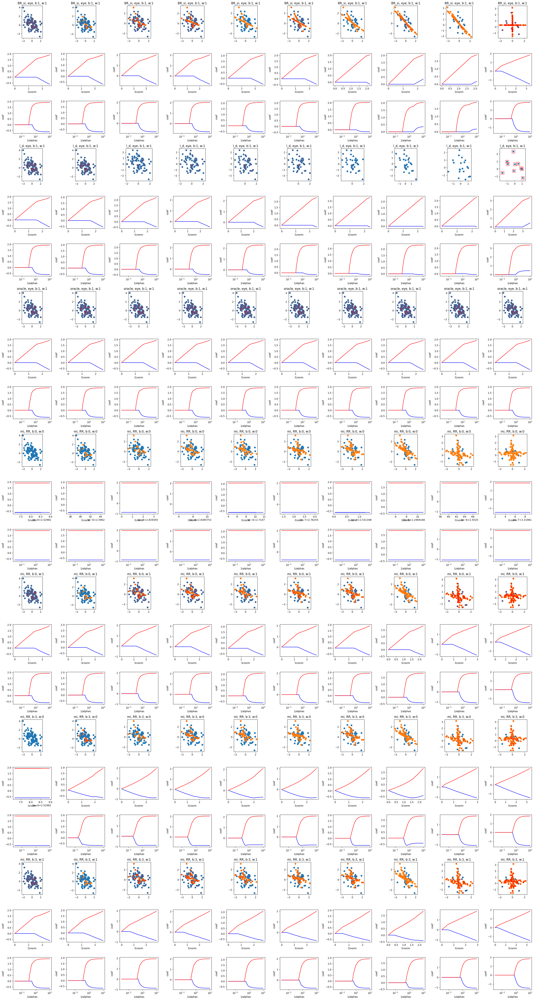

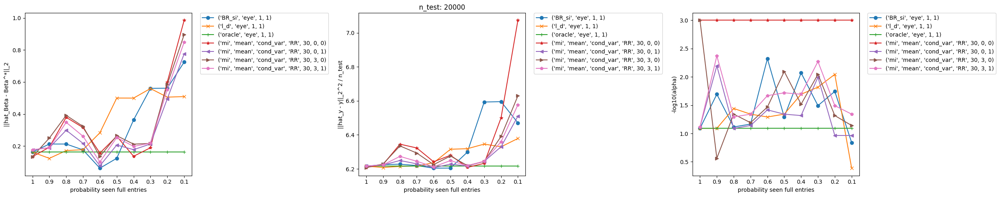

In [ ]:
np.random.seed(9876)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': '

100%|██████████| 200/200 [00:01<00:00, 108.10it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:03<00:00, 66.49it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:02<00:00, 92.35it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2207.8951197634638
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [8.88178420e-16 1.77635684e-15]


100%|██████████| 200/200 [00:02<00:00, 92.36it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.2080065776007505
---------------------------------> best coeff  [-0.6082245   1.92159445]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2207.8951197634638
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [8.88178420e-16 1.77635684e-15]
final S in cov strategy RR  [[0.91523987 0.        ]
 [0.         1.06519777]]
S within 
 [[0.91523987 0

100%|██████████| 200/200 [00:01<00:00, 102.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.2164988146536
---------------------------------> best coeff  [-0.5213133   1.82444391]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2207.8951197634638
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [8.88178420e-16 1.77635684e-15]
final S in cov strategy RR  [[0.91523987 0.        ]
 [0.         1.06519777]]
S within 
 [[0.

100%|██████████| 200/200 [00:02<00:00, 83.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.2080065776007505
---------------------------------> best coeff  [-0.6082245   1.92159445]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2207.8951197634638
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.91523987 1.06519777]
cov computed
s_between  [8.88178420e-16 1.77635684e-15]
final S in cov strategy RR  [[0.91523987 0.        ]
 [0.         1.06519777]]
S within 
 [[0.91523987 0

100%|██████████| 200/200 [00:03<00:00, 53.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.2164988146536
---------------------------------> best coeff  [-0.5213133   1.82444391]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  16.646844126957234
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 175.44it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.225335693965332
---------------------------------> best coeff  [-0.67549233  1.87996309]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  13.929207420445234
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputat

100%|██████████| 200/200 [00:01<00:00, 198.87it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.208324805761292
---------------------------------> best coeff  [-0.44126269  1.89169766]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 180.17it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2055.9173856086973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92880178 1.0563107 ]
cov computed
s_between  [0.016938   0.01518702]
final S 

100%|██████████| 200/200 [00:02<00:00, 77.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.248169079924615
---------------------------------> best coeff  [-0.73781171  1.8907706 ]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2055.9173856086973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92880178 1.0563107 ]
cov computed
s_between  [0.016938   0.01518702]
final S in cov strategy RR  [[0.94588093 0.        ]
 [0.         1.07162428]]
S within 
 [[0.94588093 0.        

100%|██████████| 200/200 [00:04<00:00, 49.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.235172478326618
---------------------------------> best coeff  [-0.70509519  1.8607549 ]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2055.9173856086973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92880178 1.0563107 ]
cov computed
s_between  [0.016938   0.01518702]
final S in cov strategy RR  [[0.94588093 0.        ]
 [0.         1.07162428]]
S within 
 [[0.94588093

100%|██████████| 200/200 [00:02<00:00, 72.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  6.2436210445914755
---------------------------------> best coeff  [-0.72799792  1.88082416]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2055.9173856086973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92880178 1.0563107 ]
cov computed
s_between  [0.016938   0.01518702]
final S in cov strategy RR  [[0.94588093 0.        ]
 [0.         1.07162428]]
S within 
 [[0.94588

100%|██████████| 200/200 [00:03<00:00, 53.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  6.235910885959525
---------------------------------> best coeff  [-0.70743965  1.8627812 ]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  15.357427622468268
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 102.80it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  6.227634337778989
---------------------------------> best coeff  [-0.6831863   1.89200072]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  9.44256122984451
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  80

100%|██████████| 200/200 [00:02<00:00, 72.93it/s]


------------------------> who is S in add_rectangles
 [[0.03612343 0.        ]
 [0.         0.03612343]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  6.214773672908854
---------------------------------> best coeff  [-0.42934981  2.15654272]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 105.66it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1847.9692557655403
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92873112 1.00960678]
cov computed
s_between  [0.02111185 0.02592407]
final S 

100%|██████████| 200/200 [00:01<00:00, 129.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.346333334312281
---------------------------------> best coeff  [-0.86488587  1.98682008]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1847.9692557655403
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92873112 1.00960678]
cov computed
s_between  [0.02111185 0.02592407]
final S in cov strategy RR  [[0.95001891 0.        ]
 [0.         1.03574688]]
S within 
 [[0.95001891 0.        

100%|██████████| 200/200 [00:01<00:00, 100.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.2444627578369225
---------------------------------> best coeff  [-0.73049573  1.85167263]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1847.9692557655403
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92873112 1.00960678]
cov computed
s_between  [0.02111185 0.02592407]
final S in cov strategy RR  [[0.95001891 0.        ]
 [0.         1.03574688]]
S within 
 [[0.95001

100%|██████████| 200/200 [00:01<00:00, 123.00it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.333596141224317
---------------------------------> best coeff  [-0.87256084  1.92982309]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1847.9692557655403
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92873112 1.00960678]
cov computed
s_between  [0.02111185 0.02592407]
final S in cov strategy RR  [[0.95001891 0.        ]
 [0.         1.03574688]]
S within 
 [[0.950018

100%|██████████| 200/200 [00:01<00:00, 100.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.267000404512251
---------------------------------> best coeff  [-0.7834121   1.83823678]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  17.103346162636903
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 178.11it/s]


------------------------> who is S in add_rectangles
 [[0.06826072 0.        ]
 [0.         0.06826072]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  6.2197516450595804
---------------------------------> best coeff  [-0.65580075  1.91807121]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  10.781582946012112
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000 

100%|██████████| 200/200 [00:01<00:00, 180.18it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.217228122438803
---------------------------------> best coeff  [-0.43271418  2.16408438]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 113.17it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2063.9453181476183
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92123486 1.03094071]
cov computed
s_between  [0.02362399 0.03035295]
final S 

100%|██████████| 200/200 [00:02<00:00, 97.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.32211064749827
---------------------------------> best coeff  [-0.82325957  2.00534428]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2063.9453181476183
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92123486 1.03094071]
cov computed
s_between  [0.02362399 0.03035295]
final S in cov strategy RR  [[0.94505571 0.        ]
 [0.         1.06154661]]
S within 
 [[0.94505571 0.        ]

100%|██████████| 200/200 [00:02<00:00, 80.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  85  best 1/best_alpha  7.316807143427192 , min score  6.232942247590704
---------------------------------> best coeff  [-0.57052179  1.76539116]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2063.9453181476183
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92123486 1.03094071]
cov computed
s_between  [0.02362399 0.03035295]
final S in cov strategy RR  [[0.94505571 0.        ]
 [0.         1.06154661]]
S within 
 [[0.9450557

100%|██████████| 200/200 [00:01<00:00, 122.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  6.292155910856973
---------------------------------> best coeff  [-0.81646903  1.91457362]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2063.9453181476183
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92123486 1.03094071]
cov computed
s_between  [0.02362399 0.03035295]
final S in cov strategy RR  [[0.94505571 0.        ]
 [0.         1.06154661]]
S within 
 [[0.945055

100%|██████████| 200/200 [00:01<00:00, 100.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  6.250139509793131
---------------------------------> best coeff  [-0.74406956  1.87651697]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  13.74624338589147
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 181.62it/s]


------------------------> who is S in add_rectangles
 [[0.00476861 0.        ]
 [0.         0.00476861]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.204107639176113
---------------------------------> best coeff  [-0.52687268  2.05571156]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  7.901728441273243
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 251.12it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.2361268368971094
---------------------------------> best coeff  [-0.33995174  2.23340659]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 176.29it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1587.0836654056334
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92638552 1.06788269]
cov computed
s_between  [0.02545982 0.0377456 ]
final S 

100%|██████████| 200/200 [00:01<00:00, 134.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.272725209412881
---------------------------------> best coeff  [-0.73493099  2.02536563]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1587.0836654056334
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92638552 1.06788269]
cov computed
s_between  [0.02545982 0.0377456 ]
final S in cov strategy RR  [[0.9520575  0.        ]
 [0.         1.10594284]]
S within 
 [[0.9520575  0.        

100%|██████████| 200/200 [00:01<00:00, 102.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  6.219752823071426
---------------------------------> best coeff  [-0.653416    1.93320581]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1587.0836654056334
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92638552 1.06788269]
cov computed
s_between  [0.02545982 0.0377456 ]
final S in cov strategy RR  [[0.9520575  0.        ]
 [0.         1.10594284]]
S within 
 [[0.9520575

100%|██████████| 200/200 [00:02<00:00, 84.59it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.262603480391727
---------------------------------> best coeff  [-0.73849415  1.98300171]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1587.0836654056334
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.92638552 1.06788269]
cov computed
s_between  [0.02545982 0.0377456 ]
final S in cov strategy RR  [[0.9520575  0.        ]
 [0.         1.10594284]]
S within 
 [[0.9520575

100%|██████████| 200/200 [00:02<00:00, 89.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  6.2351208504094515
---------------------------------> best coeff  [-0.69890723  1.92785929]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  17.539630184858062
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S with

100%|██████████| 200/200 [00:01<00:00, 179.16it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.20499289944929
---------------------------------> best coeff  [-0.37995232  1.9704532 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  7.771913374697581
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 2

100%|██████████| 200/200 [00:00<00:00, 274.66it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  6.315531987061238
---------------------------------> best coeff  [-0.07643386  2.26546262]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 180.71it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2212.2723998415595
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9390701  1.06968749]
cov computed
s_between  [0.02887431 0.04892401]
final S 

100%|██████████| 200/200 [00:01<00:00, 127.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.301029459794982
---------------------------------> best coeff  [-0.80872269  1.97197292]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2212.2723998415595
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9390701  1.06968749]
cov computed
s_between  [0.02887431 0.04892401]
final S in cov strategy RR  [[0.96818503 0.        ]
 [0.         1.1190192 ]]
S within 
 [[0.96818503 0.        

100%|██████████| 200/200 [00:02<00:00, 99.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.240178873023726
---------------------------------> best coeff  [-0.71959412  1.86862709]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2212.2723998415595
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9390701  1.06968749]
cov computed
s_between  [0.02887431 0.04892401]
final S in cov strategy RR  [[0.96818503 0.        ]
 [0.         1.1190192 ]]
S within 
 [[0.968185

100%|██████████| 200/200 [00:01<00:00, 120.16it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  12  best 1/best_alpha  499.450511585514 , min score  6.300013049752915
---------------------------------> best coeff  [-0.80951029  1.96666238]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2212.2723998415595
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.9390701  1.06968749]
cov computed
s_between  [0.02887431 0.04892401]
final S in cov strategy RR  [[0.96818503 0.        ]
 [0.         1.1190192 ]]
S within 
 [[0.96818503

100%|██████████| 200/200 [00:01<00:00, 100.44it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.270415113572596
---------------------------------> best coeff  [-0.78542405  1.88557905]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.505215705314164
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 116.03it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  6.298353517890689
---------------------------------> best coeff  [-0.13693705  2.01853801]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  7.870671277943684
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 206.24it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.318753031590748
---------------------------------> best coeff  [-0.06671691  2.24855385]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 174.54it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1965.353020562317
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93921136 1.10679094]
cov computed
s_between  [0.02933109 0.04610891]
final S i

100%|██████████| 200/200 [00:01<00:00, 116.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.225956063932426
---------------------------------> best coeff  [-0.65970565  1.97307257]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1965.353020562317
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93921136 1.10679094]
cov computed
s_between  [0.02933109 0.04610891]
final S in cov strategy RR  [[0.96878687 0.        ]
 [0.         1.15328409]]
S within 
 [[0.96878687 0.        ]

100%|██████████| 200/200 [00:02<00:00, 98.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.2167834420376265
---------------------------------> best coeff  [-0.63915878  1.95123426]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1965.353020562317
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93921136 1.10679094]
cov computed
s_between  [0.02933109 0.04610891]
final S in cov strategy RR  [[0.96878687 0.        ]
 [0.         1.15328409]]
S within 
 [[0.9687868

100%|██████████| 200/200 [00:01<00:00, 118.92it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.22952418838759
---------------------------------> best coeff  [-0.6516431   1.79682884]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1965.353020562317
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93921136 1.10679094]
cov computed
s_between  [0.02933109 0.04610891]
final S in cov strategy RR  [[0.96878687 0.        ]
 [0.         1.15328409]]
S within 
 [[0.96878687

100%|██████████| 200/200 [00:01<00:00, 100.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  16  best 1/best_alpha  396.26886387014787 , min score  6.2223902370237765
---------------------------------> best coeff  [-0.65421274  1.96026827]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.34432174274791
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 178.65it/s]


------------------------> who is S in add_rectangles
 [[0.03217642 0.        ]
 [0.         0.03217642]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  6.59326704098693
---------------------------------> best coeff  [3.16080913e-09 1.74730773e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  4.3771335740699255
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (

100%|██████████| 200/200 [00:00<00:00, 337.03it/s]


------------------------> who is S in add_rectangles
 [[0.01516717 0.        ]
 [0.         0.01516717]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  6.345769777500758
---------------------------------> best coeff  [-0.03321023  2.3077765 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 139.91it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1919.130953934528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93671308 1.15013845]
cov computed
s_between  [0.03558483 0.06063209]
final S i

100%|██████████| 200/200 [00:01<00:00, 133.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.228361906616715
---------------------------------> best coeff  [-0.32684352  1.92936921]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1919.130953934528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93671308 1.15013845]
cov computed
s_between  [0.03558483 0.06063209]
final S in cov strategy RR  [[0.97259445 0.        ]
 [0.         1.21127581]]
S within 
 [[0.97259445 0.        ]

100%|██████████| 200/200 [00:02<00:00, 81.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.2395593515653704
---------------------------------> best coeff  [-0.31436623  1.90780905]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1919.130953934528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93671308 1.15013845]
cov computed
s_between  [0.03558483 0.06063209]
final S in cov strategy RR  [[0.97259445 0.        ]
 [0.         1.21127581]]
S within 
 [[0.9725944

100%|██████████| 200/200 [00:02<00:00, 93.68it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  6.239108941188627
---------------------------------> best coeff  [-0.340691    1.87931204]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  1919.130953934528
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93671308 1.15013845]
cov computed
s_between  [0.03558483 0.06063209]
final S in cov strategy RR  [[0.97259445 0.        ]
 [0.         1.21127581]]
S within 
 [[0.97259445 

100%|██████████| 200/200 [00:01<00:00, 101.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  6.239992067742952
---------------------------------> best coeff  [-0.32554672  1.89335765]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  23.06962338651104
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 170.61it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  6.5953026560685295
---------------------------------> best coeff  [8.99692968e-11 1.74519179e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  4.097854791092679
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 387.10it/s]


------------------------> who is S in add_rectangles
 [[0.00901102 0.        ]
 [0.         0.00901102]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  6.329789134011895
---------------------------------> best coeff  [-0.04529231  2.22066933]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 176.76it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2703.02518293927
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96659874 1.07651788]
cov computed
s_between  [0.04444853 0.05031329]
final S in

100%|██████████| 200/200 [00:01<00:00, 130.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.563611901170107
---------------------------------> best coeff  [-1.13193258  1.86754135]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2703.02518293927
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96659874 1.07651788]
cov computed
s_between  [0.04444853 0.05031329]
final S in cov strategy RR  [[1.01141768 0.        ]
 [0.         1.12725045]]
S within 
 [[1.01141768 0.        ]


100%|██████████| 200/200 [00:01<00:00, 101.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  6.3444614816529326
---------------------------------> best coeff  [-0.76092198  1.55018062]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2703.02518293927
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96659874 1.07651788]
cov computed
s_between  [0.04444853 0.05031329]
final S in cov strategy RR  [[1.01141768 0.        ]
 [0.         1.12725045]]
S within 
 [[1.01141768

100%|██████████| 200/200 [00:01<00:00, 116.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  6.423853135911536
---------------------------------> best coeff  [-0.92946833  1.49174601]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2703.02518293927
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.96659874 1.07651788]
cov computed
s_between  [0.04444853 0.05031329]
final S in cov strategy RR  [[1.01141768 0.        ]
 [0.         1.12725045]]
S within 
 [[1.01141768

100%|██████████| 200/200 [00:02<00:00, 71.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  6.387649697056387
---------------------------------> best coeff  [-0.84469582  1.50516917]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  31.01344527283049
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 157.40it/s]


------------------------> who is S in add_rectangles
 [[0.14481182 0.        ]
 [0.         0.14481182]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  86  best 1/best_alpha  6.905513520162324 , min score  6.470791245624435
---------------------------------> best coeff  [-0.92196909  1.41138948]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  2.9989066420756365
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 429.07it/s]


------------------------> who is S in add_rectangles
 [[0.41026581 0.        ]
 [0.         0.41026581]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  104  best 1/best_alpha  2.4374441501222193 , min score  6.378821674482024
---------------------------------> best coeff  [-3.88531270e-10  2.09545927e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  18.399125998028865
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]

100%|██████████| 200/200 [00:01<00:00, 175.86it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  6.215850336627816
---------------------------------> best coeff  [-0.4871005   1.83812785]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  3960.946501158036
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00120097 1.06716784]
cov computed
s_between  [0.04768194 0.05261127]
final S i

100%|██████████| 200/200 [00:01<00:00, 126.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.887136536158462
---------------------------------> best coeff  [-1.38548676  1.79178749]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  3960.946501158036
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00120097 1.06716784]
cov computed
s_between  [0.04768194 0.05261127]
final S in cov strategy RR  [[1.04928027 0.        ]
 [0.         1.12021754]]
S within 
 [[1.04928027 0.        ]

100%|██████████| 200/200 [00:01<00:00, 101.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  6.473448252558799
---------------------------------> best coeff  [-1.03902348  1.51144218]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  3960.946501158036
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00120097 1.06716784]
cov computed
s_between  [0.04768194 0.05261127]
final S in cov strategy RR  [[1.04928027 0.        ]
 [0.         1.12021754]]
S within 
 [[1.0492802

100%|██████████| 200/200 [00:01<00:00, 117.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  6.594539882045835
---------------------------------> best coeff  [-1.18131762  1.48364557]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.91523987 1.06519777]
crush test------------------------------------------------->  3960.946501158036
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00120097 1.06716784]
cov computed
s_between  [0.04768194 0.05261127]
final S in cov strategy RR  [[1.04928027 0.        ]
 [0.         1.12021754]]
S within 
 [[1.0492802

100%|██████████| 200/200 [00:01<00:00, 102.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  6.535889184202716
---------------------------------> best coeff  [-1.0389274   1.38850271]
mi
mean
cond_var
RR
120
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.4871005 ,  1.83812785]), array([-0.67549233,  1.87996309]), array([-0.6831863 ,  1.89200072]), array([-0.65580075,  1.91807121]), array([-0.52687268,  2.05571156]), array([-0.37995232,  1.9704532 ]), array([-0.13693705,  2.01853801]), array([3.16080913e-09, 1.74730773e+00]), array([8.99692968e-11, 1.74519179e+00]), array([-0.92196909,  1.41138948])], 'l2_dist_best_coeff_gt': [np.float64(0.16238531192561528), np.float64(0.21261801145567968), np.float64(0.2126524498453231), np.float64(0.17602897458715472), np.float64(0.06185401578456379), np.float64(0.1236303297261545), np.float64(0

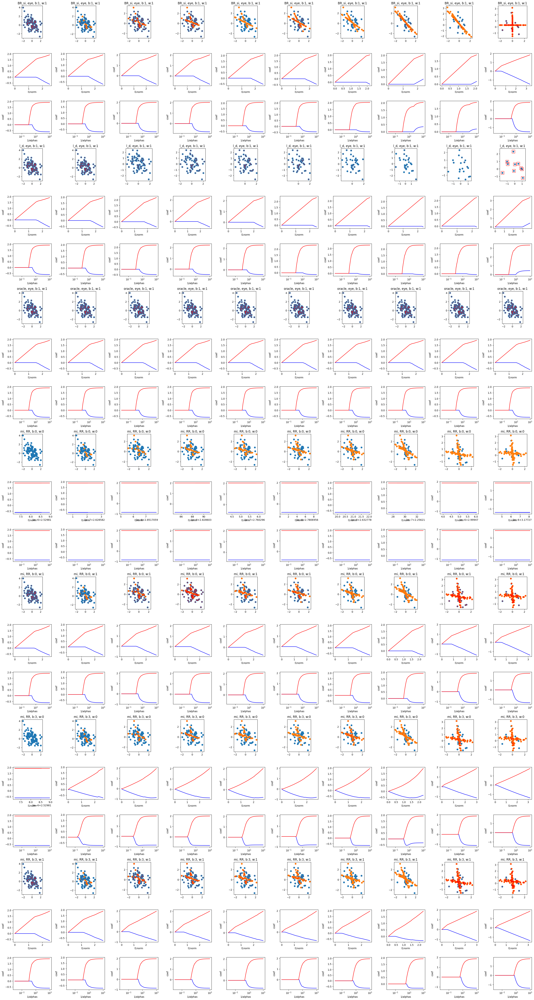

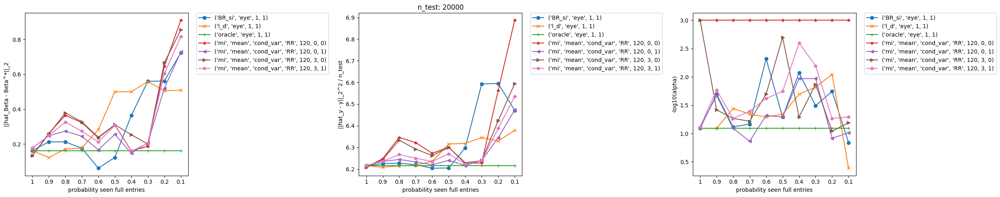

In [ ]:
np.random.seed(9876)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 120
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 1}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR',

100%|██████████| 200/200 [00:01<00:00, 102.66it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:03<00:00, 51.77it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 115.79it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]


100%|██████████| 200/200 [00:01<00:00, 126.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0563528008222607
---------------------------------> best coeff  [-0.25910498  2.05104718]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.96682939 0.

100%|██████████| 200/200 [00:01<00:00, 100.17it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  1.0670247170046576
---------------------------------> best coeff  [-0.24795765  2.01602754]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0

100%|██████████| 200/200 [00:02<00:00, 88.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0563528008222607
---------------------------------> best coeff  [-0.25910498  2.05104718]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.96682939 0.

100%|██████████| 200/200 [00:02<00:00, 85.27it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  1.0670247170046576
---------------------------------> best coeff  [-0.24795765  2.01602754]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.789980475276883
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 173.86it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  1.064936632509307
---------------------------------> best coeff  [-0.25268553  2.01520142]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -6.828603373862101
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 188.39it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  1.0719987320679645
---------------------------------> best coeff  [-0.23828621  2.0149494 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 174.04it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S i

100%|██████████| 200/200 [00:01<00:00, 128.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0535347036467793
---------------------------------> best coeff  [-0.26664025  2.04831679]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 0.        ]

100%|██████████| 200/200 [00:01<00:00, 101.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0642486722139795
---------------------------------> best coeff  [-0.2538712   2.01586199]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004

100%|██████████| 200/200 [00:01<00:00, 122.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  112  best 1/best_alpha  1.5343684089300116 , min score  1.0653174008992068
---------------------------------> best coeff  [-0.31956321  1.90252071]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.993770

100%|██████████| 200/200 [00:01<00:00, 100.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  1.064334943869555
---------------------------------> best coeff  [-0.24990719  2.02527254]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -11.028671590778782
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 137.37it/s]


------------------------> who is S in add_rectangles
 [[0.03827494 0.        ]
 [0.         0.03827494]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  1.0756286586958297
---------------------------------> best coeff  [-0.25779428  1.96197827]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.360043092808564
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 134.48it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  1.0442137727257104
---------------------------------> best coeff  [-0.32394657  1.97001323]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 156.23it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S 

100%|██████████| 200/200 [00:01<00:00, 103.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0614503060427591
---------------------------------> best coeff  [-0.27914819  1.97583437]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.01013931 0.        

100%|██████████| 200/200 [00:02<00:00, 77.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  1.0718488238320283
---------------------------------> best coeff  [-0.27190394  1.95088082]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.010139

100%|██████████| 200/200 [00:01<00:00, 123.32it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  1.071920046709495
---------------------------------> best coeff  [-0.26632885  1.9598917 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.0101393

100%|██████████| 200/200 [00:01<00:00, 100.81it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  1.072152417324677
---------------------------------> best coeff  [-0.26846641  1.95552164]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -12.864229248107186
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 180.18it/s]


------------------------> who is S in add_rectangles
 [[0.03409285 0.        ]
 [0.         0.03409285]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  1.0825780390855226
---------------------------------> best coeff  [-0.26555715  1.92839813]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.766895984652166
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  

100%|██████████| 200/200 [00:00<00:00, 231.21it/s]


------------------------> who is S in add_rectangles
 [[0.05111433 0.        ]
 [0.         0.05111433]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  1.0389272200151685
---------------------------------> best coeff  [-0.35177633  1.94951331]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 177.31it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S 

100%|██████████| 200/200 [00:01<00:00, 127.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0633251935165966
---------------------------------> best coeff  [-0.28285101  1.96214438]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.0252427  0.        

100%|██████████| 200/200 [00:01<00:00, 100.82it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  1.0743405618993334
---------------------------------> best coeff  [-0.2770177   1.93509066]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.0252427

100%|██████████| 200/200 [00:01<00:00, 122.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  1.0741009724202917
---------------------------------> best coeff  [-0.27687149  1.93603373]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.025242

100%|██████████| 200/200 [00:02<00:00, 67.37it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0740777700590536
---------------------------------> best coeff  [-0.27562456  1.93800264]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -17.872491642849866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 182.41it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  1.1049006246588635
---------------------------------> best coeff  [-0.24079645  1.907244  ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -12.585008806499982
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (t

100%|██████████| 200/200 [00:00<00:00, 264.60it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  1.0324619719819264
---------------------------------> best coeff  [-0.35402878  1.97817623]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 179.64it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S 

100%|██████████| 200/200 [00:01<00:00, 129.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0748046134543934
---------------------------------> best coeff  [-0.23240163  2.01577985]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.02132929 0.        

100%|██████████| 200/200 [00:01<00:00, 101.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  1.0853778091413218
---------------------------------> best coeff  [-0.22494006  1.98910308]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.0213292

100%|██████████| 200/200 [00:01<00:00, 119.26it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  1.085013541528863
---------------------------------> best coeff  [-0.23327277  1.97435329]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.0213292

100%|██████████| 200/200 [00:01<00:00, 102.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0855450453277224
---------------------------------> best coeff  [-0.22559683  1.98719732]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -16.19741034099305
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 179.63it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  1.0861682017715852
---------------------------------> best coeff  [-0.27870911  1.90041029]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.742896352550192
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50

100%|██████████| 200/200 [00:00<00:00, 282.31it/s]


------------------------> who is S in add_rectangles
 [[0.06826072 0.        ]
 [0.         0.06826072]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  1.0315205621525279
---------------------------------> best coeff  [-0.35859713  1.97566481]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 121.92it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S 

100%|██████████| 200/200 [00:01<00:00, 132.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0418111871053977
---------------------------------> best coeff  [-0.31011556  2.01074854]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.04134896 0.        

100%|██████████| 200/200 [00:02<00:00, 82.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  1.052108527276405
---------------------------------> best coeff  [-0.29837709  1.97988062]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.0413489

100%|██████████| 200/200 [00:02<00:00, 89.56it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  1.05257521997887
---------------------------------> best coeff  [-0.37672854  1.87325748]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.04134896

100%|██████████| 200/200 [00:01<00:00, 103.09it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  1.0520810978035073
---------------------------------> best coeff  [-0.3164288   1.94954064]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -11.289324702045752
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 177.57it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.1093103772383885
---------------------------------> best coeff  [-0.310425    1.81436968]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -6.006476530179242
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matr

100%|██████████| 200/200 [00:00<00:00, 304.55it/s]


------------------------> who is S in add_rectangles
 [[0.05738442 0.        ]
 [0.         0.05738442]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  1.026390112608043
---------------------------------> best coeff  [-0.50975655  1.85668795]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 176.25it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S i

100%|██████████| 200/200 [00:01<00:00, 123.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0329631503071246
---------------------------------> best coeff  [-0.44821117  1.86958915]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015 0.        ]

100%|██████████| 200/200 [00:01<00:00, 101.25it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.0435964830219393
---------------------------------> best coeff  [-0.44818845  1.83690833]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015

100%|██████████| 200/200 [00:01<00:00, 118.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0436432988660431
---------------------------------> best coeff  [-0.47418609  1.81988415]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015

100%|██████████| 200/200 [00:01<00:00, 100.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  1.044088084851085
---------------------------------> best coeff  [-0.46235047  1.82598907]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -14.86593548475841
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 116.93it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.1398597673788127
---------------------------------> best coeff  [-0.372788    1.70915121]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -5.833959137891778
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)

100%|██████████| 200/200 [00:00<00:00, 345.53it/s]


------------------------> who is S in add_rectangles
 [[0.03827494 0.        ]
 [0.         0.03827494]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  1.038883669172581
---------------------------------> best coeff  [-0.50942341  1.8150182 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 168.60it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S 

100%|██████████| 200/200 [00:02<00:00, 88.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.049088974359887
---------------------------------> best coeff  [-0.54388387  1.77408857]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339   0.        ]

100%|██████████| 200/200 [00:01<00:00, 101.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  1.0599035088857491
---------------------------------> best coeff  [-0.52709966  1.75404789]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339 

100%|██████████| 200/200 [00:01<00:00, 118.19it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  1.0601994673358628
---------------------------------> best coeff  [-0.56321571  1.74143404]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339 

100%|██████████| 200/200 [00:01<00:00, 103.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  1.0610773484463272
---------------------------------> best coeff  [-0.55396551  1.74204183]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -17.40105936399259
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 179.89it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.2430005329363558
---------------------------------> best coeff  [-0.48584936  1.51330004]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -4.104818421620511
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 385.39it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  1.0844518951655966
---------------------------------> best coeff  [-0.58773027  1.68454211]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 172.08it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S i

100%|██████████| 200/200 [00:01<00:00, 128.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0564688872050167
---------------------------------> best coeff  [-0.52053512  1.76457319]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984 0.        ]

100%|██████████| 200/200 [00:02<00:00, 99.88it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0671878149734275
---------------------------------> best coeff  [-0.50691979  1.74696071]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984 

100%|██████████| 200/200 [00:02<00:00, 83.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.068171627018292
---------------------------------> best coeff  [-0.539959    1.73121972]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984

100%|██████████| 200/200 [00:02<00:00, 89.78it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  1.068369050754955
---------------------------------> best coeff  [-0.53069033  1.73429223]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -29.724107252632905
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 180.96it/s]


------------------------> who is S in add_rectangles
 [[0.00674754 0.        ]
 [0.         0.00674754]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  1.5821310699395326
---------------------------------> best coeff  [-0.81015221  1.12796806]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -3.3688569323981072
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 441.36it/s]


------------------------> who is S in add_rectangles
 [[0.28994229 0.        ]
 [0.         0.28994229]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  98  best 1/best_alpha  3.4489622604057564 , min score  1.0824300062165995
---------------------------------> best coeff  [-0.80496382  1.84821857]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.

100%|██████████| 200/200 [00:01<00:00, 175.46it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.0666815370996978
---------------------------------> best coeff  [-0.24829792  2.01692663]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in 

100%|██████████| 200/200 [00:01<00:00, 137.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0824993931563864
---------------------------------> best coeff  [-0.64402333  1.68099041]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 104.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0933880991926461
---------------------------------> best coeff  [-0.63692897  1.65950591]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0

100%|██████████| 200/200 [00:01<00:00, 120.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  1.095412289357335
---------------------------------> best coeff  [-0.65948038  1.65444165]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0

100%|██████████| 200/200 [00:01<00:00, 107.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  1.095984268023165
---------------------------------> best coeff  [-0.65524302  1.65341412]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.24829792,  2.01692663]), array([-0.25268553,  2.01520142]), array([-0.25779428,  1.96197827]), array([-0.26555715,  1.92839813]), array([-0.24079645,  1.907244  ]), array([-0.27870911,  1.90041029]), array([-0.310425  ,  1.81436968]), array([-0.372788  ,  1.70915121]), array([-0.48584936,  1.51330004]), array([-0.81015221,  1.12796806])], 'l2_dist_best_coeff_gt': [np.float64(0.2522705804217444), np.float64(0.24778121536617215), np.float64(0.2451719067747644), np.float64(0.24513318137401727), np.float64(0.2753001195830469), np.float64(0.24266801898952686), np.float64(0.2653248850241

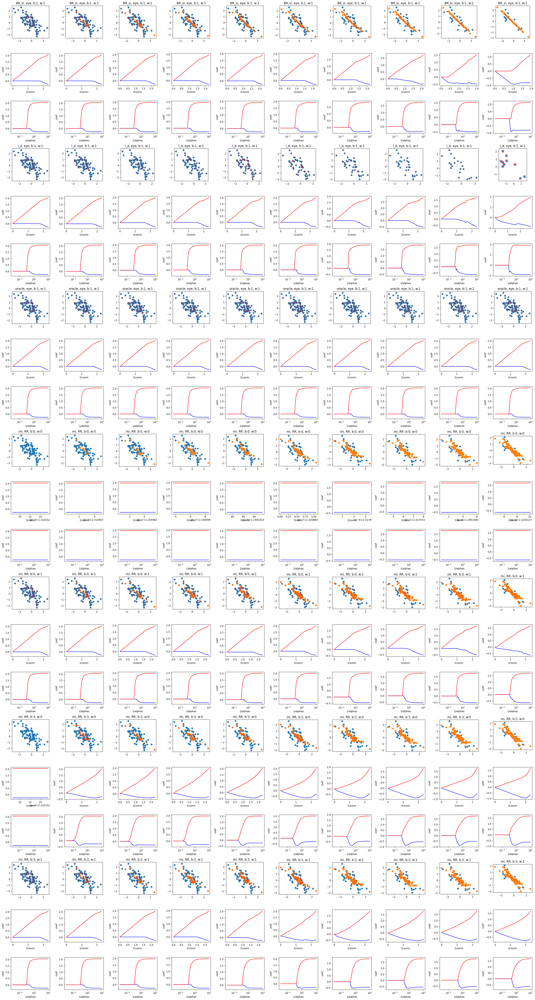

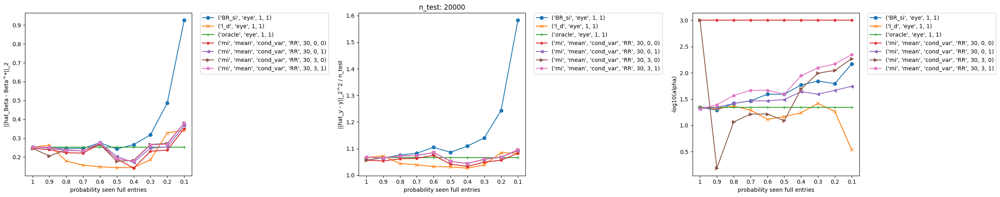

In [ ]:
np.random.seed(987654321)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [1] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 2.5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR

100%|██████████| 200/200 [00:01<00:00, 136.99it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 

100%|██████████| 200/200 [00:01<00:00, 178.07it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0.

100%|██████████| 200/200 [00:01<00:00, 179.11it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-

100%|██████████| 200/200 [00:02<00:00, 85.00it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.602204968537527
---------------------------------> best coeff  [0.10223755 2.12761794]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.96682939 0.   

100%|██████████| 200/200 [00:02<00:00, 95.85it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.547569777813524
---------------------------------> best coeff  [1.87303209e-09 1.99698632e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 

100%|██████████| 200/200 [00:01<00:00, 128.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.602204968537527
---------------------------------> best coeff  [0.10223755 2.12761794]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.96682939 0.   

100%|██████████| 200/200 [00:01<00:00, 105.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.547569777813524
---------------------------------> best coeff  [1.87303209e-09 1.99698632e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.789980475276883
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S w

100%|██████████| 200/200 [00:01<00:00, 180.73it/s]


------------------------> who is S in add_rectangles
 [[0.0270496 0.       ]
 [0.        0.0270496]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  6.543007715073545
---------------------------------> best coeff  [1.32726028e-10 2.00714914e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -6.828603373862101
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imput

100%|██████████| 200/200 [00:00<00:00, 200.44it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  6.560446859426996
---------------------------------> best coeff  [0.02215589 2.01730451]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 185.07it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final

100%|██████████| 200/200 [00:01<00:00, 130.00it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.591356633439151
---------------------------------> best coeff  [0.09138732 2.12583271]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 0.        ]
 [

100%|██████████| 200/200 [00:01<00:00, 105.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  6.544180876096805
---------------------------------> best coeff  [0.02028107 2.05295568]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 0

100%|██████████| 200/200 [00:01<00:00, 111.65it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  6.536592550941855
---------------------------------> best coeff  [0.01624816 2.06343172]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 0

100%|██████████| 200/200 [00:02<00:00, 74.93it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  6.542541512080006
---------------------------------> best coeff  [-8.80082544e-10  2.00821410e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -11.028671590778782
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


100%|██████████| 200/200 [00:01<00:00, 180.92it/s]


------------------------> who is S in add_rectangles
 [[0.01203378 0.        ]
 [0.         0.01203378]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  6.564465928229699
---------------------------------> best coeff  [-1.31051994e-09  1.96271185e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.360043092808564
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train l

100%|██████████| 200/200 [00:00<00:00, 218.77it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  6.470647875018629
---------------------------------> best coeff  [-0.09596324  1.97637039]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 185.20it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
fina

100%|██████████| 200/200 [00:01<00:00, 130.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.5403700230333115
---------------------------------> best coeff  [-0.01464166  1.98185616]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.01013931 0.        

100%|██████████| 200/200 [00:03<00:00, 54.00it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  6.552093583124916
---------------------------------> best coeff  [-0.00743261  1.97228185]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.0101393

100%|██████████| 200/200 [00:01<00:00, 121.56it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  6.551678318816087
---------------------------------> best coeff  [-4.50463544e-04  1.98726673e+00]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.

100%|██████████| 200/200 [00:02<00:00, 99.27it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.553150135370756
---------------------------------> best coeff  [-0.00415185  1.97669632]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -12.864229248107186
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 122.89it/s]


------------------------> who is S in add_rectangles
 [[0.00674754 0.        ]
 [0.         0.00674754]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  6.57412937947624
---------------------------------> best coeff  [-0.00759313  1.93126519]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.766895984652166
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  ,

100%|██████████| 200/200 [00:01<00:00, 147.16it/s]


------------------------> who is S in add_rectangles
 [[0.01011638 0.        ]
 [0.         0.01011638]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  6.438583839482843
---------------------------------> best coeff  [-0.15474671  1.94486948]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 179.09it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
fina

100%|██████████| 200/200 [00:02<00:00, 93.02it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.557194948042401
---------------------------------> best coeff  [-0.01270611  1.95229278]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.0252427  0.        ]

100%|██████████| 200/200 [00:02<00:00, 82.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  6.569615498218566
---------------------------------> best coeff  [-0.0058828   1.94223331]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.0252427

100%|██████████| 200/200 [00:01<00:00, 118.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.568225638289835
---------------------------------> best coeff  [-2.20395507e-04  1.95525409e+00]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.

100%|██████████| 200/200 [00:02<00:00, 99.54it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.570148287727739
---------------------------------> best coeff  [-0.00278884  1.94695434]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -17.872491642849866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 174.36it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  6.60812703728759
---------------------------------> best coeff  [-7.09824680e-10  1.88984816e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -12.585008806499982
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_s

100%|██████████| 200/200 [00:00<00:00, 251.86it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  6.3962496362736
---------------------------------> best coeff  [-0.18136967  2.02333956]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 177.03it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
fina

100%|██████████| 200/200 [00:01<00:00, 120.59it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.621403477935436
---------------------------------> best coeff  [0.11457246 2.10956585]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.02132929 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 100.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  6.5598725633987005
---------------------------------> best coeff  [-1.83704230e-09  1.97157652e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1

100%|██████████| 200/200 [00:02<00:00, 92.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  6.55952386518672
---------------------------------> best coeff  [0.02047672 2.01557205]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.02132929 0. 

100%|██████████| 200/200 [00:02<00:00, 78.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  6.559261829285312
---------------------------------> best coeff  [-3.93092938e-10  1.97277832e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -16.19741034099305
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S

100%|██████████| 200/200 [00:01<00:00, 173.19it/s]


------------------------> who is S in add_rectangles
 [[0.00802643 0.        ]
 [0.         0.00802643]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  6.599352621983122
---------------------------------> best coeff  [-6.80851825e-09  1.90317792e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.742896352550192
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  

100%|██████████| 200/200 [00:00<00:00, 268.44it/s]


------------------------> who is S in add_rectangles
 [[0.01516717 0.        ]
 [0.         0.01516717]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  6.3903578556817795
---------------------------------> best coeff  [-0.18557162  2.04004084]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 169.70it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
fina

100%|██████████| 200/200 [00:01<00:00, 126.48it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.544803370006714
---------------------------------> best coeff  [0.02589568 2.06638277]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.04134896 0.        ]
 

100%|██████████| 200/200 [00:02<00:00, 99.93it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  6.5405197421398125
---------------------------------> best coeff  [-3.34518099e-07  2.01289266e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1

100%|██████████| 200/200 [00:01<00:00, 117.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  5  best 1/best_alpha  748.8103857590023 , min score  6.540273020140075
---------------------------------> best coeff  [0.01818004 2.05816811]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.04134896 0.

100%|██████████| 200/200 [00:01<00:00, 100.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  36  best 1/best_alpha  124.5883364295008 , min score  6.5403868261756335
---------------------------------> best coeff  [-1.36871532e-08  2.01320458e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -11.289324702045752
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]

100%|██████████| 200/200 [00:01<00:00, 157.50it/s]


------------------------> who is S in add_rectangles
 [[0.00535357 0.        ]
 [0.         0.00535357]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  29  best 1/best_alpha  186.79135990207828 , min score  6.6372770689078
---------------------------------> best coeff  [-0.15023666  1.66284519]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -6.006476530179242
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:01<00:00, 189.69it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  6.359202041166726
---------------------------------> best coeff  [-0.52495627  1.7445096 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 124.09it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final

100%|██████████| 200/200 [00:01<00:00, 104.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.468214015335657
---------------------------------> best coeff  [-0.21799213  1.7997798 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015 0.        ]


100%|██████████| 200/200 [00:02<00:00, 72.09it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  6.480166593293022
---------------------------------> best coeff  [-0.21422173  1.78571082]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015

100%|██████████| 200/200 [00:01<00:00, 120.56it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  6.480036649841935
---------------------------------> best coeff  [-0.22440858  1.77449439]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015

100%|██████████| 200/200 [00:01<00:00, 100.61it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  6.481451988346797
---------------------------------> best coeff  [-0.218209   1.7792914]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -14.86593548475841
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 172.40it/s]


------------------------> who is S in add_rectangles
 [[0.00450056 0.        ]
 [0.         0.00450056]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  6.712622766878664
---------------------------------> best coeff  [-0.29511522  1.46714867]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -5.833959137891778
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)

100%|██████████| 200/200 [00:00<00:00, 342.95it/s]


------------------------> who is S in add_rectangles
 [[0.01011638 0.        ]
 [0.         0.01011638]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  6.438216747405624
---------------------------------> best coeff  [-0.54035252  1.60077773]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 174.62it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
fina

100%|██████████| 200/200 [00:01<00:00, 126.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.477367184779833
---------------------------------> best coeff  [-0.27072569  1.73040784]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339   0.        ]

100%|██████████| 200/200 [00:01<00:00, 100.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.48984302866029
---------------------------------> best coeff  [-0.26497548  1.71895212]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339  

100%|██████████| 200/200 [00:01<00:00, 118.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  6.489830199504305
---------------------------------> best coeff  [-0.27873862  1.7059504 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339 

100%|██████████| 200/200 [00:02<00:00, 67.21it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  6.49181180117064
---------------------------------> best coeff  [-0.27126708  1.71033578]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -17.40105936399259
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 181.24it/s]


------------------------> who is S in add_rectangles
 [[0.00400881 0.        ]
 [0.         0.00400881]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  7.014938928840205
---------------------------------> best coeff  [-0.62720059  1.07985064]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -4.104818421620511
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 387.14it/s]


------------------------> who is S in add_rectangles
 [[0.01011638 0.        ]
 [0.         0.01011638]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  6.723380197487475
---------------------------------> best coeff  [-0.80083003  1.24193413]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 169.32it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final

100%|██████████| 200/200 [00:01<00:00, 117.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.547170314100614
---------------------------------> best coeff  [-0.50102846  1.48855138]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984 0.        ]


100%|██████████| 200/200 [00:01<00:00, 101.72it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.560148919625534
---------------------------------> best coeff  [-0.4944196  1.4785942]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984 0

100%|██████████| 200/200 [00:01<00:00, 119.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  25  best 1/best_alpha  235.4286414322418 , min score  6.560559310362095
---------------------------------> best coeff  [-0.50572649  1.47267723]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984 

100%|██████████| 200/200 [00:01<00:00, 103.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  18  best 1/best_alpha  352.97073027306504 , min score  6.562573603644453
---------------------------------> best coeff  [-0.50082429  1.47302416]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -29.724107252632905
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S withi

100%|██████████| 200/200 [00:01<00:00, 182.68it/s]


------------------------> who is S in add_rectangles
 [[0.00300184 0.        ]
 [0.         0.00300184]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  19  best 1/best_alpha  333.1294787934674 , min score  7.501293927388873
---------------------------------> best coeff  [-0.89236839  0.74395001]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -3.3688569323981072
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 445.57it/s]


------------------------> who is S in add_rectangles
 [[0.25826188 0.        ]
 [0.         0.25826188]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  96  best 1/best_alpha  3.8720387818125532 , min score  6.863240125659193
---------------------------------> best coeff  [-1.33721565  1.48105571]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 141.21it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  6.54693758821082
---------------------------------> best coeff  [2.01732973e-09 1.99836783e+00]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S

100%|██████████| 200/200 [00:01<00:00, 120.02it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  6.450551729785483
---------------------------------> best coeff  [-0.43926096  1.63466993]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0.        ]
 [

100%|██████████| 200/200 [00:02<00:00, 91.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  6.462785594246237
---------------------------------> best coeff  [-0.43539197  1.62087335]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0

100%|██████████| 200/200 [00:02<00:00, 83.13it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  27  best 1/best_alpha  209.70464013232328 , min score  6.463450113341659
---------------------------------> best coeff  [-0.44435513  1.61462026]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0

100%|██████████| 200/200 [00:01<00:00, 103.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  20  best 1/best_alpha  314.40354715915 , min score  6.466061777079377
---------------------------------> best coeff  [-0.44043507  1.61360709]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([2.01732973e-09, 1.99836783e+00]), array([1.32726028e-10, 2.00714914e+00]), array([-1.31051994e-09,  1.96271185e+00]), array([-0.00759313,  1.93126519]), array([-7.09824680e-10,  1.88984816e+00]), array([-6.80851825e-09,  1.90317792e+00]), array([-0.15023666,  1.66284519]), array([-0.29511522,  1.46714867]), array([-0.62720059,  1.07985064]), array([-0.89236839,  0.74395001])], 'l2_dist_best_coeff_gt': [np.float64(0.5000026659758258), np.float64(0.5000511076734967), np.float64(0.5013884770630929), np.float64(0.497181055740427), np.float64(0.5119896758645974), np.float64(0.5092882364381422

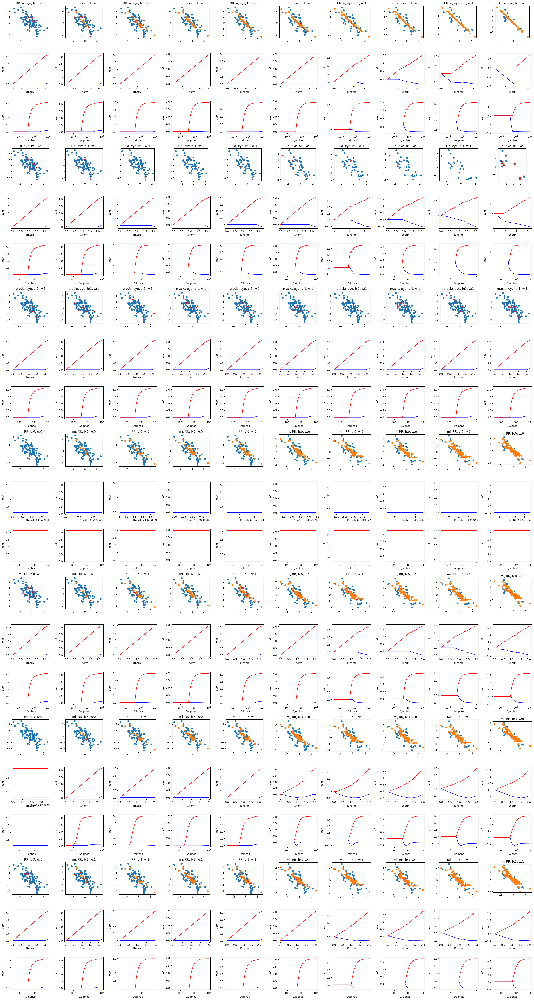

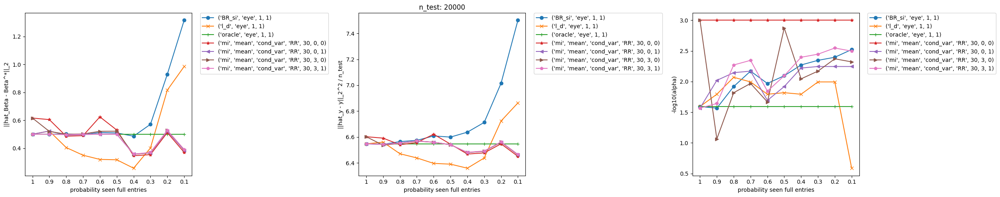

In [ ]:
np.random.seed(987654321)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [2.5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR',

100%|██████████| 200/200 [00:01<00:00, 110.10it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
sh

100%|██████████| 200/200 [00:01<00:00, 153.30it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 182.44it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
fin

100%|██████████| 200/200 [00:02<00:00, 90.12it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.4088197439879
---------------------------------> best coeff  [0.70447509 2.25523587]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.96682939 0.    

100%|██████████| 200/200 [00:01<00:00, 107.16it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.871127533612874
---------------------------------> best coeff  [0.0976172  1.64106395]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.9

100%|██████████| 200/200 [00:01<00:00, 133.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.4088197439879
---------------------------------> best coeff  [0.70447509 2.25523587]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -211.36685291971142
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.96682939 0.96680379]
cov computed
s_between  [2.22044605e-16 4.44089210e-16]
final S in cov strategy RR  [[0.96682939 0.        ]
 [0.         0.96680379]]
S within 
 [[0.96682939 0.    

100%|██████████| 200/200 [00:01<00:00, 108.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.871127533612874
---------------------------------> best coeff  [0.0976172  1.64106395]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.789980475276883
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 189.21it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.84972270328834
---------------------------------> best coeff  [0.08215048 1.63980698]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -6.828603373862101
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputatio

100%|██████████| 200/200 [00:00<00:00, 205.24it/s]


------------------------> who is S in add_rectangles
 [[0.05738442 0.        ]
 [0.         0.05738442]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  25.95874325984326
---------------------------------> best coeff  [1.39400783e-07 1.46779256e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0.

100%|██████████| 200/200 [00:01<00:00, 192.22it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in c

100%|██████████| 200/200 [00:01<00:00, 137.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.374534549452544
---------------------------------> best coeff  [0.68809995 2.25502591]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 108.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  25.851198515746336
---------------------------------> best coeff  [0.08780553 1.64549212]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 

100%|██████████| 200/200 [00:01<00:00, 111.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  102  best 1/best_alpha  2.736439997074669 , min score  25.71549370943239
---------------------------------> best coeff  [0.04009379 1.70755351]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -208.1828572488568
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [0.98368201 0.97479139]
cov computed
s_between  [0.0097626  0.01068025]
final S in cov strategy RR  [[0.99377004 0.        ]
 [0.         0.98582764]]
S within 
 [[0.99377004 0

100%|██████████| 200/200 [00:02<00:00, 76.86it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  25.838233596809754
---------------------------------> best coeff  [1.70259606e-08 1.55519817e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -11.028671590778782
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S

100%|██████████| 200/200 [00:01<00:00, 187.27it/s]


------------------------> who is S in add_rectangles
 [[0.02409404 0.        ]
 [0.         0.02409404]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  25.8793028728224
---------------------------------> best coeff  [0.07957213 1.61268971]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.360043092808564
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  80


100%|██████████| 200/200 [00:00<00:00, 221.24it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  25.696931914397645
---------------------------------> best coeff  [0.04896206 1.73759591]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 182.70it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in 

100%|██████████| 200/200 [00:01<00:00, 134.67it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.0527203557837
---------------------------------> best coeff  [0.42620255 1.99189249]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.01013931 0.        ]
 [

100%|██████████| 200/200 [00:01<00:00, 107.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  25.83952140936364
---------------------------------> best coeff  [0.07160305 1.63550273]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.01013931 0

100%|██████████| 200/200 [00:01<00:00, 131.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  25.80306802046164
---------------------------------> best coeff  [0.05358017 1.64454627]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -331.67464519775797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.99565523 0.99848846]
cov computed
s_between  [0.01401686 0.02174761]
final S in cov strategy RR  [[1.01013931 0.        ]
 [0.         1.02096099]]
S within 
 [[1.01013931 

100%|██████████| 200/200 [00:01<00:00, 107.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  25.83547056689912
---------------------------------> best coeff  [0.08013266 1.64926403]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -12.864229248107186
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 186.22it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  25.916772945368166
---------------------------------> best coeff  [0.08881405 1.59429856]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.766895984652166
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  , s

100%|██████████| 200/200 [00:00<00:00, 235.39it/s]


------------------------> who is S in add_rectangles
 [[0.01011638 0.        ]
 [0.         0.01011638]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  25.639114565021902
---------------------------------> best coeff  [0.03364302 1.77887868]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 136.23it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in 

100%|██████████| 200/200 [00:01<00:00, 133.34it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.124712133129897
---------------------------------> best coeff  [0.43753534 1.93587345]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.0252427  0.        ]


100%|██████████| 200/200 [00:02<00:00, 98.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.931065220440786
---------------------------------> best coeff  [0.09969853 1.59615745]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.0252427  

100%|██████████| 200/200 [00:02<00:00, 83.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  25.881363271578817
---------------------------------> best coeff  [5.89111293e-09 1.52263158e+00]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -402.99938056894973
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0044503  1.00073322]
cov computed
s_between  [0.02012168 0.02412009]
final S in cov strategy RR  [[1.0252427  0.        ]
 [0.         1.02565732]]
S within 
 [[1.

100%|██████████| 200/200 [00:01<00:00, 108.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  25.91626694050671
---------------------------------> best coeff  [0.07841624 1.58260145]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -17.872491642849866
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 187.68it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.980873261456136
---------------------------------> best coeff  [0.10817087 1.56892311]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -12.585008806499982
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 260.51it/s]


------------------------> who is S in add_rectangles
 [[0.01516717 0.        ]
 [0.         0.01516717]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  25.483201159391097
---------------------------------> best coeff  [2.07925028e-09 1.94902399e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [

100%|██████████| 200/200 [00:01<00:00, 185.13it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in 

100%|██████████| 200/200 [00:01<00:00, 132.77it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.378188090913795
---------------------------------> best coeff  [0.6928627  2.26587556]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.02132929 0.        ]


100%|██████████| 200/200 [00:01<00:00, 107.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  25.844584146379685
---------------------------------> best coeff  [1.30576037e-08 1.55030150e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.0

100%|██████████| 200/200 [00:01<00:00, 129.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  25.814948600313993
---------------------------------> best coeff  [0.08060469 1.66743043]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -461.25422022575606
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.00141878 1.00588586]
cov computed
s_between  [0.01926824 0.02808197]
final S in cov strategy RR  [[1.02132929 0.        ]
 [0.         1.0349039 ]]
S within 
 [[1.02132929

100%|██████████| 200/200 [00:01<00:00, 107.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  25.83129428887809
---------------------------------> best coeff  [1.36075884e-08 1.56059123e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -16.19741034099305
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S w

100%|██████████| 200/200 [00:01<00:00, 179.19it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  26.044100089727003
---------------------------------> best coeff  [0.16975008 1.59634297]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -9.742896352550192
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 2


100%|██████████| 200/200 [00:01<00:00, 192.13it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  25.462286439524018
---------------------------------> best coeff  [4.91960736e-10 1.99386012e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [

100%|██████████| 200/200 [00:01<00:00, 127.49it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in 

100%|██████████| 200/200 [00:01<00:00, 138.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.227761690341584
---------------------------------> best coeff  [0.58591441 2.15910647]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.04134896 0.        ]


100%|██████████| 200/200 [00:02<00:00, 71.52it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  25.881397156961793
---------------------------------> best coeff  [0.11312387 1.65185035]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.04134896 0

100%|██████████| 200/200 [00:01<00:00, 121.53it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  25.87396174439669
---------------------------------> best coeff  [9.90476800e-09 1.52810926e+00]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -420.86626662260124
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0133686  0.97567678]
cov computed
s_between  [0.02707777 0.03520966]
final S in cov strategy RR  [[1.04134896 0.        ]
 [0.         1.0120601 ]]
S within 
 [[1.041

100%|██████████| 200/200 [00:01<00:00, 106.59it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  25.8789521774102
---------------------------------> best coeff  [0.11555468 1.65692595]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -11.289324702045752
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 182.75it/s]


------------------------> who is S in add_rectangles
 [[0.00252354 0.        ]
 [0.         0.00252354]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  16  best 1/best_alpha  396.26886387014787 , min score  26.249740606018772
---------------------------------> best coeff  [0.02265196 1.31129403]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -6.006476530179242
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matr

100%|██████████| 200/200 [00:00<00:00, 306.60it/s]


------------------------> who is S in add_rectangles
 [[0.00567243 0.        ]
 [0.         0.00567243]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  25.40696280044195
---------------------------------> best coeff  [-0.56832661  1.51790864]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 184.19it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in c

100%|██████████| 200/200 [00:01<00:00, 130.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.92507583011708
---------------------------------> best coeff  [0.16570628 1.68343101]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05851015 0.        ]
 [

100%|██████████| 200/200 [00:01<00:00, 106.86it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  25.92448434809513
---------------------------------> best coeff  [3.82131661e-07 1.49155309e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.05

100%|██████████| 200/200 [00:01<00:00, 128.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  25.92608411966433
---------------------------------> best coeff  [1.95560787e-07 1.49042583e+00]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -194.2870699560631
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.02300397 0.94473907]
cov computed
s_between  [0.03436083 0.04268478]
final S in cov strategy RR  [[1.05851015 0.        ]
 [0.         0.98884667]]
S within 
 [[1.0585

100%|██████████| 200/200 [00:01<00:00, 107.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  25.924486501408026
---------------------------------> best coeff  [5.63180989e-07 1.49155175e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -14.86593548475841
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S

100%|██████████| 200/200 [00:01<00:00, 164.89it/s]


------------------------> who is S in add_rectangles
 [[0.00212145 0.        ]
 [0.         0.00212145]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  13  best 1/best_alpha  471.37531341167244 , min score  26.44537377590472
---------------------------------> best coeff  [-0.17278581  1.05143969]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -5.833959137891778
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)

100%|██████████| 200/200 [00:00<00:00, 339.15it/s]


------------------------> who is S in add_rectangles
 [[0.00357079 0.        ]
 [0.         0.00357079]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  22  best 1/best_alpha  280.05038941836307 , min score  25.72095006126094
---------------------------------> best coeff  [-0.59078272  1.22056033]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]

100%|██████████| 200/200 [00:01<00:00, 179.56it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in 

100%|██████████| 200/200 [00:02<00:00, 97.23it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.987630895123804
---------------------------------> best coeff  [0.18453795 1.65760663]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339   0.        ]


100%|██████████| 200/200 [00:01<00:00, 102.16it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  25.989689059999424
---------------------------------> best coeff  [1.34733966e-07 1.44696865e+00]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.

100%|██████████| 200/200 [00:01<00:00, 120.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  25.990209078745153
---------------------------------> best coeff  [0.00739887 1.45398637]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -236.97552738081313
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.04143804 0.94727059]
cov computed
s_between  [0.03280738 0.03763008]
final S in cov strategy RR  [[1.075339   0.        ]
 [0.         0.98615501]]
S within 
 [[1.075339  

100%|██████████| 200/200 [00:01<00:00, 103.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  24  best 1/best_alpha  249.45081352303168 , min score  25.98986021257058
---------------------------------> best coeff  [4.30640512e-06 1.44685920e+00]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -17.40105936399259
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S 

100%|██████████| 200/200 [00:01<00:00, 182.74it/s]


------------------------> who is S in add_rectangles
 [[0.00188965 0.        ]
 [0.         0.00188965]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  11  best 1/best_alpha  529.1978735958443 , min score  27.345253752284894
---------------------------------> best coeff  [-0.85181613  0.35969223]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -4.104818421620511
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 363.59it/s]


------------------------> who is S in add_rectangles
 [[0.00318063 0.        ]
 [0.         0.00318063]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  20  best 1/best_alpha  314.40354715915 , min score  26.862971261309955
---------------------------------> best coeff  [-1.11728572  0.49581259]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 178.78it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in c

100%|██████████| 200/200 [00:01<00:00, 130.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  26.12254208615862
---------------------------------> best coeff  [-0.46851739  1.02851499]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984 0.        ]


100%|██████████| 200/200 [00:01<00:00, 100.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  14  best 1/best_alpha  444.8782831127586 , min score  26.142370188159532
---------------------------------> best coeff  [-0.4643526   1.02011465]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984

100%|██████████| 200/200 [00:02<00:00, 79.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  14  best 1/best_alpha  444.8782831127586 , min score  26.142142738183214
---------------------------------> best coeff  [-0.46839354  1.0181599 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -327.0240513190963
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.05593462 0.97593944]
cov computed
s_between  [0.04272118 0.04669982]
final S in cov strategy RR  [[1.10007984 0.        ]
 [0.         1.02419592]]
S within 
 [[1.10007984

100%|██████████| 200/200 [00:02<00:00, 95.34it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  8  best 1/best_alpha  629.4988990221888 , min score  26.150463949956606
---------------------------------> best coeff  [-0.4654724   1.01527133]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -29.724107252632905
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 182.64it/s]


------------------------> who is S in add_rectangles
 [[0.00168318 0.        ]
 [0.         0.00168318]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  9  best 1/best_alpha  594.1133984965035 , min score  27.972842983595317
---------------------------------> best coeff  [-1.02850039  0.10249792]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -3.3688569323981072
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 424.93it/s]


------------------------> who is S in add_rectangles
 [[0.3072113 0.       ]
 [0.        0.3072113]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  99  best 1/best_alpha  3.2550885998350565 , min score  27.570166205577685
---------------------------------> best coeff  [-2.13683029  0.64788279]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -7.045561763990378
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 178.88it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.86608491324145
---------------------------------> best coeff  [0.07661301 1.61976283]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov

100%|██████████| 200/200 [00:01<00:00, 130.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.709551832476073
---------------------------------> best coeff  [-0.09799046  1.55746883]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0.        ]
 

100%|██████████| 200/200 [00:01<00:00, 101.07it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  16  best 1/best_alpha  396.26886387014787 , min score  25.727465420009665
---------------------------------> best coeff  [-0.09467727  1.54586673]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 

100%|██████████| 200/200 [00:01<00:00, 114.55it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  17  best 1/best_alpha  373.9937302478798 , min score  25.726414085174294
---------------------------------> best coeff  [-0.09374267  1.54765644]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.96682939 0.96680379]
crush test------------------------------------------------->  -546.0860249100261
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0278698  0.93430146]
cov computed
s_between  [0.0272783 0.0350115]
final S in cov strategy RR  [[1.05605738 0.        ]
 [0.         0.97048001]]
S within 
 [[1.05605738 0

100%|██████████| 200/200 [00:01<00:00, 100.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  10  best 1/best_alpha  560.7169938205458 , min score  25.73354693921044
---------------------------------> best coeff  [-0.09279512  1.54274368]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([0.07661301, 1.61976283]), array([0.08215048, 1.63980698]), array([0.07957213, 1.61268971]), array([0.08881405, 1.59429856]), array([0.10817087, 1.56892311]), array([0.16975008, 1.59634297]), array([0.02265196, 1.31129403]), array([-0.17278581,  1.05143969]), array([-0.85181613,  0.35969223]), array([-1.02850039,  0.10249792])], 'l2_dist_best_coeff_gt': [np.float64(0.690697375222082), np.float64(0.6845715369510462), np.float64(0.6970746857316947), np.float64(0.7150493967461258), np.float64(0.7454522764903156), np.float64(0.7819873196109753), np.float64(0.8645698288337501), np.float64(1.

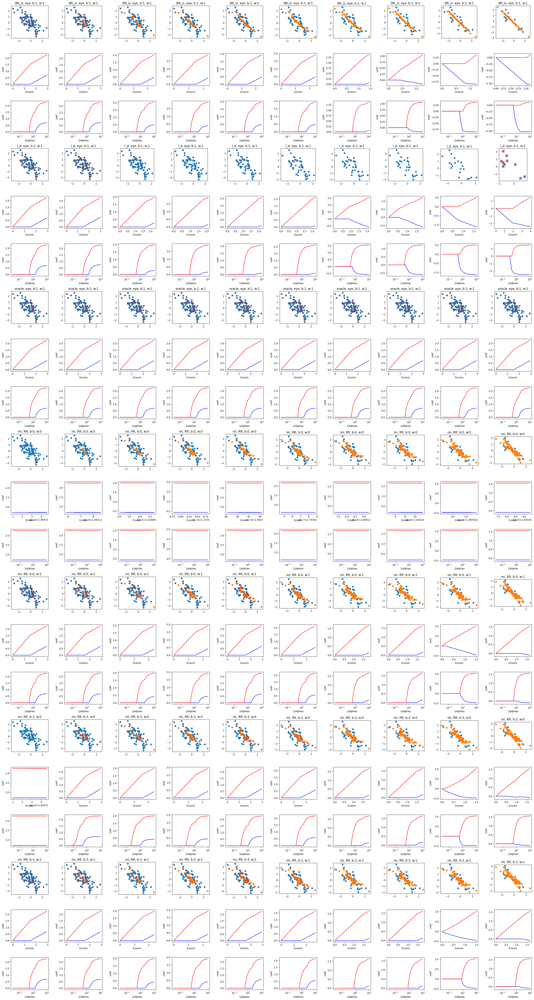

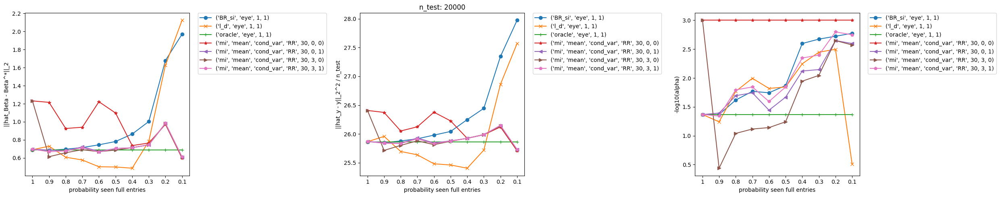

In [ ]:
np.random.seed(987654321)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20250
n_train :  250
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9876543209876543
err :  {'type': 'Gaussian_on_y', 'scaling': 5}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR',

100%|██████████| 200/200 [00:05<00:00, 35.34it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

100%|██████████| 200/200 [00:04<00:00, 45.45it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

100%|██████████| 200/200 [00:02<00:00, 80.10it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -113.34014123964286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:03<00:00, 65.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.249990893618925
---------------------------------> best coeff  [-0.3611607  2.196444 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -113.34014123964286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 57.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  25.252040877573805
---------------------------------> best coeff  [-0.24469956  2.07513018]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -113.34014123964286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 63.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.249990893618925
---------------------------------> best coeff  [-0.3611607  2.196444 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -113.34014123964286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:04<00:00, 45.44it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  25.252040877573805
---------------------------------> best coeff  [-0.24469956  2.07513018]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -7.3539106974823945
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:02<00:00, 81.18it/s]


------------------------> who is S in add_rectangles
 [[0.04055461 0.        ]
 [0.         0.04055461]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  25.262660529920797
---------------------------------> best coeff  [-0.20685333  2.10565938]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -7.885737561950201
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

100%|██████████| 200/200 [00:02<00:00, 90.78it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.300615749693645
---------------------------------> best coeff  [-0.11207488  2.20255881]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

100%|██████████| 200/200 [00:02<00:00, 80.30it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -172.1023937455098
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 52.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.253323057891308
---------------------------------> best coeff  [-0.31955197  2.21064358]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -172.1023937455098
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:04<00:00, 49.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  63  best 1/best_alpha  26.126752255633274 , min score  25.259229113517616
---------------------------------> best coeff  [-0.217699    2.09952077]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -172.1023937455098
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 58.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  25.243622526002085
---------------------------------> best coeff  [-0.32051828  2.16857139]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -172.1023937455098
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 52.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  61  best 1/best_alpha  29.33166278390044 , min score  25.256278532642725
---------------------------------> best coeff  [-0.22942004  2.08373613]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -12.206862729835038
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:03<00:00, 60.80it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  25.24028499948047
---------------------------------> best coeff  [-0.33123993  1.98273196]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -8.792886343838006
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.


100%|██████████| 200/200 [00:02<00:00, 98.88it/s]


------------------------> who is S in add_rectangles
 [[0.00954772 0.        ]
 [0.         0.00954772]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  25.269060631618135
---------------------------------> best coeff  [-0.28823659  2.25957813]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 78.88it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -350.5729885404922
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 63.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.24076161995587
---------------------------------> best coeff  [-0.42861767  2.1377386 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -350.5729885404922
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:04<00:00, 43.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  3  best 1/best_alpha  840.6652885618325 , min score  25.239544134799008
---------------------------------> best coeff  [-0.42536525  2.13417321]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -350.5729885404922
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 58.17it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  25.237044259541353
---------------------------------> best coeff  [-0.42837015  2.12078892]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -350.5729885404922
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 

100%|██████████| 200/200 [00:03<00:00, 55.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  9  best 1/best_alpha  594.1133984965035 , min score  25.23854510621158
---------------------------------> best coeff  [-0.42396417  2.13035567]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -16.494022191911608
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:02<00:00, 67.73it/s]


------------------------> who is S in add_rectangles
 [[0.01203378 0.        ]
 [0.         0.01203378]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  25.247229463722938
---------------------------------> best coeff  [-0.37150721  2.18445994]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -9.937121244646548
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 82.77it/s] 


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  25.292112645759726
---------------------------------> best coeff  [-0.23775193  2.31439762]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

100%|██████████| 200/200 [00:02<00:00, 77.97it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -585.5529123966594
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 59.51it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.272887450784047
---------------------------------> best coeff  [-0.4124852  2.2429053]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -585.5529123966594
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 54.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  25.25018881935186
---------------------------------> best coeff  [-0.36809598  2.19577299]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -585.5529123966594
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 48.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  86  best 1/best_alpha  6.905513520162324 , min score  25.241797740914723
---------------------------------> best coeff  [-0.32595106  1.98098117]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -585.5529123966594
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 49.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  25.24796151692958
---------------------------------> best coeff  [-0.36874489  2.18773163]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -11.679889108647792
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:02<00:00, 77.28it/s]


------------------------> who is S in add_rectangles
 [[0.03217642 0.        ]
 [0.         0.03217642]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  25.316493056825554
---------------------------------> best coeff  [-0.08113228  2.22700522]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.0527410793980607
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

100%|██████████| 200/200 [00:01<00:00, 129.29it/s]


------------------------> who is S in add_rectangles
 [[0.04055461 0.        ]
 [0.         0.04055461]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  25.374024314171557
---------------------------------> best coeff  [-3.18096946e-06  2.34130274e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

100%|██████████| 200/200 [00:02<00:00, 71.72it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -469.4788683988904
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

100%|██████████| 200/200 [00:03<00:00, 63.27it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.300811367731676
---------------------------------> best coeff  [-0.19828666  2.32488476]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -469.4788683988904
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 48.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  25.306091050814718
---------------------------------> best coeff  [-0.10308174  2.22450528]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -469.4788683988904
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 56.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  25.285620293088357
---------------------------------> best coeff  [-0.18598287  2.2692862 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -469.4788683988904
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 53.48it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  25.301801273342686
---------------------------------> best coeff  [-0.10830451  2.18251474]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.8613252147752597
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

100%|██████████| 200/200 [00:03<00:00, 57.58it/s]


------------------------> who is S in add_rectangles
 [[0.01516717 0.        ]
 [0.         0.01516717]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  25.37266211623065
---------------------------------> best coeff  [-8.85196482e-10  2.33470126e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  0.4079878975132356
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

100%|██████████| 200/200 [00:01<00:00, 151.61it/s]


------------------------> who is S in add_rectangles
 [[0.1722586 0.       ]
 [0.        0.1722586]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  89  best 1/best_alpha  5.805225516094896 , min score  25.376086978593566
---------------------------------> best coeff  [-2.2914827e-10  2.1167286e+00]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0

100%|██████████| 200/200 [00:02<00:00, 78.90it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -269.5735773195031
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 62.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.314918374266867
---------------------------------> best coeff  [-0.12521858  2.31667937]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -269.5735773195031
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 54.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  25.325307985250653
---------------------------------> best coeff  [-0.06845801  2.25665496]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -269.5735773195031
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 42.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  71  best 1/best_alpha  16.446761779946637 , min score  25.312830603988374
---------------------------------> best coeff  [-0.10181856  2.09338528]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -269.5735773195031
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 55.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  25.324001220525883
---------------------------------> best coeff  [-0.06492251  2.20573042]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  5.510717429916824
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1

100%|██████████| 200/200 [00:02<00:00, 78.00it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  25.3296343827271
---------------------------------> best coeff  [-0.05628472  2.23553516]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  5.485038936182769
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
sh

100%|██████████| 200/200 [00:01<00:00, 184.52it/s]


------------------------> who is S in add_rectangles
 [[0.06442364 0.        ]
 [0.         0.06442364]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  25.370258980502722
---------------------------------> best coeff  [-0.08811399  2.43267652]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:03<00:00, 55.66it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -61.79609471463271
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 45.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.272182314504967
---------------------------------> best coeff  [-0.39777027  2.24772644]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -61.79609471463271
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 55.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  25.251904416965136
---------------------------------> best coeff  [-0.35711376  2.20374995]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -61.79609471463271
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 54.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  25.240381924145446
---------------------------------> best coeff  [-0.37287408  2.15601367]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -61.79609471463271
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 45.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  25.247350041500056
---------------------------------> best coeff  [-0.27225756  2.03831837]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  21.451370198672585
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:02<00:00, 74.75it/s]


------------------------> who is S in add_rectangles
 [[0.00901102 0.        ]
 [0.         0.00901102]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  25.301222070282254
---------------------------------> best coeff  [-0.1150433   2.12469248]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  11.09803290277192
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (75, 2)
y_train length  75
-------> siz

100%|██████████| 200/200 [00:00<00:00, 219.55it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  25.283356475514324
---------------------------------> best coeff  [-0.14956665  2.15720058]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 78.36it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -0.11031437198752769
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 62.12it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.23488887742017
---------------------------------> best coeff  [-0.42707572  2.1101219 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -0.11031437198752769
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 56.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  25.23922989165129
---------------------------------> best coeff  [-0.32399333  1.99982955]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -0.11031437198752769
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 

100%|██████████| 200/200 [00:04<00:00, 42.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  25.236950750622743
---------------------------------> best coeff  [-0.3996005   1.93466588]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -0.11031437198752769
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 56.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.239116409729036
---------------------------------> best coeff  [-0.35358631  1.96290698]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  39.119141337396286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:02<00:00, 79.02it/s]


------------------------> who is S in add_rectangles
 [[0.00674754 0.        ]
 [0.         0.00674754]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  25.63262465629679
---------------------------------> best coeff  [-0.89032988  1.2979961 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  11.35679497761957
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 

100%|██████████| 200/200 [00:00<00:00, 274.79it/s]


------------------------> who is S in add_rectangles
 [[0.00714943 0.        ]
 [0.         0.00714943]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  34  best 1/best_alpha  139.87131026472386 , min score  25.624149256233938
---------------------------------> best coeff  [-0.93917991  1.32261606]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:03<00:00, 54.54it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  120.17372512348263
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 46.35it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.473463029992228
---------------------------------> best coeff  [-0.98807923  1.6976175 ]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  120.17372512348263
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 56.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  25.43581121331476
---------------------------------> best coeff  [-0.91928457  1.63197093]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  120.17372512348263
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 51.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  28  best 1/best_alpha  197.91668678535575 , min score  25.465895376396354
---------------------------------> best coeff  [-0.97521186  1.67371002]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  120.17372512348263
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1

100%|██████████| 200/200 [00:05<00:00, 36.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  25.452016930802497
---------------------------------> best coeff  [-0.94977524  1.64727656]
mi
mean
cond_var
RR
30
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20250, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  53.30406106061858
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:02<00:00, 78.54it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  26.305191350348363
---------------------------------> best coeff  [-1.01251037  0.82174763]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  6.889080459195808
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (25, 2)
y_train length  25
-------> size test:  20000  , size train:  25 nbr_seen (train):  25  nbr_miss :  0
X  25 2
Shape  (2, 2)
nm  50
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 352.02it/s]


------------------------> who is S in add_rectangles
 [[0.00252354 0.        ]
 [0.         0.00252354]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  16  best 1/best_alpha  396.26886387014787 , min score  27.457731245740153
---------------------------------> best coeff  [-1.0656961   0.31017829]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  -3.7780047079880985
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

100%|██████████| 200/200 [00:02<00:00, 77.63it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  25.250562917625107
---------------------------------> best coeff  [-0.25326135  2.06124406]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  445.54157767579727
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:03<00:00, 61.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  25.30646484284549
---------------------------------> best coeff  [-0.72295288  1.97432574]
mi
mean
cond_var
RR
30
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  445.54157767579727
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 46.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  25.26757338984245
---------------------------------> best coeff  [-0.65266441  1.90625734]
mi
mean
cond_var
RR
30
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  445.54157767579727
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1

100%|██████████| 200/200 [00:04<00:00, 48.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  25.27551667152955
---------------------------------> best coeff  [-0.67380429  1.9089774 ]
mi
mean
cond_var
RR
30
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 30, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.07048639 1.01117082]
crush test------------------------------------------------->  445.54157767579727
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 

100%|██████████| 200/200 [00:03<00:00, 56.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  25.270842047078386
---------------------------------> best coeff  [-0.55407948  1.78073129]
mi
mean
cond_var
RR
30
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.25326135,  2.06124406]), array([-0.20685333,  2.10565938]), array([-0.33123993,  1.98273196]), array([-0.37150721,  2.18445994]), array([-0.08113228,  2.22700522]), array([-8.85196482e-10,  2.33470126e+00]), array([-0.05628472,  2.23553516]), array([-0.1150433 ,  2.12469248]), array([-0.89032988,  1.2979961 ]), array([-1.01251037,  0.82174763])], 'l2_dist_best_coeff_gt': [np.float64(0.2542258718742359), np.float64(0.3116069198543039), np.float64(0.16964122696174858), np.float64(0.224801834118893), np.float64(0.4764257892198609), np.float64(0.6016850795875276), np.float64(0.50235451

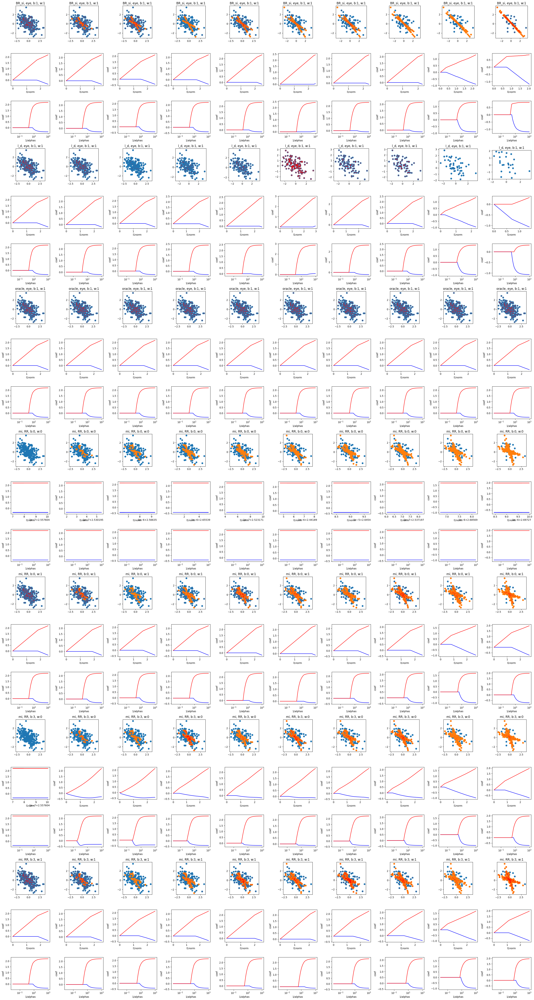

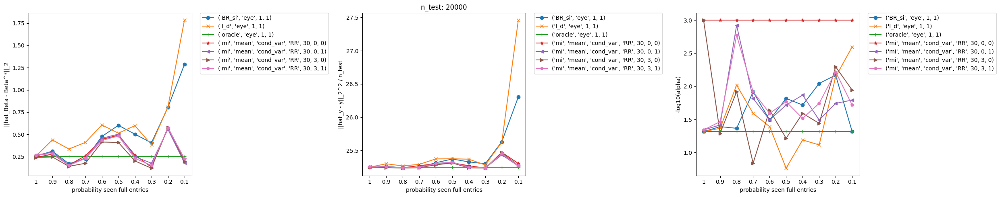

In [ ]:
np.random.seed(987654321)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [250] * length_vec
error_vec =  [5] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)




change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
n_tot :  20100
n_train :  100
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9950248756218906
err :  {'type': 'Gaussian_on_y', 'scaling': 1}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR

100%|██████████| 200/200 [00:01<00:00, 177.86it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 180.89it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]

100%|██████████| 200/200 [00:01<00:00, 182.57it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  94.1293941960521
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [1.33226763e-15 1.88737914e-15]
final

100%|██████████| 200/200 [00:03<00:00, 60.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.013232013526026
---------------------------------> best coeff  [-0.5978504   1.95211408]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  94.1293941960521
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [1.33226763e-15 1.88737914e-15]
final S in cov strategy RR  [[1.0561488 0.       ]
 [0.        0.9672674]]
S within 
 [[1.0561488 0.       ]
 [

100%|██████████| 200/200 [00:04<00:00, 44.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  80  best 1/best_alpha  9.77124153534649 , min score  1.0240811431135952
---------------------------------> best coeff  [-0.51286724  1.83613211]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  94.1293941960521
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [1.33226763e-15 1.88737914e-15]
final S in cov strategy RR  [[1.0561488 0.       ]
 [0.        0.9672674]]
S within 
 [[1.0561488 0

100%|██████████| 200/200 [00:01<00:00, 122.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.013232013526026
---------------------------------> best coeff  [-0.5978504   1.95211408]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  94.1293941960521
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.0561488 0.9672674]
cov computed
s_between  [1.33226763e-15 1.88737914e-15]
final S in cov strategy RR  [[1.0561488 0.       ]
 [0.        0.9672674]]
S within 
 [[1.0561488 0.       ]
 [

100%|██████████| 200/200 [00:01<00:00, 105.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  80  best 1/best_alpha  9.77124153534649 , min score  1.0240811431135952
---------------------------------> best coeff  [-0.51286724  1.83613211]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -3.7832962574137703
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 181.61it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  1.0222556738206612
---------------------------------> best coeff  [-0.51820768  1.8428216 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -1.6926100755171287
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 193.69it/s]


------------------------> who is S in add_rectangles
 [[0.10234114 0.        ]
 [0.         0.10234114]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  80  best 1/best_alpha  9.77124153534649 , min score  1.0317134193472743
---------------------------------> best coeff  [-0.54910636  1.81572663]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 179.99it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -426.92713199638933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06673477 0.97864103]
cov computed
s_between  [0.01735928 0.01361789]
final S 

100%|██████████| 200/200 [00:01<00:00, 133.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.012008906148973
---------------------------------> best coeff  [-0.58716887  1.93952124]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -426.92713199638933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06673477 0.97864103]
cov computed
s_between  [0.01735928 0.01361789]
final S in cov strategy RR  [[1.08423872 0.        ]
 [0.         0.9923724 ]]
S within 
 [[1.08423872 0.        ]

100%|██████████| 200/200 [00:02<00:00, 81.77it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  1.0220746825693103
---------------------------------> best coeff  [-0.51368569  1.8432835 ]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -426.92713199638933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06673477 0.97864103]
cov computed
s_between  [0.01735928 0.01361789]
final S in cov strategy RR  [[1.08423872 0.        ]
 [0.         0.9923724 ]]
S within 
 [[1.084238

100%|██████████| 200/200 [00:01<00:00, 101.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  92  best 1/best_alpha  4.880251583654428 , min score  1.0229616703980156
---------------------------------> best coeff  [-0.50769142  1.84006415]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -426.92713199638933
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06673477 0.97864103]
cov computed
s_between  [0.01735928 0.01361789]
final S in cov strategy RR  [[1.08423872 0.        ]
 [0.         0.9923724 ]]
S within 
 [[1.0842387

100%|██████████| 200/200 [00:01<00:00, 105.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  1.0219200315540384
---------------------------------> best coeff  [-0.5130982   1.84383349]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -6.6383486239588745
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 182.27it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  1.0238894321656216
---------------------------------> best coeff  [-0.52229375  1.83726582]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -4.304243621644068
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (80, 2)
y_train length  8

100%|██████████| 200/200 [00:00<00:00, 209.17it/s]


------------------------> who is S in add_rectangles
 [[0.10234114 0.        ]
 [0.         0.10234114]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  80  best 1/best_alpha  9.77124153534649 , min score  1.0350595527611304
---------------------------------> best coeff  [-0.55278746  1.80644618]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 183.44it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -778.0322159127359
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07033871 0.97392935]
cov computed
s_between  [0.01920194 0.02081996]
final S i

100%|██████████| 200/200 [00:01<00:00, 131.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0152097532133066
---------------------------------> best coeff  [-0.60878226  1.95991825]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -778.0322159127359
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07033871 0.97392935]
cov computed
s_between  [0.01920194 0.02081996]
final S in cov strategy RR  [[1.08970067 0.        ]
 [0.         0.99492281]]
S within 
 [[1.08970067 0.        ]

100%|██████████| 200/200 [00:01<00:00, 102.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  1.0227725347910526
---------------------------------> best coeff  [-0.51339589  1.84075395]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -778.0322159127359
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07033871 0.97392935]
cov computed
s_between  [0.01920194 0.02081996]
final S in cov strategy RR  [[1.08970067 0.        ]
 [0.         0.99492281]]
S within 
 [[1.0897006

100%|██████████| 200/200 [00:02<00:00, 85.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  84  best 1/best_alpha  7.752597488629456 , min score  1.0251058382943823
---------------------------------> best coeff  [-0.54224717  1.83603068]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -778.0322159127359
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07033871 0.97392935]
cov computed
s_between  [0.01920194 0.02081996]
final S in cov strategy RR  [[1.08970067 0.        ]
 [0.         0.99492281]]
S within 
 [[1.08970067

100%|██████████| 200/200 [00:02<00:00, 93.78it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  1.0241231553975771
---------------------------------> best coeff  [-0.51881485  1.83620389]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -6.075756406503891
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 177.88it/s]


------------------------> who is S in add_rectangles
 [[0.05738442 0.        ]
 [0.         0.05738442]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  1.0193851210392881
---------------------------------> best coeff  [-0.49765392  1.85387349]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.5378107783792716
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (70, 2)
y_train length  70
-------> size test:  20000  , s

100%|██████████| 200/200 [00:00<00:00, 232.35it/s]


------------------------> who is S in add_rectangles
 [[0.1148951 0.       ]
 [0.        0.1148951]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  82  best 1/best_alpha  8.703591361485158 , min score  1.050203136369937
---------------------------------> best coeff  [-0.57093708  1.7703854 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape

100%|██████████| 200/200 [00:01<00:00, 181.28it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -640.1916436497997
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07533193 0.99631013]
cov computed
s_between  [0.02009962 0.03044143]
final S i

100%|██████████| 200/200 [00:02<00:00, 72.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0075977685048993
---------------------------------> best coeff  [-0.54432863  1.92731965]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -640.1916436497997
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07533193 0.99631013]
cov computed
s_between  [0.02009962 0.03044143]
final S in cov strategy RR  [[1.09559905 0.        ]
 [0.         1.02700525]]
S within 
 [[1.09559905 0.        ]

100%|██████████| 200/200 [00:02<00:00, 67.57it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  1.0179938749046786
---------------------------------> best coeff  [-0.48945949  1.8604046 ]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -640.1916436497997
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07533193 0.99631013]
cov computed
s_between  [0.02009962 0.03044143]
final S in cov strategy RR  [[1.09559905 0.        ]
 [0.         1.02700525]]
S within 
 [[1.09559905

100%|██████████| 200/200 [00:02<00:00, 83.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  1.0182005528097438
---------------------------------> best coeff  [-0.50506869  1.85815039]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -640.1916436497997
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.07533193 0.99631013]
cov computed
s_between  [0.02009962 0.03044143]
final S in cov strategy RR  [[1.09559905 0.        ]
 [0.         1.02700525]]
S within 
 [[1.09559905

100%|██████████| 200/200 [00:04<00:00, 44.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  55  best 1/best_alpha  41.504047578504746 , min score  1.0186364305667137
---------------------------------> best coeff  [-0.49444722  1.85714848]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -1.725914571634827
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within

100%|██████████| 200/200 [00:01<00:00, 125.13it/s]


------------------------> who is S in add_rectangles
 [[0.07663411 0.        ]
 [0.         0.07663411]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  1.0179224877297832
---------------------------------> best coeff  [-0.49029191  1.86057112]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.5967064044273425
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:01<00:00, 160.96it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.03665040431167
---------------------------------> best coeff  [-0.68124841  1.94699655]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
sh

100%|██████████| 200/200 [00:01<00:00, 105.06it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -225.0281480895104
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08506765 0.9904209 ]
cov computed
s_between  [0.02708629 0.03245523]
final S i

100%|██████████| 200/200 [00:01<00:00, 117.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0079808800057584
---------------------------------> best coeff  [-0.56815473  1.99644709]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -225.0281480895104
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08506765 0.9904209 ]
cov computed
s_between  [0.02708629 0.03245523]
final S in cov strategy RR  [[1.11237966 0.        ]
 [0.         1.02314659]]
S within 
 [[1.11237966 0.        ]

100%|██████████| 200/200 [00:01<00:00, 105.09it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  1.0160247919850707
---------------------------------> best coeff  [-0.46451514  1.87542108]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -225.0281480895104
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08506765 0.9904209 ]
cov computed
s_between  [0.02708629 0.03245523]
final S in cov strategy RR  [[1.11237966 0.        ]
 [0.         1.02314659]]
S within 
 [[1.1123796

100%|██████████| 200/200 [00:01<00:00, 125.31it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  1.0155538501128212
---------------------------------> best coeff  [-0.49841995  1.86972177]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -225.0281480895104
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08506765 0.9904209 ]
cov computed
s_between  [0.02708629 0.03245523]
final S in cov strategy RR  [[1.11237966 0.        ]
 [0.         1.02314659]]
S within 
 [[1.1123796

100%|██████████| 200/200 [00:01<00:00, 102.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  1.0154589668502925
---------------------------------> best coeff  [-0.47823613  1.87356518]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -8.78422798256831
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 177.28it/s]


------------------------> who is S in add_rectangles
 [[0.04055461 0.        ]
 [0.         0.04055461]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  1.028863318853798
---------------------------------> best coeff  [-0.65976083  1.96913262]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -1.6449267746411445
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  50 

100%|██████████| 200/200 [00:00<00:00, 283.68it/s]


------------------------> who is S in add_rectangles
 [[0.04824109 0.        ]
 [0.         0.04824109]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  67  best 1/best_alpha  20.72921779595371 , min score  1.0408732433035457
---------------------------------> best coeff  [-0.69190326  1.94098014]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 138.92it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -861.4389390852784
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06765878 1.00129825]
cov computed
s_between  [0.03422515 0.03655649]
final S i

100%|██████████| 200/200 [00:01<00:00, 133.83it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0110321854936126
---------------------------------> best coeff  [-0.58292196  2.00992451]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -861.4389390852784
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06765878 1.00129825]
cov computed
s_between  [0.03422515 0.03655649]
final S in cov strategy RR  [[1.10216914 0.        ]
 [0.         1.03815938]]
S within 
 [[1.10216914 0.        ]

100%|██████████| 200/200 [00:02<00:00, 67.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  74  best 1/best_alpha  13.826221737646557 , min score  1.0156975778870942
---------------------------------> best coeff  [-0.47116382  1.87455108]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -861.4389390852784
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06765878 1.00129825]
cov computed
s_between  [0.03422515 0.03655649]
final S in cov strategy RR  [[1.10216914 0.        ]
 [0.         1.03815938]]
S within 
 [[1.1021691

100%|██████████| 200/200 [00:01<00:00, 124.43it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  1.0174366023227304
---------------------------------> best coeff  [-0.50191262  1.86141124]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -861.4389390852784
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06765878 1.00129825]
cov computed
s_between  [0.03422515 0.03655649]
final S in cov strategy RR  [[1.10216914 0.        ]
 [0.         1.03815938]]
S within 
 [[1.1021691

100%|██████████| 200/200 [00:01<00:00, 104.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  1.0175110167688615
---------------------------------> best coeff  [-0.48747504  1.86271337]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -5.908209706502745
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 179.99it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  1.032720577635384
---------------------------------> best coeff  [-0.67083691  1.9552994 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.5860083850775002
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matri

100%|██████████| 200/200 [00:00<00:00, 307.34it/s]


------------------------> who is S in add_rectangles
 [[0.1084366 0.       ]
 [0.        0.1084366]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  81  best 1/best_alpha  9.221978823334322 , min score  1.0388731083870102
---------------------------------> best coeff  [-0.6846544   1.92959668]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shap

100%|██████████| 200/200 [00:01<00:00, 179.51it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -643.3920858736383
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06884796 1.0041566 ]
cov computed
s_between  [0.03696063 0.03761965]
final S i

100%|██████████| 200/200 [00:02<00:00, 99.91it/s] 


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.007550293089736
---------------------------------> best coeff  [-0.56717727  1.97183098]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -643.3920858736383
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06884796 1.0041566 ]
cov computed
s_between  [0.03696063 0.03761965]
final S in cov strategy RR  [[1.1061166  0.        ]
 [0.         1.04208974]]
S within 
 [[1.1061166  0.        ]


100%|██████████| 200/200 [00:01<00:00, 103.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  1.0170593789795555
---------------------------------> best coeff  [-0.47941815  1.86626256]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -643.3920858736383
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06884796 1.0041566 ]
cov computed
s_between  [0.03696063 0.03761965]
final S in cov strategy RR  [[1.1061166  0.        ]
 [0.         1.04208974]]
S within 
 [[1.1061166  

100%|██████████| 200/200 [00:01<00:00, 121.72it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  1.0177262844426298
---------------------------------> best coeff  [-0.51139763  1.86008224]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -643.3920858736383
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.06884796 1.0041566 ]
cov computed
s_between  [0.03696063 0.03761965]
final S in cov strategy RR  [[1.1061166  0.        ]
 [0.         1.04208974]]
S within 
 [[1.1061166 

100%|██████████| 200/200 [00:01<00:00, 102.99it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  1.017599493196462
---------------------------------> best coeff  [-0.50001352  1.8608512 ]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -3.463162670080039
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 182.68it/s]


------------------------> who is S in add_rectangles
 [[0.08603464 0.        ]
 [0.         0.08603464]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  77  best 1/best_alpha  11.623224686798524 , min score  1.073608502053544
---------------------------------> best coeff  [-0.74864616  1.86905929]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  1.9701698701282395
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 352.40it/s]


------------------------> who is S in add_rectangles
 [[0.05415871 0.        ]
 [0.         0.05415871]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  1.04574143827524
---------------------------------> best coeff  [-0.69960421  1.91545337]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
s

100%|██████████| 200/200 [00:01<00:00, 177.27it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -204.096193964428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08430536 1.04096676]
cov computed
s_between  [0.03549638 0.04306303]
final S in

100%|██████████| 200/200 [00:01<00:00, 131.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0305719598455725
---------------------------------> best coeff  [-0.61979534  2.08836433]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -204.096193964428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08430536 1.04096676]
cov computed
s_between  [0.03549638 0.04306303]
final S in cov strategy RR  [[1.12009755 0.        ]
 [0.         1.08438865]]
S within 
 [[1.12009755 0.        ]


100%|██████████| 200/200 [00:02<00:00, 75.42it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  75  best 1/best_alpha  13.049019780144022 , min score  1.013322912865539
---------------------------------> best coeff  [-0.45171764  1.89481409]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -204.096193964428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08430536 1.04096676]
cov computed
s_between  [0.03549638 0.04306303]
final S in cov strategy RR  [[1.12009755 0.        ]
 [0.         1.08438865]]
S within 
 [[1.12009755 

100%|██████████| 200/200 [00:01<00:00, 104.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.0157572534896016
---------------------------------> best coeff  [-0.59147908  2.04193295]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -204.096193964428
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08430536 1.04096676]
cov computed
s_between  [0.03549638 0.04306303]
final S in cov strategy RR  [[1.12009755 0.        ]
 [0.         1.08438865]]
S within 
 [[1.12009755 

100%|██████████| 200/200 [00:01<00:00, 103.97it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  62  best 1/best_alpha  27.68286630392065 , min score  1.0142074674009491
---------------------------------> best coeff  [-0.47647386  1.87985783]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.6502907944359198
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 

100%|██████████| 200/200 [00:01<00:00, 174.48it/s]


------------------------> who is S in add_rectangles
 [[0.09658832 0.        ]
 [0.         0.09658832]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  1.0952638787091367
---------------------------------> best coeff  [-0.62934892  1.69513991]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  5.905774078394228
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 386.00it/s]


------------------------> who is S in add_rectangles
 [[0.04297005 0.        ]
 [0.         0.04297005]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  65  best 1/best_alpha  23.27202478960408 , min score  1.0692792154954824
---------------------------------> best coeff  [-0.74862761  1.89736417]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 177.75it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  571.8420875982799
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08806275 1.03147114]
cov computed
s_between  [0.04304033 0.04817971]
final S in

100%|██████████| 200/200 [00:01<00:00, 134.81it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0041310909731762
---------------------------------> best coeff  [-0.46568777  2.01136789]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  571.8420875982799
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08806275 1.03147114]
cov computed
s_between  [0.04304033 0.04817971]
final S in cov strategy RR  [[1.13146174 0.        ]
 [0.         1.08005235]]
S within 
 [[1.13146174 0.        ]


100%|██████████| 200/200 [00:01<00:00, 103.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  59  best 1/best_alpha  32.929712550971495 , min score  1.0144992547028164
---------------------------------> best coeff  [-0.40377571  1.93531527]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  571.8420875982799
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08806275 1.03147114]
cov computed
s_between  [0.04304033 0.04817971]
final S in cov strategy RR  [[1.13146174 0.        ]
 [0.         1.08005235]]
S within 
 [[1.13146174

100%|██████████| 200/200 [00:01<00:00, 103.39it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.0154738263564076
---------------------------------> best coeff  [-0.4110871   1.91731787]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  571.8420875982799
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.08806275 1.03147114]
cov computed
s_between  [0.04304033 0.04817971]
final S in cov strategy RR  [[1.13146174 0.        ]
 [0.         1.08005235]]
S within 
 [[1.13146174 

100%|██████████| 200/200 [00:02<00:00, 76.06it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  44  best 1/best_alpha  78.42822061337678 , min score  1.014698334082389
---------------------------------> best coeff  [-0.40770864  1.92746616]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.1],
       [-0.1,  1. ]])}
(20100, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -4.699507576927374
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 


100%|██████████| 200/200 [00:01<00:00, 177.60it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.114305307045858
---------------------------------> best coeff  [-0.81664408  1.85085863]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.8851131390289394
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 430.98it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.1336837964809048
---------------------------------> best coeff  [-0.71045642  1.66854158]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  0.7844116183004348
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]


100%|██████████| 200/200 [00:01<00:00, 178.29it/s]


------------------------> who is S in add_rectangles
 [[0.09115888 0.        ]
 [0.         0.09115888]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.0226202846944943
---------------------------------> best coeff  [-0.52653264  1.84224245]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -411.89808454056134
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0814246  1.05024271]
cov computed
s_between  [0.04512845 0.05350249]
final S 

100%|██████████| 200/200 [00:01<00:00, 128.25it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0249612921613367
---------------------------------> best coeff  [-0.34843498  1.97466916]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -411.89808454056134
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0814246  1.05024271]
cov computed
s_between  [0.04512845 0.05350249]
final S in cov strategy RR  [[1.12692911 0.        ]
 [0.         1.10419105]]
S within 
 [[1.12692911 0.        

100%|██████████| 200/200 [00:01<00:00, 102.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  44  best 1/best_alpha  78.42822061337678 , min score  1.0361825345425544
---------------------------------> best coeff  [-0.32252243  1.9412    ]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -411.89808454056134
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0814246  1.05024271]
cov computed
s_between  [0.04512845 0.05350249]
final S in cov strategy RR  [[1.12692911 0.        ]
 [0.         1.10419105]]
S within 
 [[1.1269291

100%|██████████| 200/200 [00:01<00:00, 117.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  1.0363797998813762
---------------------------------> best coeff  [-0.32712833  1.92726774]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.0561488 0.9672674]
crush test------------------------------------------------->  -411.89808454056134
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.0814246  1.05024271]
cov computed
s_between  [0.04512845 0.05350249]
final S in cov strategy RR  [[1.12692911 0.        ]
 [0.         1.10419105]]
S within 
 [[1.1269291

100%|██████████| 200/200 [00:01<00:00, 103.14it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  31  best 1/best_alpha  166.38168860761292 , min score  1.037051477759275
---------------------------------> best coeff  [-0.32345612  1.9317166 ]
mi
mean
cond_var
RR
120
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.52653264,  1.84224245]), array([-0.51820768,  1.8428216 ]), array([-0.52229375,  1.83726582]), array([-0.49765392,  1.85387349]), array([-0.49029191,  1.86057112]), array([-0.65976083,  1.96913262]), array([-0.67083691,  1.9552994 ]), array([-0.74864616,  1.86905929]), array([-0.62934892,  1.69513991]), array([-0.81664408,  1.85085863])], 'l2_dist_best_coeff_gt': [np.float64(0.15997320211322633), np.float64(0.15822948524561345), np.float64(0.1642541472924482), np.float64(0.14614533779823913), np.float64(0.13976644591617507), np.float64(0.1627154510425382), np.float64(0.17658820741

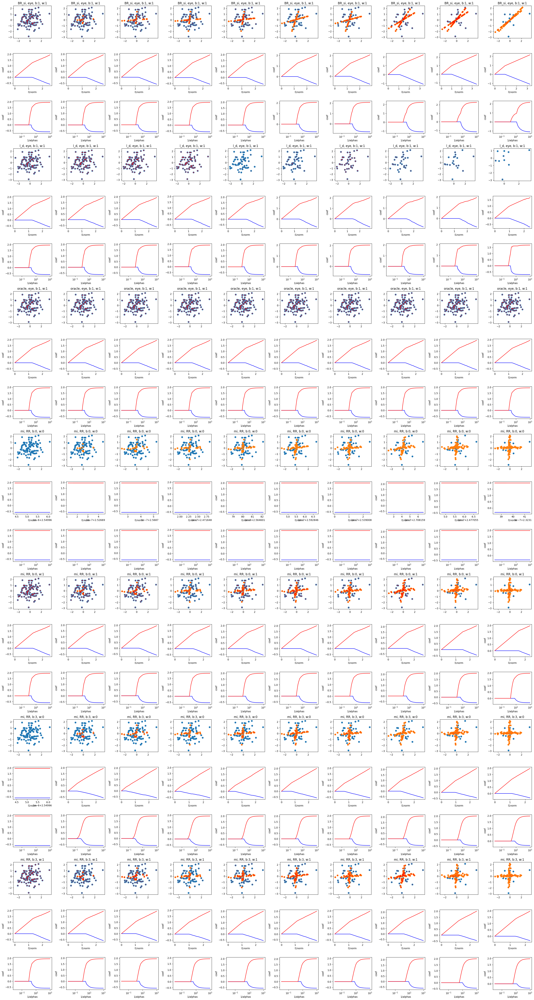

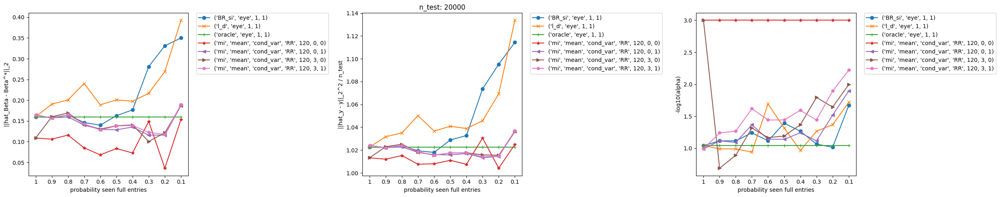

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [100] * length_vec
error_vec =  [1] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.1], [-0.1, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 30
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with':1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)



## you can see if you manage to take the index i that maximize alpha



In [ ]:
## Setting as before, n=100, 120 sample from mi, error = 1 (mild)
## the best method is the one where S = 0

change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20050
n_train :  50
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9975062344139651
err :  {'type': 'Gaussian_on_y', 'scaling': 1}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 

100%|██████████| 200/200 [00:00<00:00, 272.17it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  5

100%|██████████| 200/200 [00:00<00:00, 273.53it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 270.17it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.7188096537322286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.19942643 0.98824822]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.19942643 0.        ]
 [0.         0.98824822]]
S within 
 [[1.19942643

100%|██████████| 200/200 [00:00<00:00, 220.84it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0729721802641312
---------------------------------> best coeff  [-0.55168204  1.72244036]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.7188096537322286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.19942643 0.98824822]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.19942643 0.        ]
 [0.         0.98824822]]
S within 
 [[1.19942643 0.        ]
 [0.         0.98824822]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  5

100%|██████████| 200/200 [00:01<00:00, 183.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083486817869556
---------------------------------> best coeff  [-0.54686383  1.70416257]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.7188096537322286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.19942643 0.98824822]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.19942643 0.        ]
 [0.         0.98824822]]
S within 
 [[1.19942643 0.        ]
 [0.         0.98824822]]
shape X_imputed in post_imputation  (10, 50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 221.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0729721802641312
---------------------------------> best coeff  [-0.55168204  1.72244036]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.7188096537322286
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [1.19942643 0.98824822]
cov computed
s_between  [2.22044605e-16 0.00000000e+00]
final S in cov strategy RR  [[1.19942643 0.        ]
 [0.         0.98824822]]
S within 
 [[1.19942643 0.        ]
 [0.         0.98824822]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  5

100%|██████████| 200/200 [00:01<00:00, 182.68it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083486817869556
---------------------------------> best coeff  [-0.54686383  1.70416257]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  1.9186419648232398
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 221.61it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.1067556809800954
---------------------------------> best coeff  [-0.54028607  1.66701986]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  1.8133848121561966
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (45, 2)
y_train length  45
-------> size test:  20000  , size train:  45 nbr_seen (train):  45  nbr_miss :  0
X  45 2
Shape  (2, 2)

100%|██████████| 200/200 [00:01<00:00, 192.09it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.090383190559263
---------------------------------> best coeff  [-0.60441432  1.67622518]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:01<00:00, 187.14it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  21.434374941579165
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.21324269 0.97444412]
cov computed
s_between  [0.01456012 0.01447327]
final S in cov strategy RR  [[1.22925881 0.        ]
 [0.         0.99036472]]
S within 
 [[1.22925881 0.      

100%|██████████| 200/200 [00:00<00:00, 215.94it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0755384819964975
---------------------------------> best coeff  [-0.52634281  1.72657947]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  21.434374941579165
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.21324269 0.97444412]
cov computed
s_between  [0.01456012 0.01447327]
final S in cov strategy RR  [[1.22925881 0.        ]
 [0.         0.99036472]]
S within 
 [[1.22925881 0.        ]
 [0.         0.99036472]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 180.29it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0861072584891274
---------------------------------> best coeff  [-0.5226477   1.70866934]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  21.434374941579165
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.21324269 0.97444412]
cov computed
s_between  [0.01456012 0.01447327]
final S in cov strategy RR  [[1.22925881 0.        ]
 [0.         0.99036472]]
S within 
 [[1.22925881 0.        ]
 [0.         0.99036472]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length

100%|██████████| 200/200 [00:00<00:00, 205.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  72  best 1/best_alpha  15.522253574270474 , min score  1.0858233209897912
---------------------------------> best coeff  [-0.51863655  1.71085665]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  21.434374941579165
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 1 1 1 1 1]
s_within  [1.21324269 0.97444412]
cov computed
s_between  [0.01456012 0.01447327]
final S in cov strategy RR  [[1.22925881 0.        ]
 [0.         0.99036472]]
S within 
 [[1.22925881 0.        ]
 [0.         0.99036472]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 183.79it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.0866530146458087
---------------------------------> best coeff  [-0.52133709  1.70824863]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  0.7729798412915629
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 268.50it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.092061796512981
---------------------------------> best coeff  [-0.55408557  1.68647046]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  3.0582584091673866
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (40, 2)
y_train length  40
-------> size test:  20000  , size train:  40 nbr_seen (train):  40  nbr_miss :  0
X  40 2
Shape  (2, 2)
nm  80
one matr

100%|██████████| 200/200 [00:00<00:00, 302.74it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0823674078850432
---------------------------------> best coeff  [-0.58279431  1.69569661]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 278.07it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  13.892123795020407
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.23236237 1.00002009]
cov computed
s_between  [0.0252942  0.04830537]
final S in cov strategy RR  [[1.260186   0.        ]
 [0.         1.05315599]]
S within 
 [[1.260186   0.      

100%|██████████| 200/200 [00:00<00:00, 210.87it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.1270928108925573
---------------------------------> best coeff  [-0.5744514   1.62406984]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  13.892123795020407
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.23236237 1.00002009]
cov computed
s_between  [0.0252942  0.04830537]
final S in cov strategy RR  [[1.260186   0.        ]
 [0.         1.05315599]]
S within 
 [[1.260186   0.        ]
 [0.         1.05315599]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 176.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.1385593847539566
---------------------------------> best coeff  [-0.57034208  1.6089083 ]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  13.892123795020407
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.23236237 1.00002009]
cov computed
s_between  [0.0252942  0.04830537]
final S in cov strategy RR  [[1.260186   0.        ]
 [0.         1.05315599]]
S within 
 [[1.260186   0.        ]
 [0.         1.05315599]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length

100%|██████████| 200/200 [00:00<00:00, 202.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.138172614704225
---------------------------------> best coeff  [-0.58118288  1.60599329]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  13.892123795020407
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 1 1 1 1 1 1 1 1]
s_within  [1.23236237 1.00002009]
cov computed
s_between  [0.0252942  0.04830537]
final S in cov strategy RR  [[1.260186   0.        ]
 [0.         1.05315599]]
S within 
 [[1.260186   0.        ]
 [0.         1.05315599]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 179.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.1392755409257644
---------------------------------> best coeff  [-0.57645184  1.60591871]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  1.7923864995503311
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 270.57it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  1.099909725327424
---------------------------------> best coeff  [-0.55806636  1.6718202 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  7.3079294641291614
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (35, 2)
y_train length  35
-------> size test:  20000  , size train:  35 nbr_seen (train):  35  nbr_miss :  0
X  35 2
Shape  (2, 2)
nm  70
one matrix in input, S.s

100%|██████████| 200/200 [00:00<00:00, 323.34it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.0604639177576471
---------------------------------> best coeff  [-0.54361392  1.75085095]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 284.56it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  24.754289880448756
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26481562 0.99672027]
cov computed
s_between  [0.05017705 0.03523817]
final S in cov strategy RR  [[1.32001038 0.        ]
 [0.         1.03548226]]
S within 
 [[1.32001038 0.      

100%|██████████| 200/200 [00:01<00:00, 137.56it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.2045308956949956
---------------------------------> best coeff  [-0.70082799  1.49439239]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  24.754289880448756
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26481562 0.99672027]
cov computed
s_between  [0.05017705 0.03523817]
final S in cov strategy RR  [[1.32001038 0.        ]
 [0.         1.03548226]]
S within 
 [[1.32001038 0.        ]
 [0.         1.03548226]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 151.25it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.2151770216480084
---------------------------------> best coeff  [-0.68982154  1.48289391]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  24.754289880448756
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26481562 0.99672027]
cov computed
s_between  [0.05017705 0.03523817]
final S in cov strategy RR  [[1.32001038 0.        ]
 [0.         1.03548226]]
S within 
 [[1.32001038 0.        ]
 [0.         1.03548226]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 199.69it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  1.2159245404777295
---------------------------------> best coeff  [-0.70783552  1.47974361]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  24.754289880448756
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26481562 0.99672027]
cov computed
s_between  [0.05017705 0.03523817]
final S in cov strategy RR  [[1.32001038 0.        ]
 [0.         1.03548226]]
S within 
 [[1.32001038 0.        ]
 [0.         1.03548226]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 179.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  1.2169249207818396
---------------------------------> best coeff  [-0.7020312   1.47920185]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -3.1635877906339687
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tr

100%|██████████| 200/200 [00:00<00:00, 273.91it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.1193665342979806
---------------------------------> best coeff  [-0.49730589  1.66627248]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.7389160407892088
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n

100%|██████████| 200/200 [00:00<00:00, 344.63it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.158685616102525
---------------------------------> best coeff  [-0.4493449   1.63752875]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 271.67it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -70.26325956009842
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26841519 1.01688654]
cov computed
s_between  [0.04412406 0.04037471]
final S in cov strategy RR  [[1.31695166 0.        ]
 [0.         1.06129873]]
S within 
 [[1.31695166 0.      

100%|██████████| 200/200 [00:00<00:00, 213.21it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0858333972943544
---------------------------------> best coeff  [-0.62429652  1.68176889]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -70.26325956009842
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26841519 1.01688654]
cov computed
s_between  [0.04412406 0.04037471]
final S in cov strategy RR  [[1.31695166 0.        ]
 [0.         1.06129873]]
S within 
 [[1.31695166 0.        ]
 [0.         1.06129873]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 157.01it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.0968946122392218
---------------------------------> best coeff  [-0.61921988  1.66194198]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -70.26325956009842
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26841519 1.01688654]
cov computed
s_between  [0.04412406 0.04037471]
final S in cov strategy RR  [[1.31695166 0.        ]
 [0.         1.06129873]]
S within 
 [[1.31695166 0.        ]
 [0.         1.06129873]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 130.15it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.0971144301074782
---------------------------------> best coeff  [-0.63685354  1.65928904]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -70.26325956009842
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26841519 1.01688654]
cov computed
s_between  [0.04412406 0.04037471]
final S in cov strategy RR  [[1.31695166 0.        ]
 [0.         1.06129873]]
S within 
 [[1.31695166 0.        ]
 [0.         1.06129873]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length 

100%|██████████| 200/200 [00:01<00:00, 149.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.0975223591640824
---------------------------------> best coeff  [-0.62823894  1.65953695]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -5.8926011861561
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 265.90it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.186634016852564
---------------------------------> best coeff  [-0.34502294  1.67275786]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -1.5809313168712282
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (25, 2)
y_train length  25
-------> size test:  20000  , size train:  25 nbr_seen (train):  25  nbr_miss :  0
X  25 2
Shape  (2, 2)
nm  50
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 365.61it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0971882169469707
---------------------------------> best coeff  [-0.38972974  1.76771303]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 278.95it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -83.24351608547022
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27950754 1.02732057]
cov computed
s_between  [0.07362415 0.06371578]
final S in cov strategy RR  [[1.36049411 0.        ]
 [0.         1.09740793]]
S within 
 [[1.36049411 0.      

100%|██████████| 200/200 [00:00<00:00, 212.30it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.1171545529209772
---------------------------------> best coeff  [-0.64480296  1.62385315]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -83.24351608547022
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27950754 1.02732057]
cov computed
s_between  [0.07362415 0.06371578]
final S in cov strategy RR  [[1.36049411 0.        ]
 [0.         1.09740793]]
S within 
 [[1.36049411 0.        ]
 [0.         1.09740793]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
-------

100%|██████████| 200/200 [00:01<00:00, 176.64it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.1282300862699497
---------------------------------> best coeff  [-0.63378994  1.60792462]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -83.24351608547022
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27950754 1.02732057]
cov computed
s_between  [0.07362415 0.06371578]
final S in cov strategy RR  [[1.36049411 0.        ]
 [0.         1.09740793]]
S within 
 [[1.36049411 0.        ]
 [0.         1.09740793]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 199.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.1283917146170426
---------------------------------> best coeff  [-0.65398941  1.60478609]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -83.24351608547022
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27950754 1.02732057]
cov computed
s_between  [0.07362415 0.06371578]
final S in cov strategy RR  [[1.36049411 0.        ]
 [0.         1.09740793]]
S within 
 [[1.36049411 0.        ]
 [0.         1.09740793]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 156.75it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  32  best 1/best_alpha  157.02901247293775 , min score  1.129402093101266
---------------------------------> best coeff  [-0.64697904  1.60409899]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -11.511188232574556
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:01<00:00, 180.61it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.2078501716831551
---------------------------------> best coeff  [-0.17147542  1.81147695]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -3.58371225216066
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (20, 2)
y_train length  20
-------> size test:  20000  , size train:  20 nbr_seen (train):  20  nbr_miss :  0
X  20 2
Shape  (2, 2)
nm  40
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 243.55it/s]


------------------------> who is S in add_rectangles
 [[0.03217642 0.        ]
 [0.         0.03217642]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  60  best 1/best_alpha  31.078661877820124 , min score  1.0539650622719954
---------------------------------> best coeff  [-0.25897254  2.03051191]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X

100%|██████████| 200/200 [00:00<00:00, 267.57it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -136.55708322920722
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29142768 0.96407131]
cov computed
s_between  [0.07323672 0.05425635]
final S in cov strategy RR  [[1.37198807 0.        ]
 [0.         1.02375329]]
S within 
 [[1.37198807 0.     

100%|██████████| 200/200 [00:00<00:00, 211.33it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0876714041133368
---------------------------------> best coeff  [-0.72702786  1.68831204]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -136.55708322920722
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29142768 0.96407131]
cov computed
s_between  [0.07323672 0.05425635]
final S in cov strategy RR  [[1.37198807 0.        ]
 [0.         1.02375329]]
S within 
 [[1.37198807 0.        ]
 [0.         1.02375329]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 178.77it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  69  best 1/best_alpha  18.464249428955437 , min score  1.098683958366025
---------------------------------> best coeff  [-0.67991573  1.65520171]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -136.55708322920722
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29142768 0.96407131]
cov computed
s_between  [0.07323672 0.05425635]
final S in cov strategy RR  [[1.37198807 0.        ]
 [0.         1.02375329]]
S within 
 [[1.37198807 0.        ]
 [0.         1.02375329]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 198.77it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0985276493883187
---------------------------------> best coeff  [-0.73307928  1.66484949]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -136.55708322920722
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.29142768 0.96407131]
cov computed
s_between  [0.07323672 0.05425635]
final S in cov strategy RR  [[1.37198807 0.        ]
 [0.         1.02375329]]
S within 
 [[1.37198807 0.        ]
 [0.         1.02375329]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 178.74it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.098439744597894
---------------------------------> best coeff  [-0.71920435  1.66119805]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -1.222325396408152
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train

100%|██████████| 200/200 [00:00<00:00, 269.83it/s]


------------------------> who is S in add_rectangles
 [[0.04552935 0.        ]
 [0.         0.04552935]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  66  best 1/best_alpha  21.96385372416546 , min score  1.5208241568532295
---------------------------------> best coeff  [5.32186658e-11 1.67130866e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  0.721728734823136
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (15, 2)
y_train length  15
-------> size test:  20000  , size train:  15 nbr_seen (train):  15  nbr_miss :  0
X  15 2
Shape  (2, 2)
nm  30
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 398.58it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.0872164808814058
---------------------------------> best coeff  [-0.20811977  2.00055137]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X 

100%|██████████| 200/200 [00:00<00:00, 256.73it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -18.423584461980518
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27059303 1.06892812]
cov computed
s_between  [0.05318248 0.05953493]
final S in cov strategy RR  [[1.32909376 0.        ]
 [0.         1.13441654]]
S within 
 [[1.32909376 0.     

100%|██████████| 200/200 [00:00<00:00, 216.56it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.1362499955943166
---------------------------------> best coeff  [-0.63434187  1.59575212]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -18.423584461980518
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27059303 1.06892812]
cov computed
s_between  [0.05318248 0.05953493]
final S in cov strategy RR  [[1.32909376 0.        ]
 [0.         1.13441654]]
S within 
 [[1.32909376 0.        ]
 [0.         1.13441654]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 178.76it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.147201957821236
---------------------------------> best coeff  [-0.6177722   1.58344257]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -18.423584461980518
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27059303 1.06892812]
cov computed
s_between  [0.05318248 0.05953493]
final S in cov strategy RR  [[1.32909376 0.        ]
 [0.         1.13441654]]
S within 
 [[1.32909376 0.        ]
 [0.         1.13441654]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length

100%|██████████| 200/200 [00:01<00:00, 194.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  38  best 1/best_alpha  110.97524964120723 , min score  1.1479628807548303
---------------------------------> best coeff  [-0.64046074  1.57768556]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -18.423584461980518
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.27059303 1.06892812]
cov computed
s_between  [0.05318248 0.05953493]
final S in cov strategy RR  [[1.32909376 0.        ]
 [0.         1.13441654]]
S within 
 [[1.32909376 0.        ]
 [0.         1.13441654]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train leng

100%|██████████| 200/200 [00:01<00:00, 176.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  1.148081176130808
---------------------------------> best coeff  [-0.63403911  1.57872495]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -7.173668837897701
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_trai

100%|██████████| 200/200 [00:00<00:00, 266.12it/s]


------------------------> who is S in add_rectangles
 [[0.04055461 0.        ]
 [0.         0.04055461]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  1.520788261961287
---------------------------------> best coeff  [3.33571811e-10 1.67134002e+00]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.859055186145371
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (10, 2)
y_train length  10
-------> size test:  20000  , size train:  10 nbr_seen (train):  10  nbr_miss :  0
X  10 2
Shape  (2, 2)
nm  20
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 437.59it/s]


------------------------> who is S in add_rectangles
 [[0.01702769 0.        ]
 [0.         0.01702769]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.1607855089898462
---------------------------------> best coeff  [-0.08378885  2.03464831]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X  

100%|██████████| 200/200 [00:00<00:00, 265.61it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -163.30883654166763
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31111701 1.02379326]
cov computed
s_between  [0.08207554 0.03870778]
final S in cov strategy RR  [[1.4014001  0.        ]
 [0.         1.06637182]]
S within 
 [[1.4014001  0.     

100%|██████████| 200/200 [00:01<00:00, 143.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.2203237749041067
---------------------------------> best coeff  [-0.80818437  1.4753005 ]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -163.30883654166763
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31111701 1.02379326]
cov computed
s_between  [0.08207554 0.03870778]
final S in cov strategy RR  [[1.4014001  0.        ]
 [0.         1.06637182]]
S within 
 [[1.4014001  0.        ]
 [0.         1.06637182]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 174.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.2313622597382987
---------------------------------> best coeff  [-0.7944869   1.45933221]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -163.30883654166763
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31111701 1.02379326]
cov computed
s_between  [0.08207554 0.03870778]
final S in cov strategy RR  [[1.4014001  0.        ]
 [0.         1.06637182]]
S within 
 [[1.4014001  0.        ]
 [0.         1.06637182]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 190.63it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  30  best 1/best_alpha  176.29141180959482 , min score  1.2326733918699082
---------------------------------> best coeff  [-0.81113113  1.45936496]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -163.30883654166763
[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.31111701 1.02379326]
cov computed
s_between  [0.08207554 0.03870778]
final S in cov strategy RR  [[1.4014001  0.        ]
 [0.         1.06637182]]
S within 
 [[1.4014001  0.        ]
 [0.         1.06637182]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train leng

100%|██████████| 200/200 [00:01<00:00, 178.40it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  26  best 1/best_alpha  222.19468609395236 , min score  1.2333574521048412
---------------------------------> best coeff  [-0.80649986  1.45793327]
mi
mean
cond_var
RR
10
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20050, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -13.63772213863034
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_tra

100%|██████████| 200/200 [00:00<00:00, 257.29it/s]


------------------------> who is S in add_rectangles
 [[0.12173827 0.        ]
 [0.         0.12173827]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  1.272040454561748
---------------------------------> best coeff  [-1.08406841  1.65206908]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.7051404115381275
[0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (5, 2)
y_train length  5
-------> size test:  20000  , size train:  5 nbr_seen (train):  5  nbr_miss :  0
X  5 2
Shape  (2, 2)
nm  10
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 496.11it/s]


------------------------> who is S in add_rectangles
 [[0.32550886 0.        ]
 [0.         0.32550886]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  100  best 1/best_alpha  3.072112998861756 , min score  1.0743275643847232
---------------------------------> best coeff  [-0.57458486  2.22953541]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -0.07188096537322308
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (50, 2)
y_train length  50
-------> size test:  20000  , size train:  50 nbr_seen (train):  50  nbr_miss :  0
X

100%|██████████| 200/200 [00:00<00:00, 271.44it/s]


------------------------> who is S in add_rectangles
 [[0.02273966 0.        ]
 [0.         0.02273966]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.083895712603928
---------------------------------> best coeff  [-0.55000433  1.70234507]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -141.06232780753248
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26375571 1.07876869]
cov computed
s_between  [0.08377964 0.07457184]
final S in cov strategy RR  [[1.35591331 0.        ]
 [0.         1.16079771]]
S within 
 [[1.35591331 0.     

100%|██████████| 200/200 [00:00<00:00, 212.36it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.9527740046773383
---------------------------------> best coeff  [-1.50372093  1.93725404]
mi
mean
cond_var
RR
10
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -141.06232780753248
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26375571 1.07876869]
cov computed
s_between  [0.08377964 0.07457184]
final S in cov strategy RR  [[1.35591331 0.        ]
 [0.         1.16079771]]
S within 
 [[1.35591331 0.        ]
 [0.         1.16079771]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train length  50
------

100%|██████████| 200/200 [00:01<00:00, 144.96it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  83  best 1/best_alpha  8.214343584919423 , min score  1.3950391843421268
---------------------------------> best coeff  [-1.19038812  1.50785025]
mi
mean
cond_var
RR
10
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -141.06232780753248
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26375571 1.07876869]
cov computed
s_between  [0.08377964 0.07457184]
final S in cov strategy RR  [[1.35591331 0.        ]
 [0.         1.16079771]]
S within 
 [[1.35591331 0.        ]
 [0.         1.16079771]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 126.45it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  1.472256842944717
---------------------------------> best coeff  [-1.2593702   1.46956954]
mi
mean
cond_var
RR
10
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 10, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [1.19942643 0.98824822]
crush test------------------------------------------------->  -141.06232780753248
[0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [1.26375571 1.07876869]
cov computed
s_between  [0.08377964 0.07457184]
final S in cov strategy RR  [[1.35591331 0.        ]
 [0.         1.16079771]]
S within 
 [[1.35591331 0.        ]
 [0.         1.16079771]]
shape X_imputed in post_imputation  (10, 50, 2)
y_train lengt

100%|██████████| 200/200 [00:01<00:00, 163.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  73  best 1/best_alpha  14.649713983072857 , min score  1.435262118729997
---------------------------------> best coeff  [-1.13509121  1.34182681]
mi
mean
cond_var
RR
10
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.55000433,  1.70234507]), array([-0.54028607,  1.66701986]), array([-0.55408557,  1.68647046]), array([-0.55806636,  1.6718202 ]), array([-0.49730589,  1.66627248]), array([-0.34502294,  1.67275786]), array([-0.17147542,  1.81147695]), array([5.32186658e-11, 1.67130866e+00]), array([3.33571811e-10, 1.67134002e+00]), array([-1.08406841,  1.65206908])], 'l2_dist_best_coeff_gt': [np.float64(0.30182592306482325), np.float64(0.33540831827390327), np.float64(0.3181603738120488), np.float64(0.33327718768056974), np.float64(0.33373839296028923), np.float64(0.362084671159558), np.float64(0.3

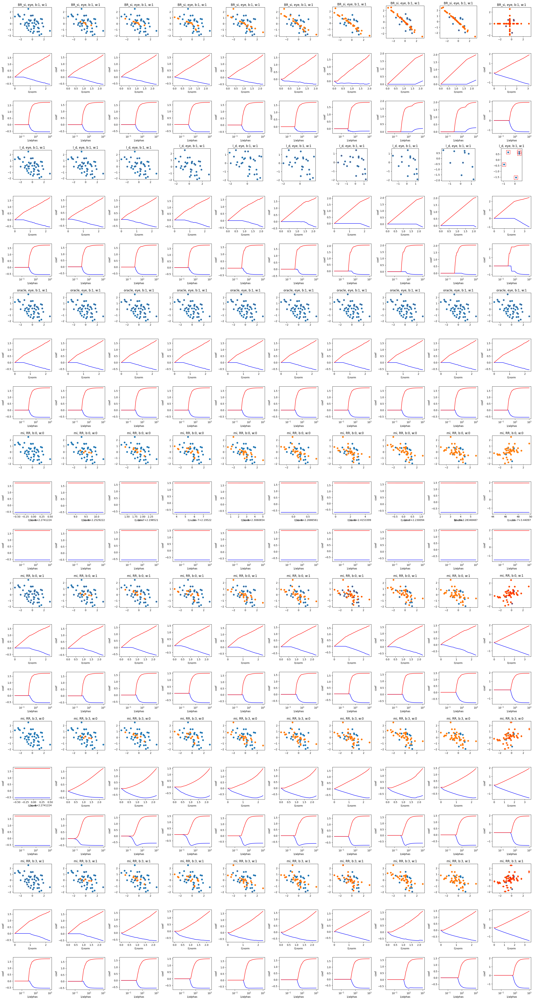

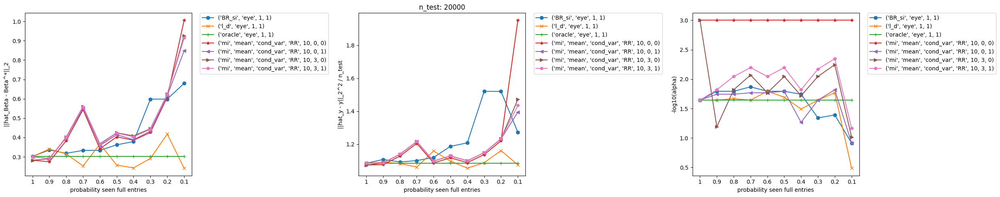

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [50] * length_vec
error_vec =  [1] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 10
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)



## you can see if you manage to take the index i that maximize alpha



change nbr_experiments to match the size of n_train
data :  {'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
n_tot :  20060
n_train :  60
n_test :  20000
dim :  2
beta_gt :  [-0.5  2. ]
perc_test :  0.9970089730807578
err :  {'type': 'Gaussian_on_y', 'scaling': 1}
p_miss :  [1, 0.0, 0.0]
generation :  f
[{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}, {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR'

100%|██████████| 200/200 [00:00<00:00, 250.30it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 252.55it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:00<00:00, 249.88it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1117.8778400861834
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.94109457 0.84902403]
cov computed
s_between  [2.33146835e-15 1.11022302e-16]
final S in cov strategy RR  [[0.94109457 0.        ]
 [0.         0.84902403]]
S 

100%|██████████| 200/200 [00:01<00:00, 175.91it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.040205670540095
---------------------------------> best coeff  [-0.35515268  1.93205461]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1117.8778400861834
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.94109457 0.84902403]
cov computed
s_between  [2.33146835e-15 1.11022302e-16]
final S in cov strategy RR  [[0.94109457 0.        ]
 [0.         0.84902403]]
S within 
 [[0.94109457 0.        ]
 [0.         0.84902403]]
shape X_imputed in post_imputation  (120, 60,

100%|██████████| 200/200 [00:01<00:00, 156.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0510118474292076
---------------------------------> best coeff  [-0.34252704  1.91249854]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1117.8778400861834
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.94109457 0.84902403]
cov computed
s_between  [2.33146835e-15 1.11022302e-16]
final S in cov strategy RR  [[0.94109457 0.        ]
 [0.         0.84902403]]
S within 
 [[0.94109457 0.        ]
 [0.         0.84902403]]
shape X_imputed in post_imputatio

100%|██████████| 200/200 [00:01<00:00, 179.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.040205670540095
---------------------------------> best coeff  [-0.35515268  1.93205461]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1117.8778400861834
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
s_within  [0.94109457 0.84902403]
cov computed
s_between  [2.33146835e-15 1.11022302e-16]
final S in cov strategy RR  [[0.94109457 0.        ]
 [0.         0.84902403]]
S within 
 [[0.94109457 0.        ]
 [0.         0.84902403]]
shape X_imputed in post_imputation  (120, 60,

100%|██████████| 200/200 [00:01<00:00, 152.73it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0510118474292076
---------------------------------> best coeff  [-0.34252704  1.91249854]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  1
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  6.569344790356322
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputat

100%|██████████| 200/200 [00:00<00:00, 248.23it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0456774720882074
---------------------------------> best coeff  [-0.3570244   1.91138336]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  5.631135503578418
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (54, 2)
y_train length  54
-------> size test:  20000  , size train:  54 nbr_seen (train):  54  nbr_miss

100%|██████████| 200/200 [00:00<00:00, 262.64it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0523664333962268
---------------------------------> best coeff  [-0.35277875  1.89633699]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:00<00:00, 252.04it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  773.6735260805947
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1]
s_within  [0.94499577 0.85002469]
cov computed
s_between  [0.01080098 0.01878174]
final S in cov strategy RR  [[0.95588676 0.        ]
 [0.         0.86896295]]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 198.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.035362076889151
---------------------------------> best coeff  [-0.3737001   1.92627893]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  773.6735260805947
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1]
s_within  [0.94499577 0.85002469]
cov computed
s_between  [0.01080098 0.01878174]
final S in cov strategy RR  [[0.95588676 0.        ]
 [0.         0.86896295]]
S within 
 [[0.95588676 0.        ]
 [0.         0.86896295]]
shape X_imputed in post_imputation  (120, 60, 2)
y_tra

100%|██████████| 200/200 [00:01<00:00, 158.23it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.046333999209148
---------------------------------> best coeff  [-0.36174207  1.90382297]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  773.6735260805947
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1]
s_within  [0.94499577 0.85002469]
cov computed
s_between  [0.01080098 0.01878174]
final S in cov strategy RR  [[0.95588676 0.        ]
 [0.         0.86896295]]
S within 
 [[0.95588676 0.        ]
 [0.         0.86896295]]
shape X_imputed in post_imputation  (120, 

100%|██████████| 200/200 [00:01<00:00, 182.06it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  79  best 1/best_alpha  10.353218432956622 , min score  1.0462461108020267
---------------------------------> best coeff  [-0.40784326  1.85757016]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  773.6735260805947
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1]
s_within  [0.94499577 0.85002469]
cov computed
s_between  [0.01080098 0.01878174]
final S in cov strategy RR  [[0.95588676 0.        ]
 [0.         0.86896295]]
S within 
 [[0.95588676 0.        ]
 [0.         0.86896295]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:01<00:00, 158.24it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0465701858680265
---------------------------------> best coeff  [-0.36865811  1.89533457]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  2
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  8.269702783679685
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 155.51it/s]


------------------------> who is S in add_rectangles
 [[0.01607053 0.        ]
 [0.         0.01607053]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  48  best 1/best_alpha  62.22570836730229 , min score  1.0495170757347678
---------------------------------> best coeff  [-0.36727021  1.88831037]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  7.648298290828264
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (48, 2)
y_train length  48
-------> size test:  20000  , size train:  48 nbr_seen (train):  48  nbr_miss :  0
X  48 2
Shape

100%|██████████| 200/200 [00:01<00:00, 175.17it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0817256813866143
---------------------------------> best coeff  [-0.28248788  1.90562636]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:00<00:00, 245.02it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  965.2406299036161
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95405615 0.84205655]
cov computed
s_between  [0.01972161 0.02550521]
final S in cov strategy RR  [[0.97394212 0.        ]
 [0.         0.8677743 ]]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 192.38it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0365723132667886
---------------------------------> best coeff  [-0.38799758  1.90565305]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  965.2406299036161
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95405615 0.84205655]
cov computed
s_between  [0.01972161 0.02550521]
final S in cov strategy RR  [[0.97394212 0.        ]
 [0.         0.8677743 ]]
S within 
 [[0.97394212 0.        ]
 [0.         0.8677743 ]]
shape X_imputed in post_imputation  (120, 60, 2)
y_tr

100%|██████████| 200/200 [00:01<00:00, 102.18it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  49  best 1/best_alpha  58.7278661318948 , min score  1.047353615597436
---------------------------------> best coeff  [-0.37754418  1.88357027]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  965.2406299036161
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95405615 0.84205655]
cov computed
s_between  [0.01972161 0.02550521]
final S in cov strategy RR  [[0.97394212 0.        ]
 [0.         0.8677743 ]]
S within 
 [[0.97394212 0.        ]
 [0.         0.8677743 ]]
shape X_imputed in post_imputation  (120, 6

100%|██████████| 200/200 [00:01<00:00, 151.49it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  68  best 1/best_alpha  19.563983435170638 , min score  1.0473041202810023
---------------------------------> best coeff  [-0.41084005  1.85214377]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  965.2406299036161
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.95405615 0.84205655]
cov computed
s_between  [0.01972161 0.02550521]
final S in cov strategy RR  [[0.97394212 0.        ]
 [0.         0.8677743 ]]
S within 
 [[0.97394212 0.        ]
 [0.         0.8677743 ]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:01<00:00, 151.66it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  1.047553456592116
---------------------------------> best coeff  [-0.38540197  1.87504035]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  3
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  8.59615796860881
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputatio

100%|██████████| 200/200 [00:00<00:00, 248.56it/s]


------------------------> who is S in add_rectangles
 [[0.02552908 0.        ]
 [0.         0.02552908]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  56  best 1/best_alpha  39.17101490809259 , min score  1.0311186392901115
---------------------------------> best coeff  [-0.36418988  1.95591701]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  6.215946353438772
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (42, 2)
y_train length  42
-------> size test:  20000  , size train:  42 nbr_seen (train):  42  nbr_miss :  0
X  42 2
Shape  (2, 2)
nm  84
on

100%|██████████| 200/200 [00:00<00:00, 291.70it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0639885356729892
---------------------------------> best coeff  [-0.27737236  1.96434154]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 249.08it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1037.452434460789
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93425173 0.80194083]
cov computed
s_between  [0.03064845 0.02311471]
final S in cov strategy RR  [[0.96515558 0.        ]
 [0.         0.82524816]]
S within 
 

100%|██████████| 200/200 [00:01<00:00, 116.47it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0205518260607085
---------------------------------> best coeff  [-0.37367079  2.0004726 ]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1037.452434460789
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93425173 0.80194083]
cov computed
s_between  [0.03064845 0.02311471]
final S in cov strategy RR  [[0.96515558 0.        ]
 [0.         0.82524816]]
S within 
 [[0.96515558 0.        ]
 [0.         0.82524816]]
shape X_imputed in post_imputation  (120, 60, 2)
y_tr

100%|██████████| 200/200 [00:02<00:00, 94.20it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  1.0309157011850658
---------------------------------> best coeff  [-0.35545093  1.9700655 ]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1037.452434460789
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93425173 0.80194083]
cov computed
s_between  [0.03064845 0.02311471]
final S in cov strategy RR  [[0.96515558 0.        ]
 [0.         0.82524816]]
S within 
 [[0.96515558 0.        ]
 [0.         0.82524816]]
shape X_imputed in post_imputation  (120,

100%|██████████| 200/200 [00:03<00:00, 54.71it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  1.0310920587283774
---------------------------------> best coeff  [-0.40131127  1.91048051]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1037.452434460789
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.93425173 0.80194083]
cov computed
s_between  [0.03064845 0.02311471]
final S in cov strategy RR  [[0.96515558 0.        ]
 [0.         0.82524816]]
S within 
 [[0.96515558 0.        ]
 [0.         0.82524816]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:02<00:00, 72.50it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  54  best 1/best_alpha  43.97603609302719 , min score  1.0316321804907356
---------------------------------> best coeff  [-0.36501156  1.95248085]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  4
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  11.895544996329797
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imput

100%|██████████| 200/200 [00:01<00:00, 122.67it/s]


------------------------> who is S in add_rectangles
 [[0.02025502 0.        ]
 [0.         0.02025502]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.0317689167000028
---------------------------------> best coeff  [-0.46754942  1.85226377]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  7.8558886750003065
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (36, 2)
y_train length  36
-------> size test:  20000  , size train:  36 nbr_seen (train):  36  nbr_miss :  0
X  36 2
Shape  (2, 2)
nm  72
one matrix in input

100%|██████████| 200/200 [00:01<00:00, 193.09it/s]


------------------------> who is S in add_rectangles
 [[0.01516717 0.        ]
 [0.         0.01516717]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  47  best 1/best_alpha  65.93188271333545 , min score  1.0849945918575818
---------------------------------> best coeff  [-0.46108773  1.73603735]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:01<00:00, 137.71it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1457.8767706332242
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94014272 0.82446027]
cov computed
s_between  [0.02988343 0.02768953]
final S in cov strategy RR  [[0.97027518 0.        ]
 [0.         0.85238054]]
S within 


100%|██████████| 200/200 [00:01<00:00, 194.41it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.014686388935221
---------------------------------> best coeff  [-0.48495099  1.90524325]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1457.8767706332242
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94014272 0.82446027]
cov computed
s_between  [0.02988343 0.02768953]
final S in cov strategy RR  [[0.97027518 0.        ]
 [0.         0.85238054]]
S within 
 [[0.97027518 0.        ]
 [0.         0.85238054]]
shape X_imputed in post_imputation  (120, 60, 2)
y_tr

100%|██████████| 200/200 [00:01<00:00, 155.13it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  58  best 1/best_alpha  34.891012134067715 , min score  1.0254840070254005
---------------------------------> best coeff  [-0.46447292  1.87498127]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1457.8767706332242
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94014272 0.82446027]
cov computed
s_between  [0.02988343 0.02768953]
final S in cov strategy RR  [[0.97027518 0.        ]
 [0.         0.85238054]]
S within 
 [[0.97027518 0.        ]
 [0.         0.85238054]]
shape X_imputed in post_imputation  (12

100%|██████████| 200/200 [00:01<00:00, 179.58it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  64  best 1/best_alpha  24.658110758226027 , min score  1.0250981696844634
---------------------------------> best coeff  [-0.47563428  1.86878502]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1457.8767706332242
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.94014272 0.82446027]
cov computed
s_between  [0.02988343 0.02768953]
final S in cov strategy RR  [[0.97027518 0.        ]
 [0.         0.85238054]]
S within 
 [[0.97027518 0.        ]
 [0.         0.85238054]]
shape X_imputed in post_imputation  (12

100%|██████████| 200/200 [00:01<00:00, 157.22it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.025353934293876
---------------------------------> best coeff  [-0.46948428  1.8719661 ]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  5
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  15.818800617781273
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:00<00:00, 248.92it/s]


------------------------> who is S in add_rectangles
 [[0.01350994 0.        ]
 [0.         0.01350994]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  45  best 1/best_alpha  74.0195999691564 , min score  1.0753493354608104
---------------------------------> best coeff  [-0.53768381  1.71472612]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.140053688178403
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (30, 2)
y_train length  30
-------> size test:  20000  , size train:  30 nbr_seen (train):  30  nbr_miss :  0
X  30 2
Shape  (2, 2)
nm  60
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 337.01it/s]


------------------------> who is S in add_rectangles
 [[0.01804186 0.        ]
 [0.         0.01804186]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.1078476895758003
---------------------------------> best coeff  [-0.75077163  1.63350037]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:01<00:00, 178.96it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1851.8338751051863
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88066675 0.83810494]
cov computed
s_between  [0.03129607 0.03450397]
final S in cov strategy RR  [[0.91222362 0.        ]
 [0.         0.87289644]]
S within 


100%|██████████| 200/200 [00:01<00:00, 186.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.037286900071149
---------------------------------> best coeff  [-0.57931505  1.78989985]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1851.8338751051863
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88066675 0.83810494]
cov computed
s_between  [0.03129607 0.03450397]
final S in cov strategy RR  [[0.91222362 0.        ]
 [0.         0.87289644]]
S within 
 [[0.91222362 0.        ]
 [0.         0.87289644]]
shape X_imputed in post_imputation  (120, 60, 2)
y_tr

100%|██████████| 200/200 [00:01<00:00, 153.11it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.048213984854022
---------------------------------> best coeff  [-0.56592035  1.76340462]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1851.8338751051863
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88066675 0.83810494]
cov computed
s_between  [0.03129607 0.03450397]
final S in cov strategy RR  [[0.91222362 0.        ]
 [0.         0.87289644]]
S within 
 [[0.91222362 0.        ]
 [0.         0.87289644]]
shape X_imputed in post_imputation  (120, 

100%|██████████| 200/200 [00:01<00:00, 175.28it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.0479854498551353
---------------------------------> best coeff  [-0.56877303  1.76322886]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1851.8338751051863
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88066675 0.83810494]
cov computed
s_between  [0.03129607 0.03450397]
final S in cov strategy RR  [[0.91222362 0.        ]
 [0.         0.87289644]]
S within 
 [[0.91222362 0.        ]
 [0.         0.87289644]]
shape X_imputed in post_imputation  (120,

100%|██████████| 200/200 [00:02<00:00, 99.82it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  42  best 1/best_alpha  88.0488358164346 , min score  1.0484401565126866
---------------------------------> best coeff  [-0.56599058  1.7628263 ]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  6
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  12.290322662352487
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 192.12it/s]


------------------------> who is S in add_rectangles
 [[0.01071891 0.        ]
 [0.         0.01071891]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  41  best 1/best_alpha  93.29304026284682 , min score  1.0881996016894449
---------------------------------> best coeff  [-0.66064472  1.66273493]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  5.983501345570175
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (24, 2)
y_train length  24
-------> size test:  20000  , size train:  24 nbr_seen (train):  24  nbr_miss :  0
X  24 2
Shape  (2, 2)
nm  48
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 355.85it/s]


------------------------> who is S in add_rectangles
 [[0.02146141 0.        ]
 [0.         0.02146141]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  53  best 1/best_alpha  46.5952566866468 , min score  1.1971055885793742
---------------------------------> best coeff  [-0.93375232  1.55061732]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:00<00:00, 253.46it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1239.2588286307457
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88721856 0.81157403]
cov computed
s_between  [0.0394894  0.03936752]
final S in cov strategy RR  [[0.92703704 0.        ]
 [0.         0.85126961]]
S within 


100%|██████████| 200/200 [00:01<00:00, 149.10it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.048589161007619
---------------------------------> best coeff  [-0.71626434  1.78881005]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1239.2588286307457
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88721856 0.81157403]
cov computed
s_between  [0.0394894  0.03936752]
final S in cov strategy RR  [[0.92703704 0.        ]
 [0.         0.85126961]]
S within 
 [[0.92703704 0.        ]
 [0.         0.85126961]]
shape X_imputed in post_imputation  (120, 60, 2)
y_tr

100%|██████████| 200/200 [00:01<00:00, 100.48it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  1.0590644191035965
---------------------------------> best coeff  [-0.70593062  1.74114218]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1239.2588286307457
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88721856 0.81157403]
cov computed
s_between  [0.0394894  0.03936752]
final S in cov strategy RR  [[0.92703704 0.        ]
 [0.         0.85126961]]
S within 
 [[0.92703704 0.        ]
 [0.         0.85126961]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:02<00:00, 78.03it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  52  best 1/best_alpha  49.37047852839001 , min score  1.059069195382618
---------------------------------> best coeff  [-0.71229345  1.74440401]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1239.2588286307457
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88721856 0.81157403]
cov computed
s_between  [0.0394894  0.03936752]
final S in cov strategy RR  [[0.92703704 0.        ]
 [0.         0.85126961]]
S within 
 [[0.92703704 0.        ]
 [0.         0.85126961]]
shape X_imputed in post_imputation  (120,

100%|██████████| 200/200 [00:03<00:00, 52.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  43  best 1/best_alpha  83.09941949353392 , min score  1.0593795167689122
---------------------------------> best coeff  [-0.70912507  1.74169897]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  7
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  18.20954118325545
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:01<00:00, 150.44it/s]


------------------------> who is S in add_rectangles
 [[0.00850449 0.        ]
 [0.         0.00850449]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  37  best 1/best_alpha  117.5849554052157 , min score  1.1254877025257104
---------------------------------> best coeff  [-0.63822035  1.60108021]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  7.027298060730867
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (18, 2)
y_train length  18
-------> size test:  20000  , size train:  18 nbr_seen (train):  18  nbr_miss :  0
X  18 2
Shape  (2, 2)
nm  36
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 240.21it/s]


------------------------> who is S in add_rectangles
 [[0.01431459 0.        ]
 [0.         0.01431459]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.183073912838379
---------------------------------> best coeff  [-0.93806448  1.58827746]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tra

100%|██████████| 200/200 [00:01<00:00, 172.06it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1645.6352168188378
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88823158 0.79893669]
cov computed
s_between  [0.03991558 0.04359805]
final S in cov strategy RR  [[0.92847979 0.        ]
 [0.         0.84289806]]
S within 


100%|██████████| 200/200 [00:01<00:00, 136.85it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0303173799390637
---------------------------------> best coeff  [-0.66018196  1.83078459]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1645.6352168188378
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88823158 0.79893669]
cov computed
s_between  [0.03991558 0.04359805]
final S in cov strategy RR  [[0.92847979 0.        ]
 [0.         0.84289806]]
S within 
 [[0.92847979 0.        ]
 [0.         0.84289806]]
shape X_imputed in post_imputation  (120, 60, 2)
y_t

100%|██████████| 200/200 [00:01<00:00, 155.90it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  57  best 1/best_alpha  36.96912707195027 , min score  1.0406061997535685
---------------------------------> best coeff  [-0.64959974  1.78166874]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1645.6352168188378
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88823158 0.79893669]
cov computed
s_between  [0.03991558 0.04359805]
final S in cov strategy RR  [[0.92847979 0.        ]
 [0.         0.84289806]]
S within 
 [[0.92847979 0.        ]
 [0.         0.84289806]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:01<00:00, 171.05it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  46  best 1/best_alpha  69.85879746785245 , min score  1.041016616506247
---------------------------------> best coeff  [-0.66705225  1.78629817]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1645.6352168188378
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.88823158 0.79893669]
cov computed
s_between  [0.03991558 0.04359805]
final S in cov strategy RR  [[0.92847979 0.        ]
 [0.         0.84289806]]
S within 
 [[0.92847979 0.        ]
 [0.         0.84289806]]
shape X_imputed in post_imputation  (120,

100%|██████████| 200/200 [00:01<00:00, 157.70it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  1.0417420757426255
---------------------------------> best coeff  [-0.66106506  1.78120297]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  8
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  14.455904418627412
[0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imput

100%|██████████| 200/200 [00:00<00:00, 249.43it/s]


------------------------> who is S in add_rectangles
 [[0.00757525 0.        ]
 [0.         0.00757525]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  35  best 1/best_alpha  132.00884008314182 , min score  1.2230110171577862
---------------------------------> best coeff  [-0.54057597  1.50986696]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  3.620102054670627
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (12, 2)
y_train length  12
-------> size test:  20000  , size train:  12 nbr_seen (train):  12  nbr_miss :  0
X  12 2
Shape  (2, 2)
nm  24
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 430.38it/s]


------------------------> who is S in add_rectangles
 [[0.08119845 0.        ]
 [0.         0.08119845]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  76  best 1/best_alpha  12.315506032928257 , min score  1.319590671178349
---------------------------------> best coeff  [-1.02415081  1.4026694 ]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (tr

100%|██████████| 200/200 [00:00<00:00, 242.44it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1364.6816291367677
[0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87910037 0.82496854]
cov computed
s_between  [0.03913336 0.05436164]
final S in cov strategy RR  [[0.91855984 0.        ]
 [0.         0.8797832 ]]
S within 


100%|██████████| 200/200 [00:01<00:00, 196.46it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.0306566044924583
---------------------------------> best coeff  [-0.61430882  1.81069109]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1364.6816291367677
[0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87910037 0.82496854]
cov computed
s_between  [0.03913336 0.05436164]
final S in cov strategy RR  [[0.91855984 0.        ]
 [0.         0.8797832 ]]
S within 
 [[0.91855984 0.        ]
 [0.         0.8797832 ]]
shape X_imputed in post_imputation  (120, 60, 2)
y_t

100%|██████████| 200/200 [00:01<00:00, 156.78it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  50  best 1/best_alpha  55.42664520663104 , min score  1.0418503933093697
---------------------------------> best coeff  [-0.60706852  1.77363218]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1364.6816291367677
[0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87910037 0.82496854]
cov computed
s_between  [0.03913336 0.05436164]
final S in cov strategy RR  [[0.91855984 0.        ]
 [0.         0.8797832 ]]
S within 
 [[0.91855984 0.        ]
 [0.         0.8797832 ]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:01<00:00, 174.98it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  39  best 1/best_alpha  104.73708979594498 , min score  1.0421967115587327
---------------------------------> best coeff  [-0.62250196  1.7725553 ]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1364.6816291367677
[0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.87910037 0.82496854]
cov computed
s_between  [0.03913336 0.05436164]
final S in cov strategy RR  [[0.91855984 0.        ]
 [0.         0.8797832 ]]
S within 
 [[0.91855984 0.        ]
 [0.         0.8797832 ]]
shape X_imputed in post_imputation  (12

100%|██████████| 200/200 [00:01<00:00, 157.89it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  33  best 1/best_alpha  148.20207057988586 , min score  1.043015244813559
---------------------------------> best coeff  [-0.61732723  1.77000397]
mi
mean
cond_var
RR
120
3
1
---------------------------------------------------------------------------------------------------------------------------> iteration  9
{'data': 'Normal', 'mean': array([0, 0]), 'cov': array([[ 1. , -0.5],
       [-0.5,  1. ]])}
(20060, 2)
----------------------------------------------> new method tested:  {'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  42.95981881159425
[0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputa

100%|██████████| 200/200 [00:00<00:00, 249.36it/s]


------------------------> who is S in add_rectangles
 [[0.01011638 0.        ]
 [0.         0.01011638]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  40  best 1/best_alpha  98.84959046625582 , min score  1.8313092150268746
---------------------------------> best coeff  [-0.66490412  1.01135314]
BR_si
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  4.730657440155597
[0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (6, 2)
y_train length  6
-------> size test:  20000  , size train:  6 nbr_seen (train):  6  nbr_miss :  0
X  6 2
Shape  (2, 2)
nm  12
one matrix in input, S.shape = (n, n)


100%|██████████| 200/200 [00:00<00:00, 389.48it/s]


------------------------> who is S in add_rectangles
 [[0.65173396 0.        ]
 [0.         0.65173396]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  112  best 1/best_alpha  1.5343684089300116 , min score  1.4167779740686377
---------------------------------> best coeff  [-0.97934307  1.26536319]
l_d
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  9.315648667384863
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
S within 
 [[1. 0.]
 [0. 1.]]
final S 
 [[1. 0.]
 [0. 1.]]
shape X_imputed in post_imputation  (60, 2)
y_train length  60
-------> size test:  20000  , size train:  60 nbr_seen (

100%|██████████| 200/200 [00:01<00:00, 157.50it/s]


------------------------> who is S in add_rectangles
 [[0.01911644 0.        ]
 [0.         0.01911644]]
X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  51  best 1/best_alpha  52.31099308056261 , min score  1.0509472730153258
---------------------------------> best coeff  [-0.34449706  1.9102764 ]
oracle
eye
1
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1445.3626510239558
[0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84017693 0.7943967 ]
cov computed
s_between  [0.05317723 0.05340231]
final S in cov strategy RR  [[0.89379731 0.        ]
 [0.         0.84824403]]
S within 


100%|██████████| 200/200 [00:01<00:00, 191.95it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  0  best 1/best_alpha  1000.0 , min score  1.5397132273244336
---------------------------------> best coeff  [-1.15067562  2.15493182]
mi
mean
cond_var
RR
120
0
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 0, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1445.3626510239558
[0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84017693 0.7943967 ]
cov computed
s_between  [0.05317723 0.05340231]
final S in cov strategy RR  [[0.89379731 0.        ]
 [0.         0.84824403]]
S within 
 [[0.89379731 0.        ]
 [0.         0.84824403]]
shape X_imputed in post_imputation  (120, 60, 2)
y_t

100%|██████████| 200/200 [00:01<00:00, 154.80it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  86  best 1/best_alpha  6.905513520162324 , min score  1.0930726344522395
---------------------------------> best coeff  [-0.84844106  1.81587831]
mi
mean
cond_var
RR
120
0
1
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 0}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1445.3626510239558
[0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84017693 0.7943967 ]
cov computed
s_between  [0.05317723 0.05340231]
final S in cov strategy RR  [[0.89379731 0.        ]
 [0.         0.84824403]]
S within 
 [[0.89379731 0.        ]
 [0.         0.84824403]]
shape X_imputed in post_imputation  (120

100%|██████████| 200/200 [00:01<00:00, 111.89it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  78  best 1/best_alpha  10.969857978923836 , min score  1.1879269521872247
---------------------------------> best coeff  [-0.99861362  1.73792241]
mi
mean
cond_var
RR
120
3
0
----------------------------------------------> new method tested:  {'imp_method': 'mi', 'post_imp': 'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': 120, 'multip_betw': 3, 'multip_with': 1}
-------> ORACLE SD [0.94109457 0.84902403]
crush test------------------------------------------------->  1445.3626510239558
[0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
s_within  [0.84017693 0.7943967 ]
cov computed
s_between  [0.05317723 0.05340231]
final S in cov strategy RR  [[0.89379731 0.        ]
 [0.         0.84824403]]
S within 
 [[0.89379731 0.        ]
 [0.         0.84824403]]
shape X_imputed in post_imputation  (12

100%|██████████| 200/200 [00:01<00:00, 131.04it/s]


X_test shape,  (20000, 2) ,   y_test shape  (20000,)
---------------------------------> best idx  70  best 1/best_alpha  17.4263338600965 , min score  1.1429212448124784
---------------------------------> best coeff  [-0.93315845  1.75966738]
mi
mean
cond_var
RR
120
3
1
x_axis for print in plot_res---->  [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
key  ('BR_si', 'eye', 1, 1) :  {'best_coeff': [array([-0.34449706,  1.9102764 ]), array([-0.3570244 ,  1.91138336]), array([-0.36727021,  1.88831037]), array([-0.36418988,  1.95591701]), array([-0.46754942,  1.85226377]), array([-0.53768381,  1.71472612]), array([-0.66064472,  1.66273493]), array([-0.63822035,  1.60108021]), array([-0.54057597,  1.50986696]), array([-0.66490412,  1.01135314])], 'l2_dist_best_coeff_gt': [np.float64(0.1795313050976001), np.float64(0.16821096948378794), np.float64(0.1734697972675114), np.float64(0.14278550467730547), np.float64(0.15125817247281323), np.float64(0.28775207345105064), np.float64(0.373569876683

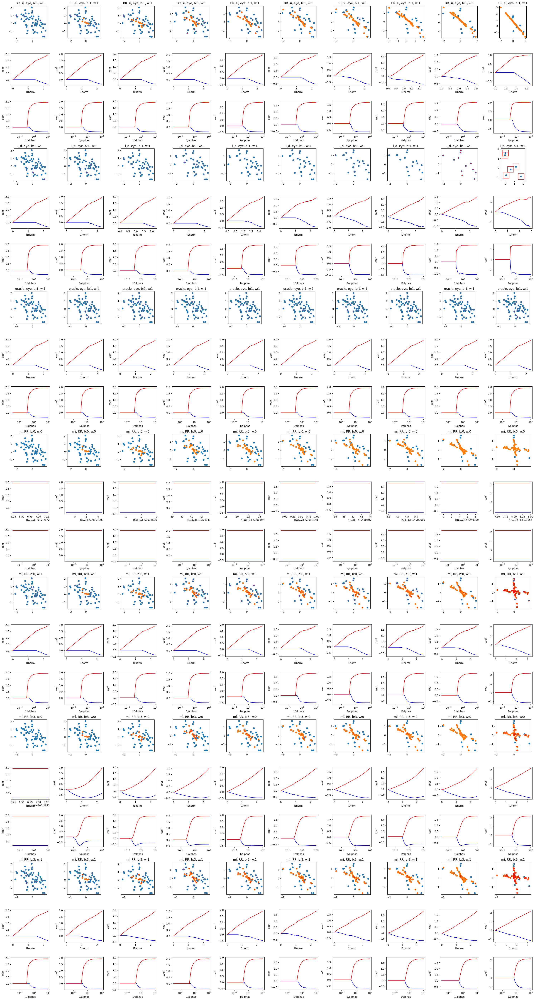

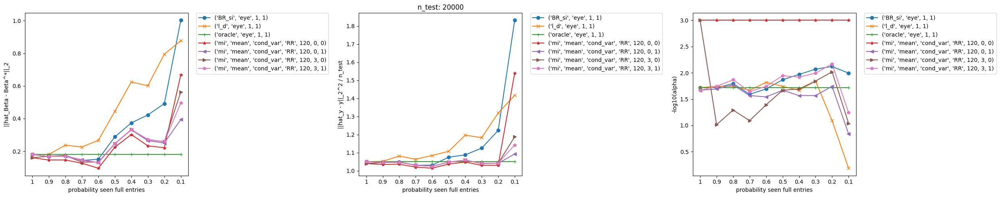

In [ ]:
np.random.seed(456789)

#info_axis = 'train'
#n_train = [400, 800, 1200, 1600, 2000]
#p_seen = make_probabilities([0.8, 0.8, 0.8, 0.8, 0.8])
#main_vec = n_train if info_axis == 'train' else p_seen
#info_x_axis = make_info_axis(main_vec, info_axis)

gen = 'fixed'
info_axis = 'p_seen'  # train or p_seen
#p_seen_both = [1, 0.95, 0.90, 0.85, 0.80, 0.75, 0.70, 0.65, 0.60, 0.55, 0.50, 0.45, 0.40, 0.35, 0.3, 0.25, 0.2, 0.15, 0.1, 0.05, 0.02]
#p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
p_seen_both = [1, 0.9, 0.8, 0.7, 0.6, 0.5, 0.4, 0.3, 0.2, 0.1]
#p_seen_both = [1, 0.9, 0.8]
length_vec = len(p_seen_both)
#n_train = [5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
n_train = [50] * length_vec
error_vec =  [1] * length_vec
p_seen = make_probabilities(p_seen_both)
if info_axis == 'train':
  main_vec = n_train
elif info_axis == 'p_seen':
  main_vec = p_seen_both
elif info_axis == 'error':
  main_vec = error_vec
#main_vec = n_train if info_axis == 'train' else p_seen_both
info_x_axis = make_info_axis(main_vec, info_axis)


dicc = make_dictionary_data(
    nbr_experiments= len(main_vec), n_train = n_train, n_test=20000,
    data = {'data': 'Normal', 'mean': np.array([0, 0]), 'cov': np.array([[1, -0.5], [-0.5, 1]])},
    beta_gt = np.array([-0.5, 2]),
    p_miss = p_seen,
    err_vector = ['Gaussian_on_y', error_vec],
)
dicc = dicc | {'generation':gen}
for key, value in dicc.items():
  print(key,": " , value[0])

# (imp method, cov strategy, mi_nbr)
#list_imp_cov_methods = [('BR_si', 'sd'), ('l_d', 'sd'), ('mi', 'sd', 1)]

#list_methods_strategy = make_dictionary_method(list_imp_cov_methods)
mi_nbr = 120
list_methods_strategy = [{'imp_method': 'BR_si', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1},
                        {'imp_method': 'l_d', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1},
                        {'imp_method': 'oracle', 'cov_strategy': 'eye', 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 3},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'eye', 'mi_nbr': 2},
                        #{'imp_method': 'mi_pure', 'cov_strategy': 'cond_var', 'cov_strategy_within': 'sd', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 1, 'multip_with': 1},
                        #{'imp_method': 'mi_mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'eye', 'mi_nbr': 5},
                        #{'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'zero', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 0, 'multip_with': 1},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 0},
                        {'imp_method': 'mi', 'post_imp':'mean', 'cov_strategy_between': 'cond_var', 'cov_strategy': 'RR', 'mi_nbr': mi_nbr, 'multip_betw': 3, 'multip_with': 1},
                        #{'imp_method': 'mi', 'cov_strategy': 'RR', 'mi_nbr': 5},
                        ]
print(list_methods_strategy)
for el in list_methods_strategy:
  for key, value in el.items():
    print(key,": " , value)

print("----> Starting experiments")
res = run_experiments(dicc, list_methods_strategy)
plot_res(info_x_axis, res, dicc)



## you can see if you manage to take the index i that maximize alpha



In [ ]:
X = np.random.randint(2, 5, size=(2, 2, 2))
print(X)

XX = np.concatenate(X)
print(XX)


Y = np.random.randint(2, 5, size=(1, 3, 2))
print(Y)

YY = np.concatenate(Y)
print(YY)


Z = np.random.randint(2, 5, size=(5, 2))
print(Z)

ZZ = np.concatenate(Z)
print(ZZ)

print("other")
s = np.random.randint(2, 4, 5)
print(s)
z = np.tile(s, reps=3)  # np.array([s] * 2)
print(z)


print("other mult")
s = np.random.randint(2, 8, size=(3, 2))
print(s)
z = np.tile(s, reps=(3, 1))  # np.array([s] * 2)
print(z)


In [ ]:
'''
## random forest imputer
from sklearn.ensemble import RandomForestRegressor
rf_estimator = RandomForestRegressor(n_estimators=4, max_depth=10, bootstrap=True, max_samples=0.5, n_jobs=2, random_state=0)

X_rf = single_imputation(X_nan, rf_estimator)
print(X_rf.shape)
sd_rf = np.std(X_rf, axis=0)
S_inv_rf = np.diag(1 / sd_rf)
print("std_orig: \n", np.std(X_orig, axis=0))
print("std rf\n ", sd_rf)
fig, ax = plt.subplots(num='advtrain_linf_rf')
linfadvtrain_rf = AdversarialTraining(X_rf, y, S_inv_rf, p=np.inf)
estimator_rf = lambda X, y, a:  linfadvtrain_rf(adv_radius=a)
alphas_adv, coefs_advtrain_linf_rf  = get_path(X_rf, y, estimator_rf, 1e1)
plot_coefs_l1norm(coefs_advtrain_linf_rf, ax)
'''

In [ ]:
'''
## iterative imputer Bayesian Ridge

from sklearn.linear_model import BayesianRidge
br_estimator = BayesianRidge()

X_br = single_imputation(X_nan, br_estimator)
sd_br = np.std(X_br, axis=0)
S_inv_br = np.diag(1 / sd_br)
print("std_orig: \n", np.std(X_orig, axis=0))
print("std  br\n ", sd_br)

fig, ax = plt.subplots(num='advtrain_linf_br')
linfadvtrain_br = AdversarialTraining(X_br, y, S_inv_br, p=np.inf)
estimator_br = lambda X, y, a:  linfadvtrain_br(adv_radius=a)
alphas_adv, coefs_advtrain_linf_br  = get_path(X_br, y, estimator_br, 1e4)
plot_coefs_l1norm(coefs_advtrain_linf_br, ax)
'''

In [ ]:
'''
## mean imputation
from sklearn.impute import SimpleImputer

imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
X_mean = imp_mean.fit_transform(X_nan)
sd_mean = np.std(X_mean, axis=0)
print(sd_mean)
S_inv_mean = np.diag(1 / sd_mean)

fig, ax = plt.subplots(num='advtrain_linf_mean')
linfadvtrain_mean = AdversarialTraining(X_mean, y, S_inv_mean, p=np.inf)
estimator_mean = lambda X, y, a:  linfadvtrain_mean(adv_radius=a)
alphas_adv, coefs_advtrain_linf_mean  = get_path(X_mean, y, estimator_mean, 1e1)
plot_coefs_l1norm(coefs_advtrain_linf_mean, ax)
'''

In [ ]:
'''
# imputation elliptic

mu = np.nanmean(X_nan, axis=0)
print("means ", mu)
delta = np.mean(masks) # parameter missingness
print("delta ", delta)
X_0 = np.nan_to_num(X_nan)
print("nbr obs", X_0.shape[0])
S_ellp =  X_0.T @ X_0 / X_0.shape[0]
S_ellp = (1/delta - 1/(delta**2)) * np.diag(np.diag(S_ellp)) + 1/(delta**2) * S_ellp
print("eig cov ", np.linalg.eigvalsh(S_ellp))
X_ellp = imputation_elliptic(mu, S_ellp, X_nan, masks)
#S_inv_ellp = np.linalg.inv(S_ellp)  # other variance
sd_inv_ellp = np.std(X_ellp, axis=0)
print("sd ellp", sd_inv_ellp)

fig, ax = plt.subplots(num='advtrain_linf_ellp')
linfadvtrain_ellp = AdversarialTraining(X_ellp, y, S_ellp, p=np.inf)
estimator_ellp = lambda X, y, a:  linfadvtrain_ellp(adv_radius=a)
alphas_adv, coefs_advtrain_linf_ellp  = get_path(X_ellp, y, estimator_ellp, 1e1)
plot_coefs_l1norm(coefs_advtrain_linf_ellp, ax)
'''

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np


# Example data
x_test_rect = np.random.rand(10)
y_test_rect = np.random.rand(10)

# Plot the points
fig, ax = plt.subplots()
ax.scatter(x_test_rect, y_test_rect)

width = 0.1
height = 0.1

add_rectangles(x_test_rect, y_test_rect, width, height, ax)

# Add the rectangle to the plot


In [ ]:
# Cell for some tests

def test_clear_dataset(n, d):
  print("test clear dataset")
  X = np.random.randint(1, 3, size=(n, d))
  y = np.random.randint(1, 3, size=n)
  masks = np.random.binomial(1, 0.3, size=(n, d))
  print("X \n", X)
  print("y\n", y)
  print("masks \n", masks)
  masks[:, 0] = np.ones(n)
  masks[0, :] = np.ones(d)
  X_res, y_res, masks_res = clear_dataset(X, y, masks)
  print("X_res \n", X_res)
  print("y\n", y_res)
  print("masks \n", masks_res)
  print("test clear dataset ended successfully")

def test_generate_X():
    print("test generate_X started")
    fig, ax = plt.subplots(3, 1, figsize=(10, 8), num='advtrain_linf')
    gen = generate_X('circles', 2)
    data = gen(1000)
    print(data.shape)
    ax[0].scatter(data[:, 0], data[:, 1])
    print("test generate passed syccessfully")

def test_preparation_dataset(n, d):
      print("\ntest preparation dataset started")
      X_train = np.random.rand(n, d)
      print("X_train \n", X_train)
      mask = np.random.binomial(1, 0.5, (n, d))
      print("mask, 0 seen, 1 missing \n ", mask)
      X_masked = X_train * (1 - mask)
      print("X_masked \n", X_masked)
      X_nan_train = X_train.copy()
      X_nan_train[mask == 1] = np.nan
      print("X_nan_train \n", X_nan_train)
      X_br_train = single_imputation(X_nan_train, BayesianRidge())
      print("X_br_train\n ", X_br_train)

      print("what happens if we run single_imputation of full dataset")
      X_br_full = single_imputation(X_train, BayesianRidge())
      print("X_br_full\n ", X_br_full)
      np.testing.assert_allclose(X_train, X_br_full)  # shuold be untouched
      print("test preparation dataset ended successfully")

def test_listwise_delection(n, d):
    print("\n test list_wise delection started")
    X = np.random.rand(n, d)
    print("data\n", X)
    mask = np.random.binomial(1, 0.2, (n, d))
    print("mask \n", mask)
    X_ld = listwise_delection(X, mask)
    print("after calling function, X_ld \n", X_ld)

    print("edge cases, all missing")
    mask_1 = np.ones_like(X)  # all missing
    X1 = listwise_delection(X, mask_1)
    print("X1 \n", X1)  # should be empty
    mask_0 = np.zeros_like(X)  # all seen
    X0 = listwise_delection(X, mask_0)
    print("X0 \n", X0)
    np.testing.assert_allclose(X0, X)  # should be the original dataset

    print("one dimnsional array")
    y = np.random.rand(n)
    print("y before ", y)
    y_ld = listwise_delection(y, mask)
    print("y after ld ", y_ld)
    print("test listwise_delection passed")


test_generate_X()
test_preparation_dataset(3, 4)
test_listwise_delection(3, 4)
test_clear_dataset(6, 3)

xxx = np.random.randint(2, 5, size=(3, 3)) * 1.0
mmm = np.random.binomial(1, 0.5, size=(3, 3))
print(xxx)
print(mmm)
print(mmm == 1)
print(xxx[mmm == 1])
xxx[mmm == 1] = np.nan
print(xxx)
mask_from_xxx = np.isnan(xxx).astype(int)
print("mask from xxx \n", mask_from_xxx)


In [ ]:
# test best predictor

def test_best_predictor(n, d, nb_coeff):
  X_test = np.random.randint(1, 9, size=(n, d))
  beta_gt_test = np.random.randint(1, 7, size=d)
  y_test = X_test @ beta_gt_test
  #print("X_test \n", X_test, "\n beta_gt", beta_gt_test, "\n y_test = X_test @ beta_gt_test ", y_test)
  coeff_test = np.random.randint(1, 5, size=(d, nb_coeff))
  rdm_idx = np.random.randint(1, d+1, size=1)
  print(rdm_idx)
  #print("coeff test partial ", coeff_test[:, -1])
  rng = np.arange(nb_coeff)
  #print(rng != rdm_idx)
  coeff_test[:, rng != rdm_idx] = coeff_test[:, rng != rdm_idx] + 1000  # increase artificially the value of the other coefficient, to induce the minimum index to be rdm_idx
  #print("coeff_test \n", coeff_test)
  best_coeff, best_score = best_predictor(X_test, coeff_test, y_test)
  print("best coeff ", best_coeff)
  print("best score ", best_score)
  np.testing.assert_allclose(best_coeff, coeff_test[:,rdm_idx].squeeze())
  print("test best predictor passed")

test_best_predictor(100, 5, 20)




In [ ]:
# test train_and_plot

X_diab, y_diab = datasets.load_diabetes(return_X_y=True)
n, d = X_diab.shape
print("n:  ", n, ", d: ", d)
# Standardize data
X_diab -= X_diab.mean(axis=0)
X_diab /= X_diab.std(axis=0)

## original lasso
fig_l, ax_l = plt.subplots(num='lasso')
alphas_lasso, coefs_lasso, _ = get_lasso_path(X_diab, y_diab)
plot_coefs_l1norm(coefs_lasso, ax_l)

## Antonio's algo, 1 matrix
S_diab_eye = np.eye(X_diab.shape[1])
fig, ax_1 = plt.subplots(1, 1, num='advtrain_linf_diab')
fig, ax_2 = plt.subplots(1, 1, num='advtrain_linf_diab_2')
train_and_plot(X_diab, y_diab, S_diab_eye, [ax_1, ax_2])

## Antonio's algo, multiple diagonal matrix
#S_diab = np.eye(X_diab.shape[1])
#S_diab = np.random.randint(1, 3, size=(n, d))
#print(S_diab)
#fig, ax_5 = plt.subplots(1, 1, num='advtrain_linf_diab_5')
#fig, ax_6 = plt.subplots(1, 1, num='advtrain_linf_diab_6')
#train_and_plot(X_diab, y_diab, S_diab, [ax_5, ax_6])


## Antonio's algo, multiple matrices (same matrix stacked multiple time)
S_diab_stacked = np.array([S_diab_eye] * X_diab.shape[0])
S_diab_stacked = np.concatenate(S_diab_stacked)
fig, ax_3 = plt.subplots(1, 1, num='advtrain_linf_diab_3')
fig, ax_4 = plt.subplots(1, 1, num='advtrain_linf_diab_4')
train_and_plot(X_diab, y_diab, S_diab_stacked, [ax_3, ax_4])




In [ ]:
# test imputations

np.random.seed(45)


def test_imputations(n, d):
  X = np.random.randint(2, 5, size=(n, d)) * 1.0
  y = X @ np.random.randint(1, 3, size=d)
  m = np.random.binomial(1, 0.4, size=(n, d))  # 1 missing, 0 seen
  print("m original\n", m)
  X, y, m = clear_dataset(X, y, m)
  print(m)
  X_nan = X.copy()
  X_nan[m == 1] = np.nan

  #mask_from_xxx = np.isnan(xxx).astype(int)
  print("X\n ", X)
  print("masks \n", m)
  print("X_nan\n ", X_nan)
  methods = ['BR_si', 'mi', 'l_d']
  nbr_mi = [1, 3]
  #for method in methods:
  #  dict_info = {'imp_method': method, 'mi_nbr':nbr_mi}
  #dict_info = {'imp_method':methods, 'mi_nbr':nbr_mi}
  for method in methods:
    print("---------- method: ", method)
    if method == 'mi':
      for x in nbr_mi:
        print("-------------------- nbr mi: ", x)
        dict_info = {'imp_method':method, 'mi_nbr':x}
        #print("XNANNANAN ", X_nan)
        X_res, y_res, mask_res = imputations(dict_info, X_nan, y)
        print(X_res, y_res, "\n", mask_res)
    else:
      dict_info = {'imp_method': method}
      X_res, y_res, mask_res = imputations(dict_info, X_nan, y)
      print(X_res, y_res, "\n", mask_res)
    print("test imputations ended successfully")

test_imputations(6, 3)


In [ ]:
x = []
y = np.array([1, 2])
x.append(y)
x.append(y)
x.append(y)
xx = np.stack(x)
print(x)
print(xx)
print(type(xx))


import matplotlib.pyplot as plt

sizes = [100, 1000, 10000, 100000]
values = [0.8, 0.85, 0.9, 0.92]
positions = range(len(sizes))

plt.plot(positions, values, marker='o', label='Model Accuracy')  # Add label here
plt.xticks(positions, sizes)

plt.xlabel("Dataset Size (equispaced)")
plt.ylabel("Accuracy")
plt.title("Performance vs Dataset Size (equispaced x-axis)")
#plt.legend()  # Show legend
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.grid(True)
plt.show()



In [ ]:

dictio = {'a':1, 'b':2, 'c':3}
vv = dictio.values()
#print(vv)
#print(vv[1])

x1 = np.array([1, 2, 3])
x2 = np.array([3, 2 ,1])
v = np.maximum(x1, x2)
print(v)


In [ ]:
m, n, d = 2, 3, 2
x_int = np.random.randint(1, 9, (m, n, d))
print(x_int)
s = np.std(x_int, axis=0)
print(s)

# manual
print("manual computation")
x = np.zeros((m, d))
for i in range(n):
  print("i -----> ", i)
  x = x_int[:, i, :]
  print("x\n", x)
  ss = np.std(x, axis=0)
  print(ss)


print("little exp on squeeze")
sss = np.random.rand(1, 3, 3)
print(sss)
print(sss.squeeze())
print(sss.squeeze())



In [ ]:
int(34.99)

xxxx = np.random.randint(2, 4, (5, 2))
print(xxxx)
xxxx[0:2, :] = 1
print(xxxx)

[[2 2]
 [2 2]
 [2 2]
 [2 2]
 [3 2]]
[[1 1]
 [1 1]
 [2 2]
 [2 2]
 [3 2]]
